/ssd/users/kevin/conda/test_SNPmanifold/lib/python3.8/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Start loading raw data.
Finish loading raw data.
Start filtering low-quality cells and SNPs.


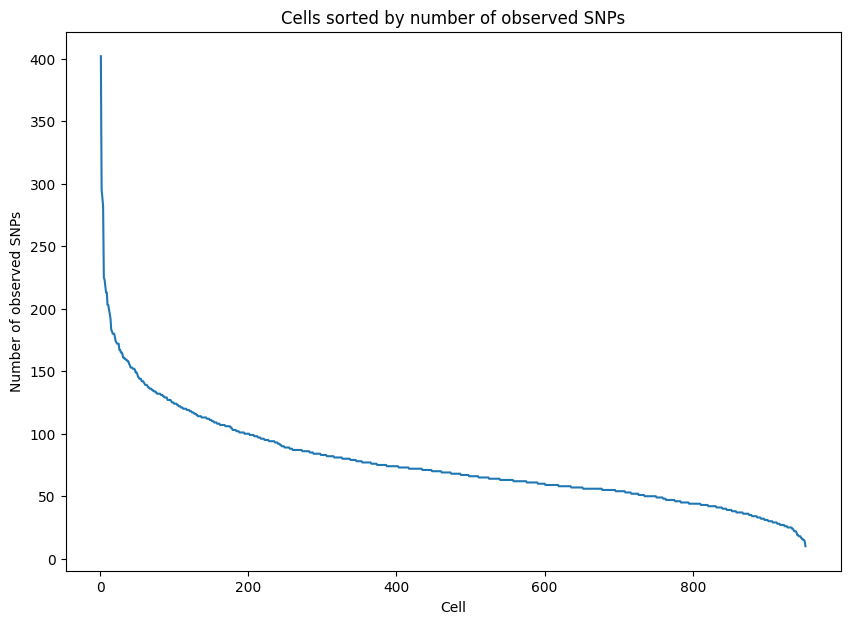

Please determine y-axis threshold in the plot to filter low-quality cells with low number of observed SNPs.   50


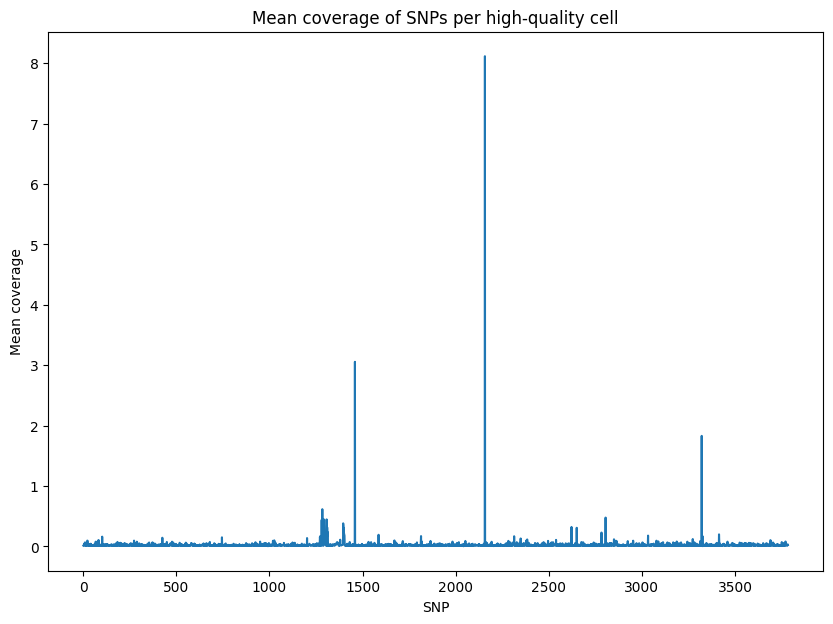

Please determine y-axis threshold in the plot to filter low-quality SNPs with low coverage.   0


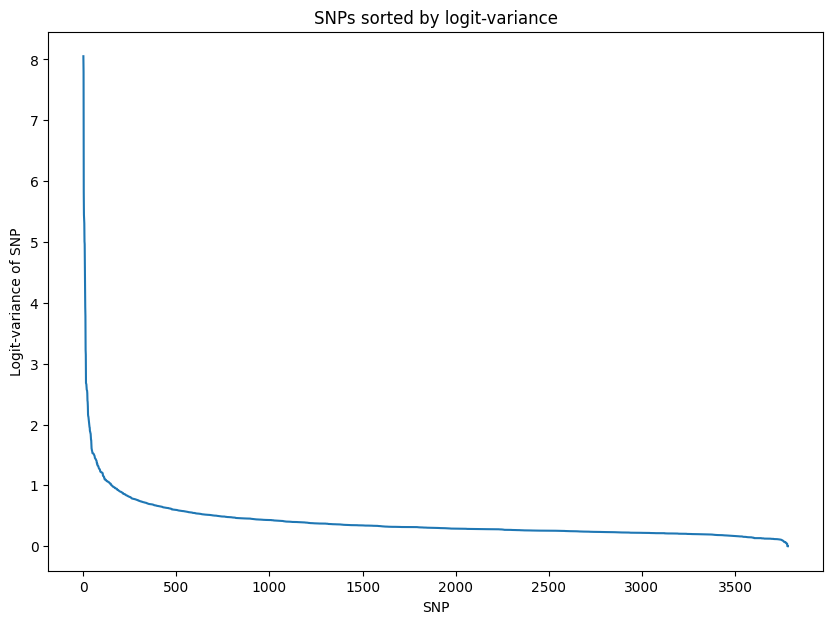

Please determine y-axis threshold in the plot to filter low-quality SNPs with low logit-variance.   0.3
Finish filtering low-quality data, 734 cells and 1905 SNPs will be used for downstream analysis.
Start training VAE.
Epoch[10/2000], Cost: 0.761149
Epoch[20/2000], Cost: 0.630371
Epoch[30/2000], Cost: 0.510870
Epoch[40/2000], Cost: 0.416559
Epoch[50/2000], Cost: 0.343095
Epoch[60/2000], Cost: 0.287408
Epoch[70/2000], Cost: 0.247735
Epoch[80/2000], Cost: 0.214894
Epoch[90/2000], Cost: 0.190383
Epoch[100/2000], Cost: 0.171962
Epoch[200/2000], Cost: 0.107177
Epoch[300/2000], Cost: 0.096328
Epoch[400/2000], Cost: 0.092697
Epoch[500/2000], Cost: 0.090995
Epoch[600/2000], Cost: 0.090177
Epoch[700/2000], Cost: 0.089470
Epoch[800/2000], Cost: 0.089049
Epoch[900/2000], Cost: 0.088727
Epoch[1000/2000], Cost: 0.088509
Epoch[1100/2000], Cost: 0.088333
Epoch[1200/2000], Cost: 0.088216
Epoch[1300/2000], Cost: 0.088065
Epoch[1400/2000], Cost: 0.088011
Epoch[1500/2000], Cost: 0.087920
Epoch[1600/200

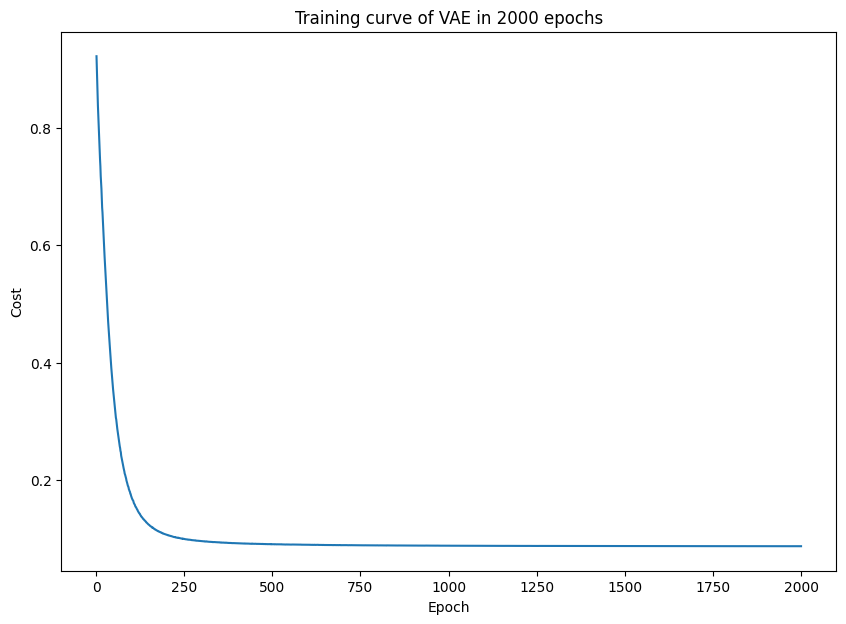

Start learning PCA and UMAP of latent space in VAE.
Finish learning, PCA and UMAP of latent space will be shown below.


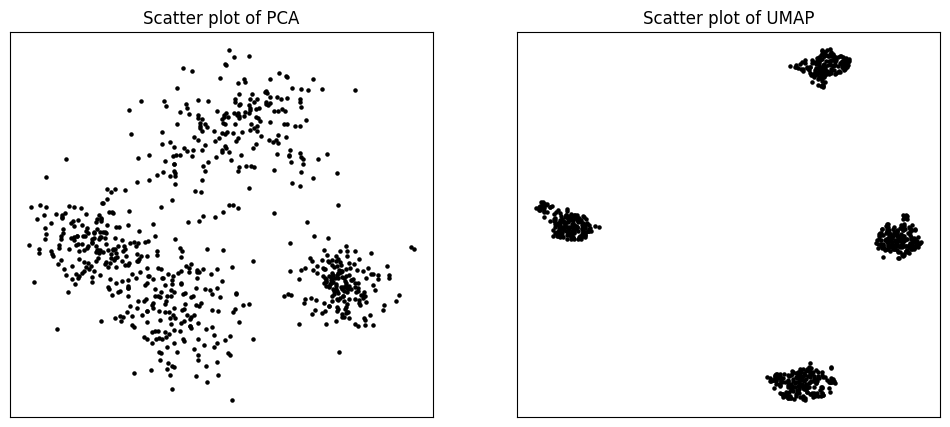

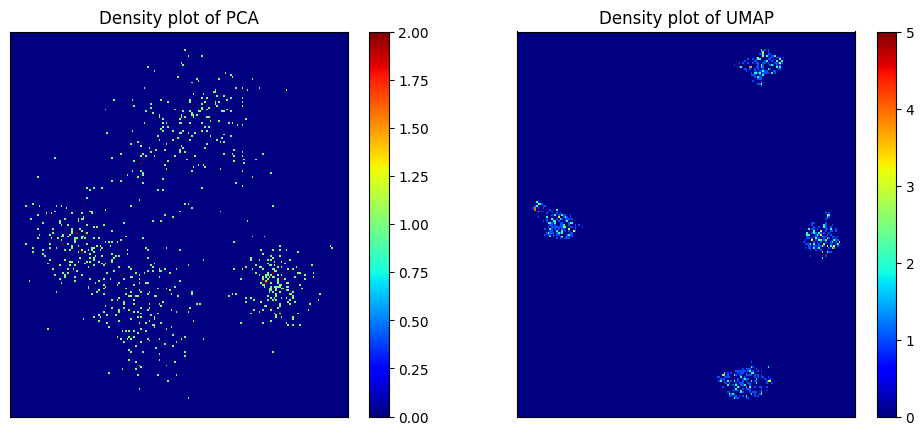

Start clustering.
2 clusters, Distortion: 20245.677734
3 clusters, Distortion: 7023.905273
4 clusters, Distortion: 400.404633
5 clusters, Distortion: 338.579468
6 clusters, Distortion: 315.600708
7 clusters, Distortion: 265.001434
8 clusters, Distortion: 307.795685
9 clusters, Distortion: 223.967224
10 clusters, Distortion: 219.480240
11 clusters, Distortion: 197.303101
12 clusters, Distortion: 177.592987
13 clusters, Distortion: 162.880814
14 clusters, Distortion: 157.018967
15 clusters, Distortion: 148.119644
Finish clustering, PCA, UMAP, distortion, silhouette score of K-means clustering will be shown below.


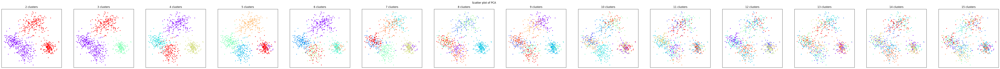

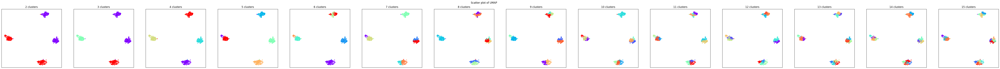

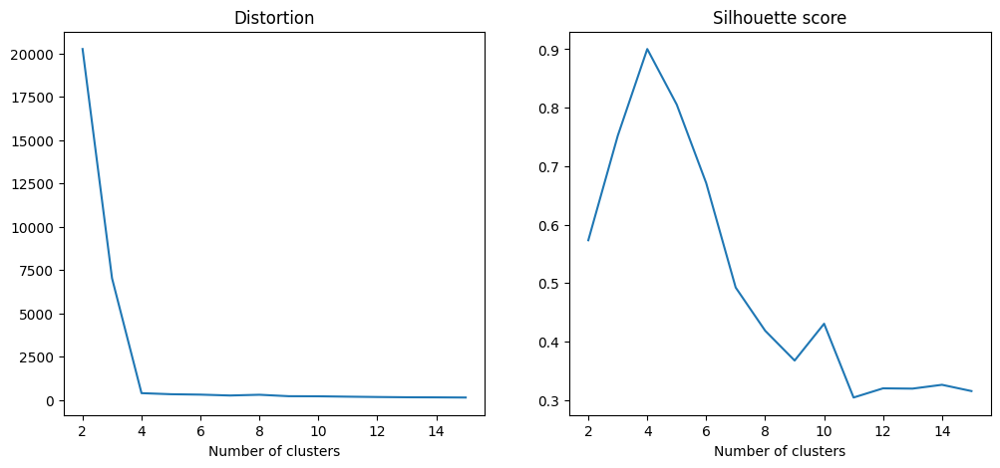

PCA and UMAP of individual clusters will be shown below.


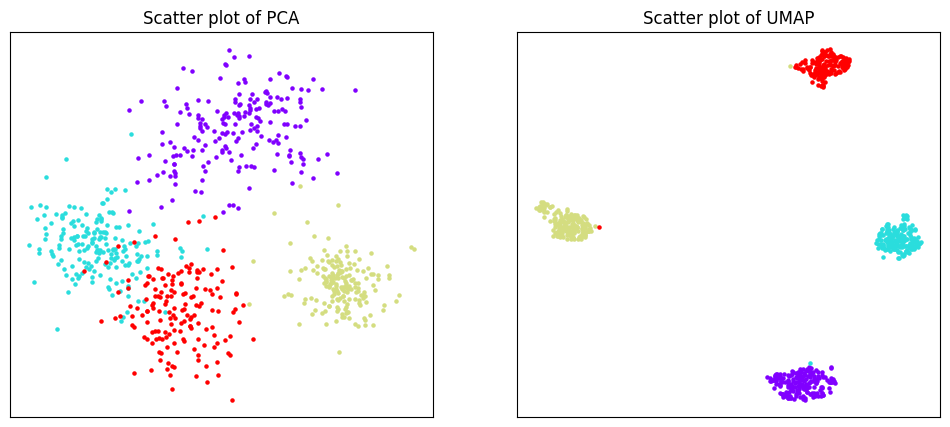

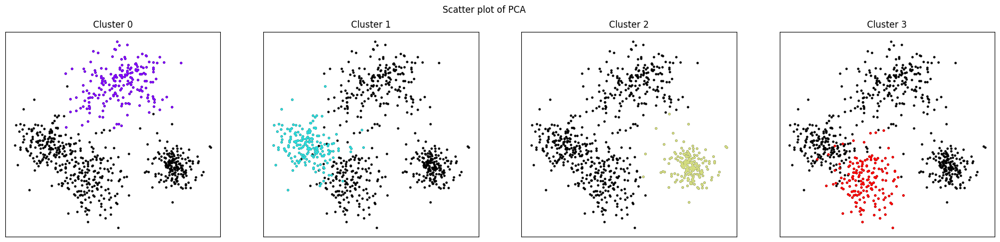

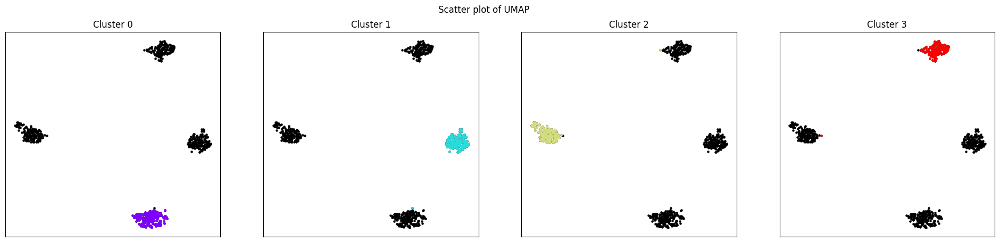

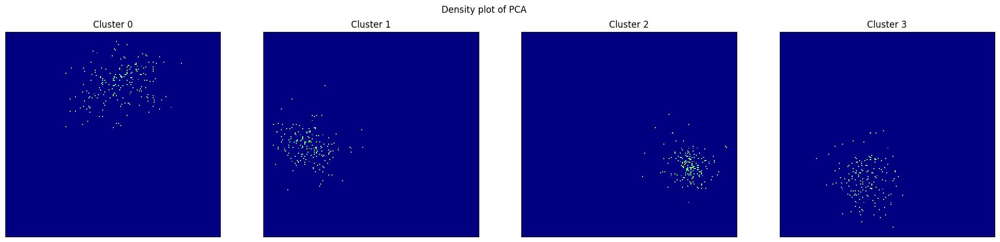

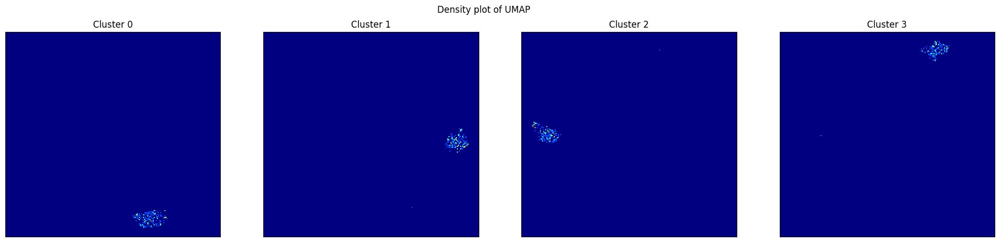

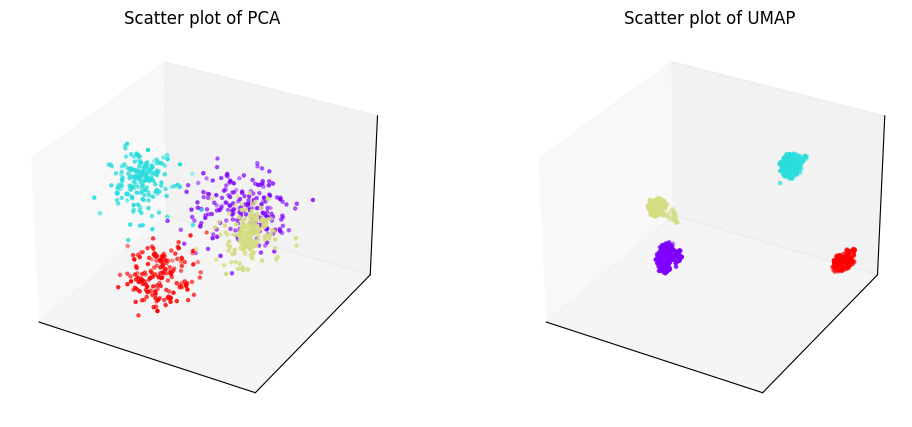

Phylogenetic tree in latent space will be shown below.


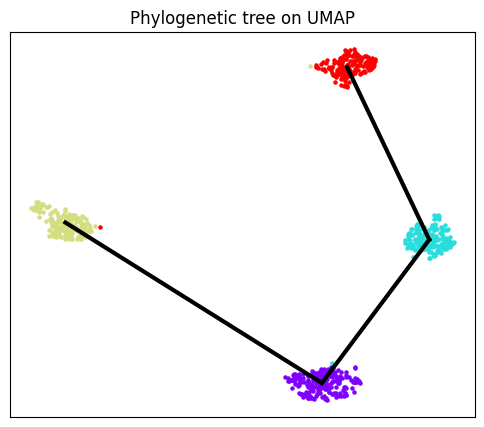

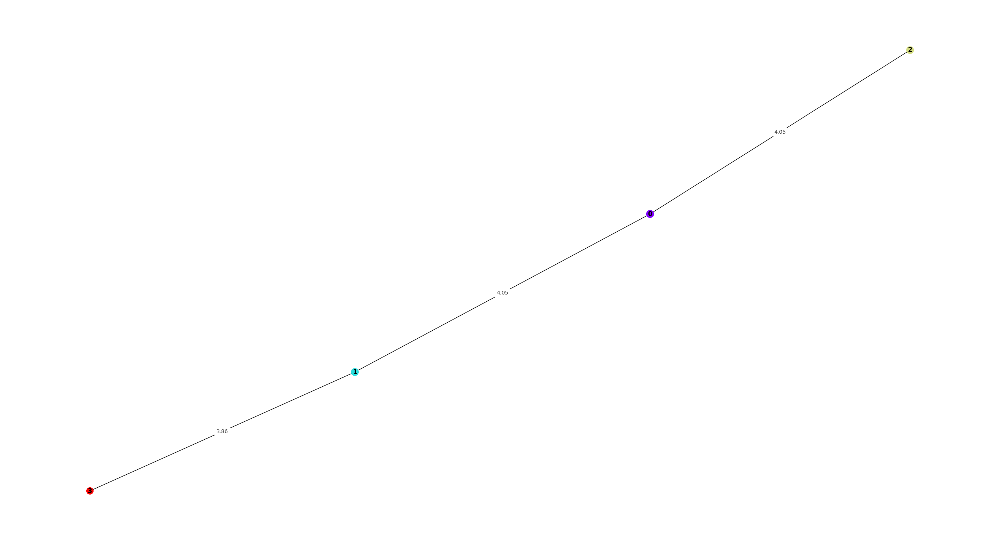

/tmp/ipykernel_1810892/2299804736.py:261: RuntimeWarning: divide by zero encountered in divide
  f_stat = np.clip(1 / ratio_logit_var, 1.001, 20)


SNP-allelic ratios of 734 cells and 50 SNPs will be shown below.


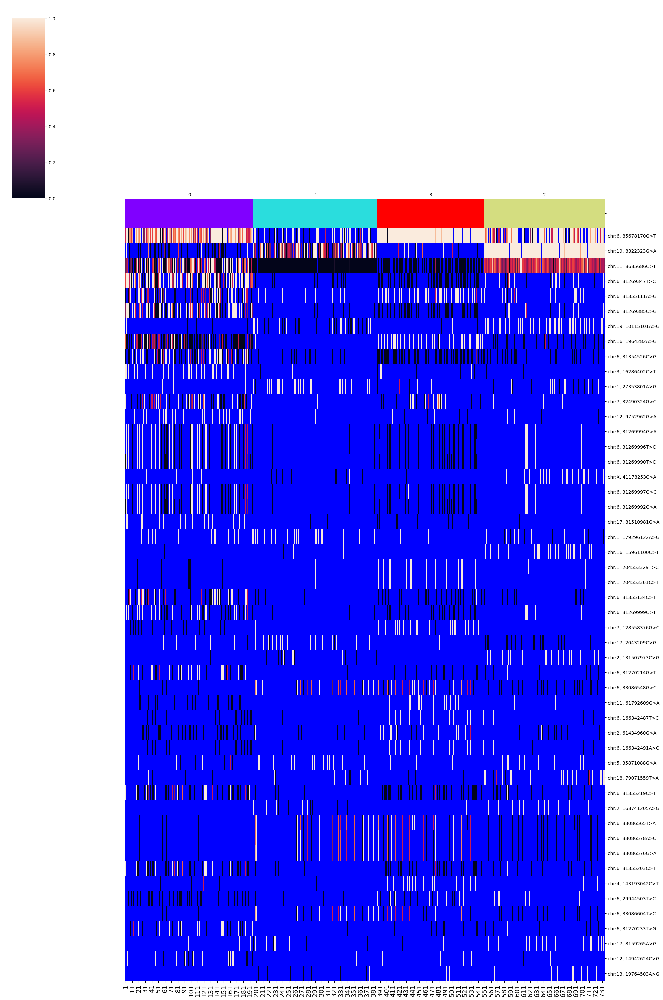

SNPs sorted by lowest p-value will be shown below


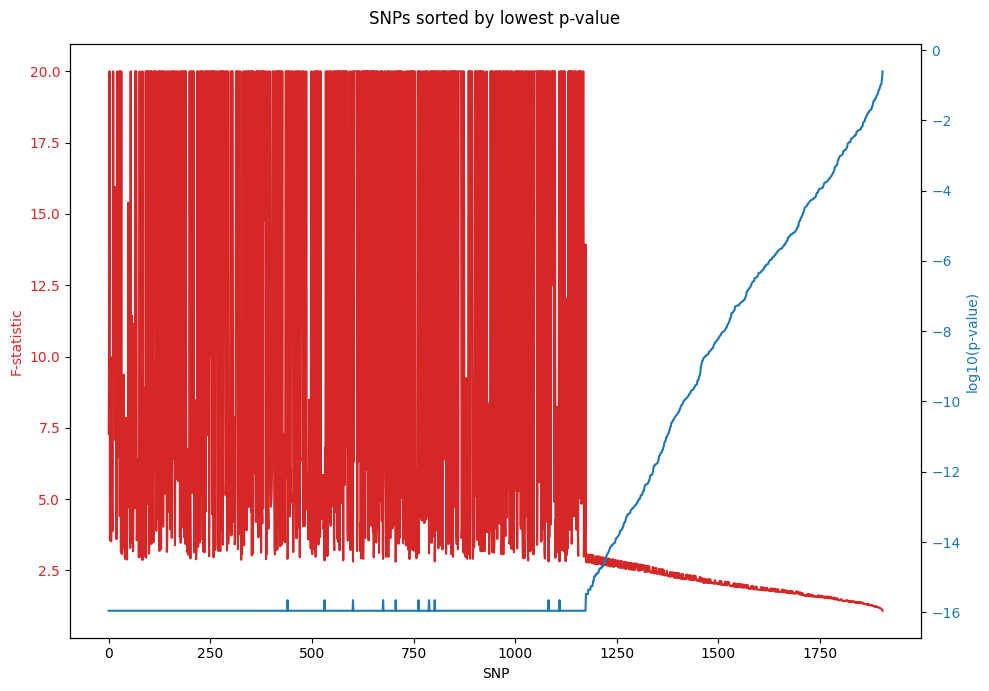

In [1]:
import torch
torch.set_default_device('cuda')
torch.cuda.set_device('cuda:5')

%run /home/kevin/storage_kevin/past_figures/figures_final5/notebook/SNPmanifold.ipynb

normalized_layer1 = SNP_VAE(AD = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor4/cellSNP.tag.AD.mtx", DP = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor4/cellSNP.tag.DP.mtx", VCF = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor4/cells.cellSNP.vcf.gz")
normalized_layer1.filtering()
normalized_layer1.training()
normalized_layer1.clustering(algorithm = "kmeans_umap3d")
normalized_layer1.phylogeny(cluster_no = 4)

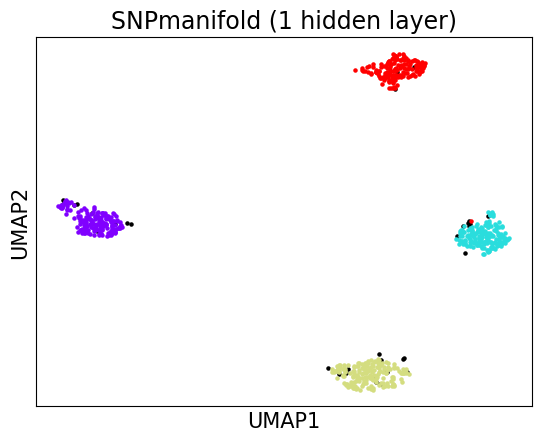

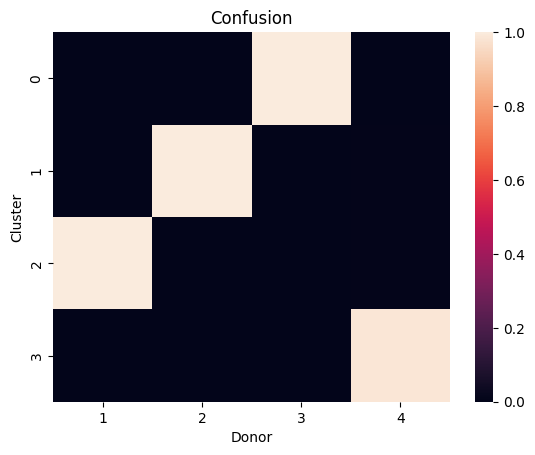

accuracy: 99.68944099378882
silhouette score: 0.8939802359791881


In [2]:
normalized_layer1_embedding_2d = normalized_layer1.embedding_2d

donor = pd.read_csv('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor4/donor_ids.tsv', sep = '\t').iloc[:, 1].to_numpy()[normalized_layer1.cell_filter]
name = ["MantonCB1", "MantonCB2", "MantonCB3", "MantonCB4", "doublet", "unassigned"]

clusters = []

for w in name:
    
    clusters.append(np.where(donor == w)[0])

fig, axs = plt.subplots(1, 1)

axs.scatter(normalized_layer1.embedding_2d[clusters[4], 0], normalized_layer1.embedding_2d[clusters[4], 1], s = 5, color = "black")

for t in range(4):
    
    axs.scatter(normalized_layer1.embedding_2d[clusters[t], 0], normalized_layer1.embedding_2d[clusters[t], 1], s = 5, color = normalized_layer1.colors[t])
    
axs.set_xticks([])
axs.set_yticks([])
axs.set_xlabel("UMAP1", fontsize = 15)
axs.set_ylabel("UMAP2", fontsize = 15)
axs.set_title("SNPmanifold (1 hidden layer)", fontsize = 17)

plt.show()

name = ["MantonCB1", "MantonCB2", "MantonCB3", "MantonCB4", "doublet", "unassigned"]
reference = np.empty(normalized_layer1.cell_total)

for w in range(6):
    
    reference[np.where(donor == name[w])[0]] = w
    
reference = reference.astype(int)
    
matrix = np.zeros((4, 4))
ref_sum = np.zeros(4)

for q in range(normalized_layer1.cell_total):
    
    if reference[q] <= 3:

        matrix[reference[q], normalized_layer1.assigned_label[q]] += 1
        ref_sum[reference[q]] += 1

prop = matrix / np.outer(ref_sum, np.ones(4))

fig, ax = plt.subplots(1, 1)
ax = sns.heatmap(prop.T[[0, 1, 2, 3], :], xticklabels = [1, 2, 3, 4], yticklabels = [0, 1, 2, 3])
ax.set_ylabel("Cluster")
ax.set_xlabel("Donor")
ax.set_title("Confusion")
plt.show()

print(f'accuracy: {np.mean(np.max(prop, 1)) * 100}')
print(f'silhouette score: {silhouette_score(normalized_layer1.pair_embedding_3d[reference <= 3, :][:, reference <= 3], reference[reference <= 3], metric = "precomputed")}')

Start loading raw data.
Finish loading raw data.
Start filtering low-quality cells and SNPs.


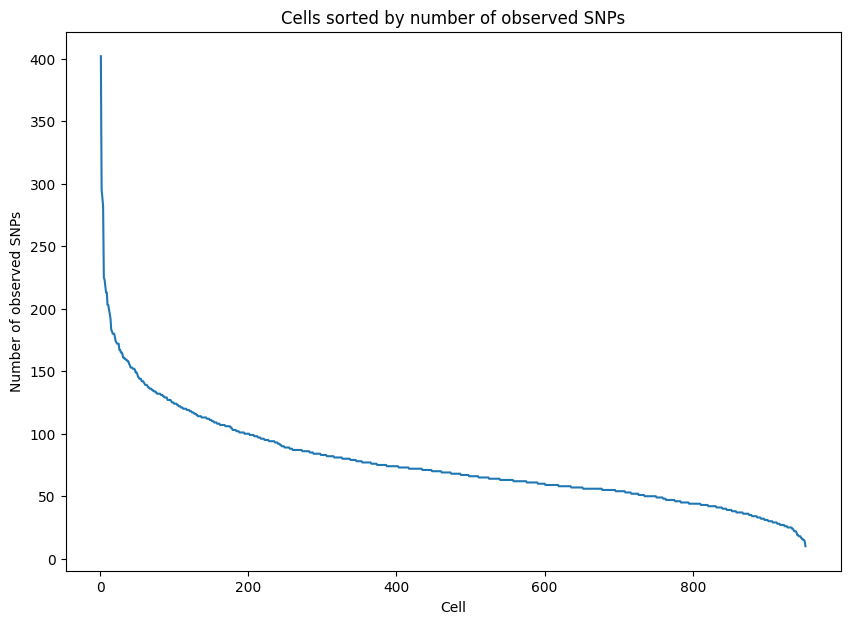

Please determine y-axis threshold in the plot to filter low-quality cells with low number of observed SNPs.   50


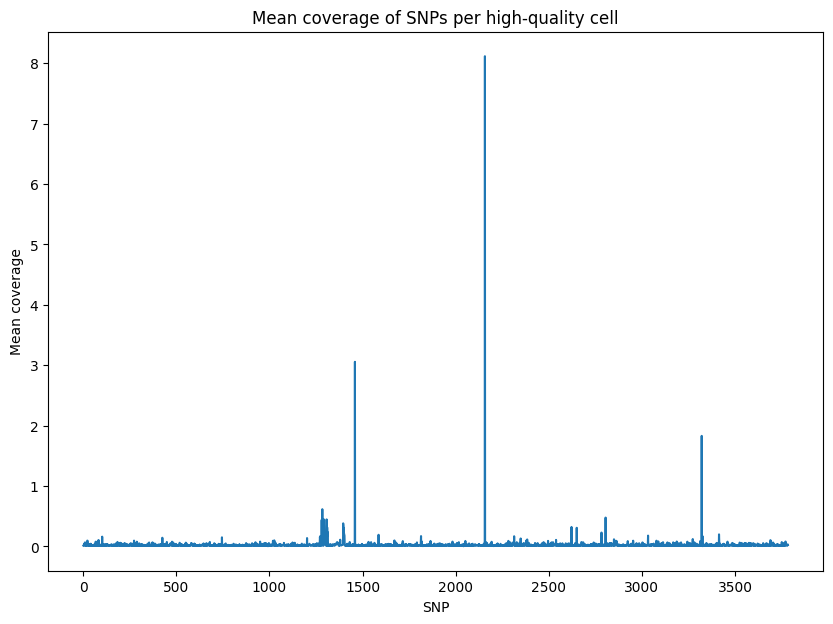

Please determine y-axis threshold in the plot to filter low-quality SNPs with low coverage.   0


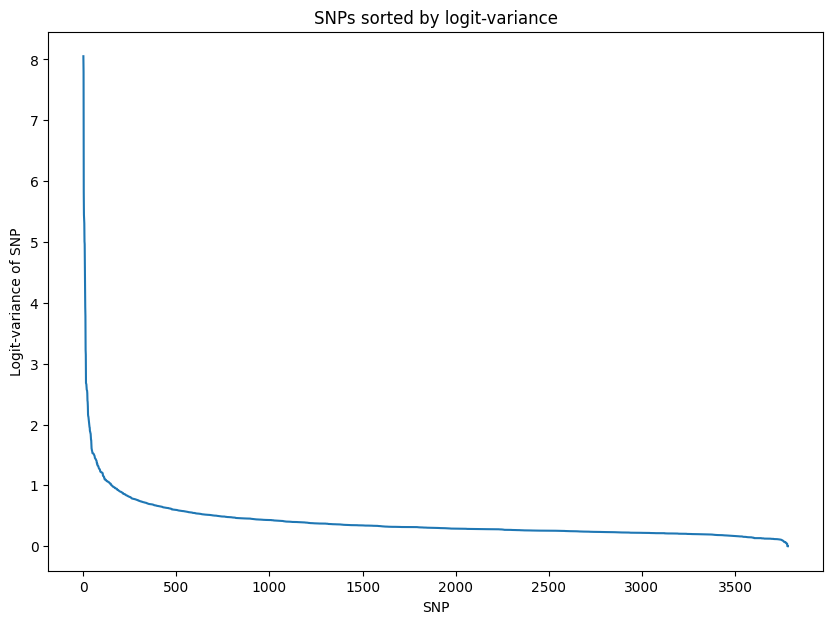

Please determine y-axis threshold in the plot to filter low-quality SNPs with low logit-variance.   0.3
Finish filtering low-quality data, 734 cells and 1905 SNPs will be used for downstream analysis.
Start training VAE.
Epoch[10/2000], Cost: 0.708852
Epoch[20/2000], Cost: 0.563384
Epoch[30/2000], Cost: 0.427470
Epoch[40/2000], Cost: 0.324970
Epoch[50/2000], Cost: 0.253275
Epoch[60/2000], Cost: 0.195919
Epoch[70/2000], Cost: 0.156459
Epoch[80/2000], Cost: 0.132512
Epoch[90/2000], Cost: 0.121024
Epoch[100/2000], Cost: 0.108338
Epoch[200/2000], Cost: 0.092075
Epoch[300/2000], Cost: 0.094376
Epoch[400/2000], Cost: 0.088656
Epoch[500/2000], Cost: 0.088330
Epoch[600/2000], Cost: 0.088017
Epoch[700/2000], Cost: 0.088356
Epoch[800/2000], Cost: 0.088394
Epoch[900/2000], Cost: 0.087933
Epoch[1000/2000], Cost: 0.087779
Epoch[1100/2000], Cost: 0.087724
Epoch[1200/2000], Cost: 0.088381
Epoch[1300/2000], Cost: 0.087918
Epoch[1400/2000], Cost: 0.088048
Epoch[1500/2000], Cost: 0.087884
Epoch[1600/200

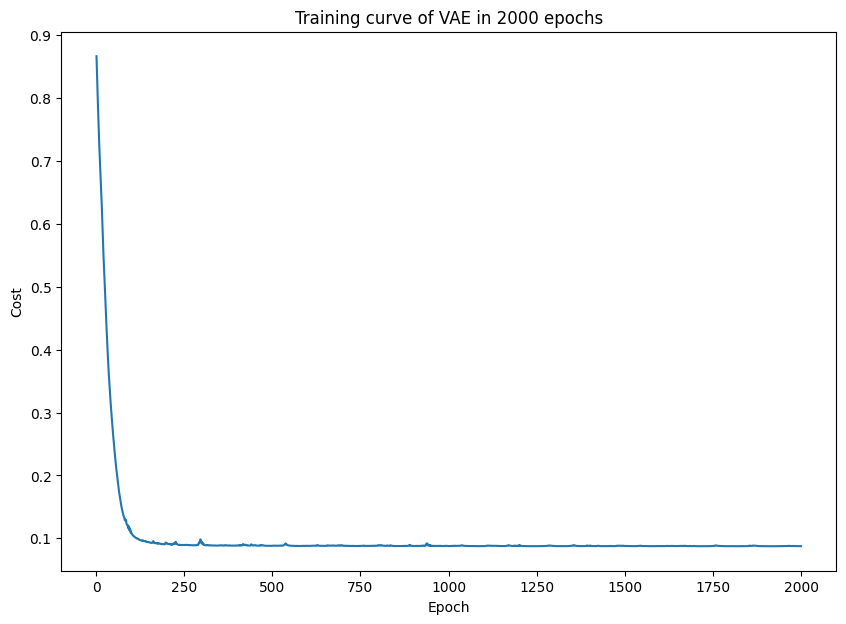

Start learning PCA and UMAP of latent space in VAE.
Finish learning, PCA and UMAP of latent space will be shown below.


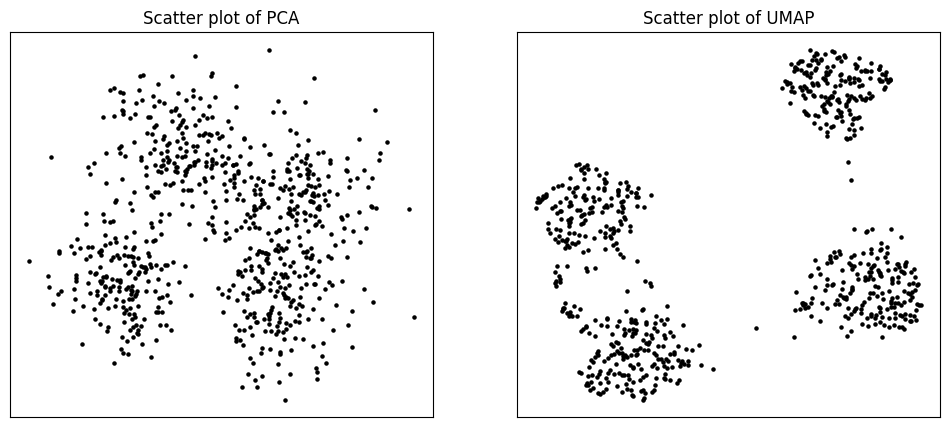

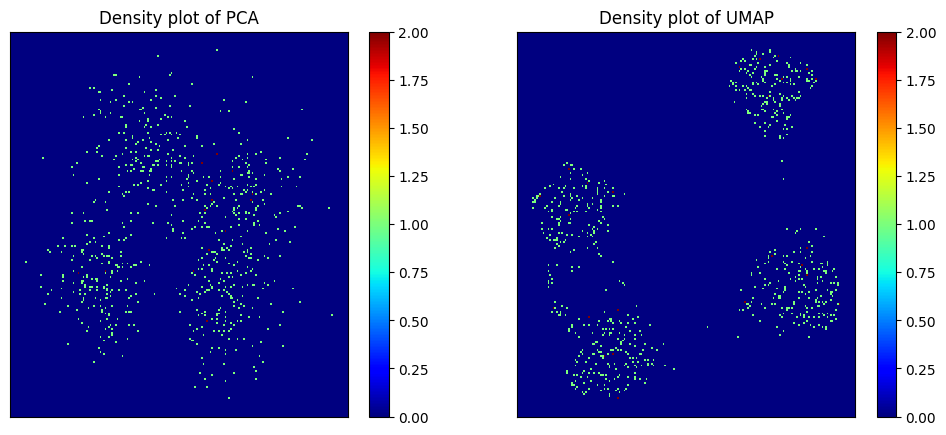

Start clustering.
2 clusters, Distortion: 2519.616211
3 clusters, Distortion: 1357.052368
4 clusters, Distortion: 457.740662
5 clusters, Distortion: 427.019531
6 clusters, Distortion: 387.440521
7 clusters, Distortion: 356.702637
8 clusters, Distortion: 318.496460
9 clusters, Distortion: 285.023346
10 clusters, Distortion: 273.848999
11 clusters, Distortion: 245.186829
12 clusters, Distortion: 239.828629
13 clusters, Distortion: 213.069656
14 clusters, Distortion: 203.413773
15 clusters, Distortion: 204.381638
Finish clustering, PCA, UMAP, distortion, silhouette score of K-means clustering will be shown below.


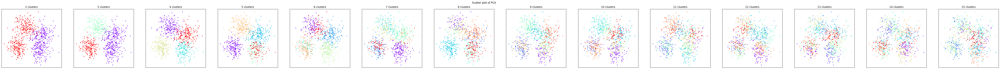

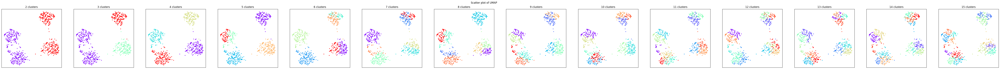

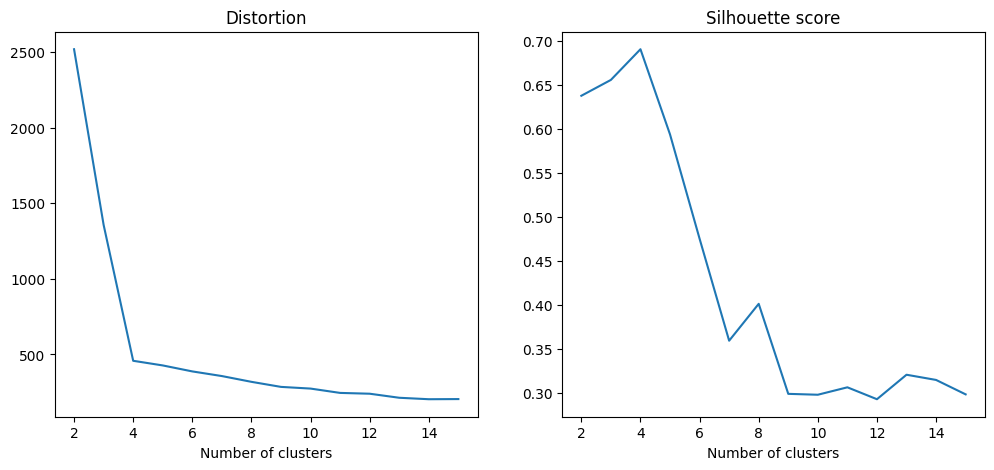

PCA and UMAP of individual clusters will be shown below.


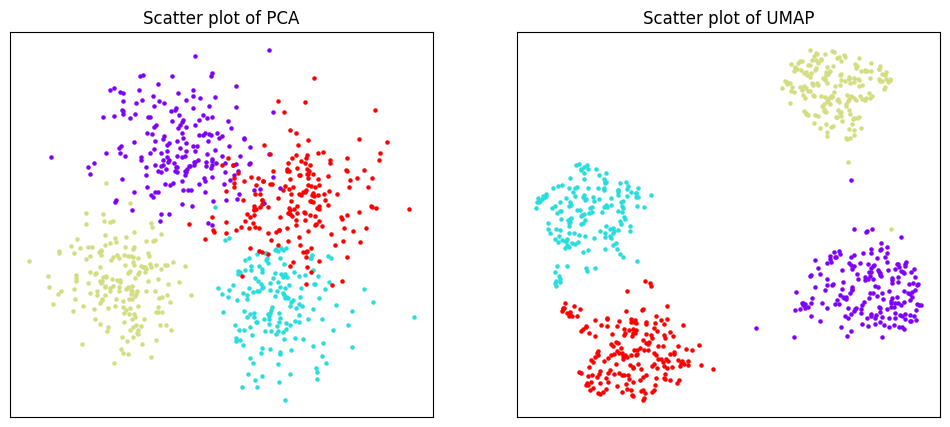

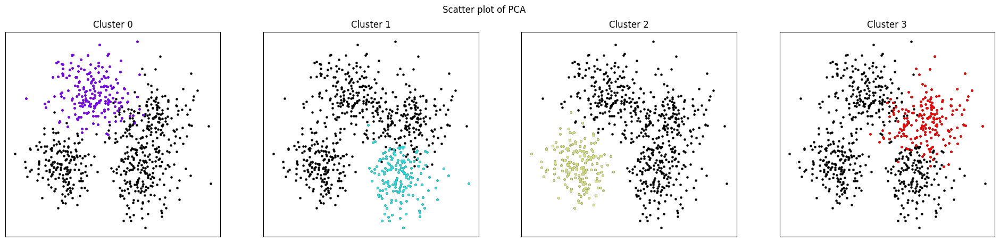

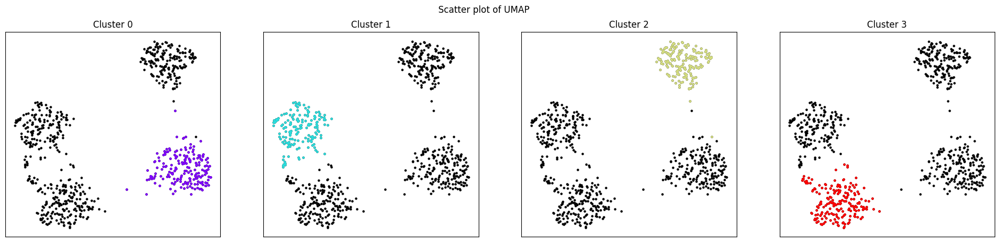

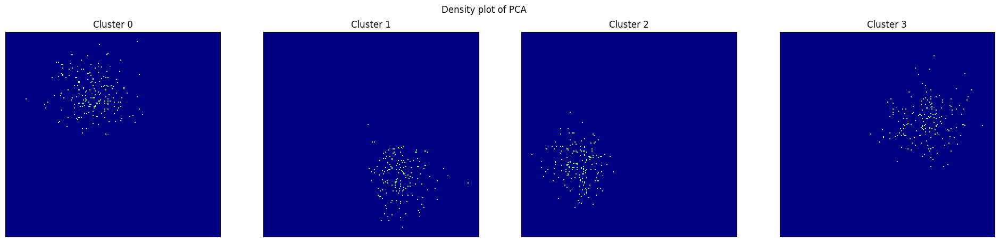

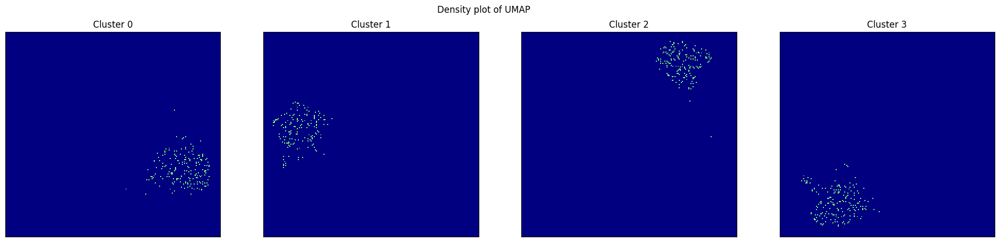

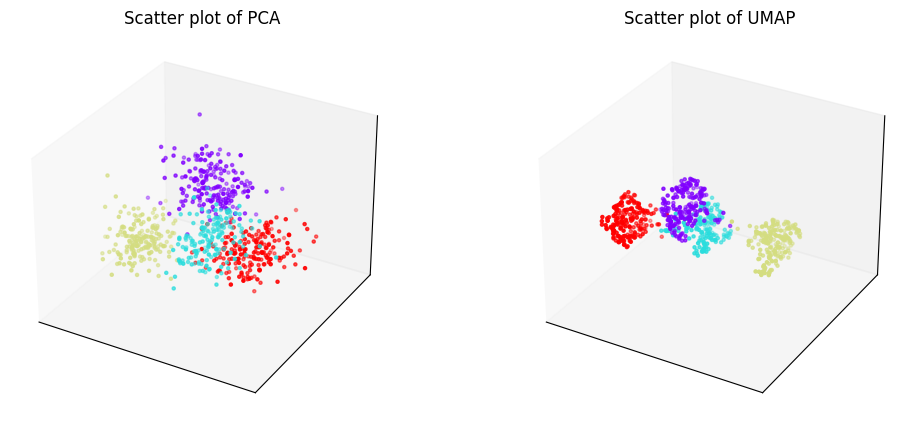

Phylogenetic tree in latent space will be shown below.


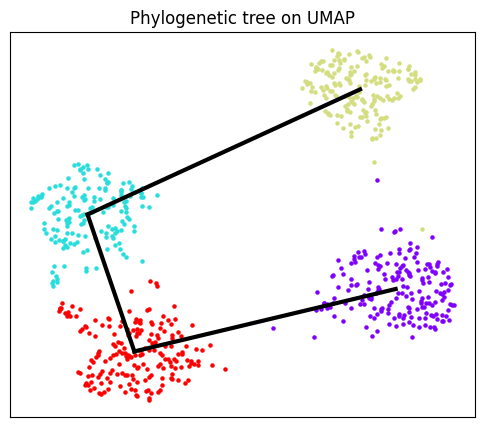

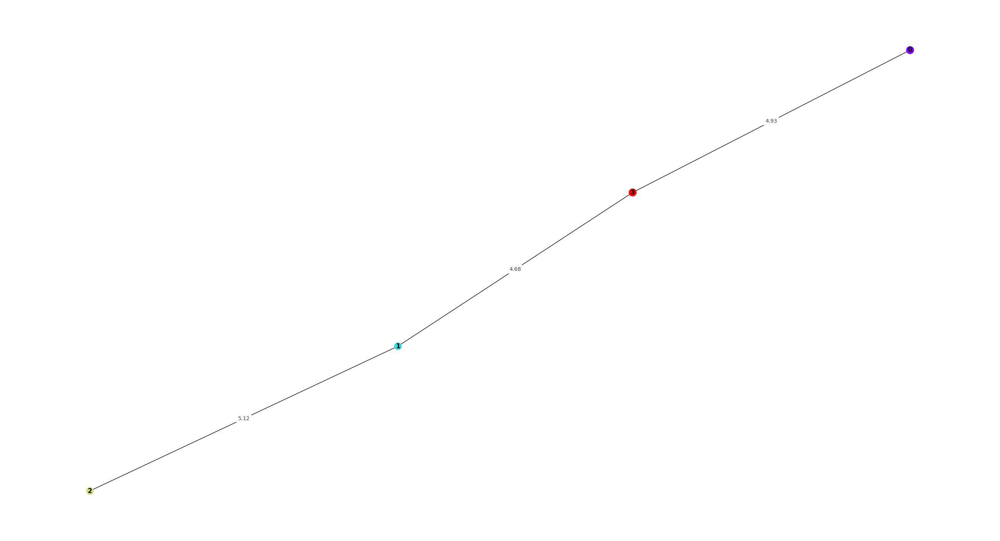

/tmp/ipykernel_1810892/2299804736.py:261: RuntimeWarning: divide by zero encountered in divide
  f_stat = np.clip(1 / ratio_logit_var, 1.001, 20)


SNP-allelic ratios of 734 cells and 50 SNPs will be shown below.


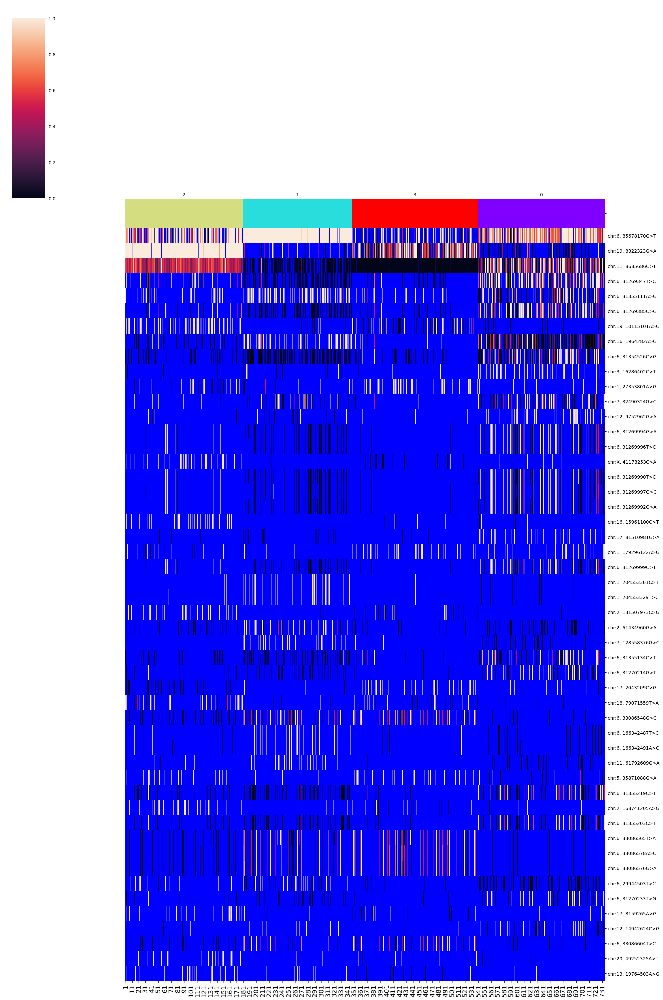

SNPs sorted by lowest p-value will be shown below


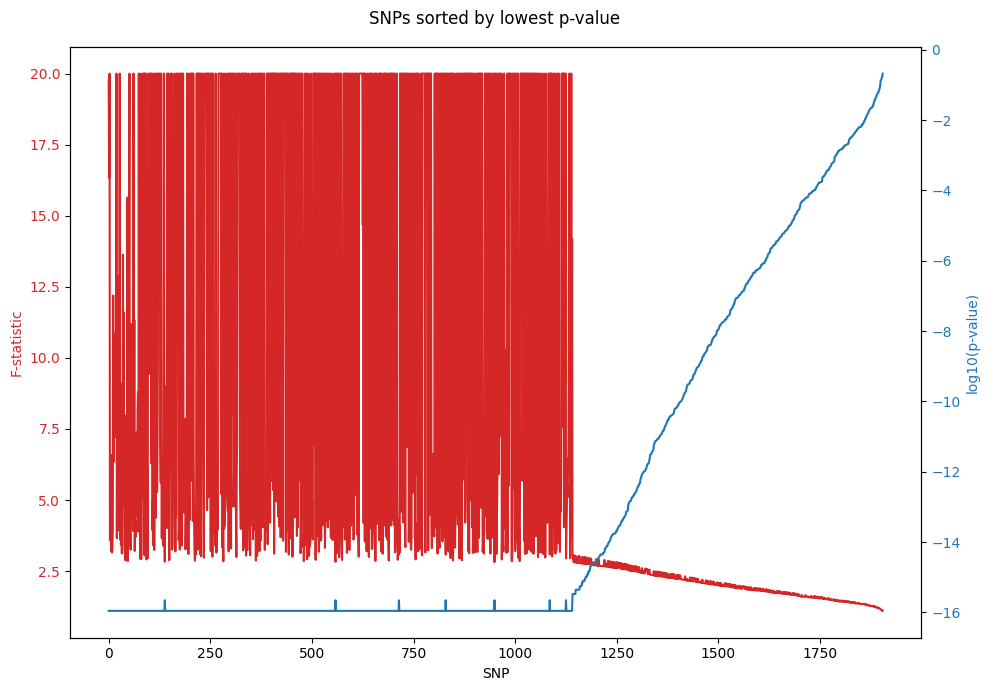

In [3]:
del normalized_layer1

%run /home/kevin/storage_kevin/past_figures/figures_final5/notebook/SNPmanifold-layer3_updated.ipynb

unnormalized_layer3 = SNP_VAE(AD = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor4/cellSNP.tag.AD.mtx", DP = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor4/cellSNP.tag.DP.mtx", VCF = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor4/cells.cellSNP.vcf.gz", SNPread = "unnormalized")
unnormalized_layer3.filtering()
unnormalized_layer3.training()
unnormalized_layer3.clustering(algorithm = "kmeans_umap3d")
unnormalized_layer3.phylogeny(cluster_no = 4)

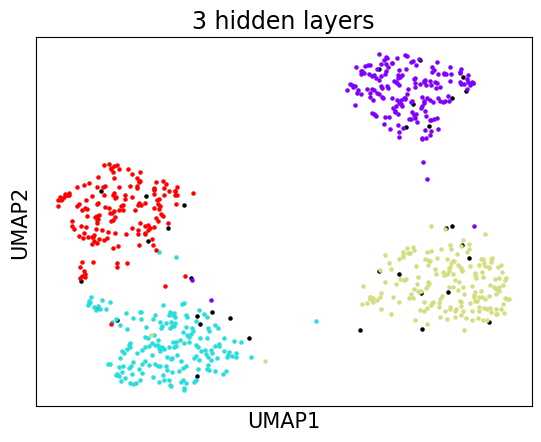

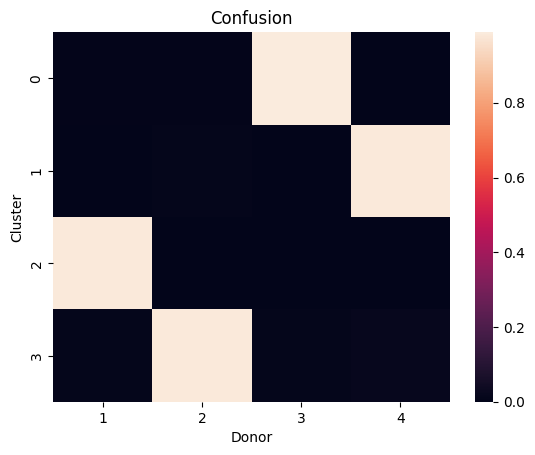

accuracy: 98.41569935172929
silhouette score: 0.6733572019358905


In [5]:
unnormalized_layer3_embedding_2d = unnormalized_layer3.embedding_2d

donor = pd.read_csv('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor4/donor_ids.tsv', sep = '\t').iloc[:, 1].to_numpy()[unnormalized_layer3.cell_filter]
name = ["MantonCB1", "MantonCB2", "MantonCB3", "MantonCB4", "doublet", "unassigned"]

clusters = []

for w in name:
    
    clusters.append(np.where(donor == w)[0])

fig, axs = plt.subplots(1, 1)

axs.scatter(unnormalized_layer3.embedding_2d[clusters[4], 0], unnormalized_layer3.embedding_2d[clusters[4], 1], s = 5, color = "black")

for t in range(4):
    
    axs.scatter(unnormalized_layer3.embedding_2d[clusters[t], 0], unnormalized_layer3.embedding_2d[clusters[t], 1], s = 5, color = unnormalized_layer3.colors[t])
    
axs.set_xticks([])
axs.set_yticks([])
axs.set_xlabel("UMAP1", fontsize = 15)
axs.set_ylabel("UMAP2", fontsize = 15)
axs.set_title("3 hidden layers", fontsize = 17)

plt.show()

name = ["MantonCB1", "MantonCB2", "MantonCB3", "MantonCB4", "doublet", "unassigned"]
reference = np.empty(unnormalized_layer3.cell_total)

for w in range(6):
    
    reference[np.where(donor == name[w])[0]] = w
    
reference = reference.astype(int)
    
matrix = np.zeros((4, 4))
ref_sum = np.zeros(4)

for q in range(unnormalized_layer3.cell_total):
    
    if reference[q] <= 3:

        matrix[reference[q], unnormalized_layer3.assigned_label[q]] += 1
        ref_sum[reference[q]] += 1

prop = matrix / np.outer(ref_sum, np.ones(4))

fig, ax = plt.subplots(1, 1)
ax = sns.heatmap(prop.T[[0, 1, 2, 3], :], xticklabels = [1, 2, 3, 4], yticklabels = [0, 1, 2, 3])
ax.set_ylabel("Cluster")
ax.set_xlabel("Donor")
ax.set_title("Confusion")
plt.show()

print(f'accuracy: {np.mean(np.max(prop, 1)) * 100}')
print(f'silhouette score: {silhouette_score(unnormalized_layer3.pair_embedding_3d[reference <= 3, :][:, reference <= 3], reference[reference <= 3], metric = "precomputed")}')

Start loading raw data.
Finish loading raw data.
Start filtering low-quality cells and SNPs.


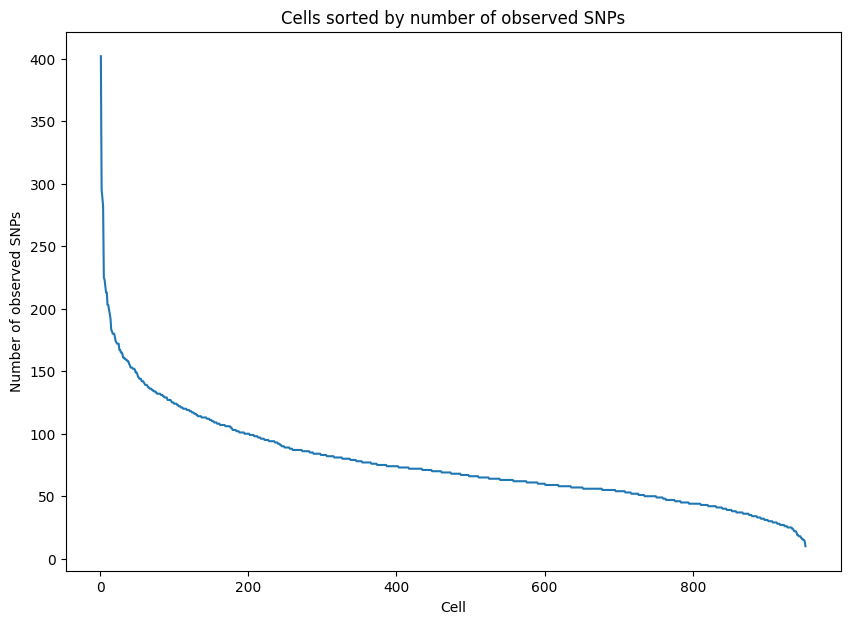

Please determine y-axis threshold in the plot to filter low-quality cells with low number of observed SNPs.   50


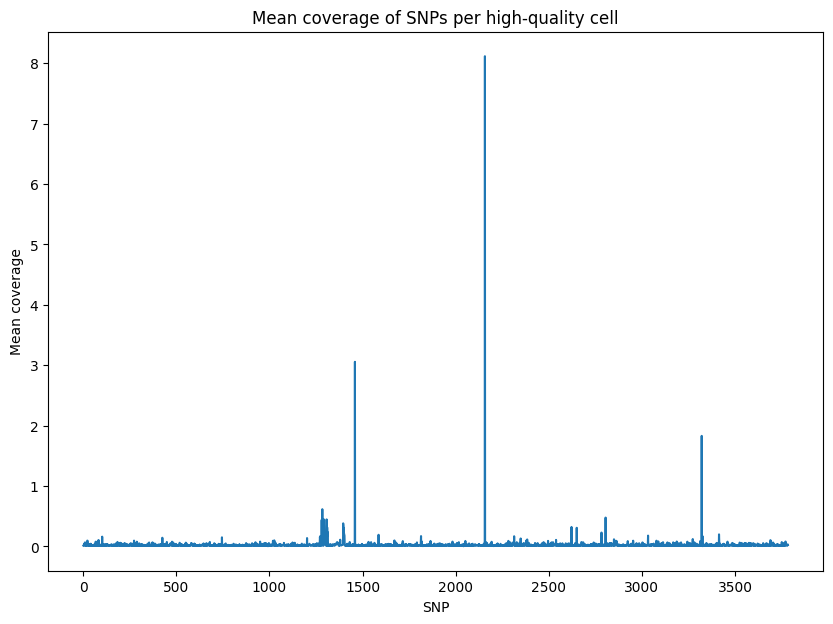

Please determine y-axis threshold in the plot to filter low-quality SNPs with low coverage.   0


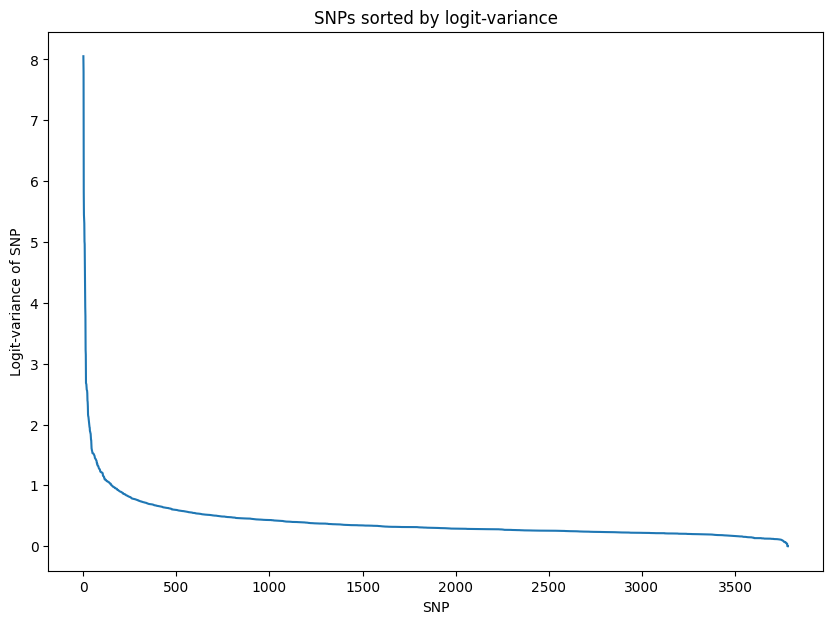

Please determine y-axis threshold in the plot to filter low-quality SNPs with low logit-variance.   0.3
Finish filtering low-quality data, 734 cells and 1905 SNPs will be used for downstream analysis.
Start training VAE.
Epoch[10/2000], Cost: 0.709858
Epoch[20/2000], Cost: 0.546676
Epoch[30/2000], Cost: 0.416017
Epoch[40/2000], Cost: 0.343871
Epoch[50/2000], Cost: 0.293287
Epoch[60/2000], Cost: 0.247053
Epoch[70/2000], Cost: 0.211123
Epoch[80/2000], Cost: 0.186195
Epoch[90/2000], Cost: 0.158484
Epoch[100/2000], Cost: 0.142208
Epoch[200/2000], Cost: 0.095978
Epoch[300/2000], Cost: 0.090842
Epoch[400/2000], Cost: 0.090983
Epoch[500/2000], Cost: 0.090158
Epoch[600/2000], Cost: 0.088915
Epoch[700/2000], Cost: 0.088915
Epoch[800/2000], Cost: 0.090050
Epoch[900/2000], Cost: 0.088290
Epoch[1000/2000], Cost: 0.089055
Epoch[1100/2000], Cost: 0.087901
Epoch[1200/2000], Cost: 0.088142
Epoch[1300/2000], Cost: 0.088285
Epoch[1400/2000], Cost: 0.088374
Epoch[1500/2000], Cost: 0.088176
Epoch[1600/200

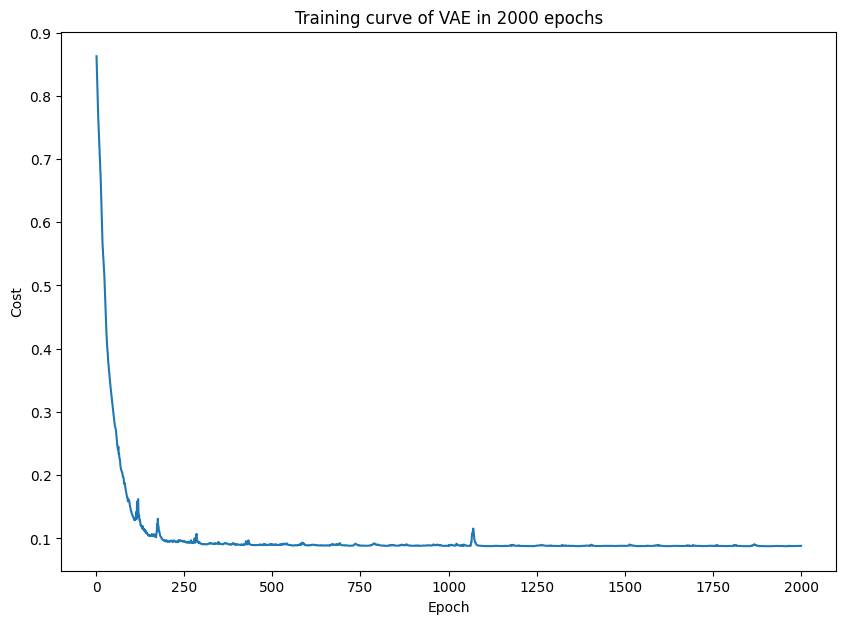

Start learning PCA and UMAP of latent space in VAE.
Finish learning, PCA and UMAP of latent space will be shown below.


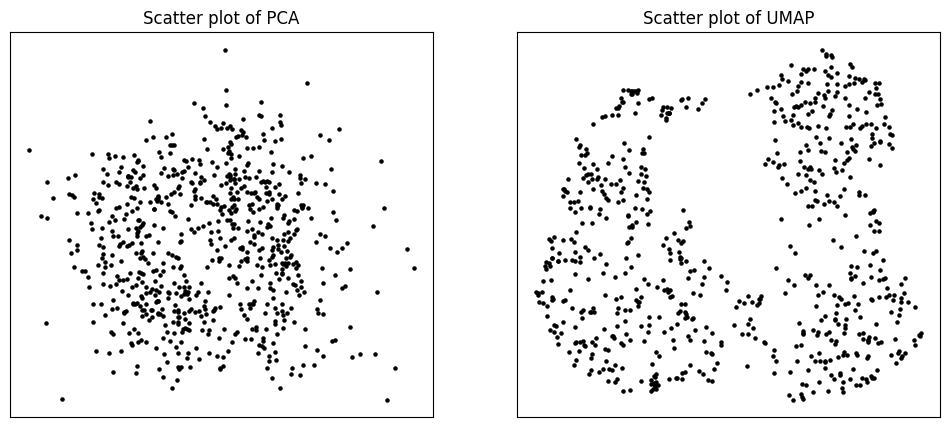

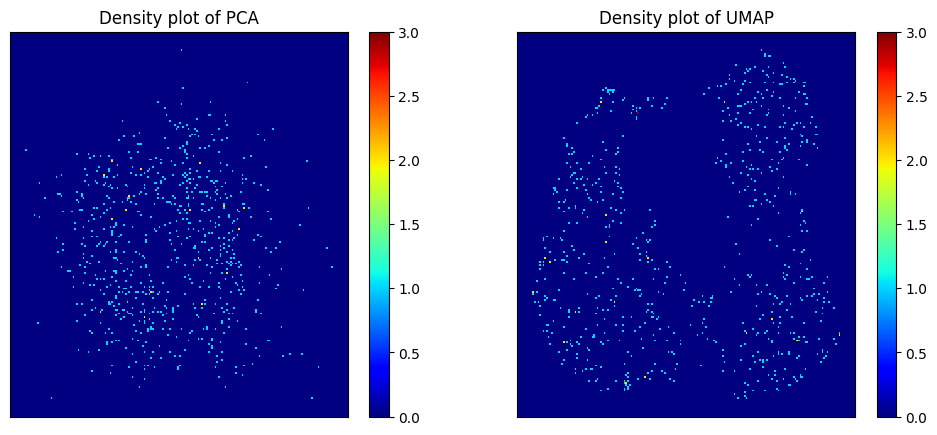

Start clustering.
2 clusters, Distortion: 2223.404541
3 clusters, Distortion: 1397.828735
4 clusters, Distortion: 878.531372
5 clusters, Distortion: 743.179565
6 clusters, Distortion: 669.018982
7 clusters, Distortion: 610.292847
8 clusters, Distortion: 560.188232
9 clusters, Distortion: 467.044678
10 clusters, Distortion: 470.379547
11 clusters, Distortion: 407.371613
12 clusters, Distortion: 359.053162
13 clusters, Distortion: 337.196747
14 clusters, Distortion: 321.545868
15 clusters, Distortion: 308.642548
Finish clustering, PCA, UMAP, distortion, silhouette score of K-means clustering will be shown below.


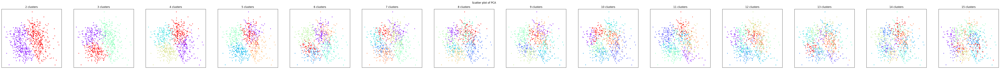

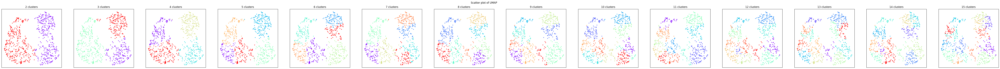

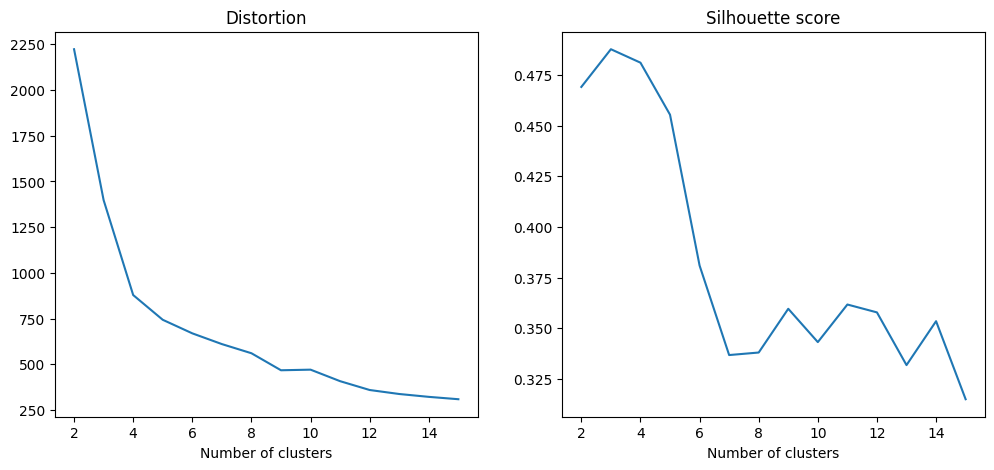

PCA and UMAP of individual clusters will be shown below.


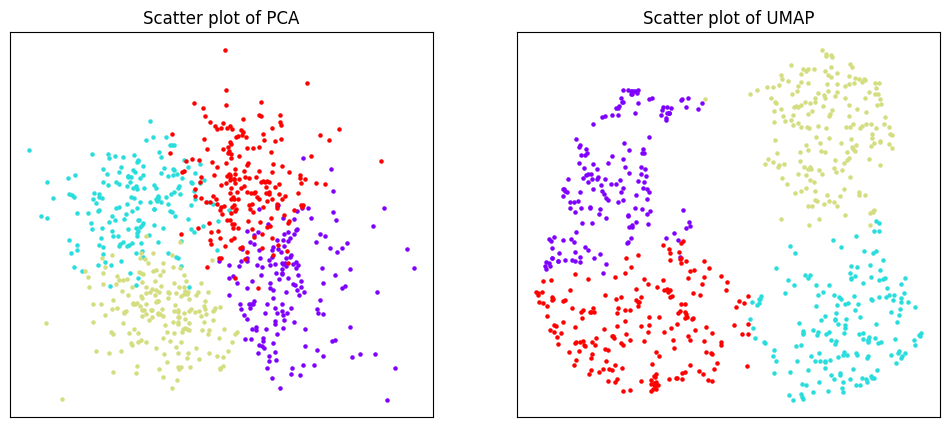

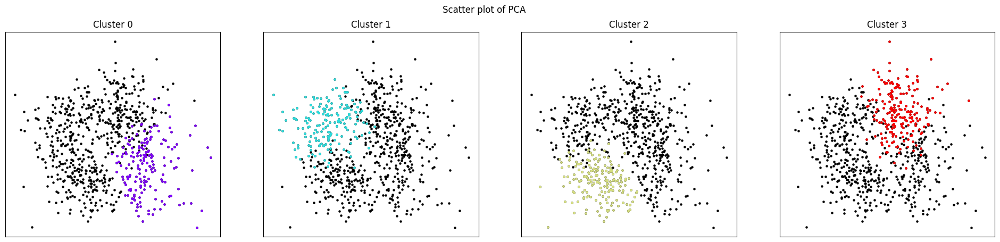

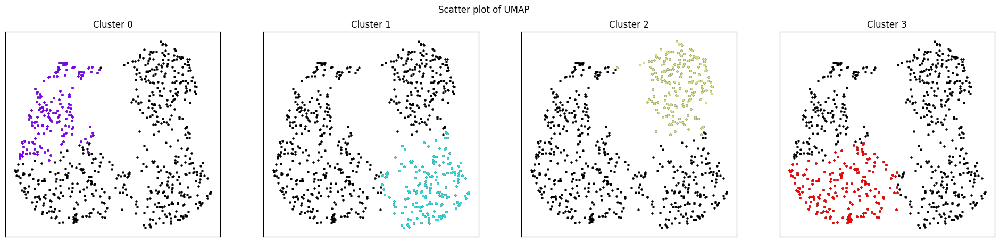

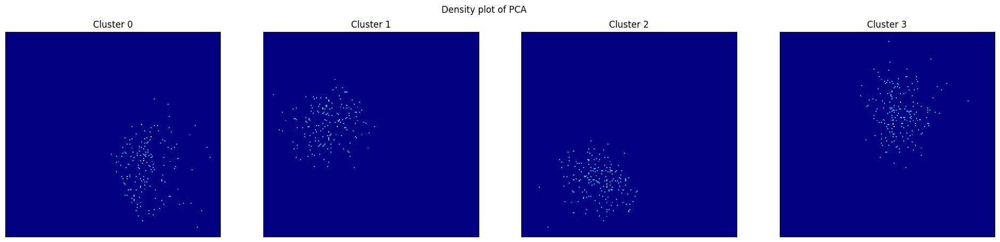

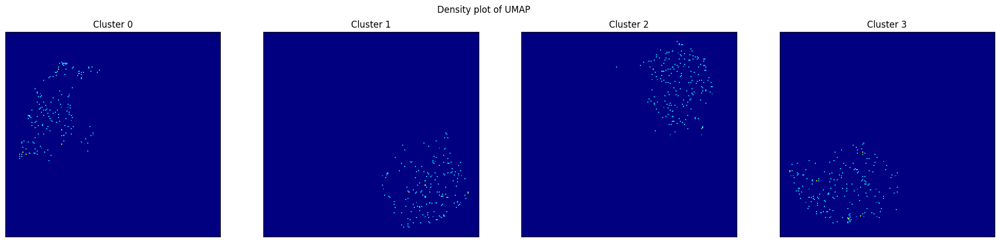

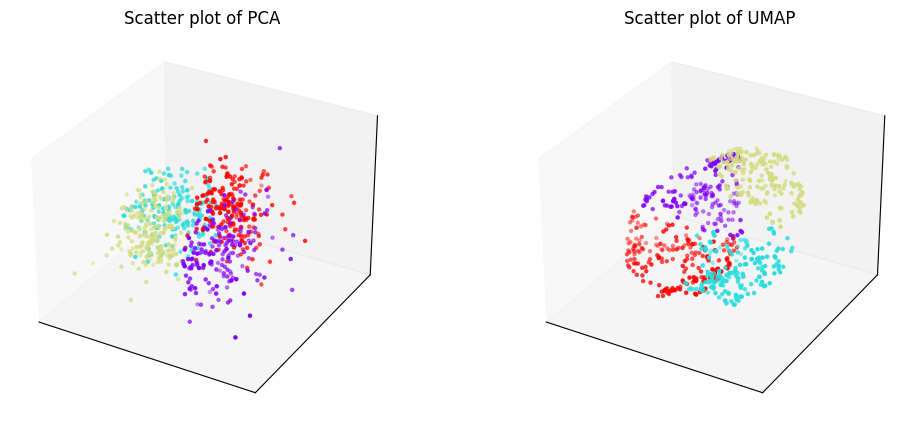

Phylogenetic tree in latent space will be shown below.


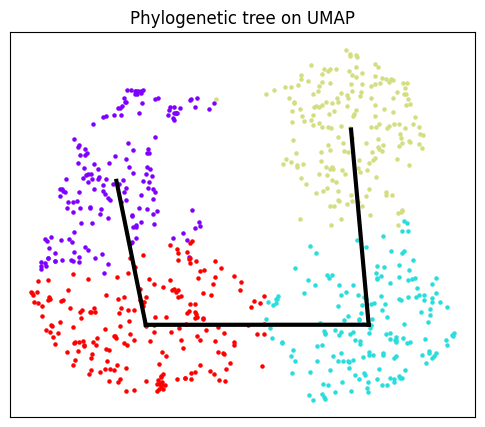

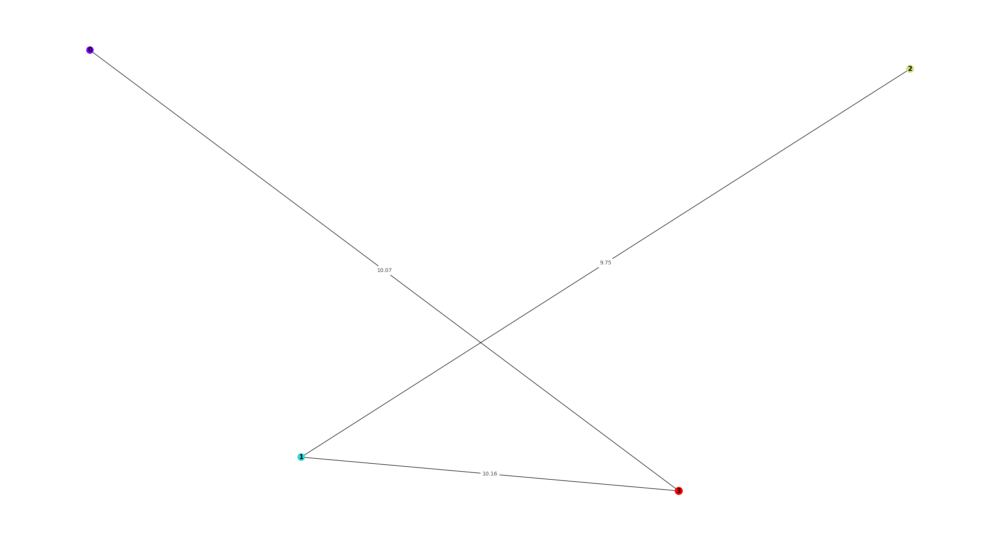

/tmp/ipykernel_1810892/2299804736.py:261: RuntimeWarning: divide by zero encountered in divide
  f_stat = np.clip(1 / ratio_logit_var, 1.001, 20)


SNP-allelic ratios of 734 cells and 50 SNPs will be shown below.


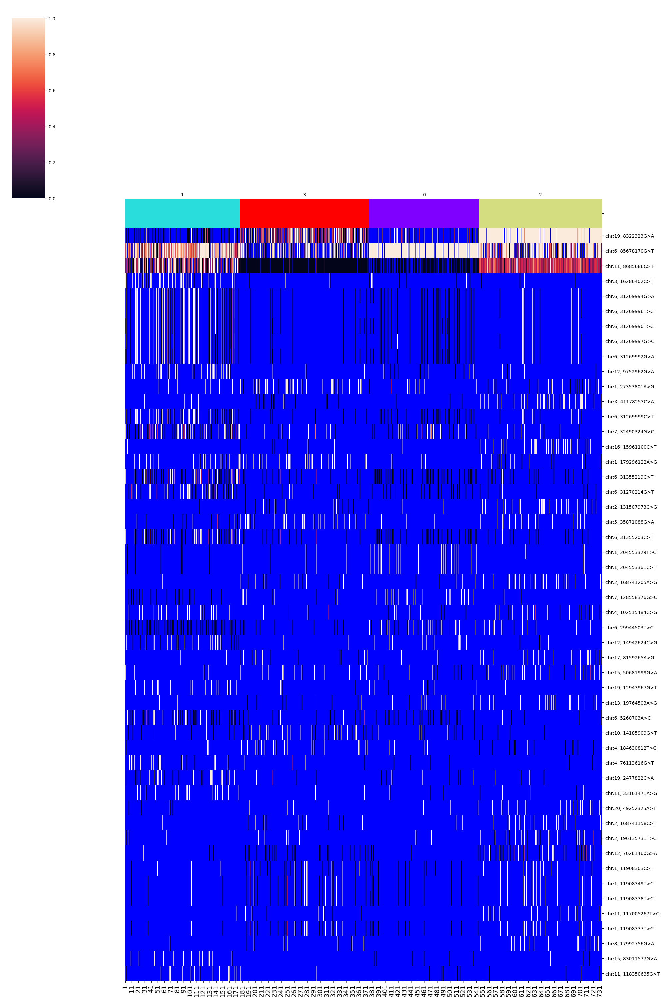

SNPs sorted by lowest p-value will be shown below


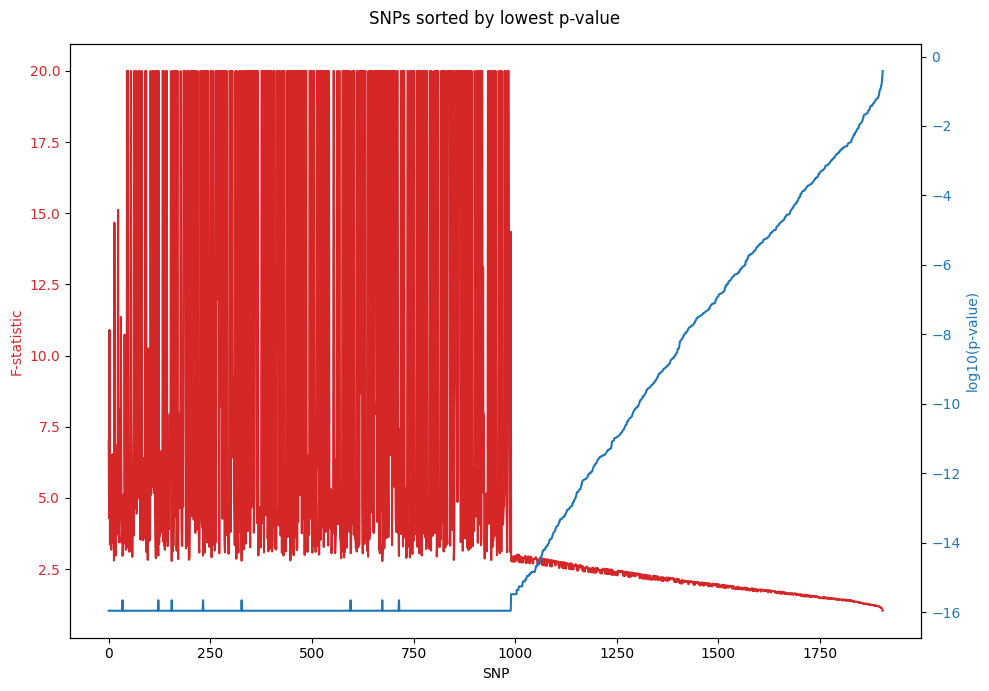

In [7]:
del unnormalized_layer3

%run /home/kevin/storage_kevin/past_figures/figures_final5/notebook/SNPmanifold-layer5_updated.ipynb

unnormalized_layer5 = SNP_VAE(AD = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor4/cellSNP.tag.AD.mtx", DP = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor4/cellSNP.tag.DP.mtx", VCF = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor4/cells.cellSNP.vcf.gz", SNPread = "unnormalized")
unnormalized_layer5.filtering()
unnormalized_layer5.training()
unnormalized_layer5.clustering(algorithm = "kmeans_umap3d")
unnormalized_layer5.phylogeny(cluster_no = 4)

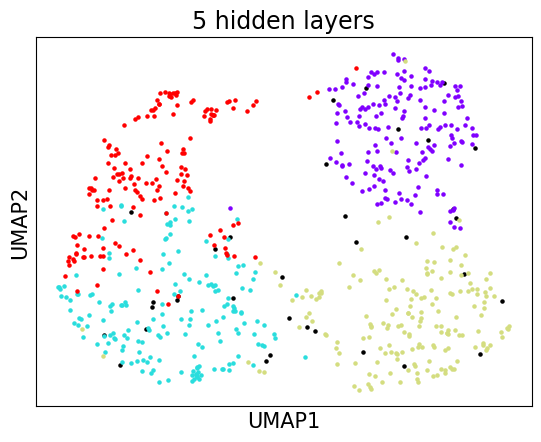

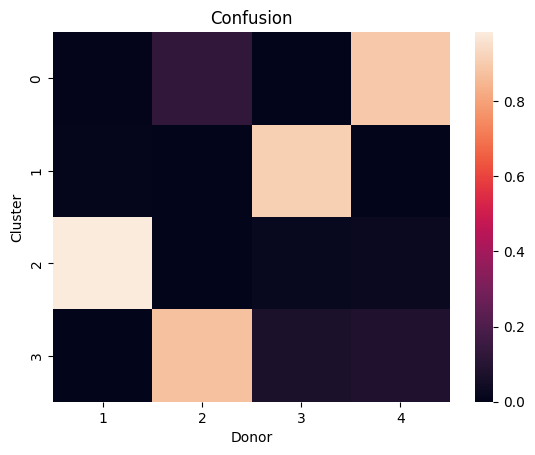

accuracy: 91.4148282026044
silhouette score: 0.4286374913910157


In [8]:
unnormalized_layer5_embedding_2d = unnormalized_layer5.embedding_2d

donor = pd.read_csv('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor4/donor_ids.tsv', sep = '\t').iloc[:, 1].to_numpy()[unnormalized_layer5.cell_filter]
name = ["MantonCB1", "MantonCB2", "MantonCB3", "MantonCB4", "doublet", "unassigned"]

clusters = []

for w in name:
    
    clusters.append(np.where(donor == w)[0])

fig, axs = plt.subplots(1, 1)

axs.scatter(unnormalized_layer5.embedding_2d[clusters[4], 0], unnormalized_layer5.embedding_2d[clusters[4], 1], s = 5, color = "black")

for t in range(4):
    
    axs.scatter(unnormalized_layer5.embedding_2d[clusters[t], 0], unnormalized_layer5.embedding_2d[clusters[t], 1], s = 5, color = unnormalized_layer5.colors[t])
    
axs.set_xticks([])
axs.set_yticks([])
axs.set_xlabel("UMAP1", fontsize = 15)
axs.set_ylabel("UMAP2", fontsize = 15)
axs.set_title("5 hidden layers", fontsize = 17)

plt.show()

name = ["MantonCB1", "MantonCB2", "MantonCB3", "MantonCB4", "doublet", "unassigned"]
reference = np.empty(unnormalized_layer5.cell_total)

for w in range(6):
    
    reference[np.where(donor == name[w])[0]] = w
    
reference = reference.astype(int)
    
matrix = np.zeros((4, 4))
ref_sum = np.zeros(4)

for q in range(unnormalized_layer5.cell_total):
    
    if reference[q] <= 3:

        matrix[reference[q], unnormalized_layer5.assigned_label[q]] += 1
        ref_sum[reference[q]] += 1

prop = matrix / np.outer(ref_sum, np.ones(4))

fig, ax = plt.subplots(1, 1)
ax = sns.heatmap(prop.T[[0, 1, 2, 3], :], xticklabels = [1, 2, 3, 4], yticklabels = [0, 1, 2, 3])
ax.set_ylabel("Cluster")
ax.set_xlabel("Donor")
ax.set_title("Confusion")
plt.show()

print(f'accuracy: {np.mean(np.max(prop, 1)) * 100}')
print(f'silhouette score: {silhouette_score(unnormalized_layer5.pair_embedding_3d[reference <= 3, :][:, reference <= 3], reference[reference <= 3], metric = "precomputed")}')

Start loading raw data.
Finish loading raw data.
Start filtering low-quality cells and SNPs.


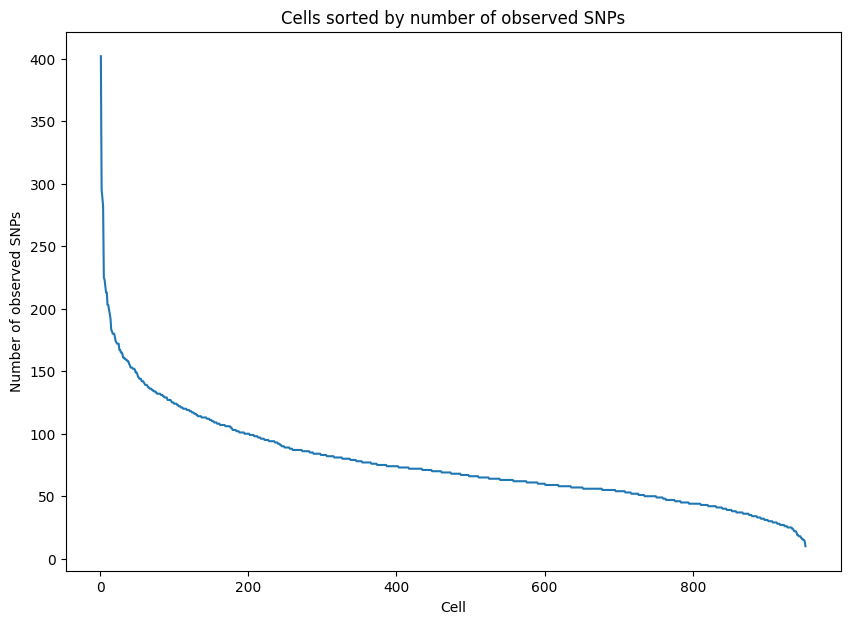

Please determine y-axis threshold in the plot to filter low-quality cells with low number of observed SNPs.   50


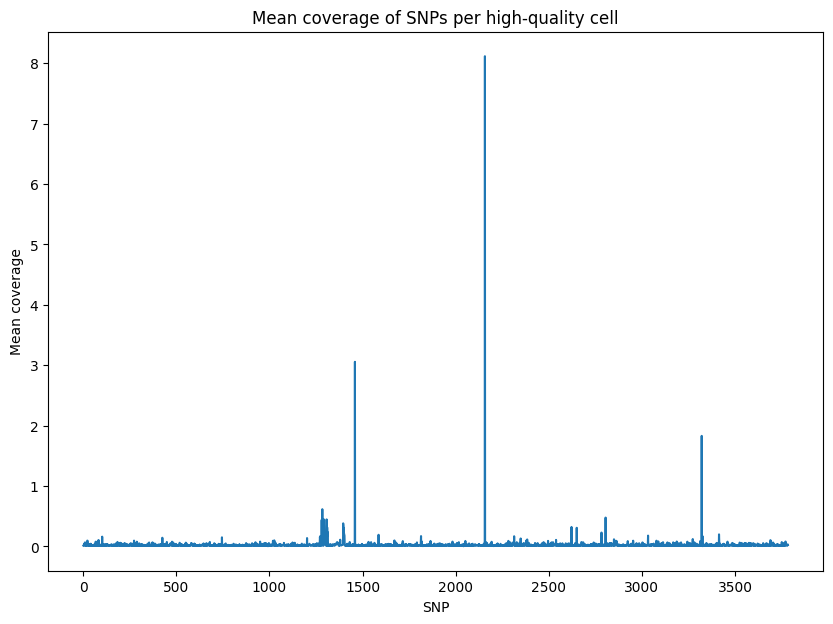

Please determine y-axis threshold in the plot to filter low-quality SNPs with low coverage.   0


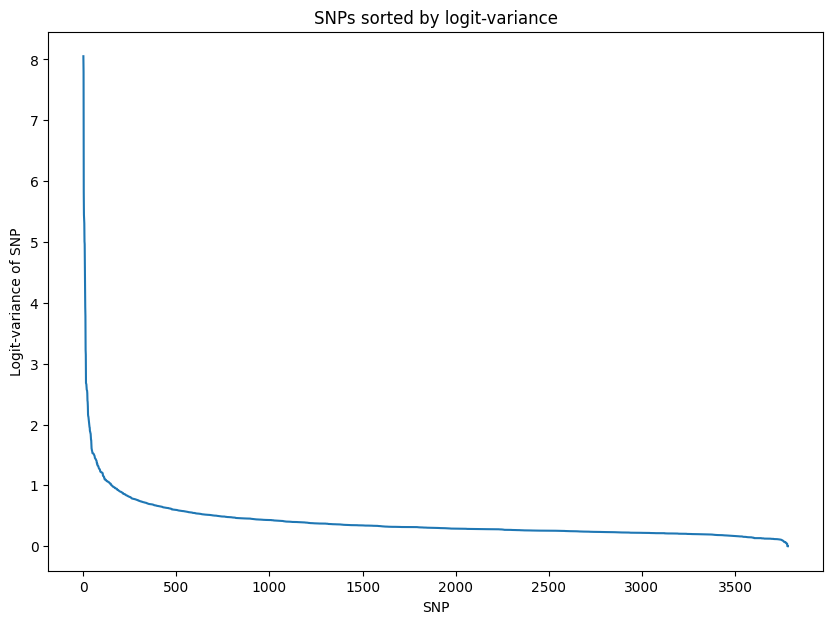

Please determine y-axis threshold in the plot to filter low-quality SNPs with low logit-variance.   0.3
Finish filtering low-quality data, 734 cells and 1905 SNPs will be used for downstream analysis.
Start training VAE.
Epoch[10/2000], Cost: 0.774479
Epoch[20/2000], Cost: 0.661722
Epoch[30/2000], Cost: 0.581734
Epoch[40/2000], Cost: 0.525382
Epoch[50/2000], Cost: 0.483177
Epoch[60/2000], Cost: 0.450913
Epoch[70/2000], Cost: 0.425994
Epoch[80/2000], Cost: 0.405582
Epoch[90/2000], Cost: 0.388573
Epoch[100/2000], Cost: 0.373733
Epoch[200/2000], Cost: 0.285285
Epoch[300/2000], Cost: 0.235783
Epoch[400/2000], Cost: 0.199425
Epoch[500/2000], Cost: 0.172357
Epoch[600/2000], Cost: 0.152452
Epoch[700/2000], Cost: 0.139306
Epoch[800/2000], Cost: 0.127703
Epoch[900/2000], Cost: 0.119646
Epoch[1000/2000], Cost: 0.114689
Epoch[1100/2000], Cost: 0.109636
Epoch[1200/2000], Cost: 0.106003
Epoch[1300/2000], Cost: 0.103628
Epoch[1400/2000], Cost: 0.100881
Epoch[1500/2000], Cost: 0.099619
Epoch[1600/200

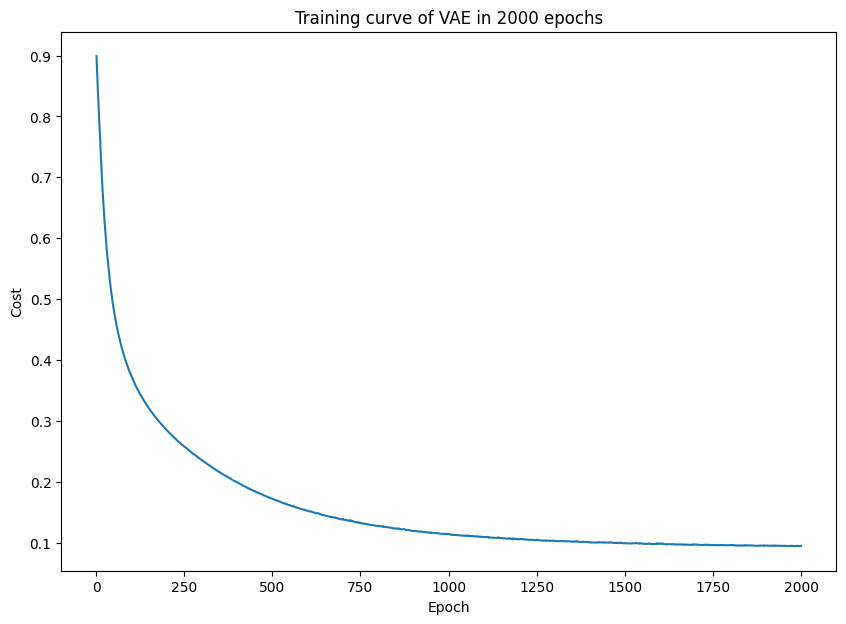

Start learning PCA and UMAP of latent space in VAE.
Finish learning, PCA and UMAP of latent space will be shown below.


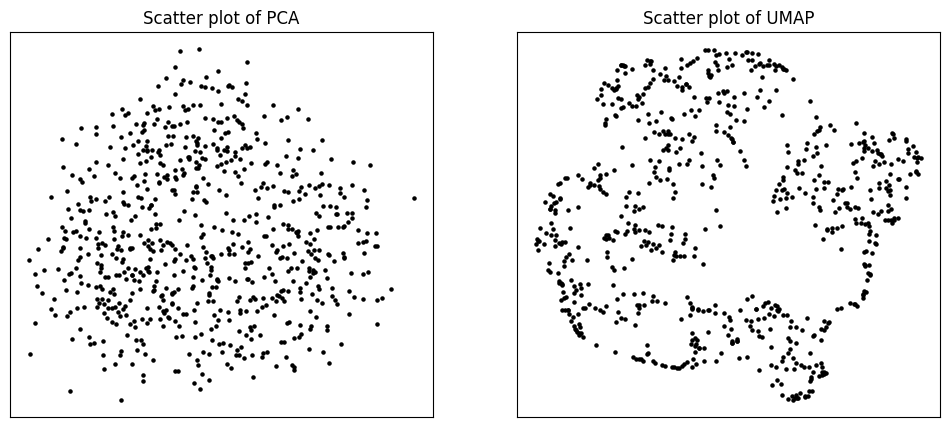

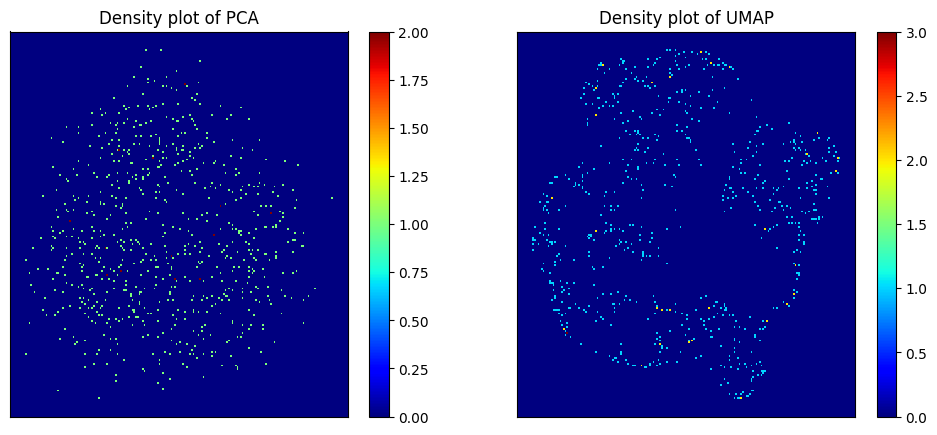

Start clustering.
2 clusters, Distortion: 3507.643066
3 clusters, Distortion: 2138.731934
4 clusters, Distortion: 1322.254883
5 clusters, Distortion: 1206.624023
6 clusters, Distortion: 1072.367310
7 clusters, Distortion: 981.978271
8 clusters, Distortion: 830.556885
9 clusters, Distortion: 722.653748
10 clusters, Distortion: 658.830322
11 clusters, Distortion: 571.651062
12 clusters, Distortion: 508.310883
13 clusters, Distortion: 445.710266
14 clusters, Distortion: 442.541565
15 clusters, Distortion: 408.104797
Finish clustering, PCA, UMAP, distortion, silhouette score of K-means clustering will be shown below.


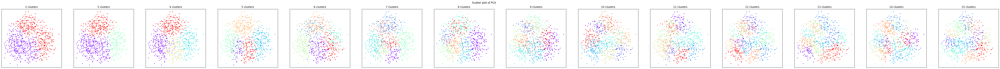

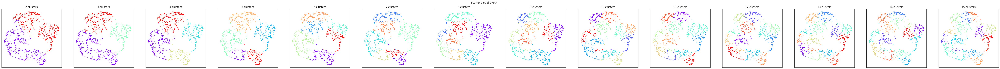

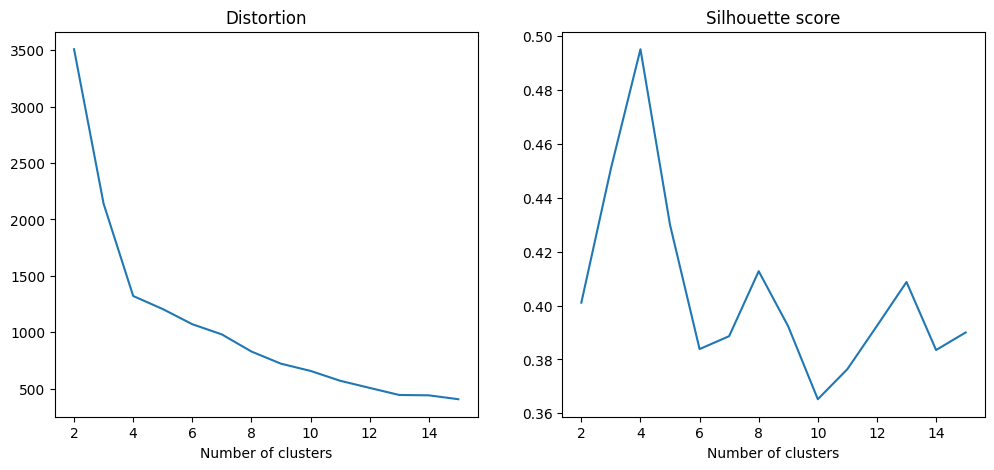

PCA and UMAP of individual clusters will be shown below.


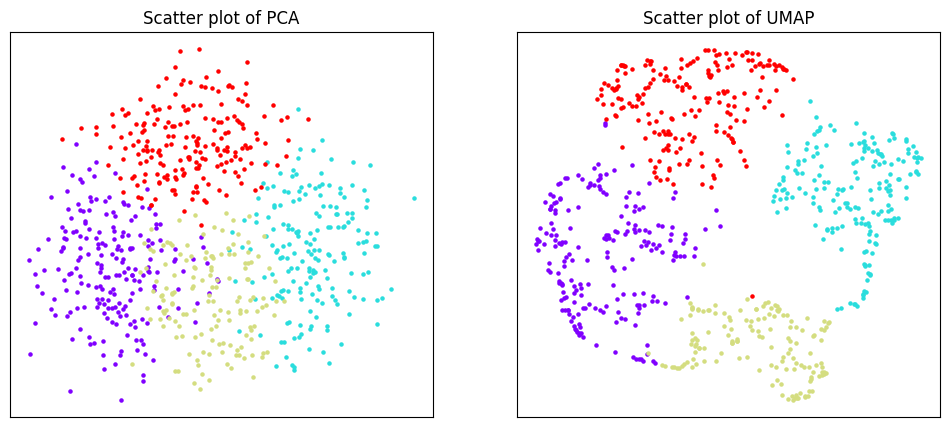

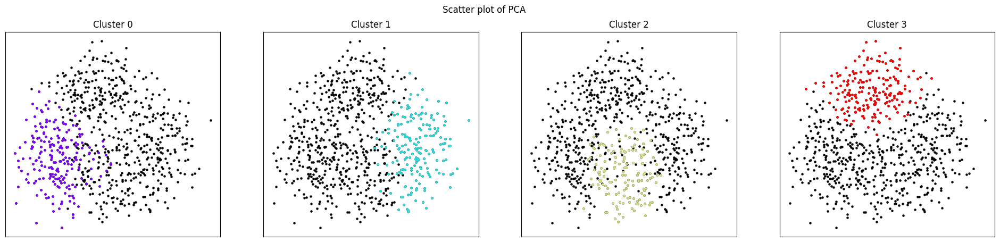

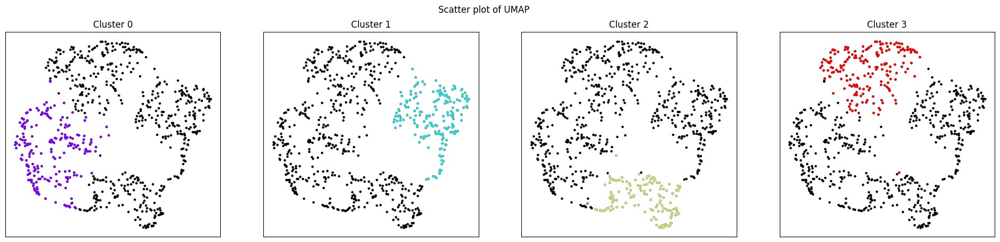

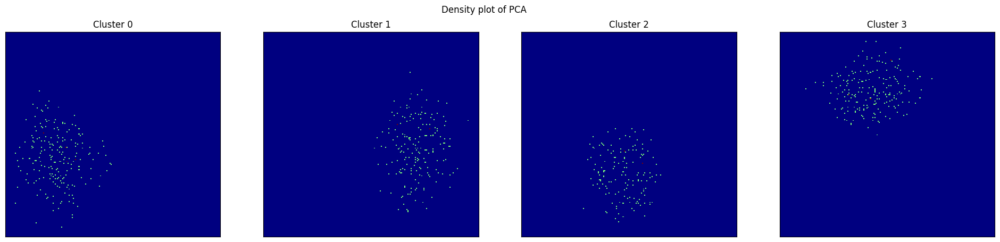

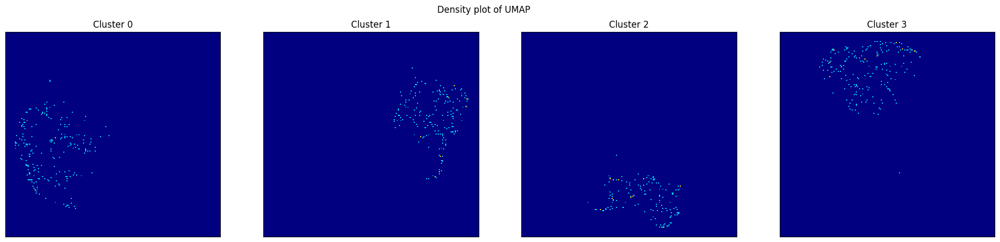

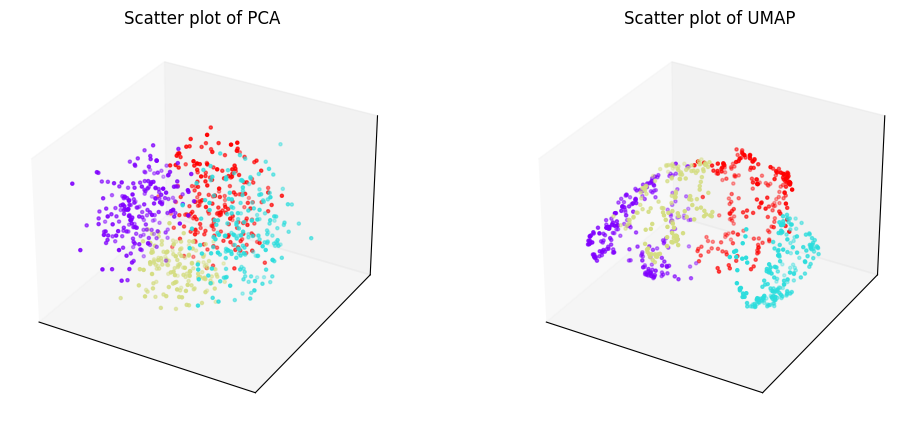

Phylogenetic tree in latent space will be shown below.


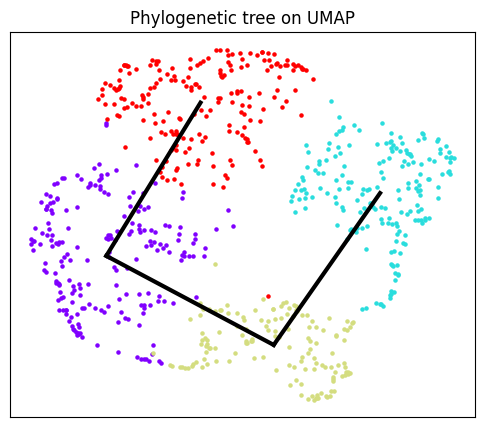

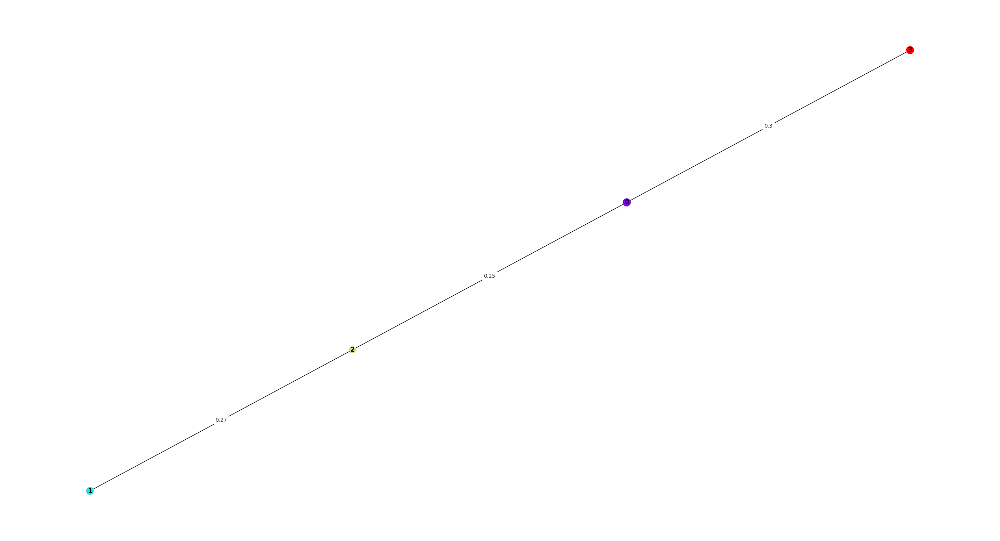

ValueError: could not broadcast input array from shape (3,) into shape (367,)

In [9]:
del unnormalized_layer5

%run /home/kevin/storage_kevin/past_figures/figures_final5/notebook/SNPmanifold-bmVAE_updated.ipynb

bmVAE = SNP_VAE(AD = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor4/cellSNP.tag.AD.mtx", DP = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor4/cellSNP.tag.DP.mtx", VCF = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor4/cells.cellSNP.vcf.gz", SNPread = "unnormalized")
bmVAE.filtering()
bmVAE.training(beta = 0.0001)
bmVAE.clustering(algorithm = "kmeans_umap3d")
bmVAE.phylogeny(cluster_no = 4)

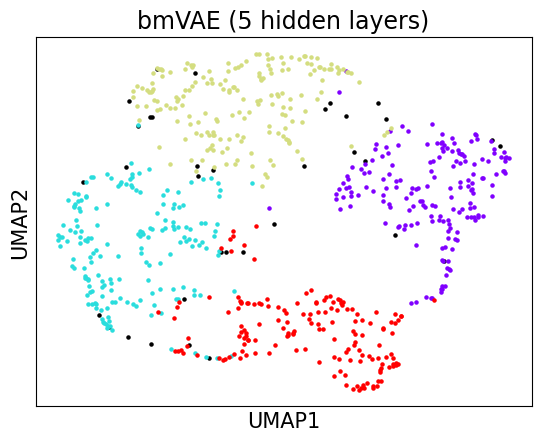

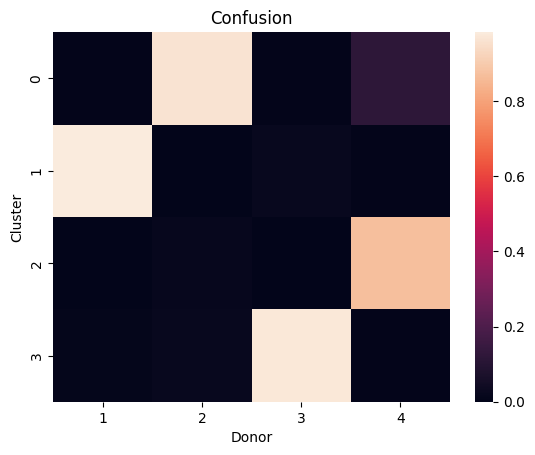

accuracy: 94.65527667469934
silhouette score: 0.47823795348915316


In [10]:
bmVAE_embedding_2d = bmVAE.embedding_2d

donor = pd.read_csv('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor4/donor_ids.tsv', sep = '\t').iloc[:, 1].to_numpy()[bmVAE.cell_filter]
name = ["MantonCB1", "MantonCB2", "MantonCB3", "MantonCB4", "doublet", "unassigned"]

clusters = []

for w in name:
    
    clusters.append(np.where(donor == w)[0])

fig, axs = plt.subplots(1, 1)

axs.scatter(bmVAE.embedding_2d[clusters[4], 0], bmVAE.embedding_2d[clusters[4], 1], s = 5, color = "black")

for t in range(4):
    
    axs.scatter(bmVAE.embedding_2d[clusters[t], 0], bmVAE.embedding_2d[clusters[t], 1], s = 5, color = bmVAE.colors[t])
    
axs.set_xticks([])
axs.set_yticks([])
axs.set_xlabel("UMAP1", fontsize = 15)
axs.set_ylabel("UMAP2", fontsize = 15)
axs.set_title("bmVAE (5 hidden layers)", fontsize = 17)

plt.show()

name = ["MantonCB1", "MantonCB2", "MantonCB3", "MantonCB4", "doublet", "unassigned"]
reference = np.empty(bmVAE.cell_total)

for w in range(6):
    
    reference[np.where(donor == name[w])[0]] = w
    
reference = reference.astype(int)
    
matrix = np.zeros((4, 4))
ref_sum = np.zeros(4)

for q in range(bmVAE.cell_total):
    
    if reference[q] <= 3:

        matrix[reference[q], bmVAE.assigned_label[q]] += 1
        ref_sum[reference[q]] += 1

prop = matrix / np.outer(ref_sum, np.ones(4))

fig, ax = plt.subplots(1, 1)
ax = sns.heatmap(prop.T[[0, 1, 2, 3], :], xticklabels = [1, 2, 3, 4], yticklabels = [0, 1, 2, 3])
ax.set_ylabel("Cluster")
ax.set_xlabel("Donor")
ax.set_title("Confusion")
plt.show()

print(f'accuracy: {np.mean(np.max(prop, 1)) * 100}')
print(f'silhouette score: {silhouette_score(bmVAE.pair_embedding_3d[reference <= 3, :][:, reference <= 3], reference[reference <= 3], metric = "precomputed")}')

Start loading raw data.
Finish loading raw data.
Start filtering low-quality cells and SNPs.


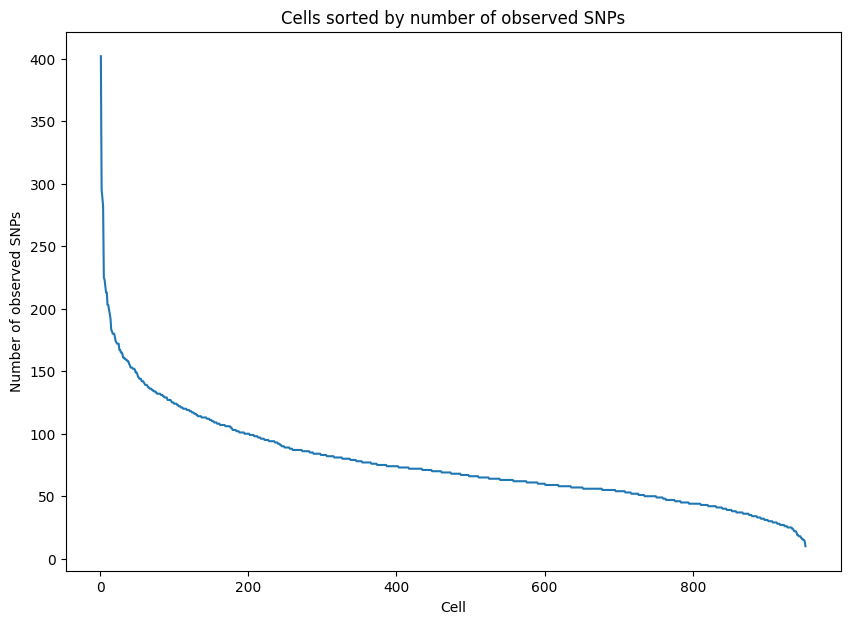

Please determine y-axis threshold in the plot to filter low-quality cells with low number of observed SNPs.   50


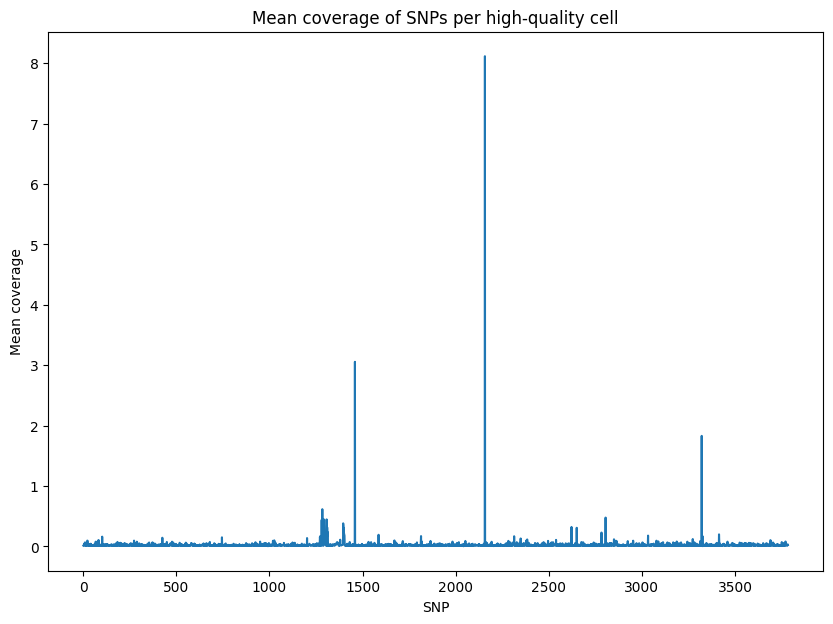

Please determine y-axis threshold in the plot to filter low-quality SNPs with low coverage.   0


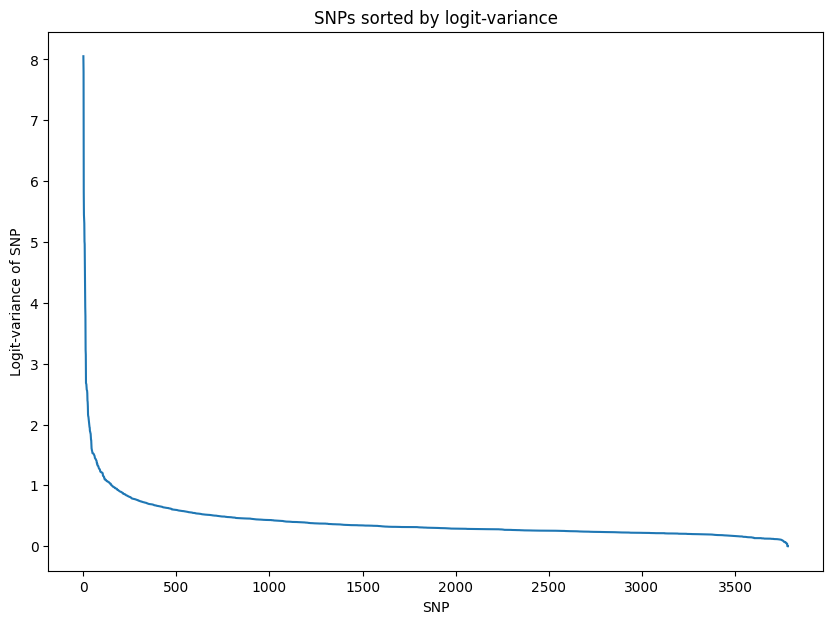

Please determine y-axis threshold in the plot to filter low-quality SNPs with low logit-variance.   0.3
Finish filtering low-quality data, 734 cells and 1905 SNPs will be used for downstream analysis.
Start training VAE.
Epoch[10/2000], Cost: 0.856598
Epoch[20/2000], Cost: 0.751886
Epoch[30/2000], Cost: 0.672388
Epoch[40/2000], Cost: 0.614831
Epoch[50/2000], Cost: 0.567301
Epoch[60/2000], Cost: 0.529139
Epoch[70/2000], Cost: 0.500478
Epoch[80/2000], Cost: 0.476933
Epoch[90/2000], Cost: 0.456274
Epoch[100/2000], Cost: 0.436900
Epoch[200/2000], Cost: 0.343803
Epoch[300/2000], Cost: 0.299674
Epoch[400/2000], Cost: 0.274822
Epoch[500/2000], Cost: 0.255496
Epoch[600/2000], Cost: 0.243905
Epoch[700/2000], Cost: 0.232541
Epoch[800/2000], Cost: 0.225387
Epoch[900/2000], Cost: 0.218688
Epoch[1000/2000], Cost: 0.214066
Epoch[1100/2000], Cost: 0.208021
Epoch[1200/2000], Cost: 0.204955
Epoch[1300/2000], Cost: 0.202122
Epoch[1400/2000], Cost: 0.200660
Epoch[1500/2000], Cost: 0.198031
Epoch[1600/200

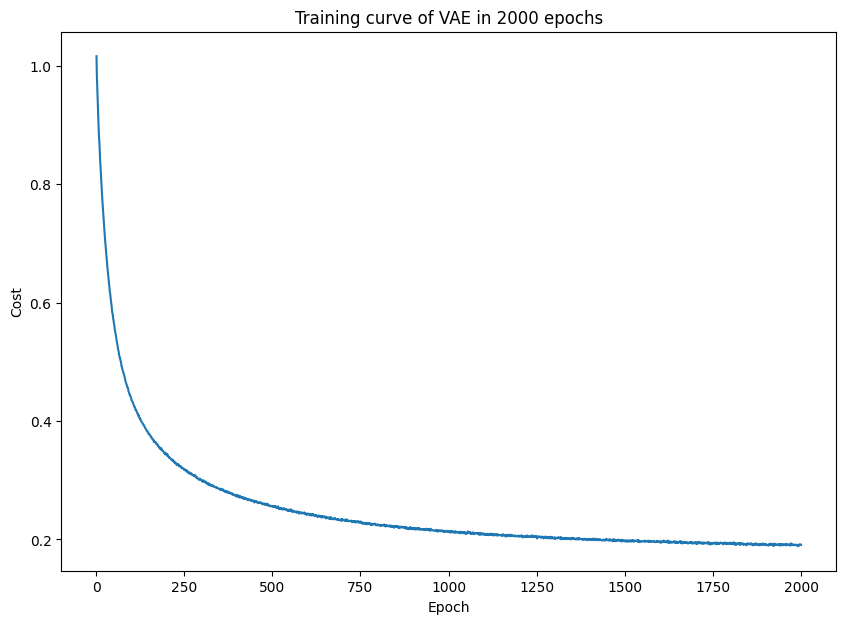

Start learning PCA and UMAP of latent space in VAE.
Finish learning, PCA and UMAP of latent space will be shown below.


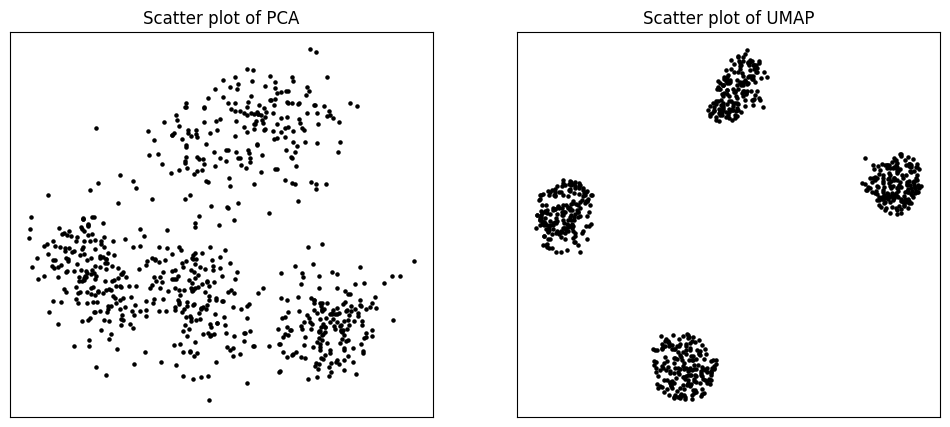

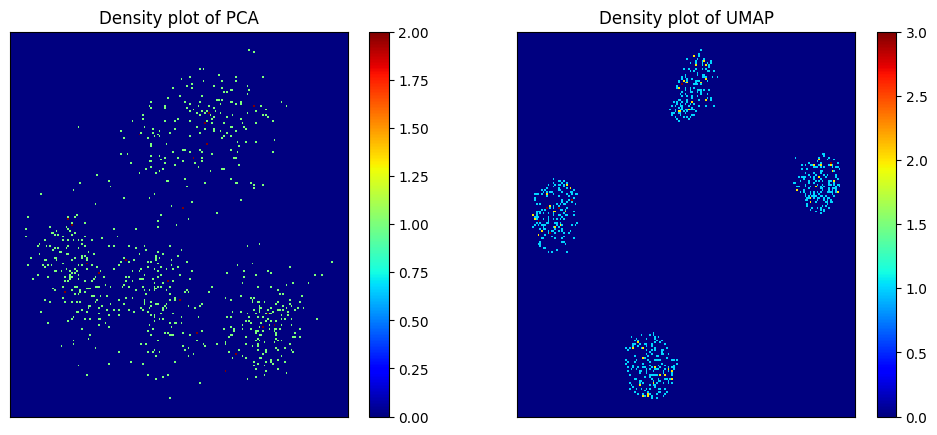

Start clustering.
2 clusters, Distortion: 7834.005859
3 clusters, Distortion: 3810.958252
4 clusters, Distortion: 323.649933
5 clusters, Distortion: 291.619141
6 clusters, Distortion: 262.169373
7 clusters, Distortion: 259.991486
8 clusters, Distortion: 230.760406
9 clusters, Distortion: 192.141373
10 clusters, Distortion: 182.673523
11 clusters, Distortion: 163.365005
12 clusters, Distortion: 153.807785
13 clusters, Distortion: 160.130981
14 clusters, Distortion: 138.473663
15 clusters, Distortion: 132.655548
Finish clustering, PCA, UMAP, distortion, silhouette score of K-means clustering will be shown below.


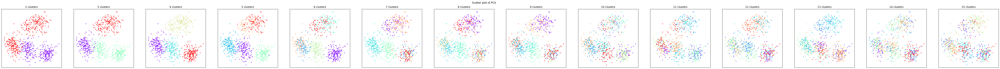

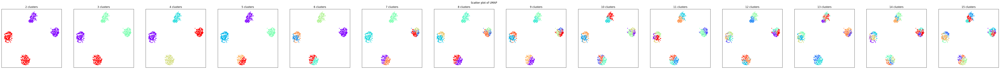

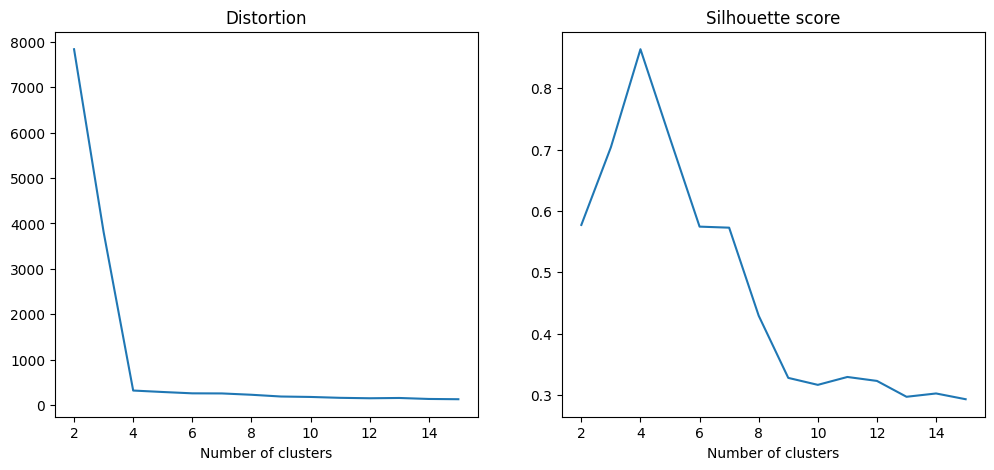

PCA and UMAP of individual clusters will be shown below.


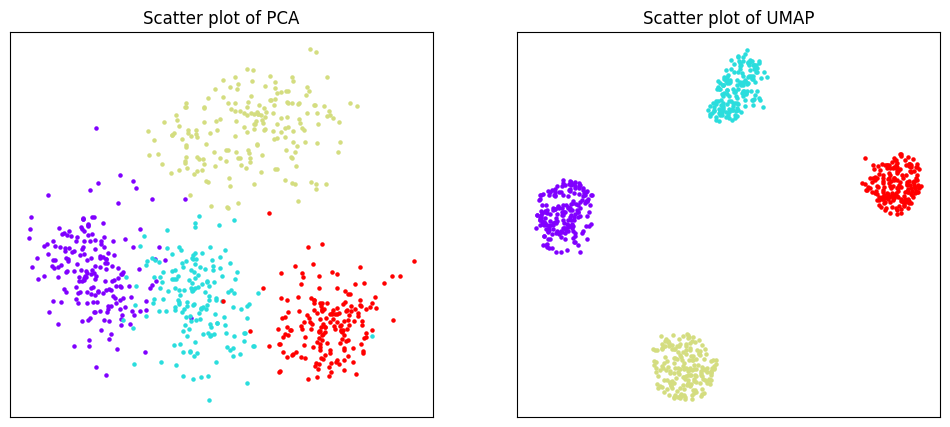

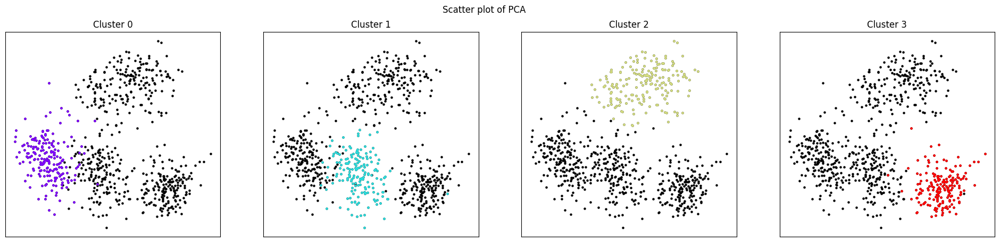

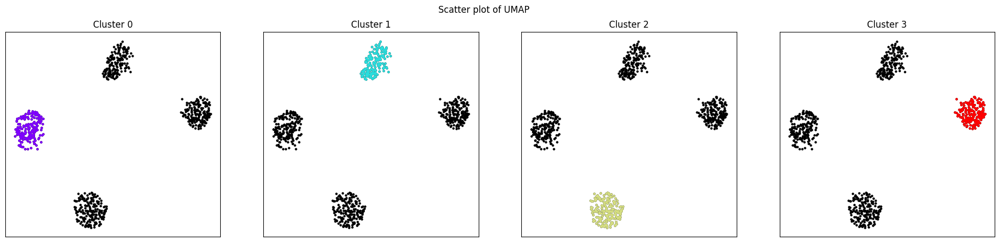

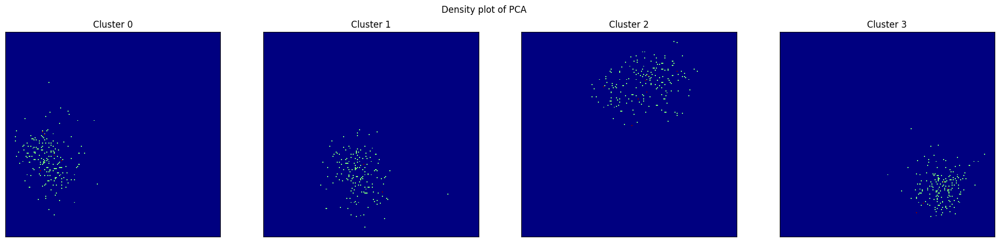

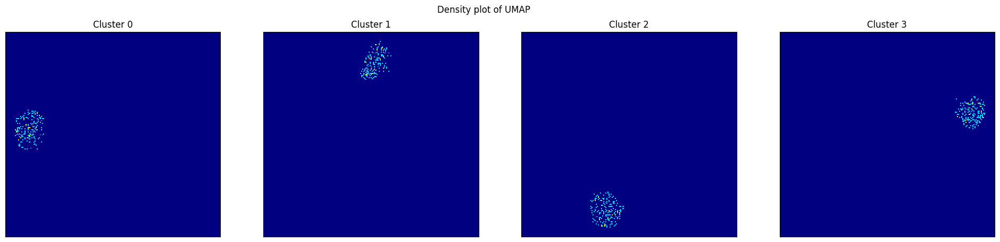

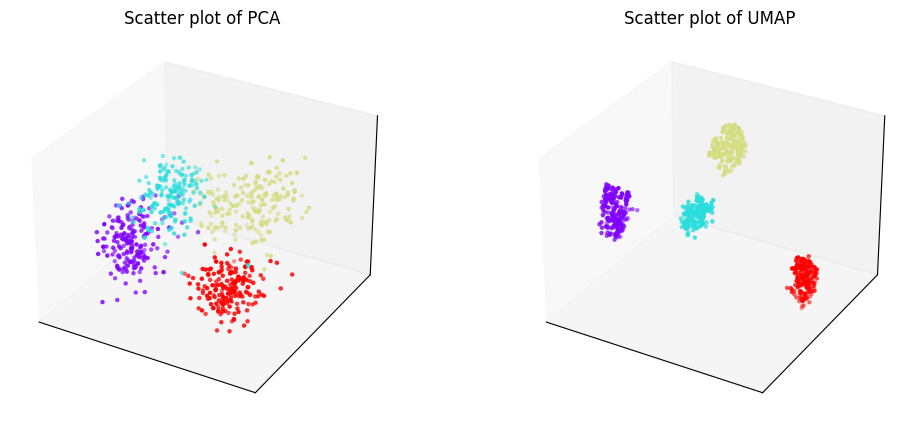

Phylogenetic tree in latent space will be shown below.


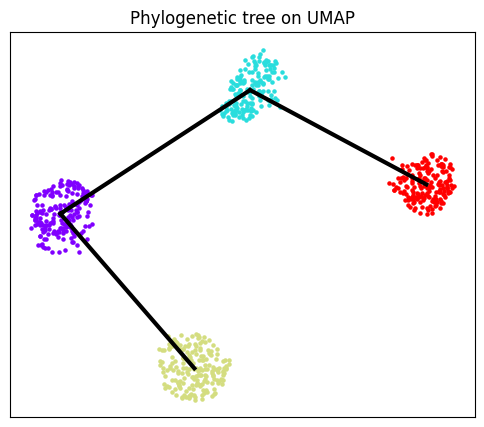

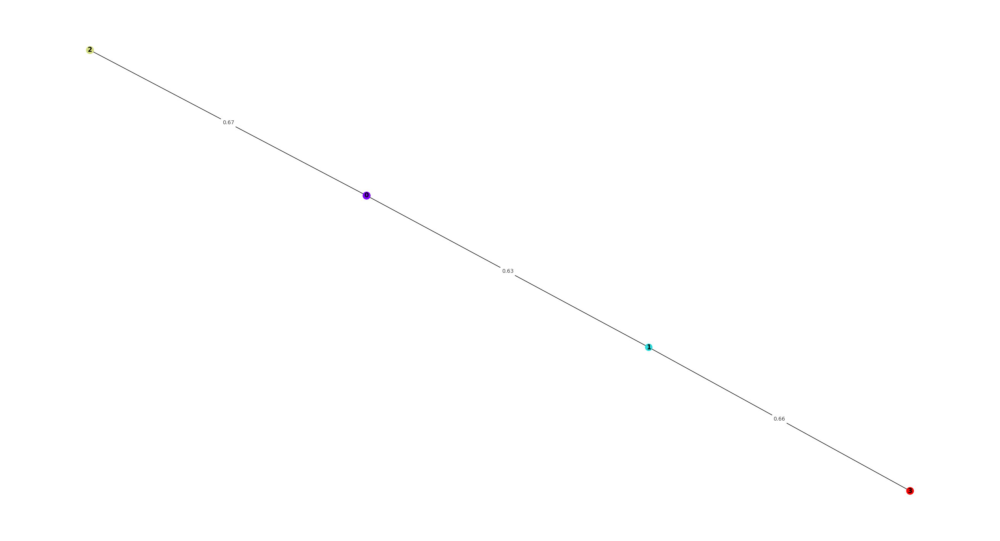

/tmp/ipykernel_1810892/2299804736.py:261: RuntimeWarning: divide by zero encountered in divide
  f_stat = np.clip(1 / ratio_logit_var, 1.001, 20)


SNP-allelic ratios of 734 cells and 50 SNPs will be shown below.


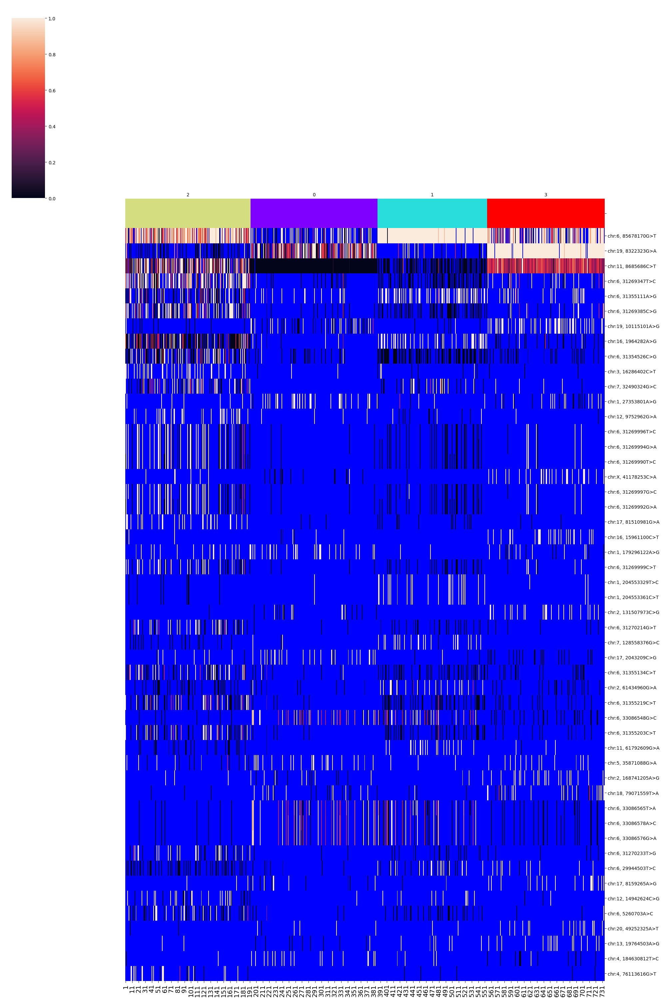

SNPs sorted by lowest p-value will be shown below


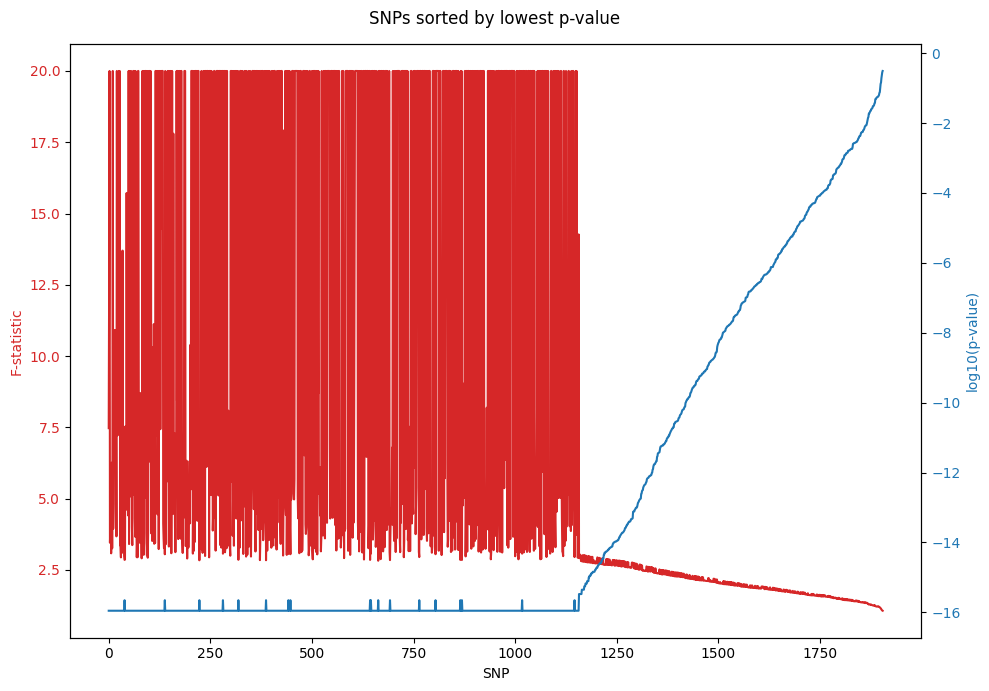

In [11]:
del bmVAE

%run /home/kevin/storage_kevin/past_figures/figures_final5/notebook/SNPmanifold.ipynb

b_05 = SNP_VAE(AD = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor4/cellSNP.tag.AD.mtx", DP = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor4/cellSNP.tag.DP.mtx", VCF = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor4/cells.cellSNP.vcf.gz")
b_05.filtering()
b_05.training(beta = 0.5)
b_05.clustering(algorithm = "kmeans_umap3d")
b_05.phylogeny(cluster_no = 4)

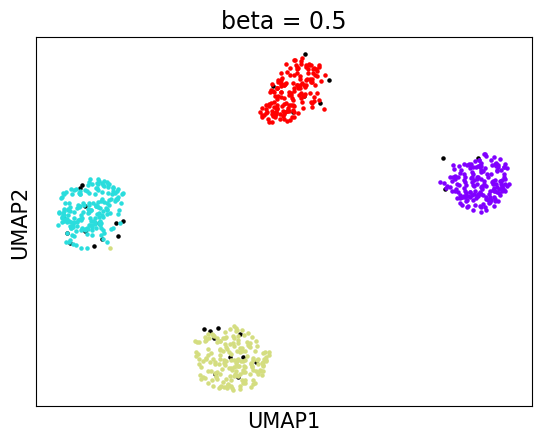

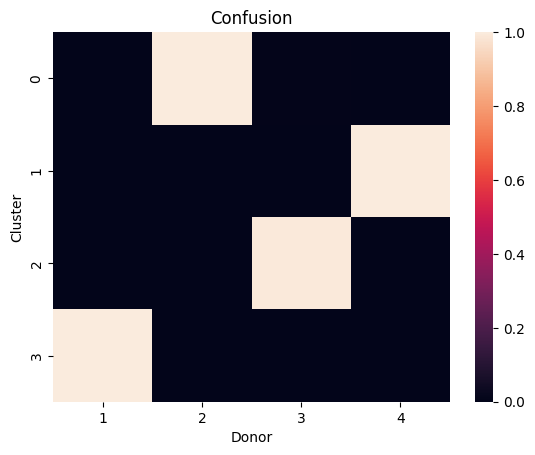

accuracy: 99.86338797814207
silhouette score: 0.8624997102315599


In [12]:
b_05_embedding_2d = b_05.embedding_2d

donor = pd.read_csv('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor4/donor_ids.tsv', sep = '\t').iloc[:, 1].to_numpy()[b_05.cell_filter]
name = ["MantonCB1", "MantonCB2", "MantonCB3", "MantonCB4", "doublet", "unassigned"]

clusters = []

for w in name:
    
    clusters.append(np.where(donor == w)[0])

fig, axs = plt.subplots(1, 1)

axs.scatter(b_05.embedding_2d[clusters[4], 0], b_05.embedding_2d[clusters[4], 1], s = 5, color = "black")

for t in range(4):
    
    axs.scatter(b_05.embedding_2d[clusters[t], 0], b_05.embedding_2d[clusters[t], 1], s = 5, color = b_05.colors[t])
    
axs.set_xticks([])
axs.set_yticks([])
axs.set_xlabel("UMAP1", fontsize = 15)
axs.set_ylabel("UMAP2", fontsize = 15)
axs.set_title("beta = 0.5", fontsize = 17)

plt.show()

name = ["MantonCB1", "MantonCB2", "MantonCB3", "MantonCB4", "doublet", "unassigned"]
reference = np.empty(b_05.cell_total)

for w in range(6):
    
    reference[np.where(donor == name[w])[0]] = w
    
reference = reference.astype(int)
    
matrix = np.zeros((4, 4))
ref_sum = np.zeros(4)

for q in range(b_05.cell_total):
    
    if reference[q] <= 3:

        matrix[reference[q], b_05.assigned_label[q]] += 1
        ref_sum[reference[q]] += 1

prop = matrix / np.outer(ref_sum, np.ones(4))

fig, ax = plt.subplots(1, 1)
ax = sns.heatmap(prop.T[[0, 1, 2, 3], :], xticklabels = [1, 2, 3, 4], yticklabels = [0, 1, 2, 3])
ax.set_ylabel("Cluster")
ax.set_xlabel("Donor")
ax.set_title("Confusion")
plt.show()

print(f'accuracy: {np.mean(np.max(prop, 1)) * 100}')
print(f'silhouette score: {silhouette_score(b_05.pair_embedding_3d[reference <= 3, :][:, reference <= 3], reference[reference <= 3], metric = "precomputed")}')

Start loading raw data.
Finish loading raw data.
Start filtering low-quality cells and SNPs.


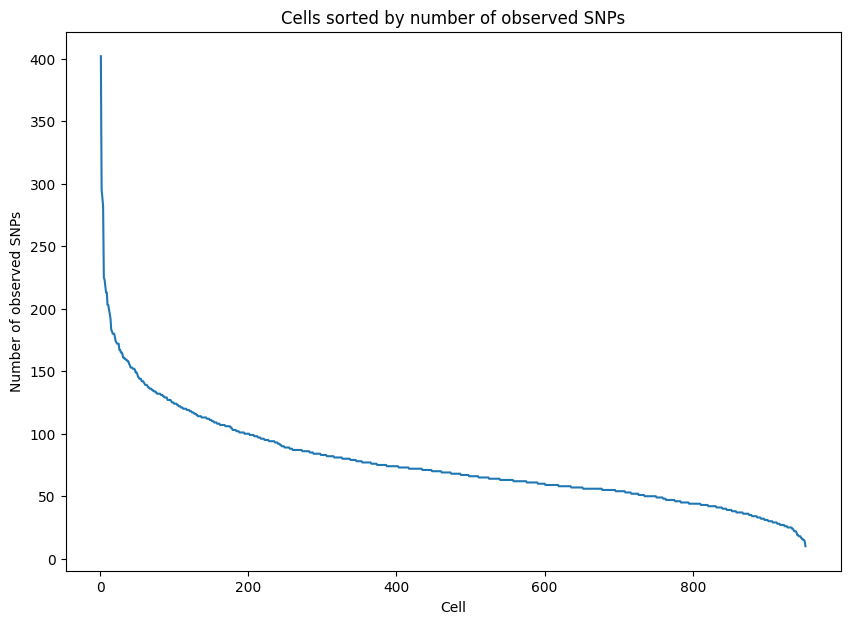

Please determine y-axis threshold in the plot to filter low-quality cells with low number of observed SNPs.   50


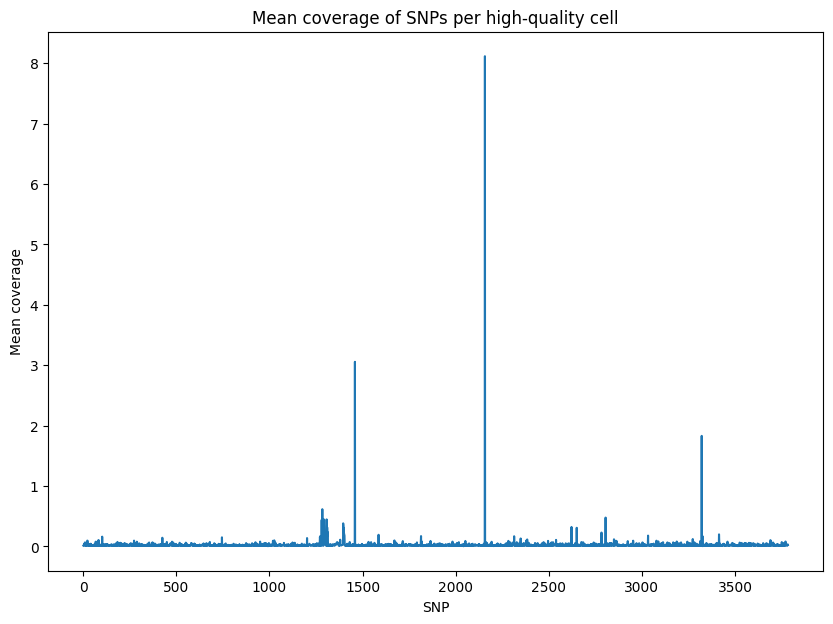

Please determine y-axis threshold in the plot to filter low-quality SNPs with low coverage.   0


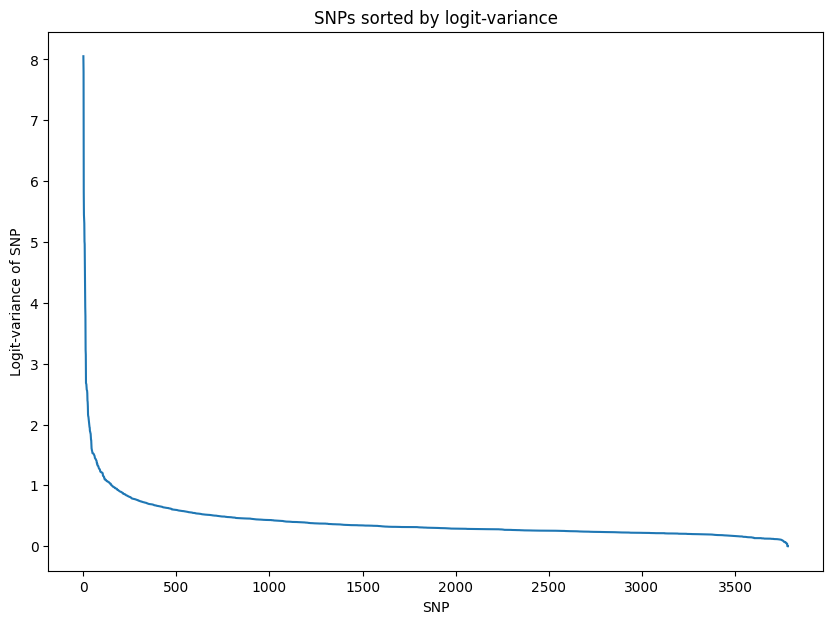

Please determine y-axis threshold in the plot to filter low-quality SNPs with low logit-variance.   0.3
Finish filtering low-quality data, 734 cells and 1905 SNPs will be used for downstream analysis.
Start training VAE.
Epoch[10/2000], Cost: 0.932998
Epoch[20/2000], Cost: 0.827765
Epoch[30/2000], Cost: 0.757388
Epoch[40/2000], Cost: 0.708455
Epoch[50/2000], Cost: 0.665719
Epoch[60/2000], Cost: 0.632219
Epoch[70/2000], Cost: 0.606161
Epoch[80/2000], Cost: 0.580893
Epoch[90/2000], Cost: 0.559740
Epoch[100/2000], Cost: 0.544960
Epoch[200/2000], Cost: 0.439613
Epoch[300/2000], Cost: 0.390224
Epoch[400/2000], Cost: 0.351176
Epoch[500/2000], Cost: 0.332732
Epoch[600/2000], Cost: 0.315224
Epoch[700/2000], Cost: 0.299773
Epoch[800/2000], Cost: 0.289205
Epoch[900/2000], Cost: 0.281906
Epoch[1000/2000], Cost: 0.274799
Epoch[1100/2000], Cost: 0.269246
Epoch[1200/2000], Cost: 0.263787
Epoch[1300/2000], Cost: 0.259871
Epoch[1400/2000], Cost: 0.256509
Epoch[1500/2000], Cost: 0.254690
Epoch[1600/200

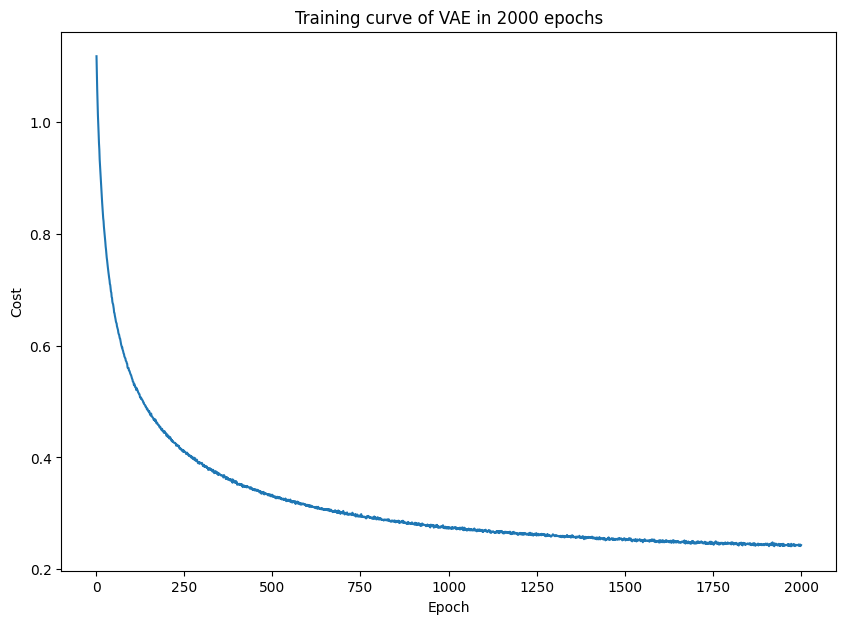

Start learning PCA and UMAP of latent space in VAE.
Finish learning, PCA and UMAP of latent space will be shown below.


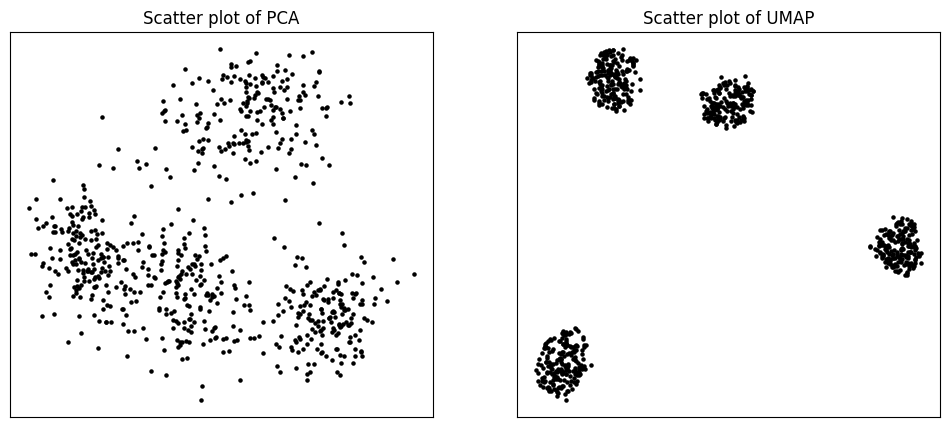

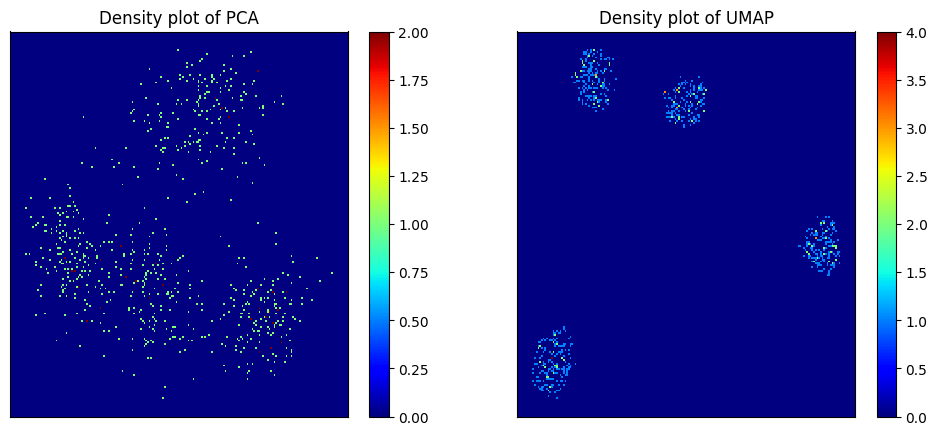

Start clustering.
2 clusters, Distortion: 8699.059570
3 clusters, Distortion: 2075.366699
4 clusters, Distortion: 318.318970
5 clusters, Distortion: 284.283417
6 clusters, Distortion: 267.160461
7 clusters, Distortion: 231.219574
8 clusters, Distortion: 226.684753
9 clusters, Distortion: 223.333893
10 clusters, Distortion: 182.512604
11 clusters, Distortion: 170.415344
12 clusters, Distortion: 165.437500
13 clusters, Distortion: 148.536636
14 clusters, Distortion: 143.486191
15 clusters, Distortion: 136.566101
Finish clustering, PCA, UMAP, distortion, silhouette score of K-means clustering will be shown below.


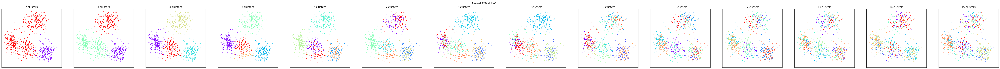

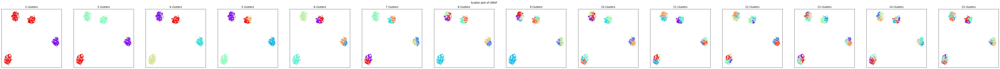

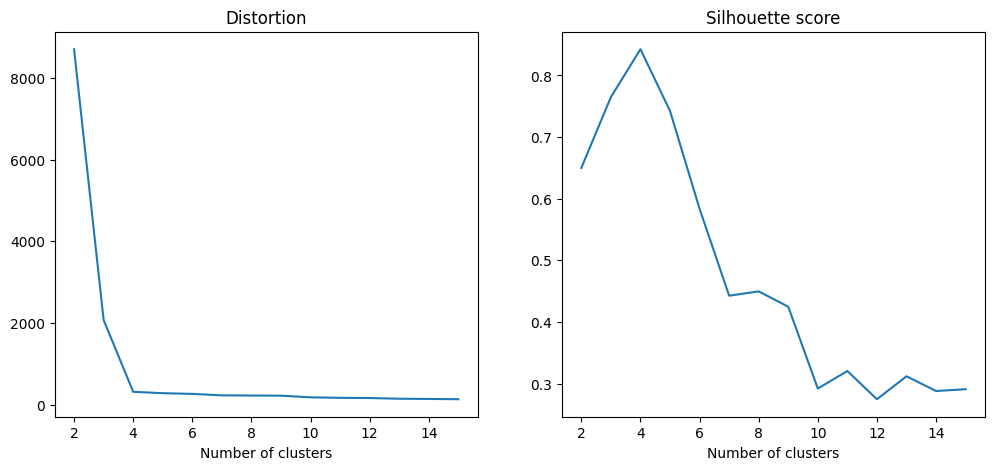

PCA and UMAP of individual clusters will be shown below.


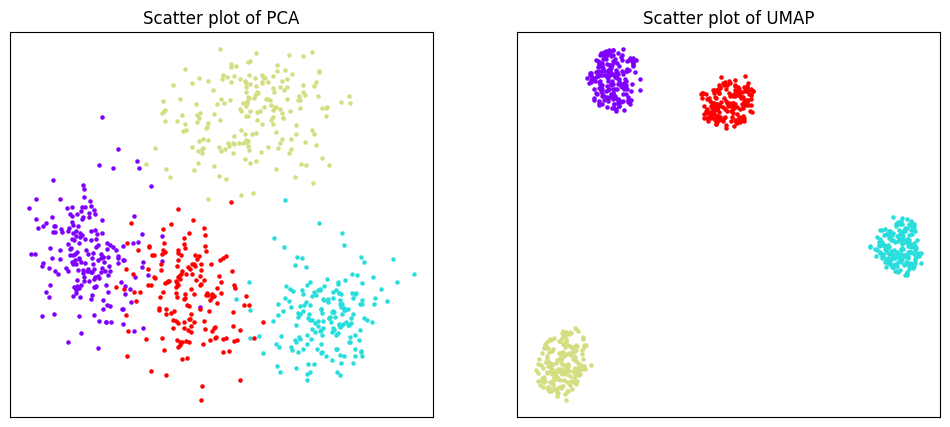

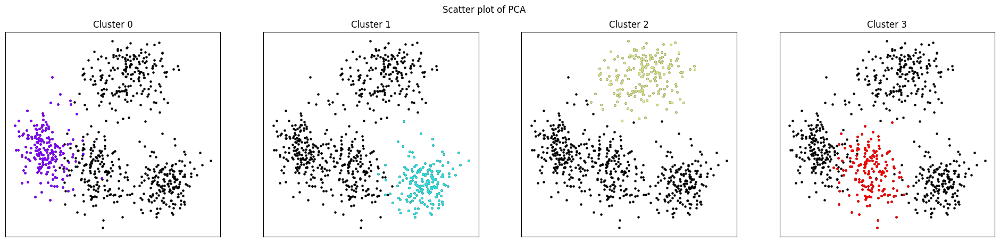

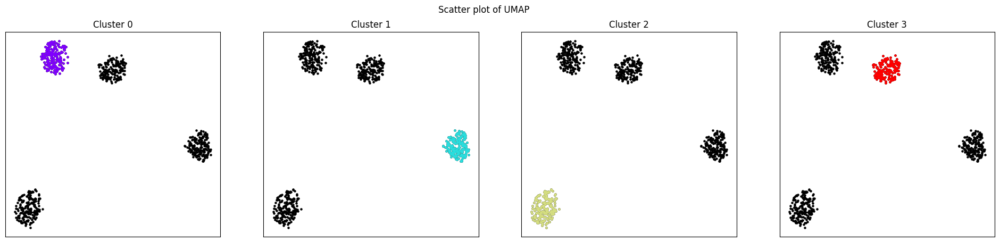

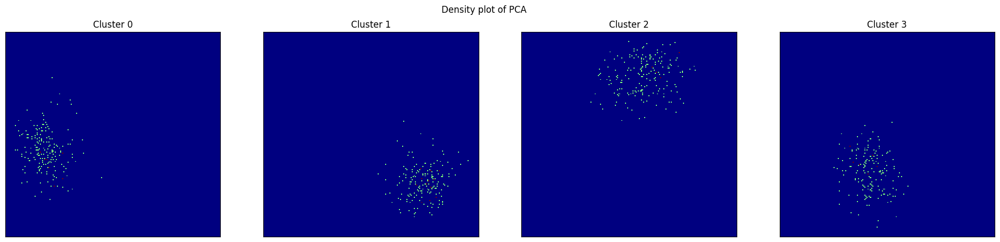

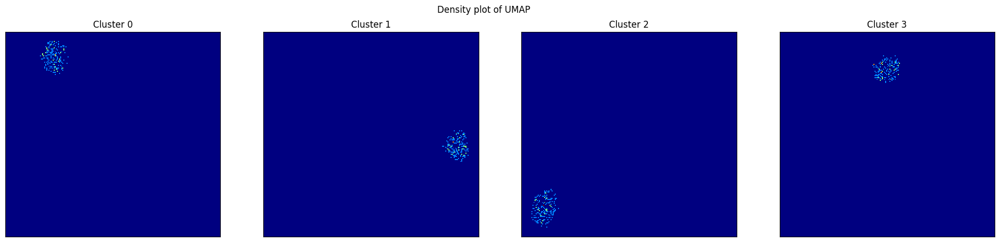

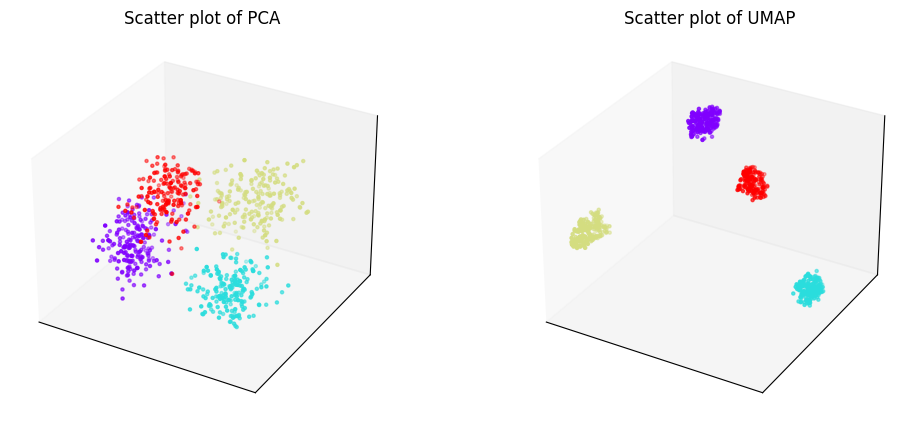

Phylogenetic tree in latent space will be shown below.


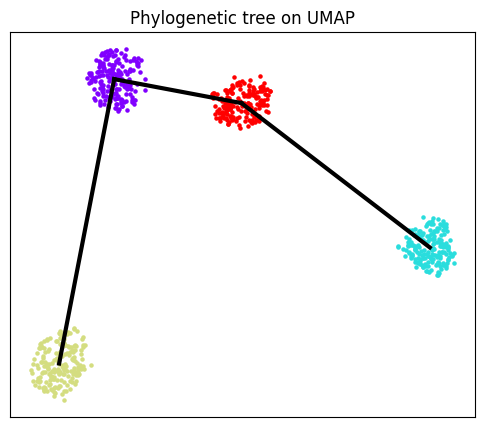

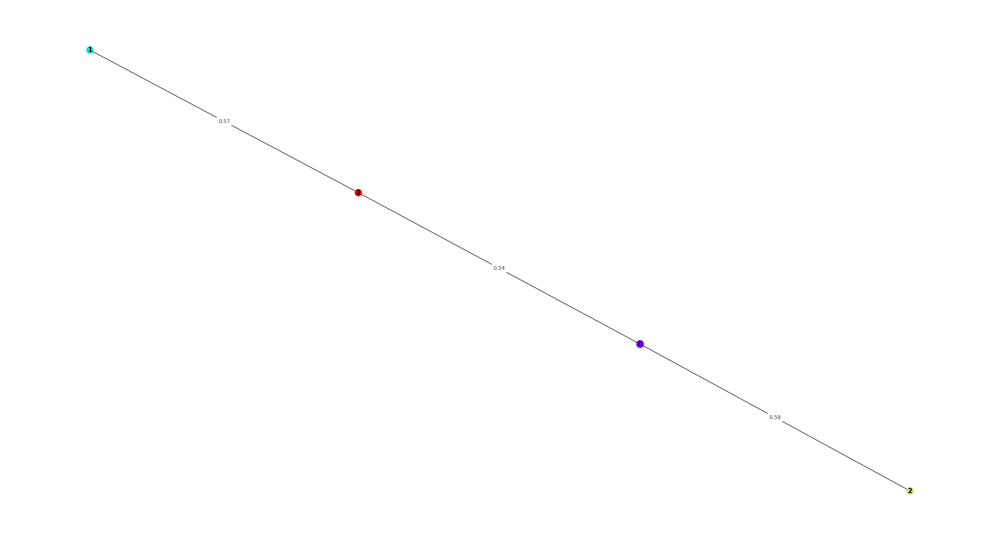

/tmp/ipykernel_1810892/2299804736.py:261: RuntimeWarning: divide by zero encountered in divide
  f_stat = np.clip(1 / ratio_logit_var, 1.001, 20)


SNP-allelic ratios of 734 cells and 50 SNPs will be shown below.


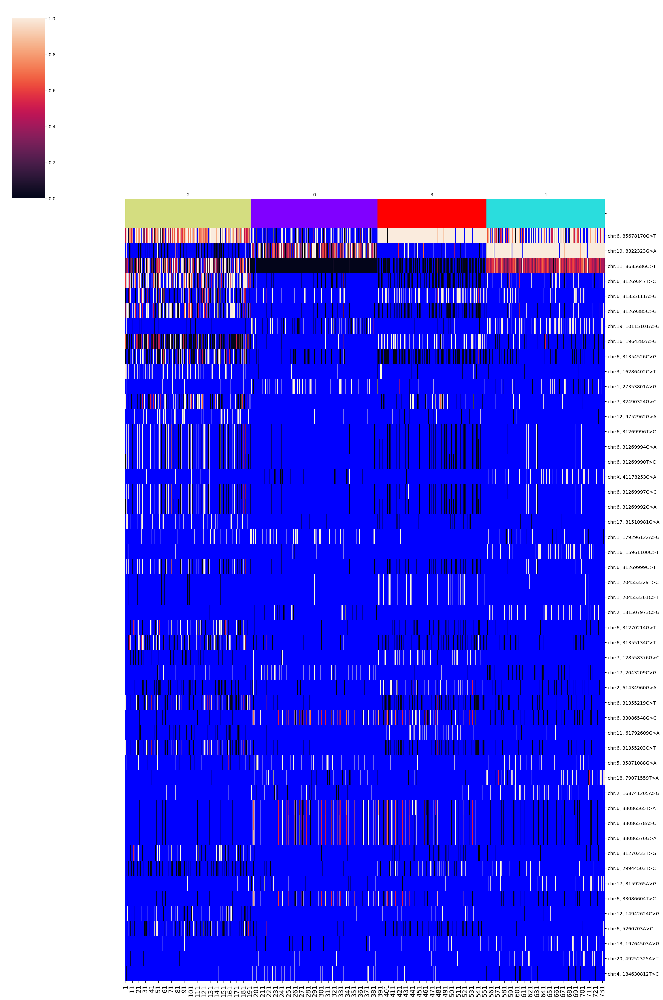

SNPs sorted by lowest p-value will be shown below


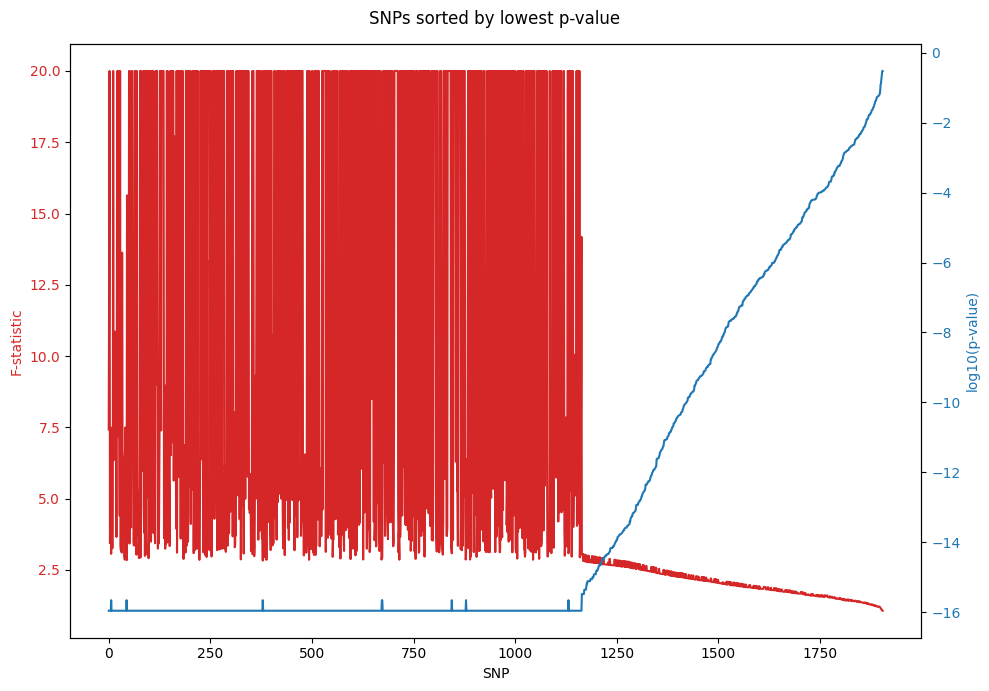

In [13]:
del b_05

%run /home/kevin/storage_kevin/past_figures/figures_final5/notebook/SNPmanifold.ipynb

b_10 = SNP_VAE(AD = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor4/cellSNP.tag.AD.mtx", DP = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor4/cellSNP.tag.DP.mtx", VCF = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor4/cells.cellSNP.vcf.gz")
b_10.filtering()
b_10.training(beta = 1)
b_10.clustering(algorithm = "kmeans_umap3d")
b_10.phylogeny(cluster_no = 4)

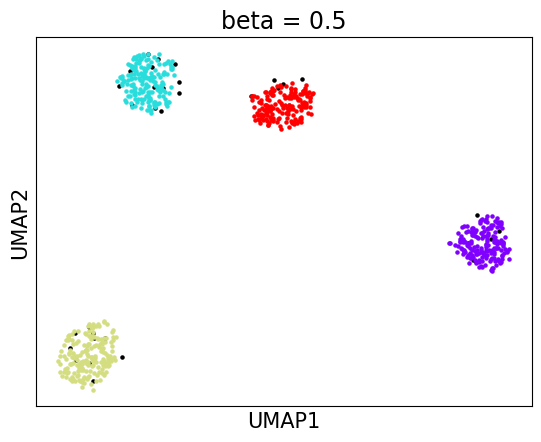

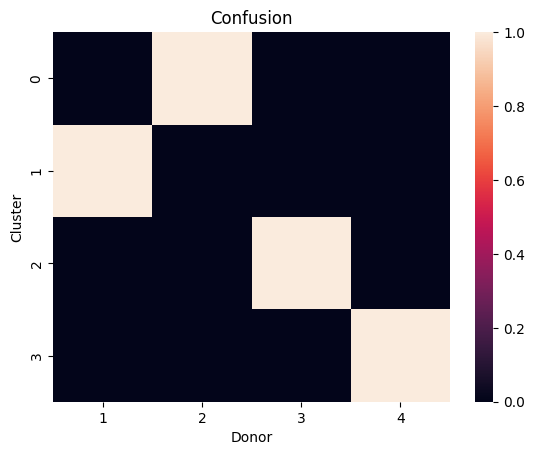

accuracy: 100.0
silhouette score: 0.8453420692744543


In [14]:
b_10_embedding_2d = b_10.embedding_2d

donor = pd.read_csv('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor4/donor_ids.tsv', sep = '\t').iloc[:, 1].to_numpy()[b_10.cell_filter]
name = ["MantonCB1", "MantonCB2", "MantonCB3", "MantonCB4", "doublet", "unassigned"]

clusters = []

for w in name:
    
    clusters.append(np.where(donor == w)[0])

fig, axs = plt.subplots(1, 1)

axs.scatter(b_10.embedding_2d[clusters[4], 0], b_10.embedding_2d[clusters[4], 1], s = 5, color = "black")

for t in range(4):
    
    axs.scatter(b_10.embedding_2d[clusters[t], 0], b_10.embedding_2d[clusters[t], 1], s = 5, color = b_10.colors[t])
    
axs.set_xticks([])
axs.set_yticks([])
axs.set_xlabel("UMAP1", fontsize = 15)
axs.set_ylabel("UMAP2", fontsize = 15)
axs.set_title("beta = 0.5", fontsize = 17)

plt.show()

name = ["MantonCB1", "MantonCB2", "MantonCB3", "MantonCB4", "doublet", "unassigned"]
reference = np.empty(b_10.cell_total)

for w in range(6):
    
    reference[np.where(donor == name[w])[0]] = w
    
reference = reference.astype(int)
    
matrix = np.zeros((4, 4))
ref_sum = np.zeros(4)

for q in range(b_10.cell_total):
    
    if reference[q] <= 3:

        matrix[reference[q], b_10.assigned_label[q]] += 1
        ref_sum[reference[q]] += 1

prop = matrix / np.outer(ref_sum, np.ones(4))

fig, ax = plt.subplots(1, 1)
ax = sns.heatmap(prop.T[[0, 1, 2, 3], :], xticklabels = [1, 2, 3, 4], yticklabels = [0, 1, 2, 3])
ax.set_ylabel("Cluster")
ax.set_xlabel("Donor")
ax.set_title("Confusion")
plt.show()

print(f'accuracy: {np.mean(np.max(prop, 1)) * 100}')
print(f'silhouette score: {silhouette_score(b_10.pair_embedding_3d[reference <= 3, :][:, reference <= 3], reference[reference <= 3], metric = "precomputed")}')

Start loading raw data.
Finish loading raw data.
Start filtering low-quality cells and SNPs.


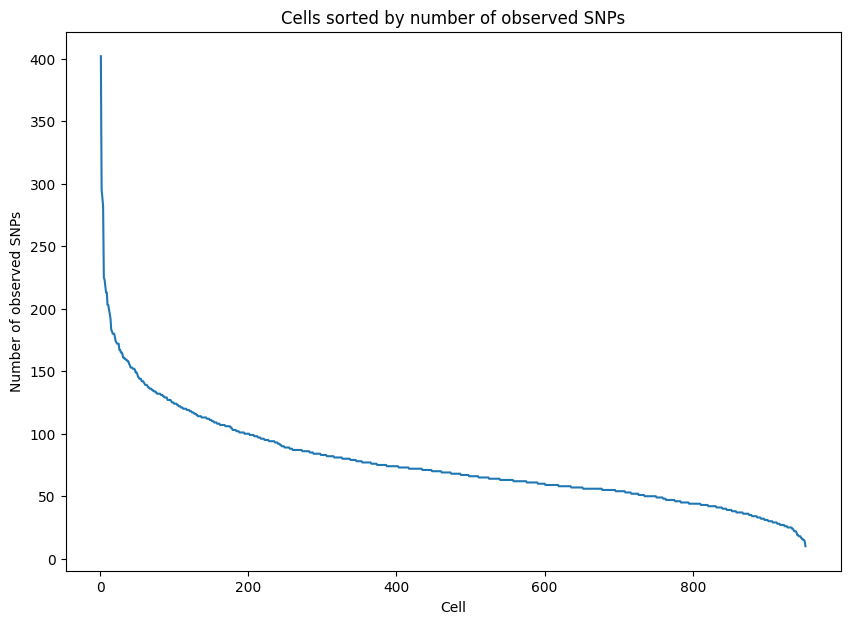

Please determine y-axis threshold in the plot to filter low-quality cells with low number of observed SNPs.   50


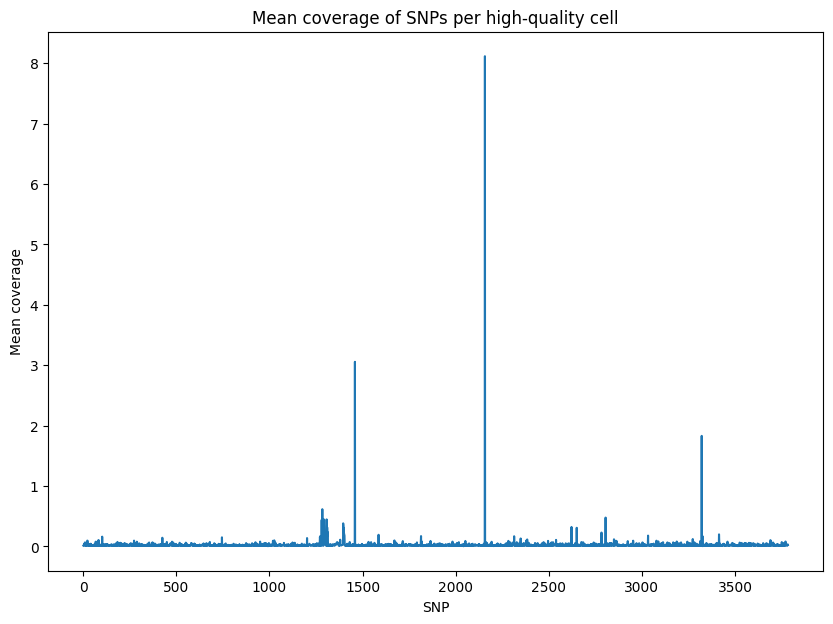

Please determine y-axis threshold in the plot to filter low-quality SNPs with low coverage.   0


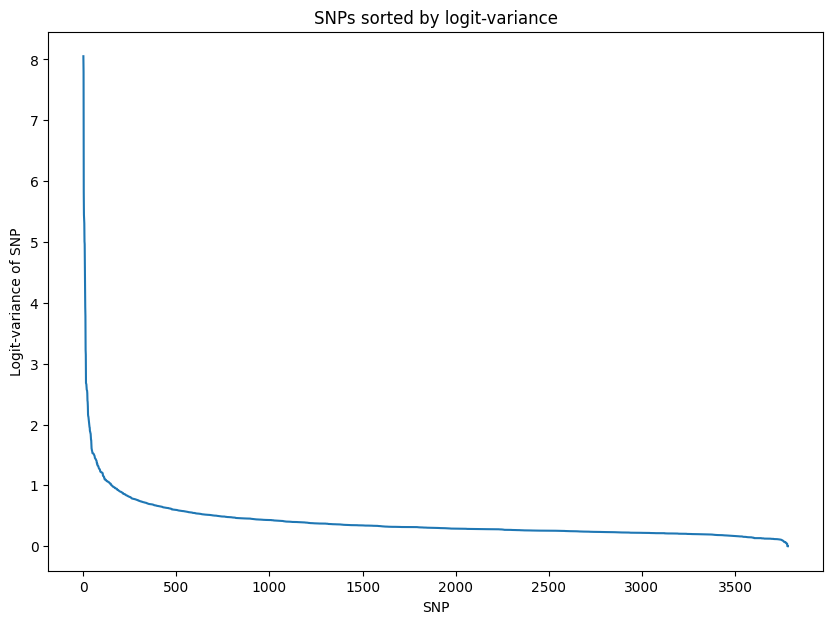

Please determine y-axis threshold in the plot to filter low-quality SNPs with low logit-variance.   0.3
Finish filtering low-quality data, 734 cells and 1905 SNPs will be used for downstream analysis.
Start training VAE.
Epoch[10/2000], Cost: 0.995597
Epoch[20/2000], Cost: 0.883477
Epoch[30/2000], Cost: 0.812245
Epoch[40/2000], Cost: 0.762192
Epoch[50/2000], Cost: 0.723712
Epoch[60/2000], Cost: 0.697143
Epoch[70/2000], Cost: 0.671378
Epoch[80/2000], Cost: 0.651813
Epoch[90/2000], Cost: 0.632430
Epoch[100/2000], Cost: 0.616340
Epoch[200/2000], Cost: 0.513947
Epoch[300/2000], Cost: 0.453924
Epoch[400/2000], Cost: 0.412951
Epoch[500/2000], Cost: 0.388046
Epoch[600/2000], Cost: 0.368463
Epoch[700/2000], Cost: 0.356567
Epoch[800/2000], Cost: 0.340026
Epoch[900/2000], Cost: 0.331184
Epoch[1000/2000], Cost: 0.322511
Epoch[1100/2000], Cost: 0.315711
Epoch[1200/2000], Cost: 0.309848
Epoch[1300/2000], Cost: 0.305404
Epoch[1400/2000], Cost: 0.300321
Epoch[1500/2000], Cost: 0.295968
Epoch[1600/200

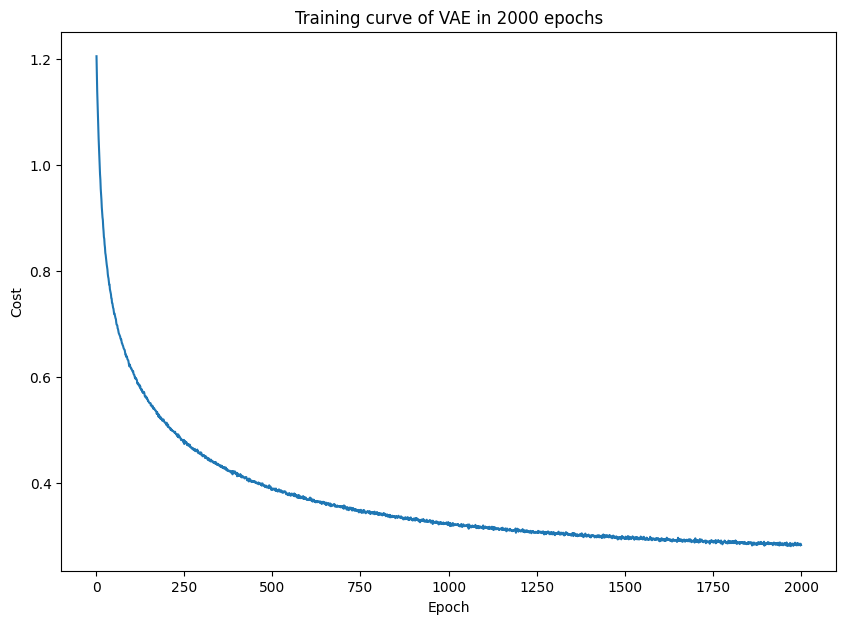

Start learning PCA and UMAP of latent space in VAE.
Finish learning, PCA and UMAP of latent space will be shown below.


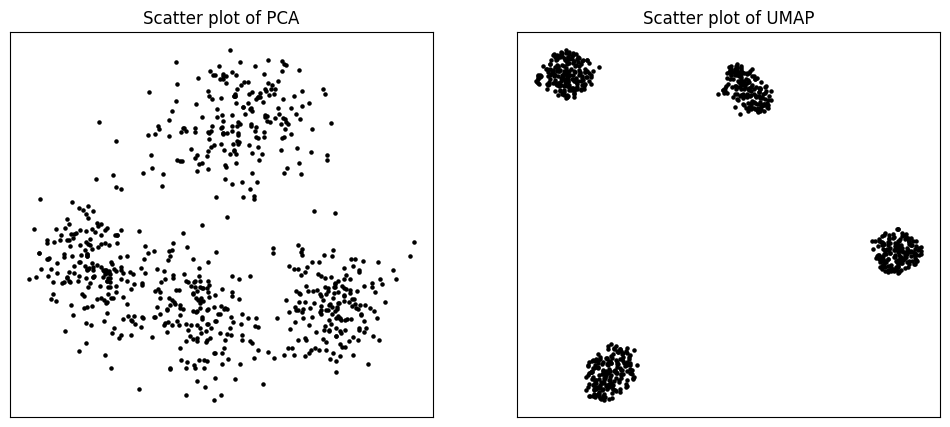

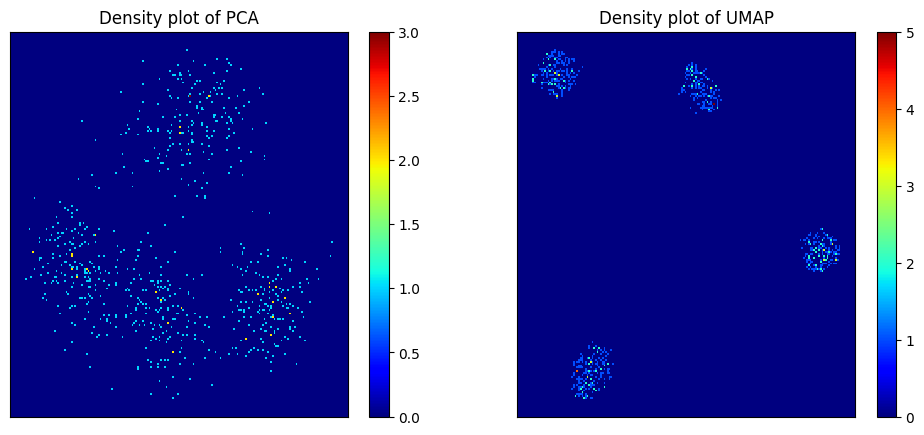

Start clustering.
2 clusters, Distortion: 8271.415039
3 clusters, Distortion: 3085.964844
4 clusters, Distortion: 311.080597
5 clusters, Distortion: 292.246582
6 clusters, Distortion: 265.028656
7 clusters, Distortion: 229.764908
8 clusters, Distortion: 202.778137
9 clusters, Distortion: 187.494293
10 clusters, Distortion: 177.199860
11 clusters, Distortion: 177.583206
12 clusters, Distortion: 159.159515
13 clusters, Distortion: 149.440613
14 clusters, Distortion: 139.109299
15 clusters, Distortion: 129.459061
Finish clustering, PCA, UMAP, distortion, silhouette score of K-means clustering will be shown below.


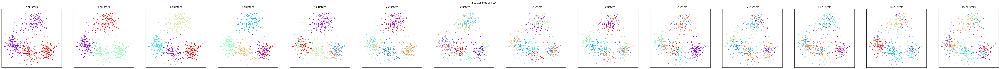

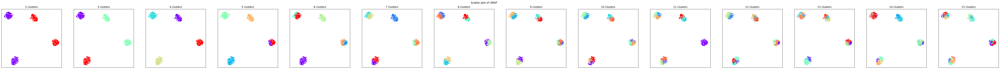

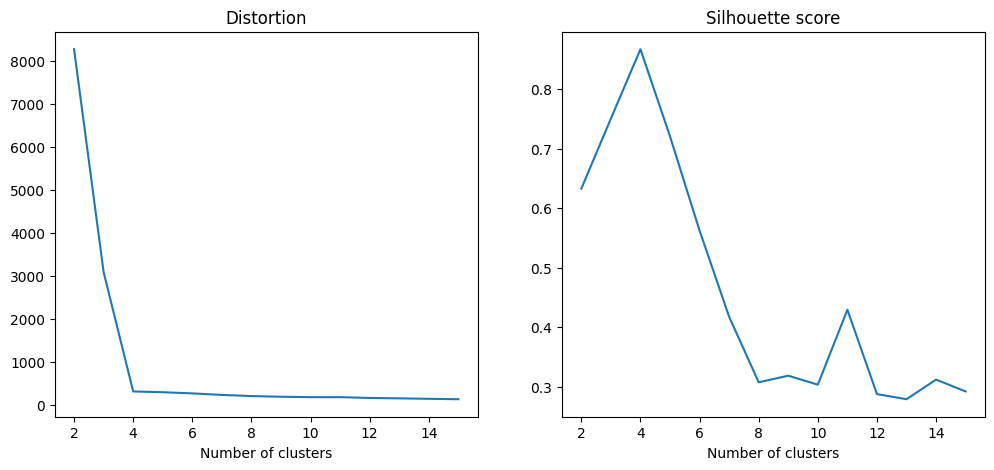

PCA and UMAP of individual clusters will be shown below.


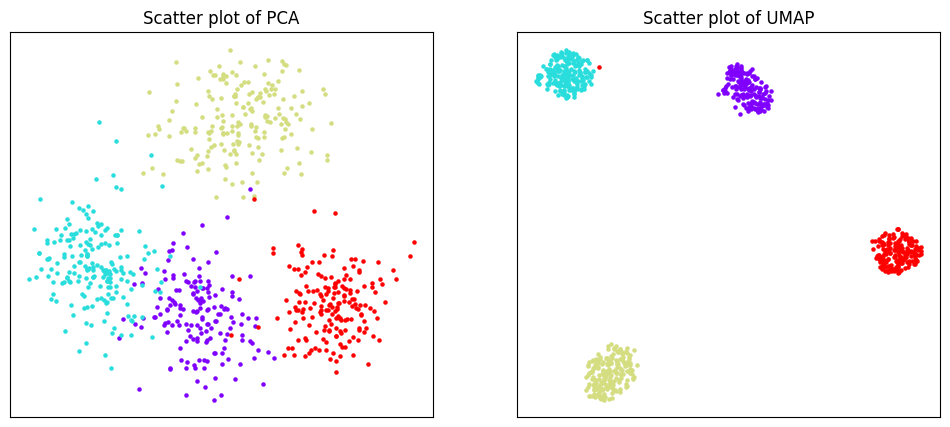

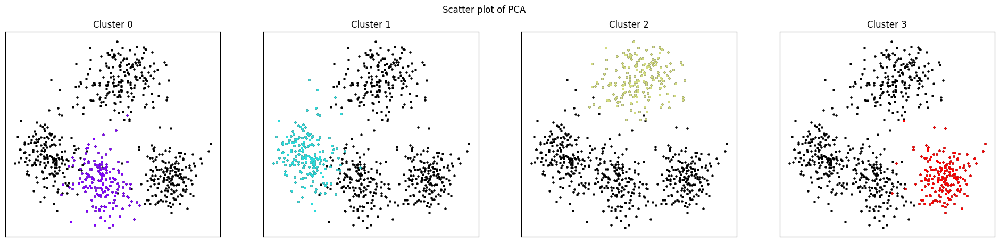

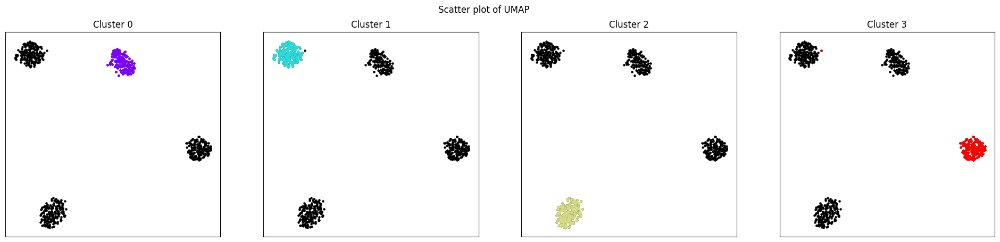

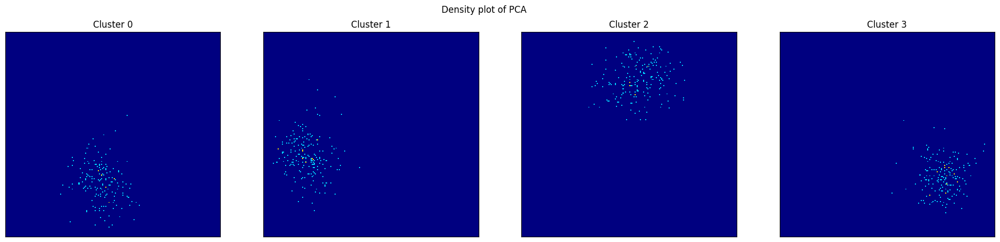

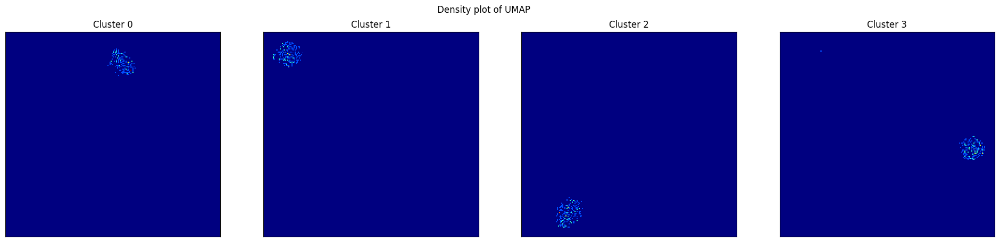

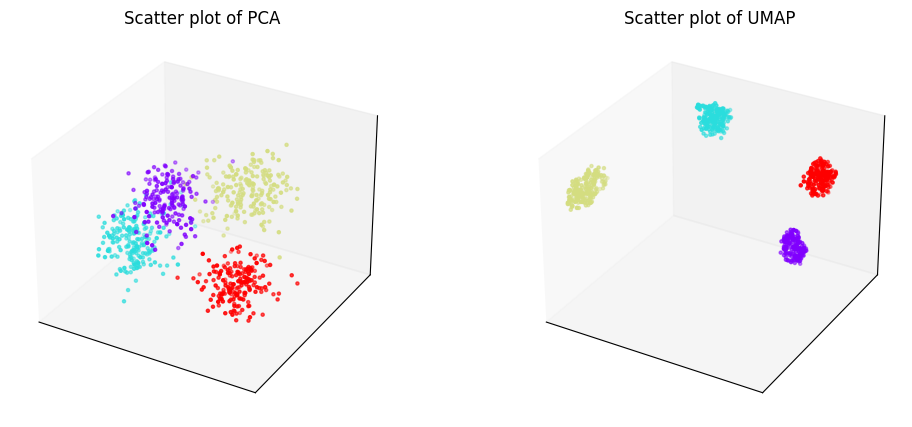

Phylogenetic tree in latent space will be shown below.


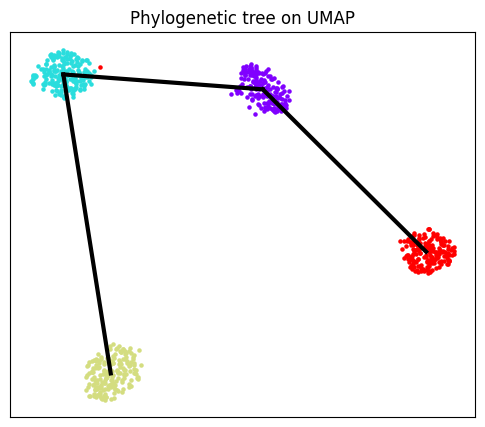

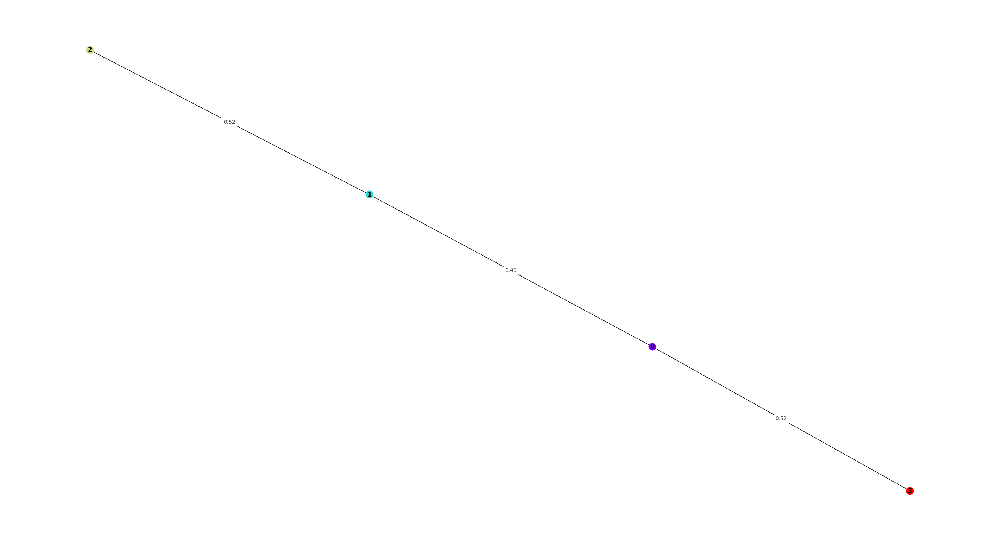

/tmp/ipykernel_1810892/2299804736.py:261: RuntimeWarning: divide by zero encountered in divide
  f_stat = np.clip(1 / ratio_logit_var, 1.001, 20)


SNP-allelic ratios of 734 cells and 50 SNPs will be shown below.


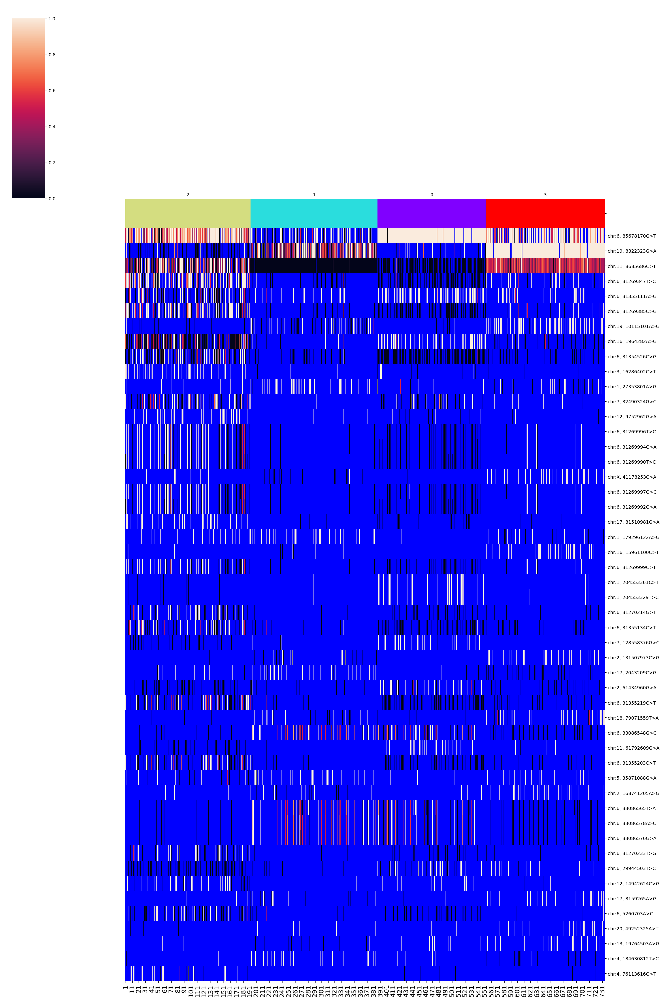

SNPs sorted by lowest p-value will be shown below


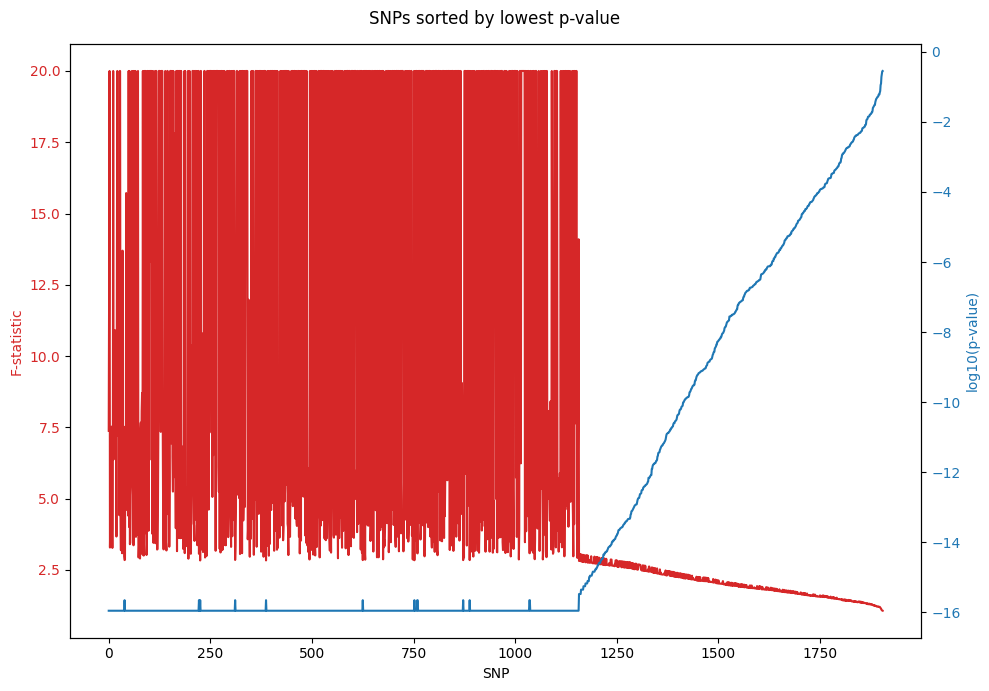

In [15]:
del b_10

%run /home/kevin/storage_kevin/past_figures/figures_final5/notebook/SNPmanifold.ipynb

b_15 = SNP_VAE(AD = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor4/cellSNP.tag.AD.mtx", DP = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor4/cellSNP.tag.DP.mtx", VCF = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor4/cells.cellSNP.vcf.gz")
b_15.filtering()
b_15.training(beta = 1.5)
b_15.clustering(algorithm = "kmeans_umap3d")
b_15.phylogeny(cluster_no = 4)

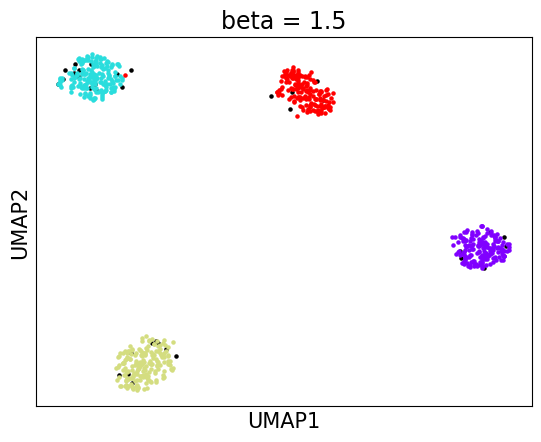

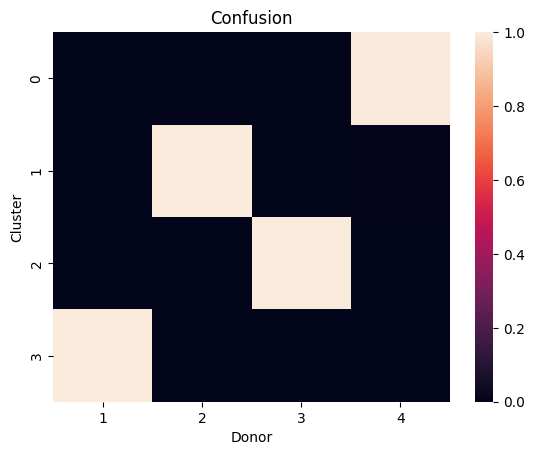

accuracy: 99.84472049689441
silhouette score: 0.8653054457318107


In [17]:
b_15_embedding_2d = b_15.embedding_2d

donor = pd.read_csv('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor4/donor_ids.tsv', sep = '\t').iloc[:, 1].to_numpy()[b_15.cell_filter]
name = ["MantonCB1", "MantonCB2", "MantonCB3", "MantonCB4", "doublet", "unassigned"]

clusters = []

for w in name:
    
    clusters.append(np.where(donor == w)[0])

fig, axs = plt.subplots(1, 1)

axs.scatter(b_15.embedding_2d[clusters[4], 0], b_15.embedding_2d[clusters[4], 1], s = 5, color = "black")

for t in range(4):
    
    axs.scatter(b_15.embedding_2d[clusters[t], 0], b_15.embedding_2d[clusters[t], 1], s = 5, color = b_15.colors[t])
    
axs.set_xticks([])
axs.set_yticks([])
axs.set_xlabel("UMAP1", fontsize = 15)
axs.set_ylabel("UMAP2", fontsize = 15)
axs.set_title("beta = 1.5", fontsize = 17)

plt.show()

name = ["MantonCB1", "MantonCB2", "MantonCB3", "MantonCB4", "doublet", "unassigned"]
reference = np.empty(b_15.cell_total)

for w in range(6):
    
    reference[np.where(donor == name[w])[0]] = w
    
reference = reference.astype(int)
    
matrix = np.zeros((4, 4))
ref_sum = np.zeros(4)

for q in range(b_15.cell_total):
    
    if reference[q] <= 3:

        matrix[reference[q], b_15.assigned_label[q]] += 1
        ref_sum[reference[q]] += 1

prop = matrix / np.outer(ref_sum, np.ones(4))

fig, ax = plt.subplots(1, 1)
ax = sns.heatmap(prop.T[[0, 1, 2, 3], :], xticklabels = [1, 2, 3, 4], yticklabels = [0, 1, 2, 3])
ax.set_ylabel("Cluster")
ax.set_xlabel("Donor")
ax.set_title("Confusion")
plt.show()

print(f'accuracy: {np.mean(np.max(prop, 1)) * 100}')
print(f'silhouette score: {silhouette_score(b_15.pair_embedding_3d[reference <= 3, :][:, reference <= 3], reference[reference <= 3], metric = "precomputed")}')

Start loading raw data.
Finish loading raw data.
Start filtering low-quality cells and SNPs.


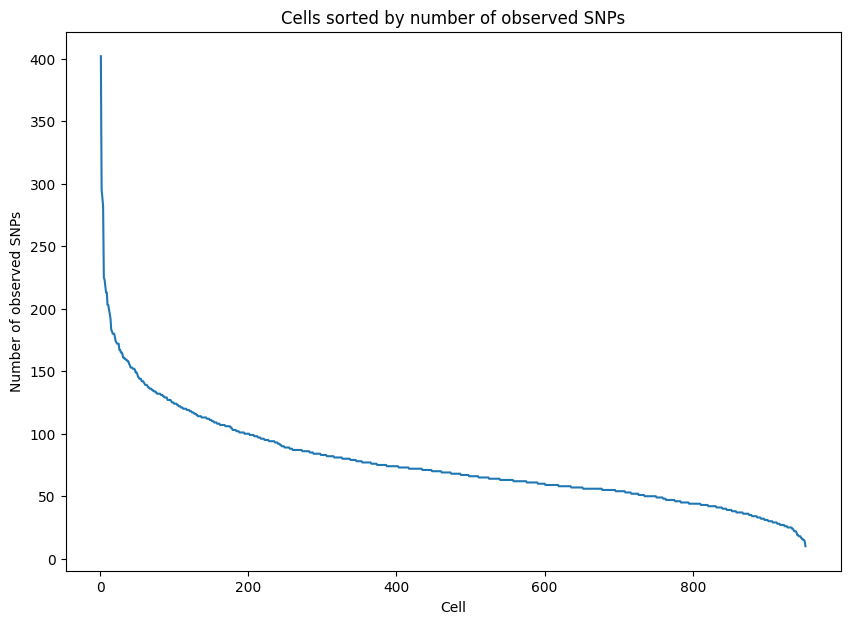

Please determine y-axis threshold in the plot to filter low-quality cells with low number of observed SNPs.   50


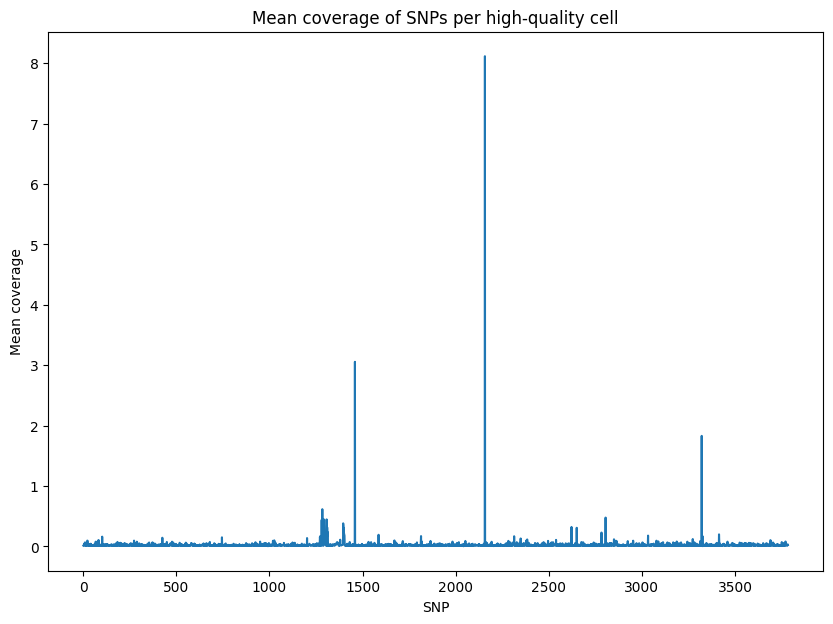

Please determine y-axis threshold in the plot to filter low-quality SNPs with low coverage.   0


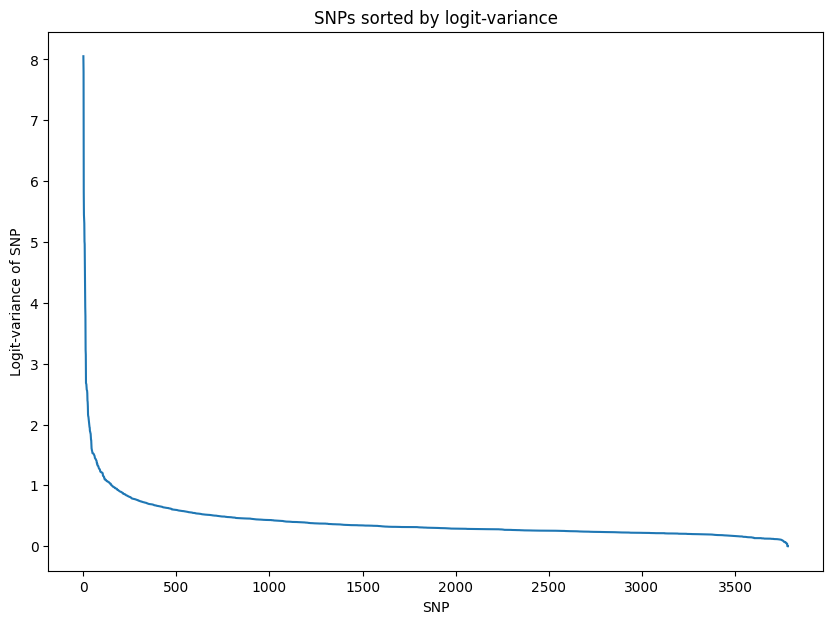

Please determine y-axis threshold in the plot to filter low-quality SNPs with low logit-variance.   0.3
Finish filtering low-quality data, 734 cells and 1905 SNPs will be used for downstream analysis.
Start training VAE.
Epoch[10/2000], Cost: 1.057112
Epoch[20/2000], Cost: 0.927204
Epoch[30/2000], Cost: 0.851063
Epoch[40/2000], Cost: 0.802732
Epoch[50/2000], Cost: 0.767140
Epoch[60/2000], Cost: 0.741160
Epoch[70/2000], Cost: 0.713762
Epoch[80/2000], Cost: 0.698841
Epoch[90/2000], Cost: 0.681292
Epoch[100/2000], Cost: 0.664953
Epoch[200/2000], Cost: 0.562902
Epoch[300/2000], Cost: 0.506704
Epoch[400/2000], Cost: 0.469473
Epoch[500/2000], Cost: 0.436038
Epoch[600/2000], Cost: 0.417356
Epoch[700/2000], Cost: 0.400754
Epoch[800/2000], Cost: 0.388018
Epoch[900/2000], Cost: 0.374110
Epoch[1000/2000], Cost: 0.365572
Epoch[1100/2000], Cost: 0.352877
Epoch[1200/2000], Cost: 0.348725
Epoch[1300/2000], Cost: 0.345491
Epoch[1400/2000], Cost: 0.341026
Epoch[1500/2000], Cost: 0.334682
Epoch[1600/200

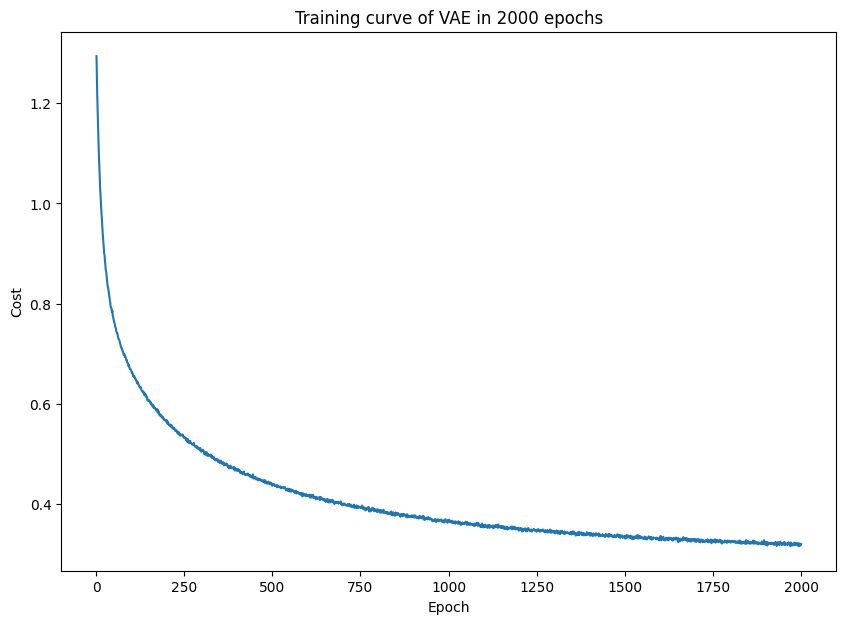

Start learning PCA and UMAP of latent space in VAE.
Finish learning, PCA and UMAP of latent space will be shown below.


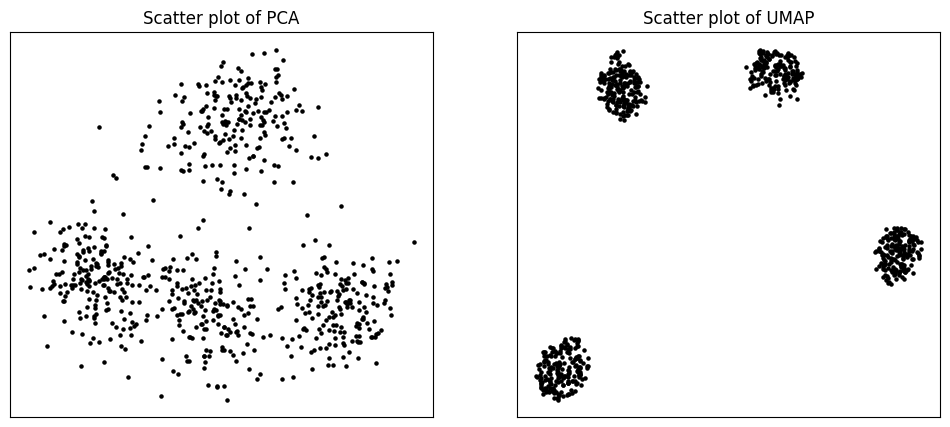

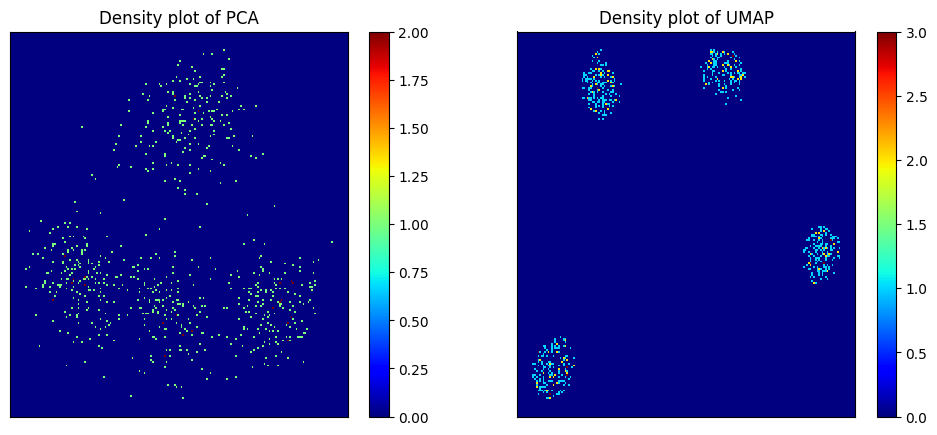

Start clustering.
2 clusters, Distortion: 10822.375977
3 clusters, Distortion: 7410.362305
4 clusters, Distortion: 313.130676
5 clusters, Distortion: 295.018921
6 clusters, Distortion: 256.707031
7 clusters, Distortion: 220.000809
8 clusters, Distortion: 203.194626
9 clusters, Distortion: 188.871613
10 clusters, Distortion: 179.071640
11 clusters, Distortion: 168.148636
12 clusters, Distortion: 160.758896
13 clusters, Distortion: 151.766983
14 clusters, Distortion: 146.691727
15 clusters, Distortion: 129.275986
Finish clustering, PCA, UMAP, distortion, silhouette score of K-means clustering will be shown below.


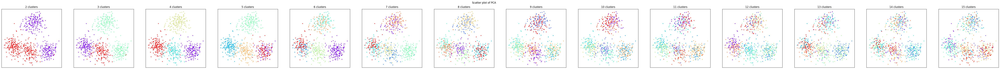

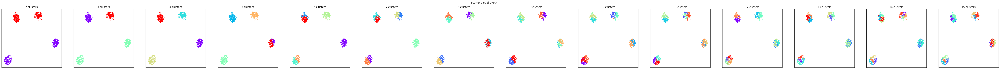

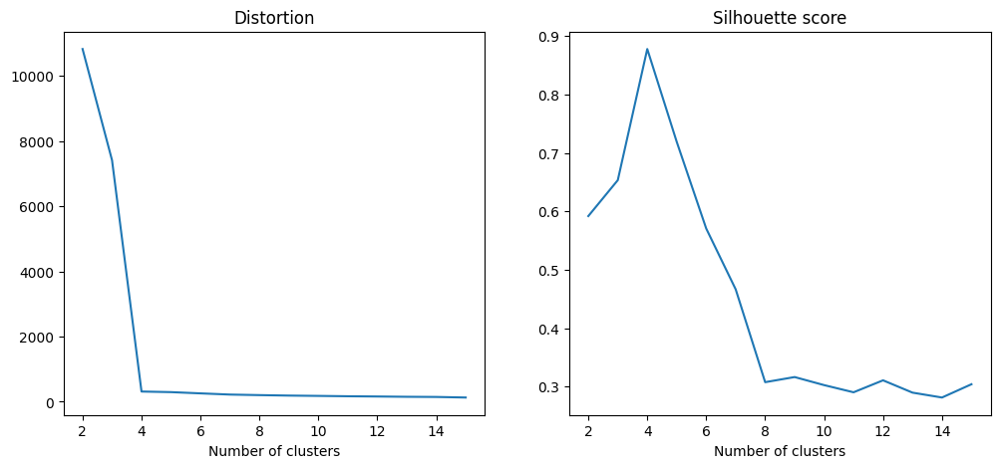

PCA and UMAP of individual clusters will be shown below.


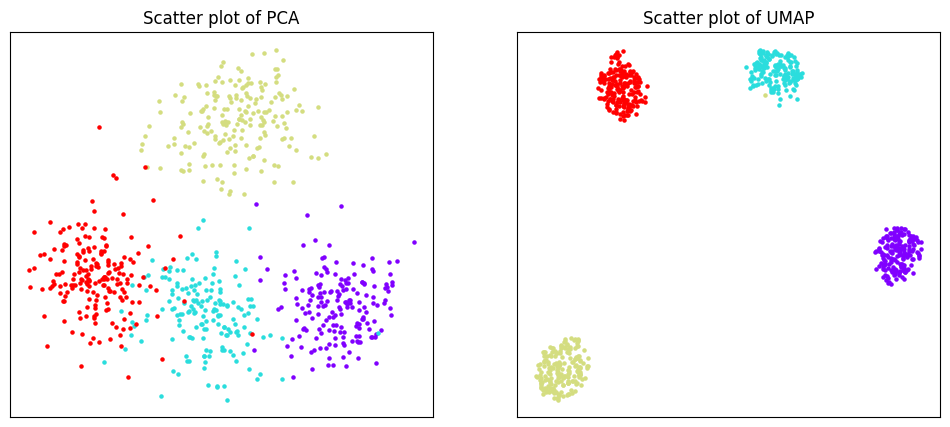

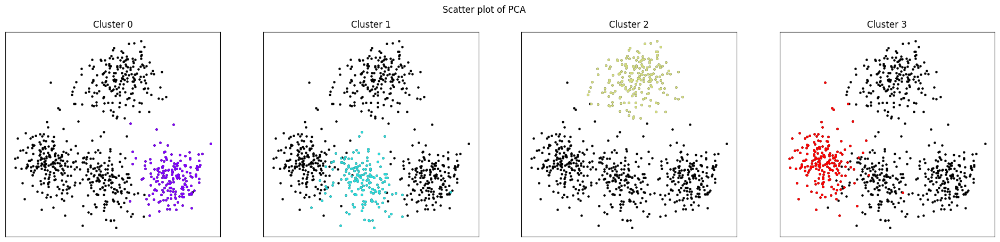

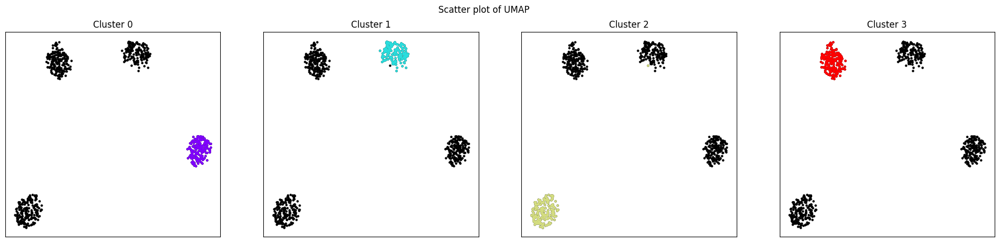

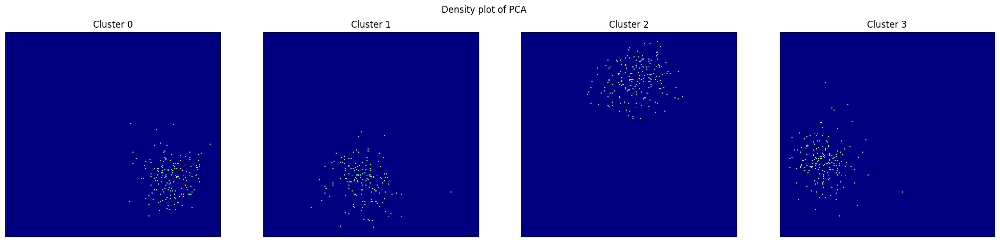

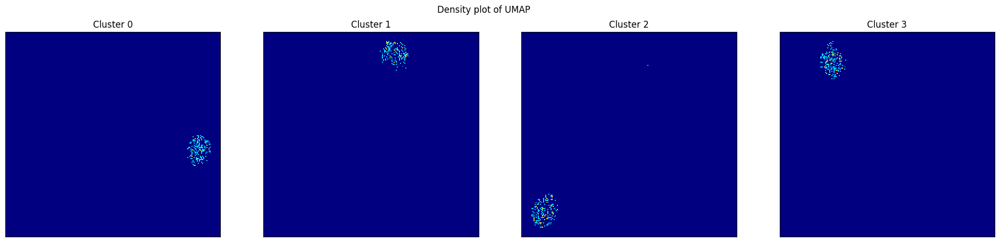

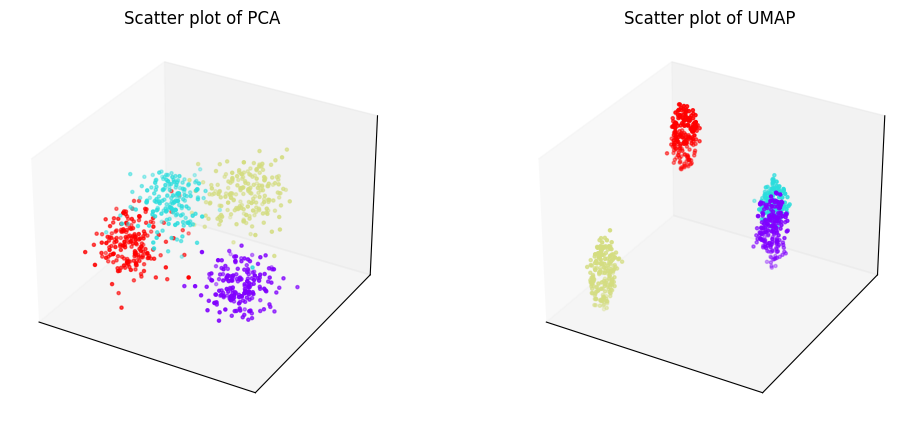

Phylogenetic tree in latent space will be shown below.


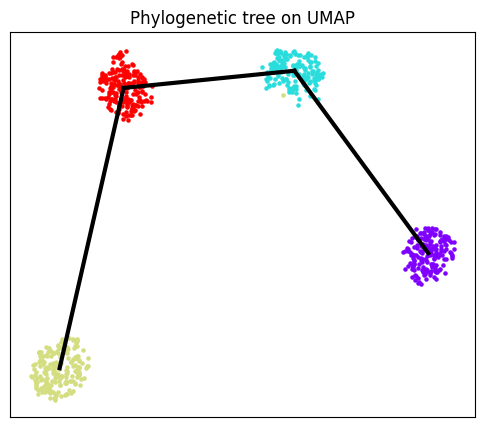

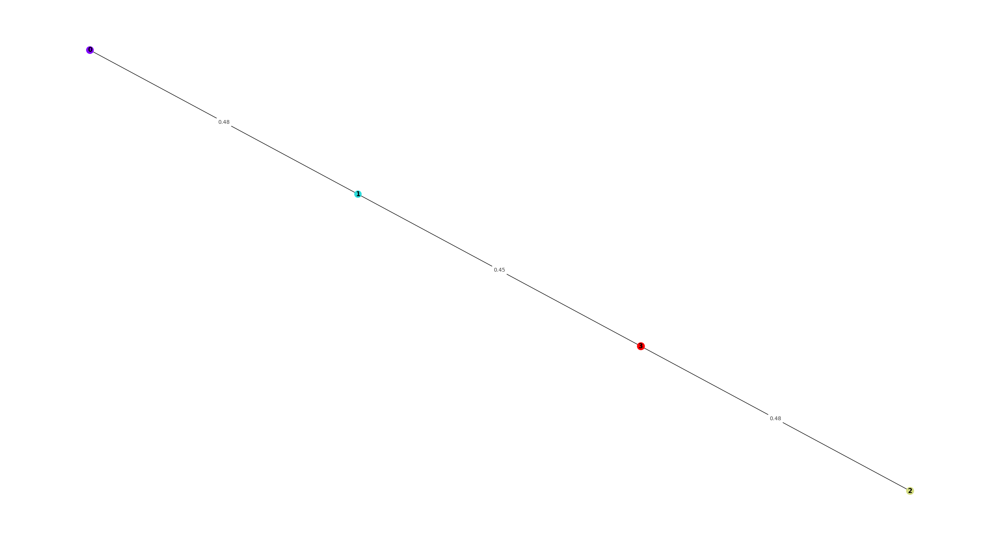

/tmp/ipykernel_1810892/2299804736.py:261: RuntimeWarning: divide by zero encountered in divide
  f_stat = np.clip(1 / ratio_logit_var, 1.001, 20)


SNP-allelic ratios of 734 cells and 50 SNPs will be shown below.


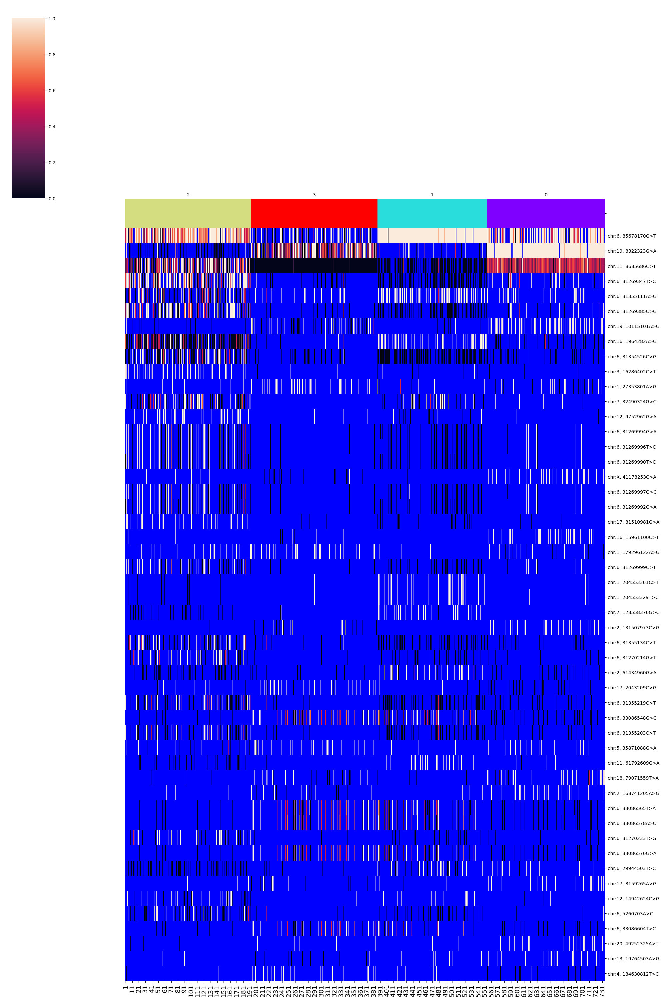

SNPs sorted by lowest p-value will be shown below


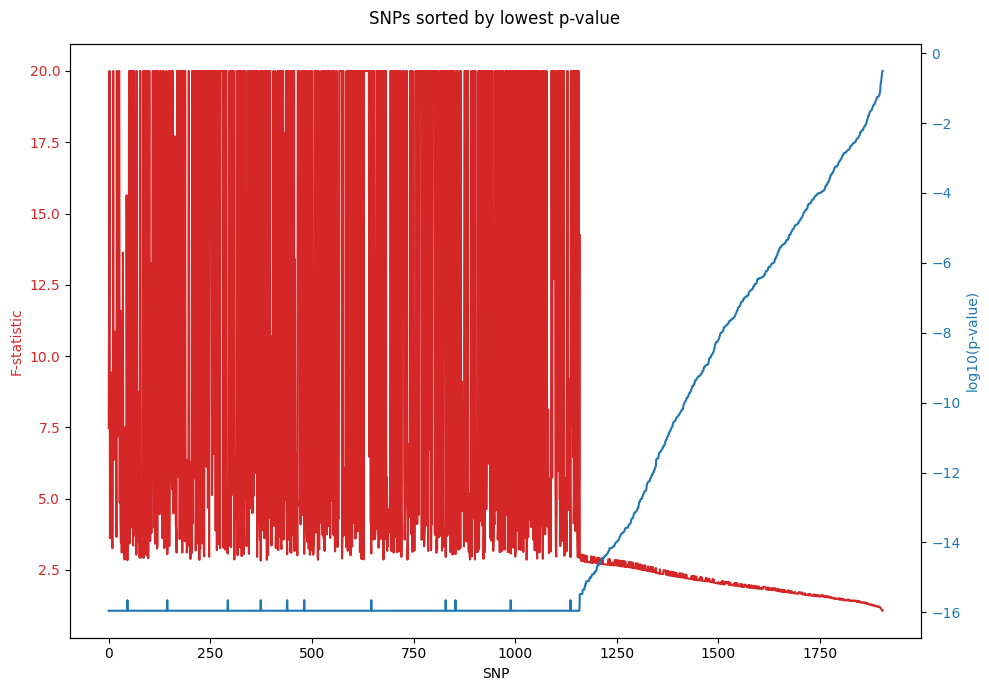

In [18]:
del b_15

%run /home/kevin/storage_kevin/past_figures/figures_final5/notebook/SNPmanifold.ipynb

b_20 = SNP_VAE(AD = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor4/cellSNP.tag.AD.mtx", DP = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor4/cellSNP.tag.DP.mtx", VCF = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor4/cells.cellSNP.vcf.gz")
b_20.filtering()
b_20.training(beta = 2)
b_20.clustering(algorithm = "kmeans_umap3d")
b_20.phylogeny(cluster_no = 4)

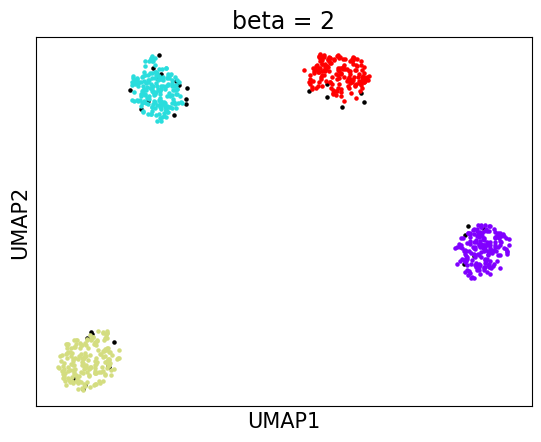

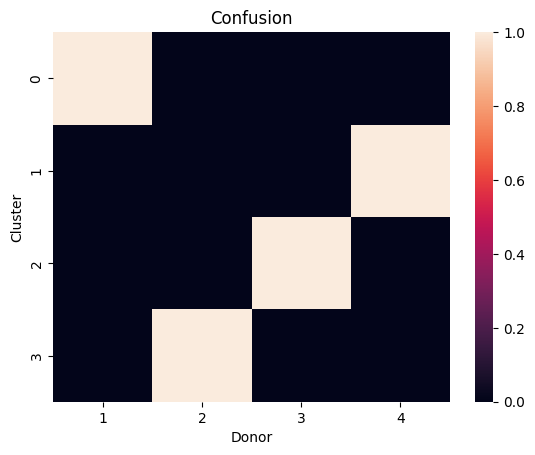

accuracy: 100.0
silhouette score: 0.8795830406934546


In [20]:
b_20_embedding_2d = b_20.embedding_2d

donor = pd.read_csv('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor4/donor_ids.tsv', sep = '\t').iloc[:, 1].to_numpy()[b_20.cell_filter]
name = ["MantonCB1", "MantonCB2", "MantonCB3", "MantonCB4", "doublet", "unassigned"]

clusters = []

for w in name:
    
    clusters.append(np.where(donor == w)[0])

fig, axs = plt.subplots(1, 1)

axs.scatter(b_20.embedding_2d[clusters[4], 0], b_20.embedding_2d[clusters[4], 1], s = 5, color = "black")

for t in range(4):
    
    axs.scatter(b_20.embedding_2d[clusters[t], 0], b_20.embedding_2d[clusters[t], 1], s = 5, color = b_20.colors[t])
    
axs.set_xticks([])
axs.set_yticks([])
axs.set_xlabel("UMAP1", fontsize = 15)
axs.set_ylabel("UMAP2", fontsize = 15)
axs.set_title("beta = 2", fontsize = 17)

plt.show()

name = ["MantonCB1", "MantonCB2", "MantonCB3", "MantonCB4", "doublet", "unassigned"]
reference = np.empty(b_20.cell_total)

for w in range(6):
    
    reference[np.where(donor == name[w])[0]] = w
    
reference = reference.astype(int)
    
matrix = np.zeros((4, 4))
ref_sum = np.zeros(4)

for q in range(b_20.cell_total):
    
    if reference[q] <= 3:

        matrix[reference[q], b_20.assigned_label[q]] += 1
        ref_sum[reference[q]] += 1

prop = matrix / np.outer(ref_sum, np.ones(4))

fig, ax = plt.subplots(1, 1)
ax = sns.heatmap(prop.T[[0, 1, 2, 3], :], xticklabels = [1, 2, 3, 4], yticklabels = [0, 1, 2, 3])
ax.set_ylabel("Cluster")
ax.set_xlabel("Donor")
ax.set_title("Confusion")
plt.show()

print(f'accuracy: {np.mean(np.max(prop, 1)) * 100}')
print(f'silhouette score: {silhouette_score(b_20.pair_embedding_3d[reference <= 3, :][:, reference <= 3], reference[reference <= 3], metric = "precomputed")}')

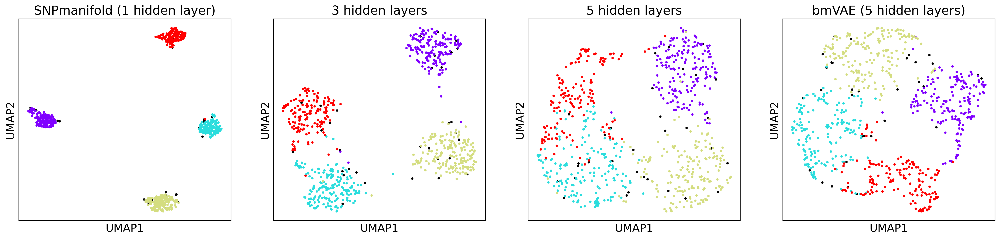

In [27]:
fig, axs = plt.subplots(1, 4, dpi = 300)
fig.set_size_inches(24, 5)

axs[0].scatter(normalized_layer1_embedding_2d[clusters[4], 0], normalized_layer1_embedding_2d[clusters[4], 1], s = 5, color = "black")
    
for t in range(4):
    
    axs[0].scatter(normalized_layer1_embedding_2d[clusters[t], 0], normalized_layer1_embedding_2d[clusters[t], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 4))[t])
    
axs[0].set_xticks([])
axs[0].set_yticks([])
axs[0].set_xlabel("UMAP1", fontsize = 15)
axs[0].set_ylabel("UMAP2", fontsize = 15)
axs[0].set_title("SNPmanifold (1 hidden layer)", fontsize = 17)

axs[1].scatter(unnormalized_layer3_embedding_2d[clusters[4], 0], unnormalized_layer3_embedding_2d[clusters[4], 1], s = 5, color = "black")

for t in range(4):
    
    axs[1].scatter(unnormalized_layer3_embedding_2d[clusters[t], 0], unnormalized_layer3_embedding_2d[clusters[t], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 4))[t])
    
axs[1].set_xticks([])
axs[1].set_yticks([])
axs[1].set_xlabel("UMAP1", fontsize = 15)
axs[1].set_ylabel("UMAP2", fontsize = 15)
axs[1].set_title("3 hidden layers", fontsize = 17)

axs[2].scatter(unnormalized_layer5_embedding_2d[clusters[4], 0], unnormalized_layer5_embedding_2d[clusters[4], 1], s = 5, color = "black")

for t in range(4):
    
    axs[2].scatter(unnormalized_layer5_embedding_2d[clusters[t], 0], unnormalized_layer5_embedding_2d[clusters[t], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 4))[t])
    
axs[2].set_xticks([])
axs[2].set_yticks([])
axs[2].set_xlabel("UMAP1", fontsize = 15)
axs[2].set_ylabel("UMAP2", fontsize = 15)
axs[2].set_title("5 hidden layers", fontsize = 17)

axs[3].scatter(bmVAE_embedding_2d[clusters[4], 0], bmVAE_embedding_2d[clusters[4], 1], s = 5, color = "black")

for t in range(4):
    
    axs[3].scatter(bmVAE_embedding_2d[clusters[t], 0], bmVAE_embedding_2d[clusters[t], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 4))[t])
    
axs[3].set_xticks([])
axs[3].set_yticks([])
axs[3].set_xlabel("UMAP1", fontsize = 15)
axs[3].set_ylabel("UMAP2", fontsize = 15)
axs[3].set_title("bmVAE (5 hidden layers)", fontsize = 17)
    
plt.show()

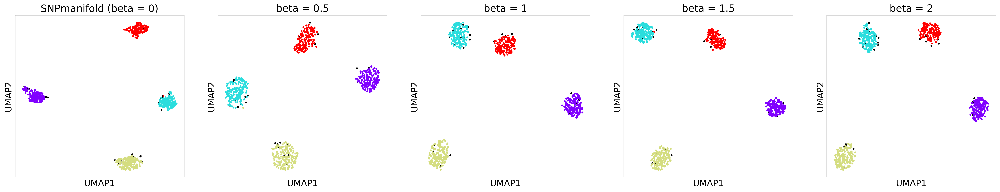

In [29]:
fig, axs = plt.subplots(1, 5, dpi = 300)
fig.set_size_inches(30, 5)

axs[0].scatter(normalized_layer1_embedding_2d[clusters[4], 0], normalized_layer1_embedding_2d[clusters[4], 1], s = 5, color = "black")
    
for t in range(4):
    
    axs[0].scatter(normalized_layer1_embedding_2d[clusters[t], 0], normalized_layer1_embedding_2d[clusters[t], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 4))[t])
    
axs[0].set_xticks([])
axs[0].set_yticks([])
axs[0].set_xlabel("UMAP1", fontsize = 15)
axs[0].set_ylabel("UMAP2", fontsize = 15)
axs[0].set_title("SNPmanifold (beta = 0)", fontsize = 17)

axs[1].scatter(b_05_embedding_2d[clusters[4], 0], b_05_embedding_2d[clusters[4], 1], s = 5, color = "black")

for t in range(4):
    
    axs[1].scatter(b_05_embedding_2d[clusters[t], 0], b_05_embedding_2d[clusters[t], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 4))[t])
    
axs[1].set_xticks([])
axs[1].set_yticks([])
axs[1].set_xlabel("UMAP1", fontsize = 15)
axs[1].set_ylabel("UMAP2", fontsize = 15)
axs[1].set_title("beta = 0.5", fontsize = 17)

axs[2].scatter(b_10_embedding_2d[clusters[4], 0], b_10_embedding_2d[clusters[4], 1], s = 5, color = "black")

for t in range(4):
    
    axs[2].scatter(b_10_embedding_2d[clusters[t], 0], b_10_embedding_2d[clusters[t], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 4))[t])
    
axs[2].set_xticks([])
axs[2].set_yticks([])
axs[2].set_xlabel("UMAP1", fontsize = 15)
axs[2].set_ylabel("UMAP2", fontsize = 15)
axs[2].set_title("beta = 1", fontsize = 17)

axs[3].scatter(b_15_embedding_2d[clusters[4], 0], b_15_embedding_2d[clusters[4], 1], s = 5, color = "black")

for t in range(4):
    
    axs[3].scatter(b_15_embedding_2d[clusters[t], 0], b_15_embedding_2d[clusters[t], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 4))[t])
    
axs[3].set_xticks([])
axs[3].set_yticks([])
axs[3].set_xlabel("UMAP1", fontsize = 15)
axs[3].set_ylabel("UMAP2", fontsize = 15)
axs[3].set_title("beta = 1.5", fontsize = 17)

axs[4].scatter(b_20_embedding_2d[clusters[4], 0], b_20_embedding_2d[clusters[4], 1], s = 5, color = "black")

for t in range(4):
    
    axs[4].scatter(b_20_embedding_2d[clusters[t], 0], b_20_embedding_2d[clusters[t], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 4))[t])
    
axs[4].set_xticks([])
axs[4].set_yticks([])
axs[4].set_xlabel("UMAP1", fontsize = 15)
axs[4].set_ylabel("UMAP2", fontsize = 15)
axs[4].set_title("beta = 2", fontsize = 17)
    
plt.show()

Start loading raw data.
Finish loading raw data.
Start filtering low-quality cells and SNPs.


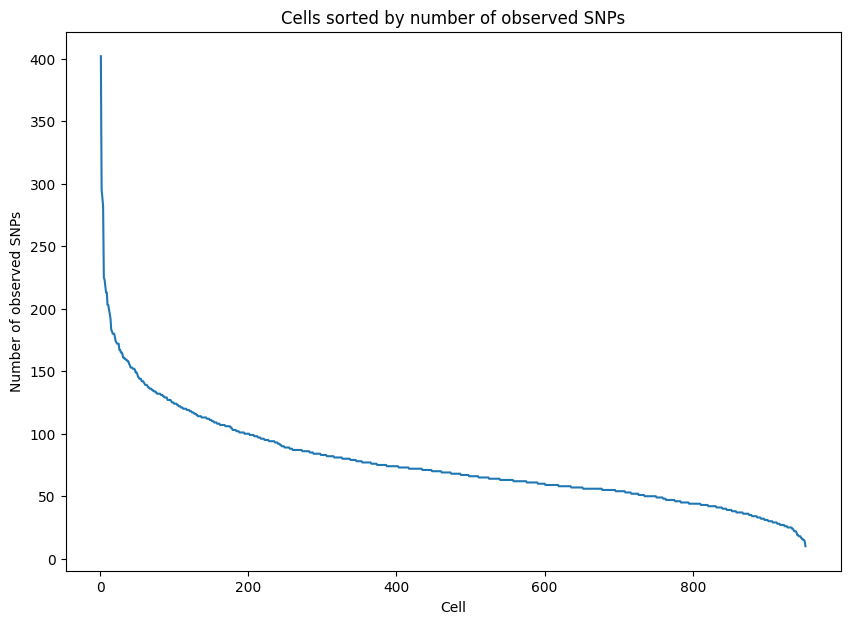

Please determine y-axis threshold in the plot to filter low-quality cells with low number of observed SNPs.   50


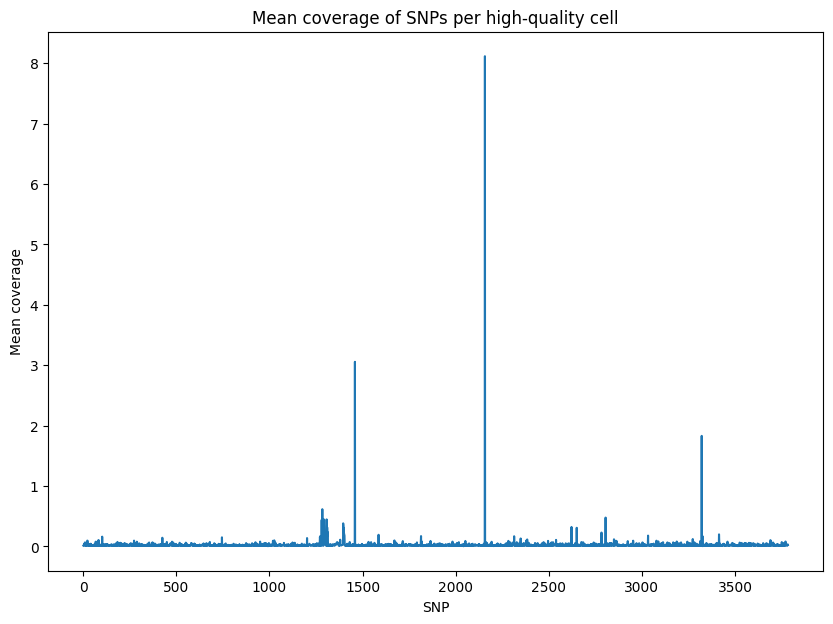

Please determine y-axis threshold in the plot to filter low-quality SNPs with low coverage.   0


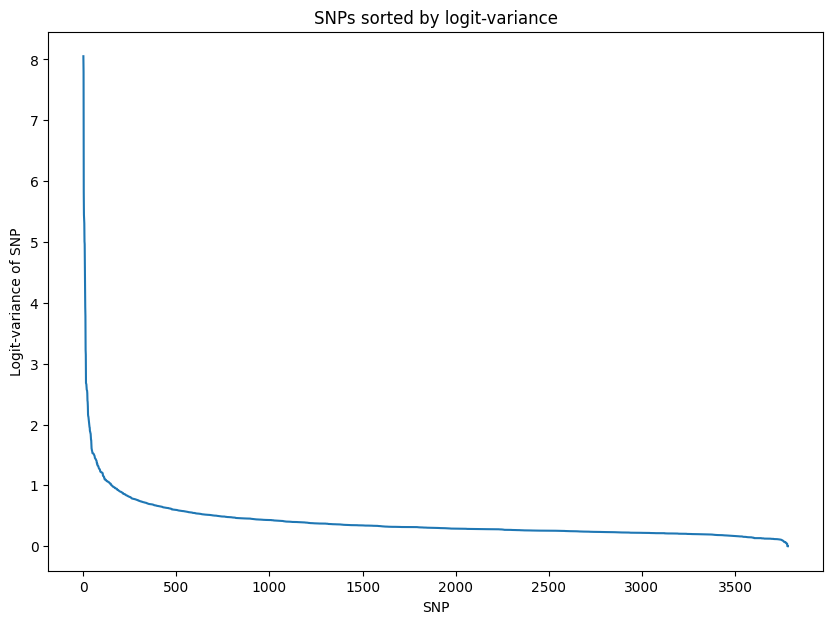

Please determine y-axis threshold in the plot to filter low-quality SNPs with low logit-variance.   0.3
Finish filtering low-quality data, 734 cells and 1905 SNPs will be used for downstream analysis.
Start training VAE.
Epoch[10/2000], Cost: 0.809561
Epoch[20/2000], Cost: 0.703627
Epoch[30/2000], Cost: 0.609602
Epoch[40/2000], Cost: 0.522665
Epoch[50/2000], Cost: 0.445214
Epoch[60/2000], Cost: 0.381743
Epoch[70/2000], Cost: 0.331119
Epoch[80/2000], Cost: 0.291842
Epoch[90/2000], Cost: 0.257887
Epoch[100/2000], Cost: 0.231363
Epoch[200/2000], Cost: 0.122389
Epoch[300/2000], Cost: 0.101102
Epoch[400/2000], Cost: 0.094833
Epoch[500/2000], Cost: 0.091965
Epoch[600/2000], Cost: 0.090562
Epoch[700/2000], Cost: 0.089707
Epoch[800/2000], Cost: 0.089189
Epoch[900/2000], Cost: 0.088799
Epoch[1000/2000], Cost: 0.088527
Epoch[1100/2000], Cost: 0.088288
Epoch[1200/2000], Cost: 0.088150
Epoch[1300/2000], Cost: 0.088003
Epoch[1400/2000], Cost: 0.087926
Epoch[1500/2000], Cost: 0.087832
Epoch[1600/200

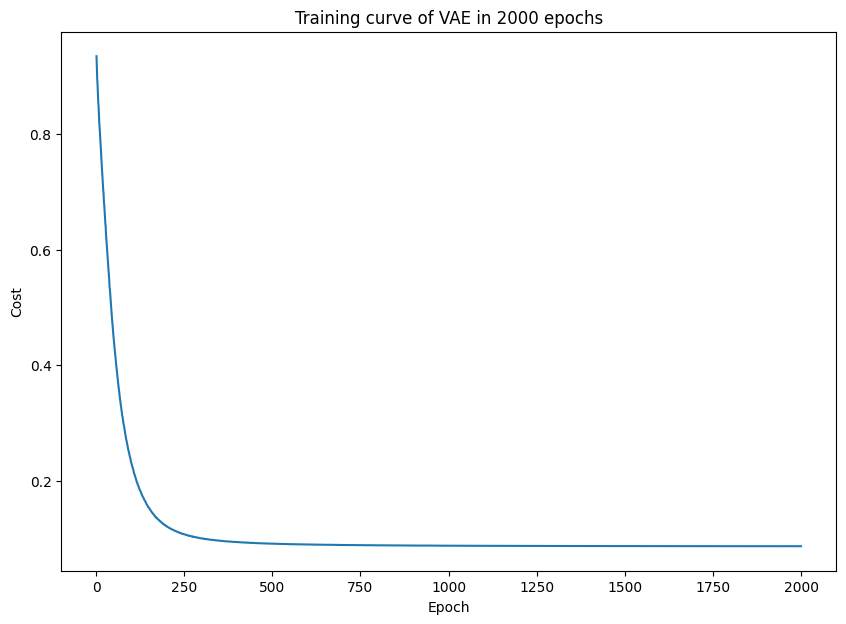

Start learning PCA and UMAP of latent space in VAE.
Finish learning, PCA and UMAP of latent space will be shown below.


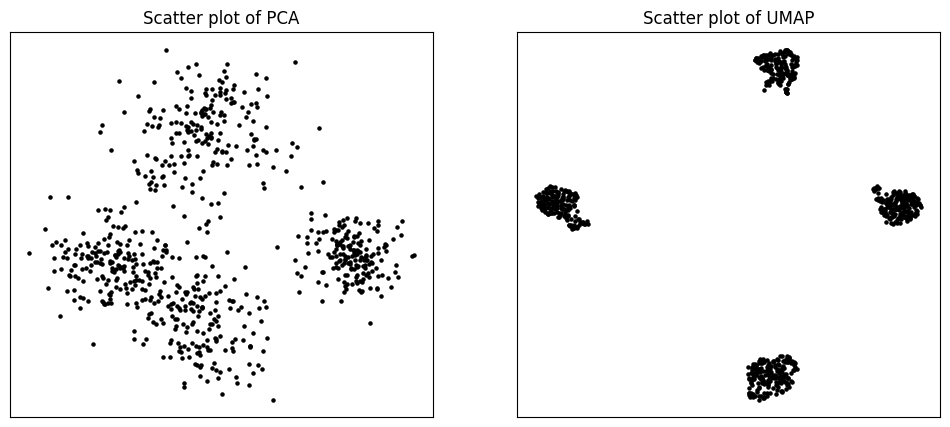

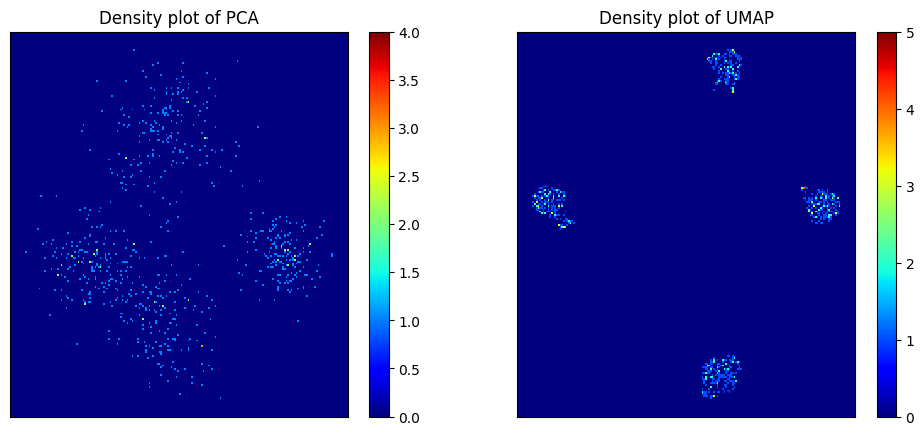

Start clustering.
2 clusters, Distortion: 28960.759766
3 clusters, Distortion: 13888.594727
4 clusters, Distortion: 386.143677
5 clusters, Distortion: 360.563232
6 clusters, Distortion: 298.817108
7 clusters, Distortion: 277.744659
8 clusters, Distortion: 277.834045
9 clusters, Distortion: 222.927917
10 clusters, Distortion: 213.917343
11 clusters, Distortion: 194.975143
12 clusters, Distortion: 181.005829
13 clusters, Distortion: 169.662186
14 clusters, Distortion: 160.140915
15 clusters, Distortion: 153.171265
Finish clustering, PCA, UMAP, distortion, silhouette score of K-means clustering will be shown below.


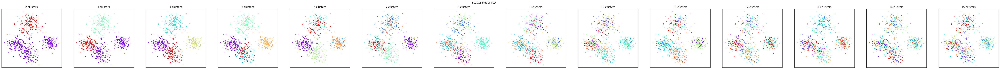

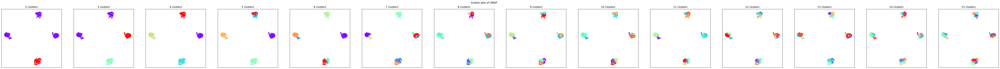

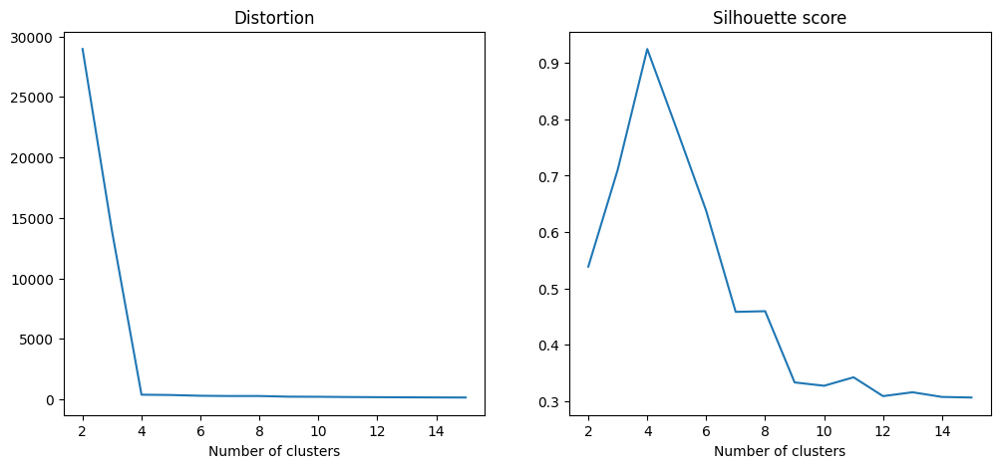

PCA and UMAP of individual clusters will be shown below.


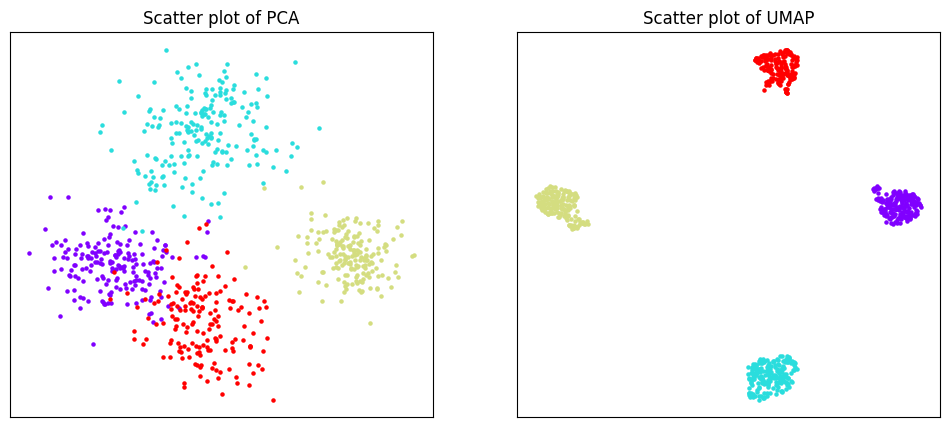

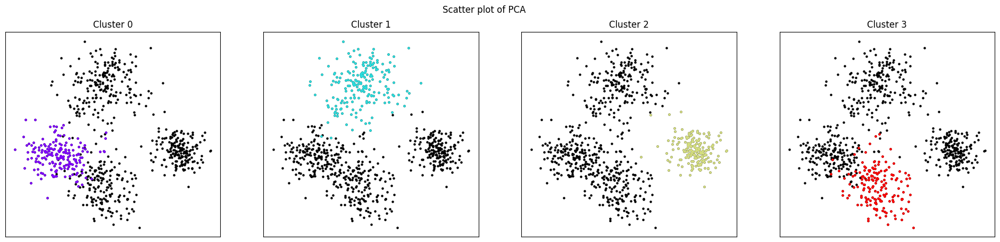

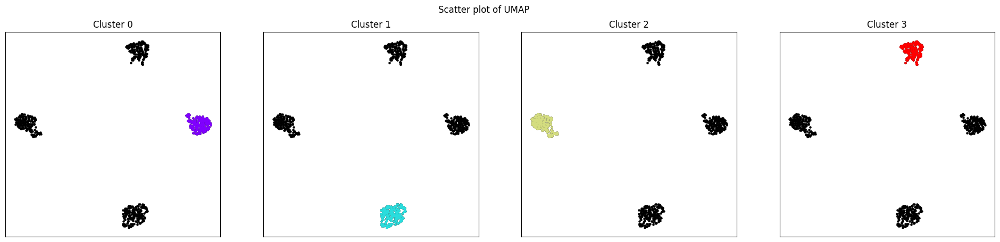

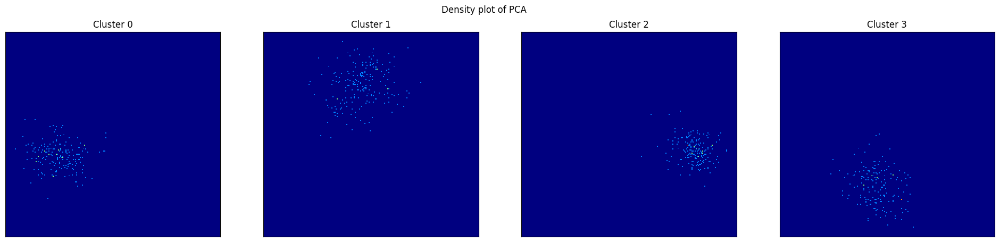

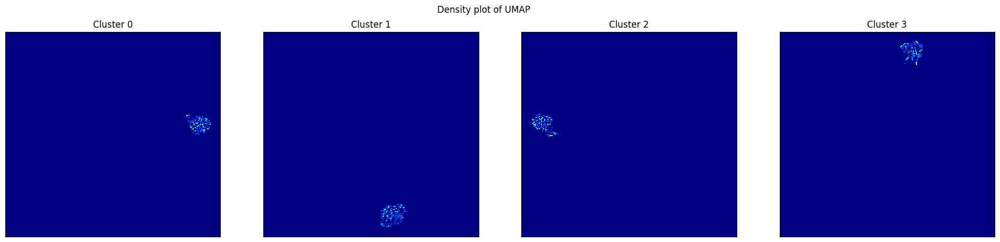

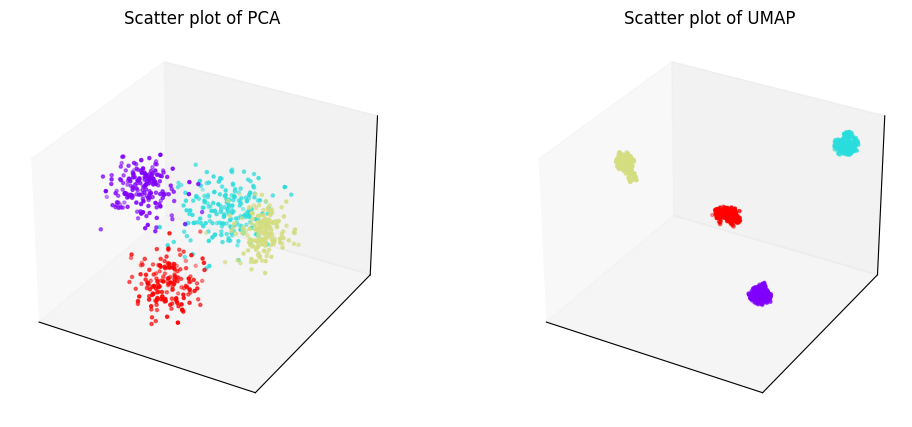

Phylogenetic tree in latent space will be shown below.


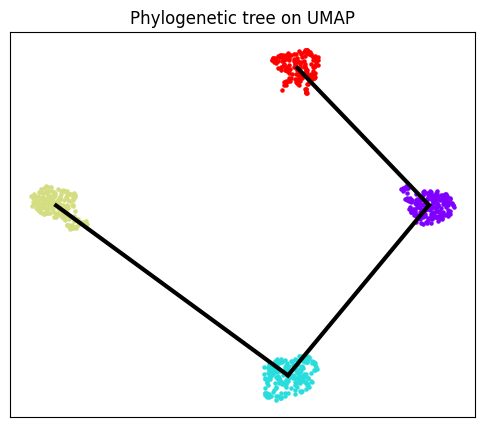

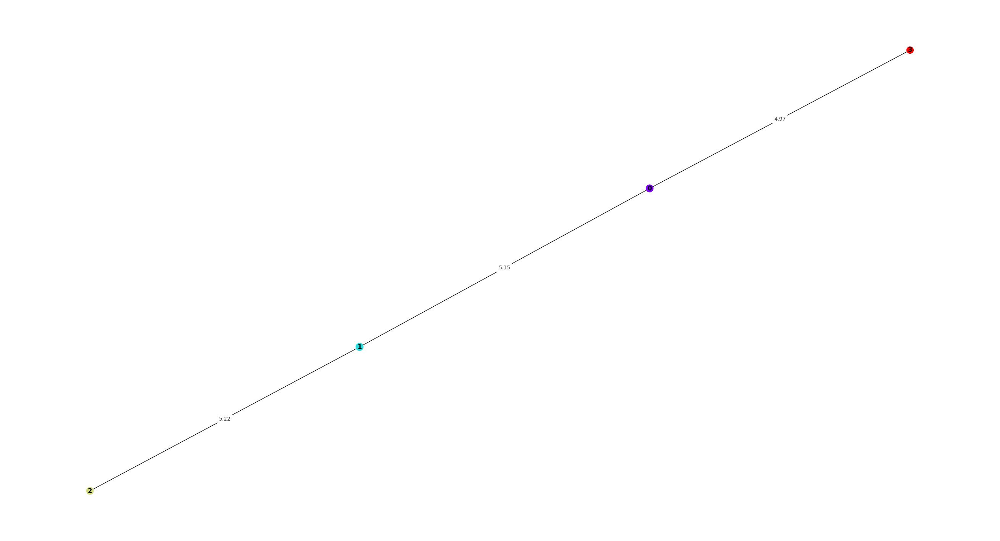

/tmp/ipykernel_1810892/2299804736.py:261: RuntimeWarning: divide by zero encountered in divide
  f_stat = np.clip(1 / ratio_logit_var, 1.001, 20)


SNP-allelic ratios of 734 cells and 50 SNPs will be shown below.


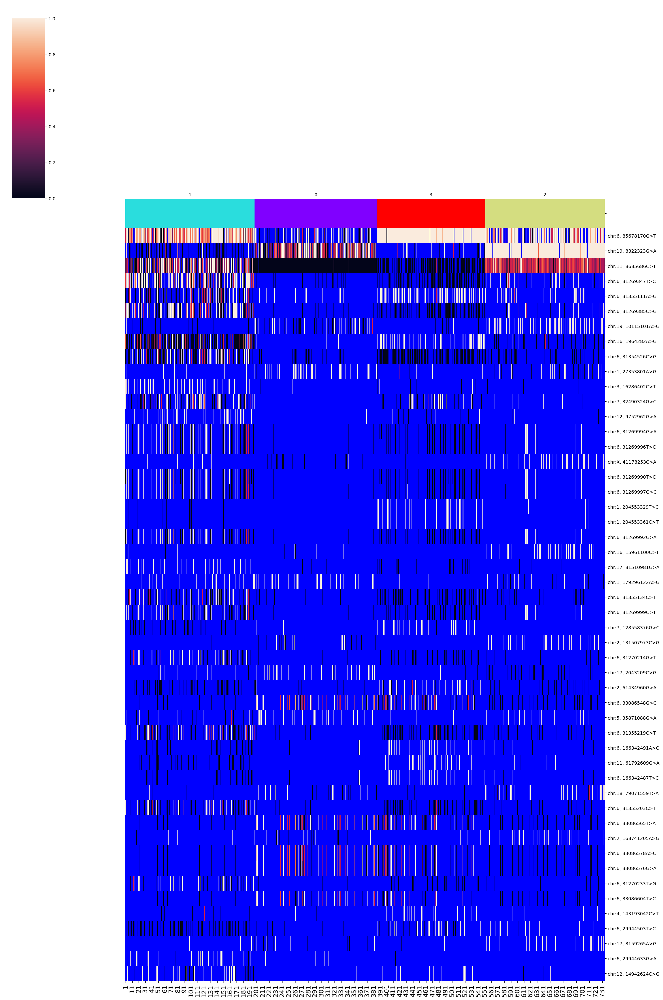

SNPs sorted by lowest p-value will be shown below


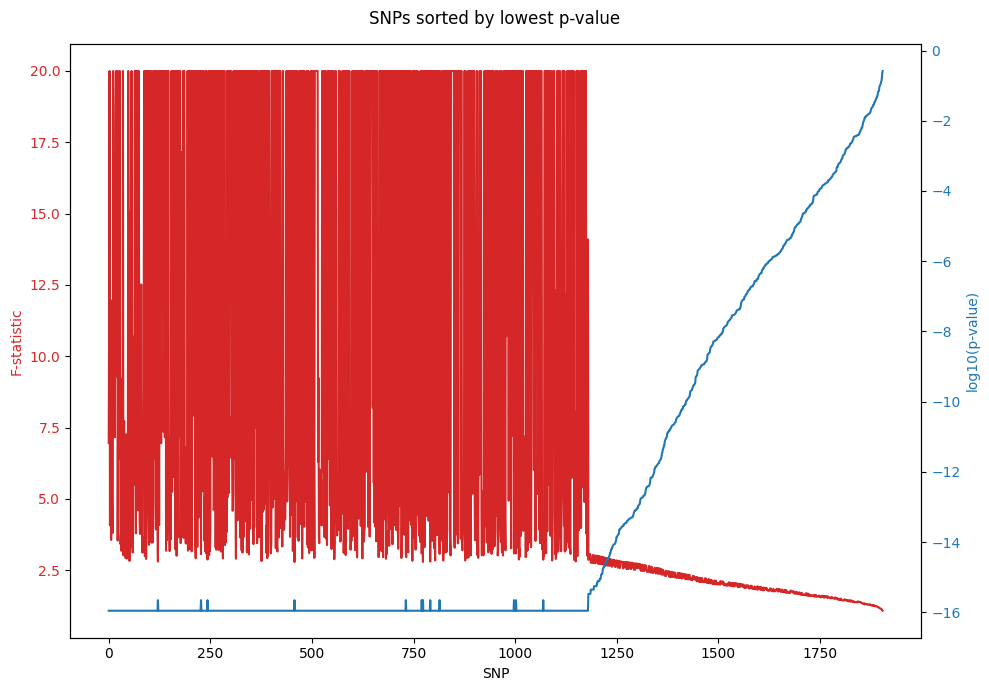

In [33]:
del b_20

%run /home/kevin/storage_kevin/past_figures/figures_final5/notebook/SNPmanifold.ipynb

D_10 = SNP_VAE(AD = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor4/cellSNP.tag.AD.mtx", DP = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor4/cellSNP.tag.DP.mtx", VCF = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor4/cells.cellSNP.vcf.gz")
D_10.filtering()
D_10.training(z_dim = np.ceil(1905 / 10).astype(int))
D_10.clustering(algorithm = "kmeans_umap3d")
D_10.phylogeny(cluster_no = 4)

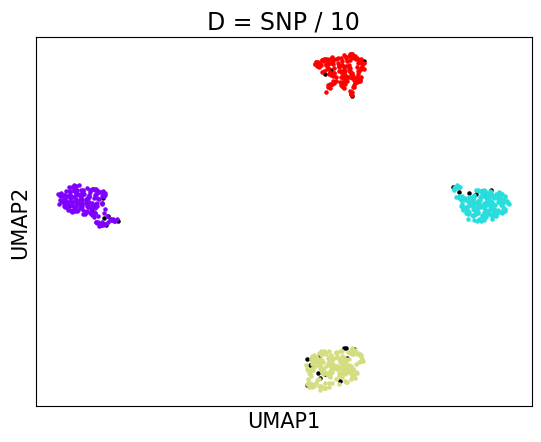

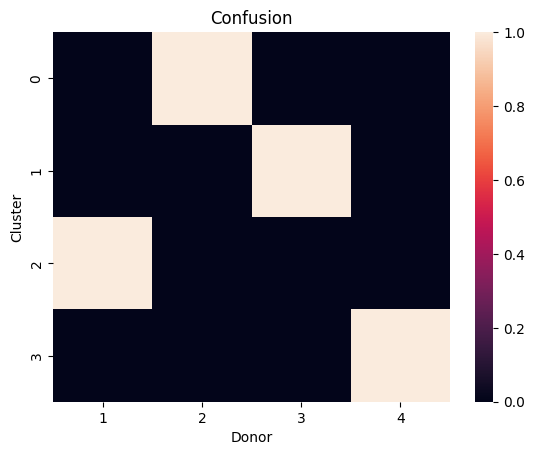

accuracy: 100.0
silhouette score: 0.9255485354272912


In [35]:
D_10_embedding_2d = D_10.embedding_2d

donor = pd.read_csv('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor4/donor_ids.tsv', sep = '\t').iloc[:, 1].to_numpy()[D_10.cell_filter]
name = ["MantonCB1", "MantonCB2", "MantonCB3", "MantonCB4", "doublet", "unassigned"]

clusters = []

for w in name:
    
    clusters.append(np.where(donor == w)[0])

fig, axs = plt.subplots(1, 1)

axs.scatter(D_10.embedding_2d[clusters[4], 0], D_10.embedding_2d[clusters[4], 1], s = 5, color = "black")

for t in range(4):
    
    axs.scatter(D_10.embedding_2d[clusters[t], 0], D_10.embedding_2d[clusters[t], 1], s = 5, color = D_10.colors[t])
    
axs.set_xticks([])
axs.set_yticks([])
axs.set_xlabel("UMAP1", fontsize = 15)
axs.set_ylabel("UMAP2", fontsize = 15)
axs.set_title("D = SNP / 10", fontsize = 17)

plt.show()

name = ["MantonCB1", "MantonCB2", "MantonCB3", "MantonCB4", "doublet", "unassigned"]
reference = np.empty(D_10.cell_total)

for w in range(6):
    
    reference[np.where(donor == name[w])[0]] = w
    
reference = reference.astype(int)
    
matrix = np.zeros((4, 4))
ref_sum = np.zeros(4)

for q in range(D_10.cell_total):
    
    if reference[q] <= 3:

        matrix[reference[q], D_10.assigned_label[q]] += 1
        ref_sum[reference[q]] += 1

prop = matrix / np.outer(ref_sum, np.ones(4))

fig, ax = plt.subplots(1, 1)
ax = sns.heatmap(prop.T[[0, 1, 2, 3], :], xticklabels = [1, 2, 3, 4], yticklabels = [0, 1, 2, 3])
ax.set_ylabel("Cluster")
ax.set_xlabel("Donor")
ax.set_title("Confusion")
plt.show()

print(f'accuracy: {np.mean(np.max(prop, 1)) * 100}')
print(f'silhouette score: {silhouette_score(D_10.pair_embedding_3d[reference <= 3, :][:, reference <= 3], reference[reference <= 3], metric = "precomputed")}')

Start loading raw data.
Finish loading raw data.
Start filtering low-quality cells and SNPs.


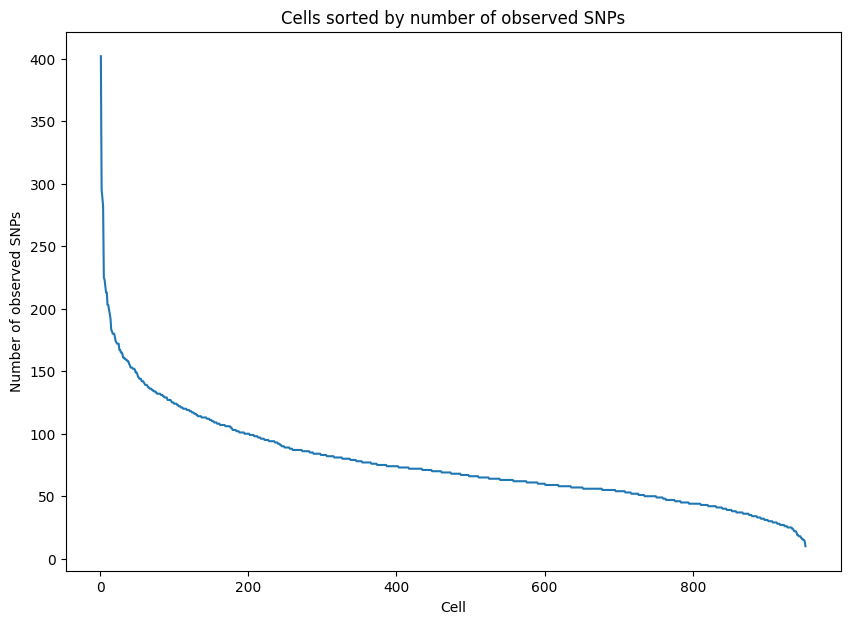

Please determine y-axis threshold in the plot to filter low-quality cells with low number of observed SNPs.   50


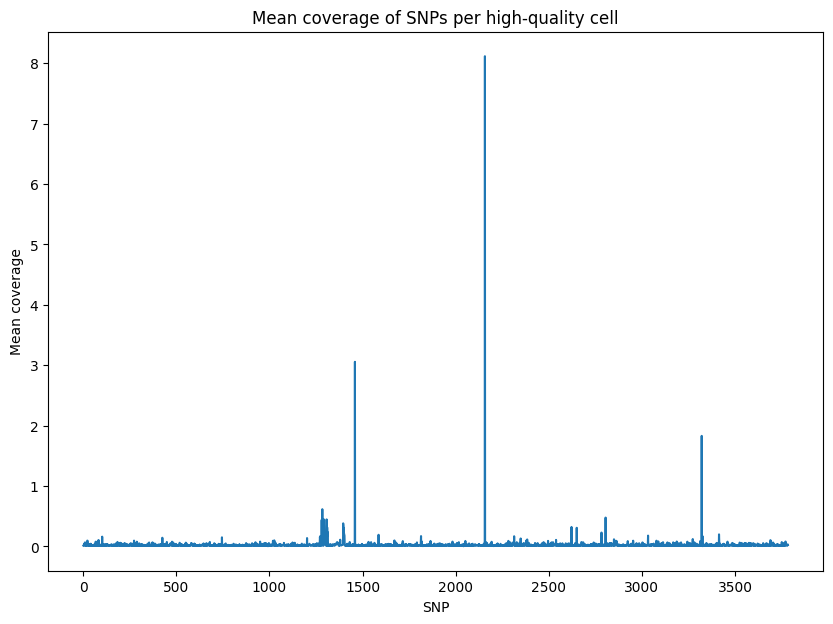

Please determine y-axis threshold in the plot to filter low-quality SNPs with low coverage.   0


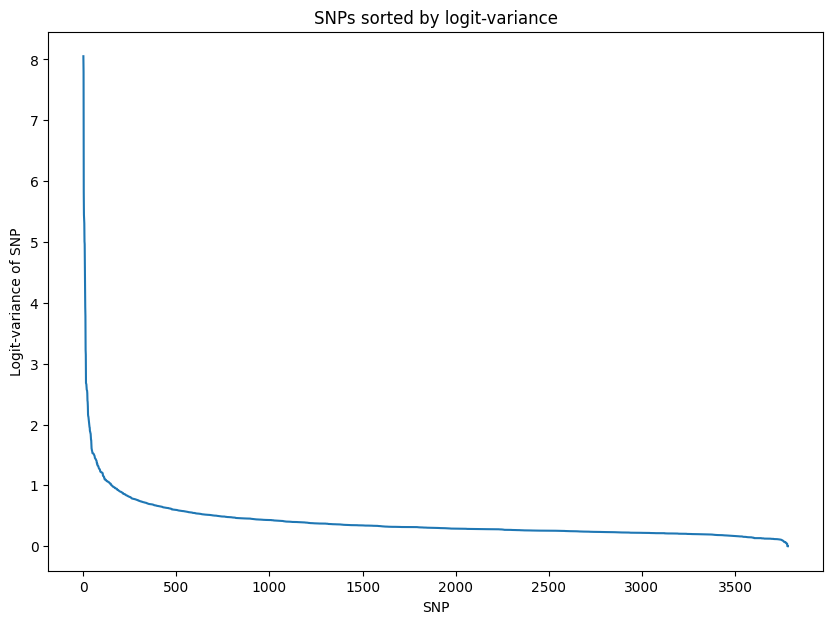

Please determine y-axis threshold in the plot to filter low-quality SNPs with low logit-variance.   0.3
Finish filtering low-quality data, 734 cells and 1905 SNPs will be used for downstream analysis.
Start training VAE.
Epoch[10/2000], Cost: 0.860388
Epoch[20/2000], Cost: 0.797561
Epoch[30/2000], Cost: 0.738624
Epoch[40/2000], Cost: 0.678540
Epoch[50/2000], Cost: 0.624036
Epoch[60/2000], Cost: 0.571163
Epoch[70/2000], Cost: 0.520988
Epoch[80/2000], Cost: 0.476784
Epoch[90/2000], Cost: 0.434483
Epoch[100/2000], Cost: 0.398557
Epoch[200/2000], Cost: 0.198953
Epoch[300/2000], Cost: 0.132595
Epoch[400/2000], Cost: 0.108597
Epoch[500/2000], Cost: 0.098851
Epoch[600/2000], Cost: 0.094433
Epoch[700/2000], Cost: 0.091982
Epoch[800/2000], Cost: 0.090582
Epoch[900/2000], Cost: 0.089660
Epoch[1000/2000], Cost: 0.089120
Epoch[1100/2000], Cost: 0.088675
Epoch[1200/2000], Cost: 0.088382
Epoch[1300/2000], Cost: 0.088190
Epoch[1400/2000], Cost: 0.088037
Epoch[1500/2000], Cost: 0.087908
Epoch[1600/200

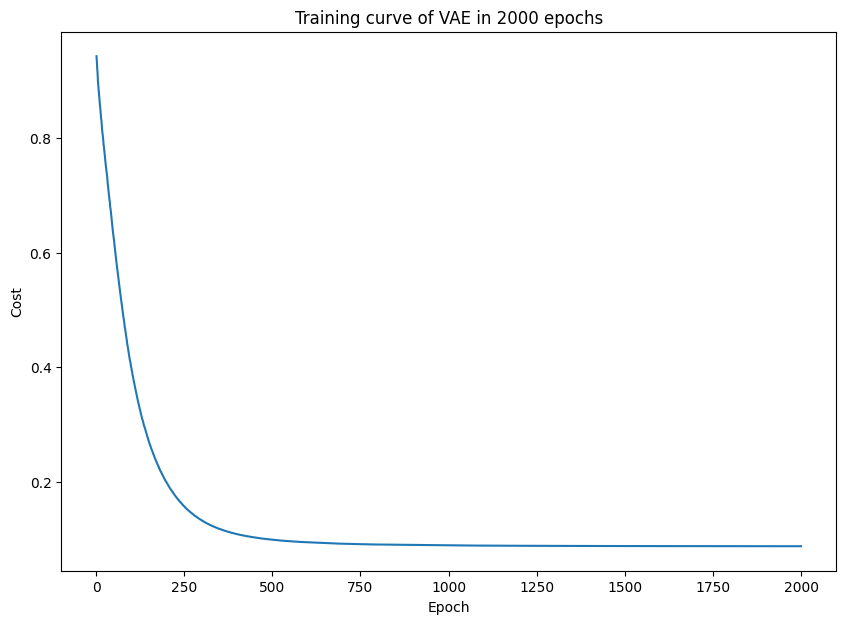

Start learning PCA and UMAP of latent space in VAE.
Finish learning, PCA and UMAP of latent space will be shown below.


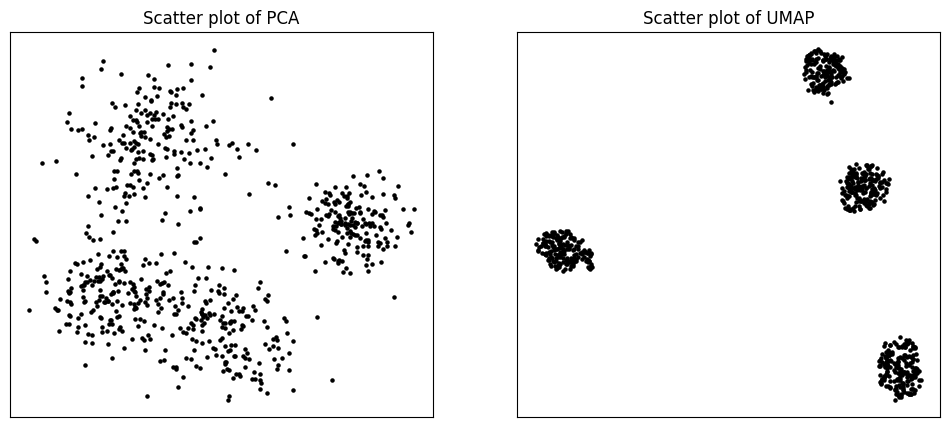

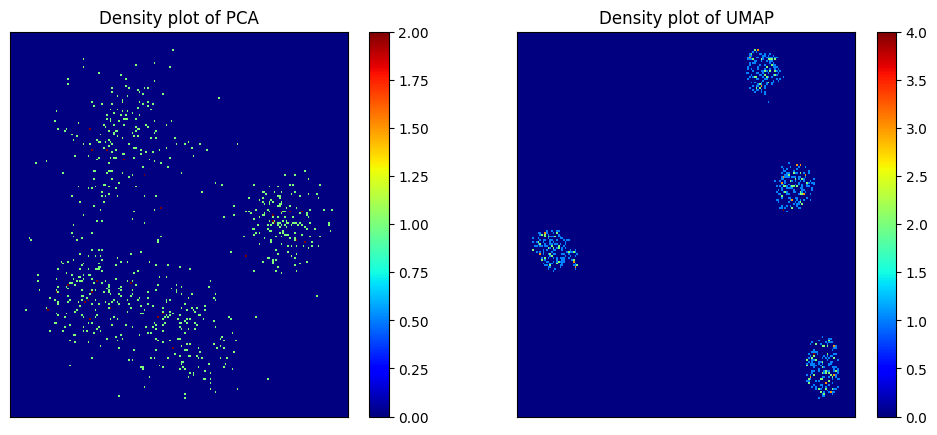

Start clustering.
2 clusters, Distortion: 22381.607422
3 clusters, Distortion: 4796.243164
4 clusters, Distortion: 379.809082
5 clusters, Distortion: 333.056976
6 clusters, Distortion: 314.714661
7 clusters, Distortion: 289.729919
8 clusters, Distortion: 251.679474
9 clusters, Distortion: 230.463654
10 clusters, Distortion: 218.291016
11 clusters, Distortion: 204.345581
12 clusters, Distortion: 183.300293
13 clusters, Distortion: 171.892654
14 clusters, Distortion: 158.079376
15 clusters, Distortion: 157.313919
Finish clustering, PCA, UMAP, distortion, silhouette score of K-means clustering will be shown below.


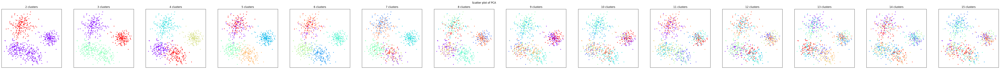

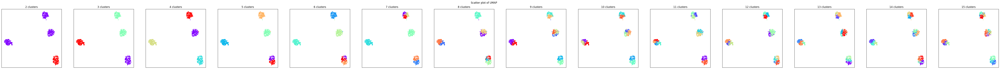

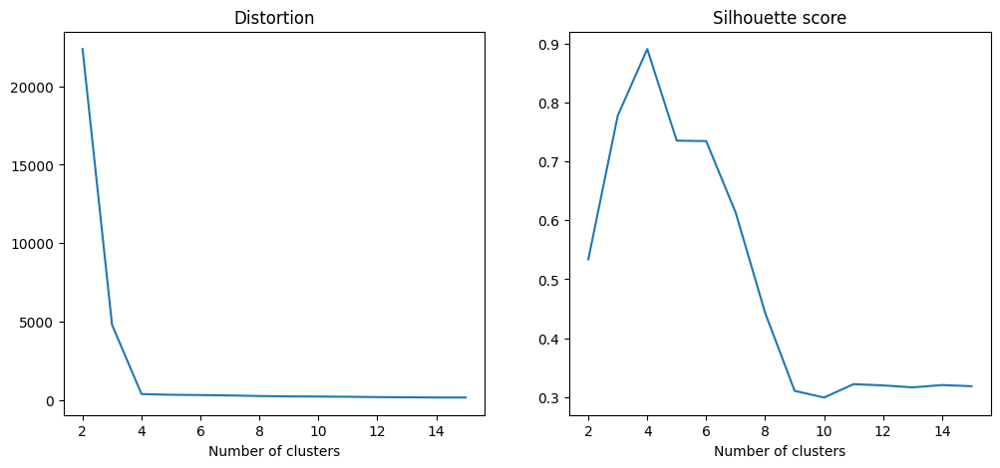

PCA and UMAP of individual clusters will be shown below.


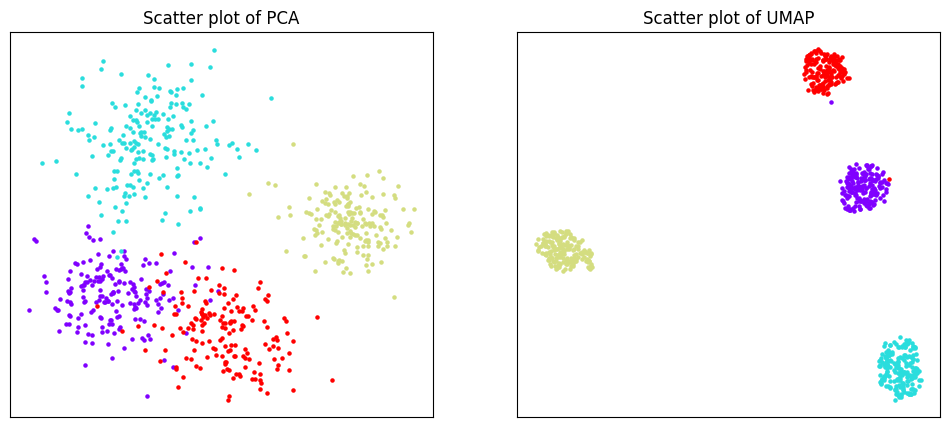

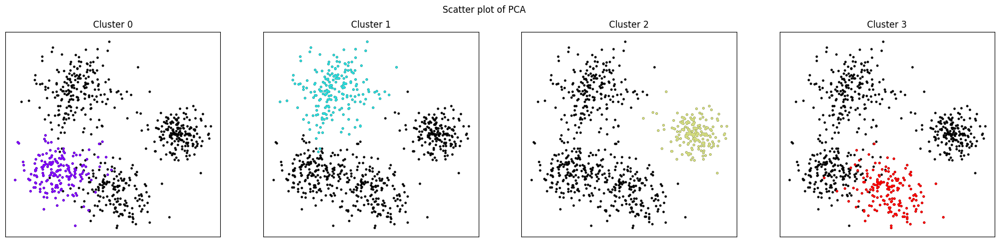

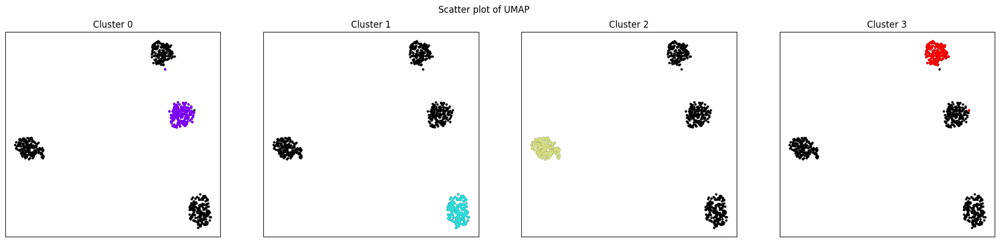

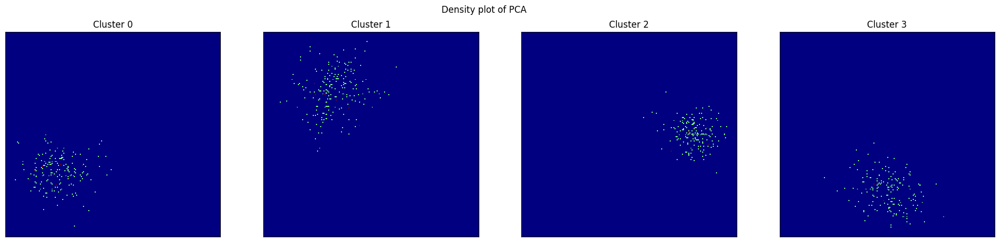

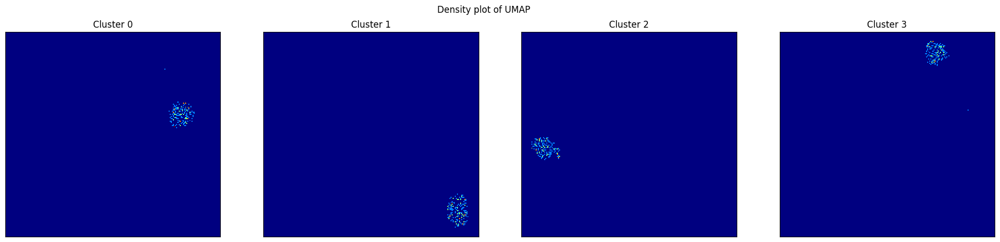

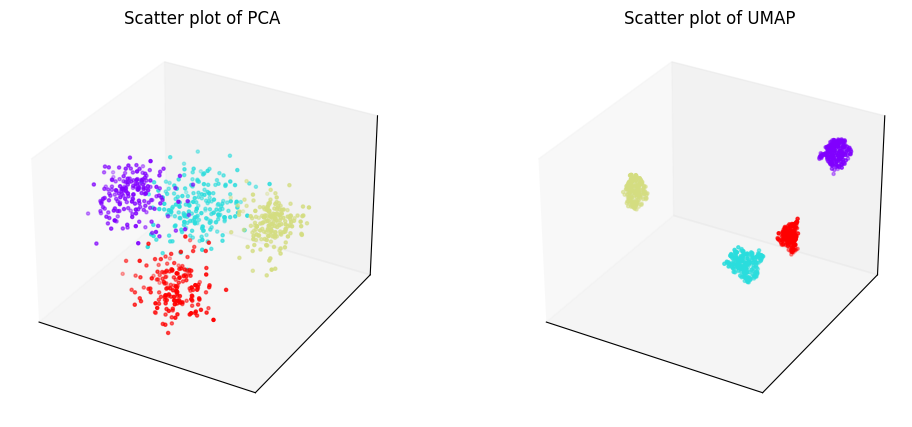

Phylogenetic tree in latent space will be shown below.


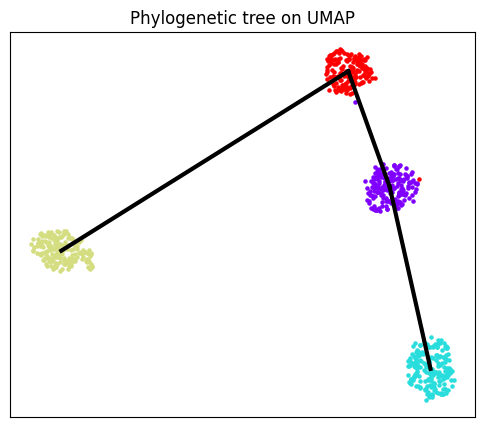

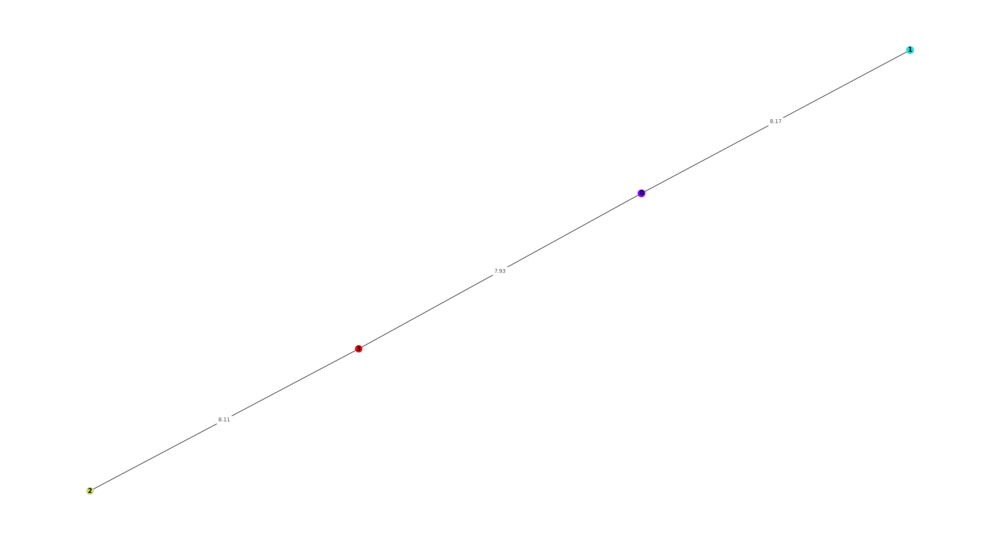

/tmp/ipykernel_1810892/2299804736.py:261: RuntimeWarning: divide by zero encountered in divide
  f_stat = np.clip(1 / ratio_logit_var, 1.001, 20)


SNP-allelic ratios of 734 cells and 50 SNPs will be shown below.


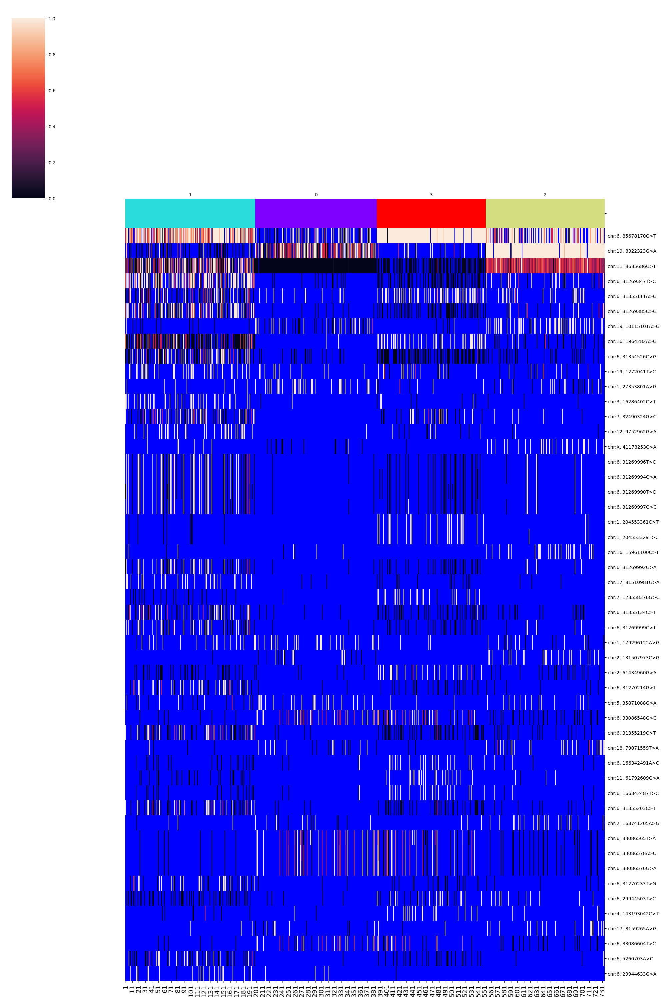

SNPs sorted by lowest p-value will be shown below


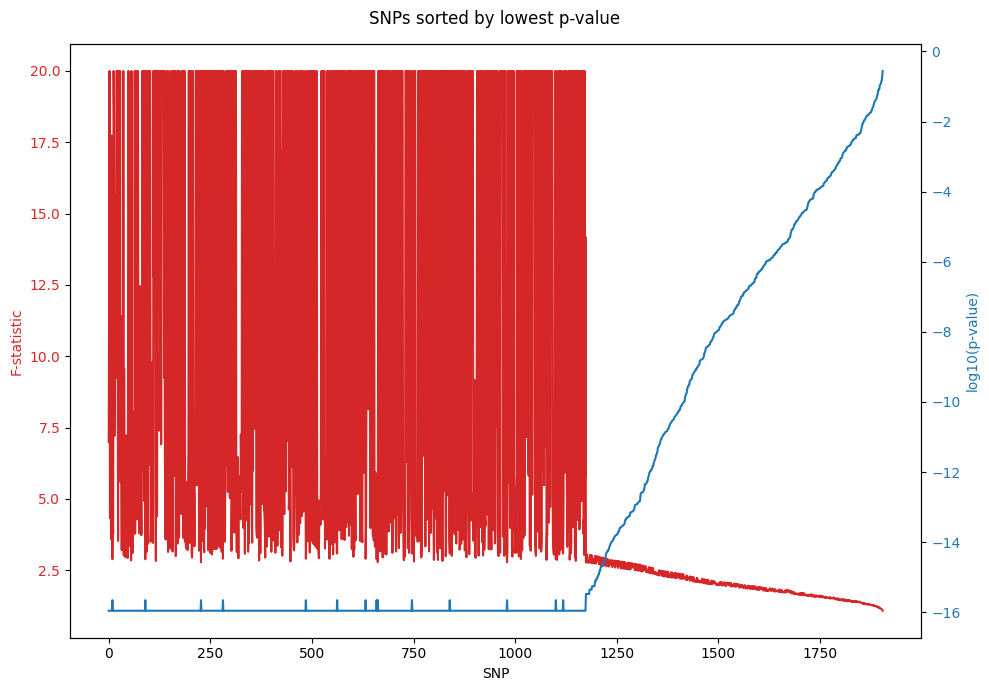

In [36]:
del D_10

%run /home/kevin/storage_kevin/past_figures/figures_final5/notebook/SNPmanifold.ipynb

D_30 = SNP_VAE(AD = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor4/cellSNP.tag.AD.mtx", DP = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor4/cellSNP.tag.DP.mtx", VCF = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor4/cells.cellSNP.vcf.gz")
D_30.filtering()
D_30.training(z_dim = np.ceil(1905 / 30).astype(int))
D_30.clustering(algorithm = "kmeans_umap3d")
D_30.phylogeny(cluster_no = 4)

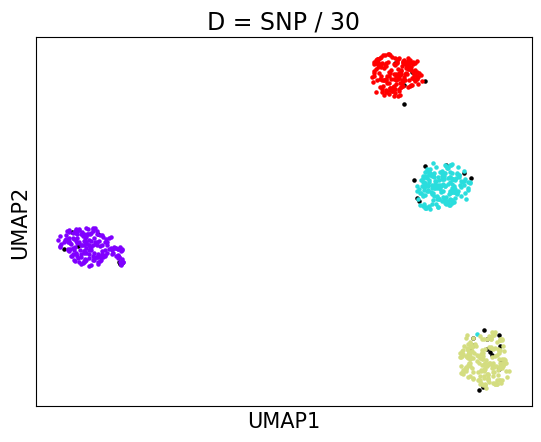

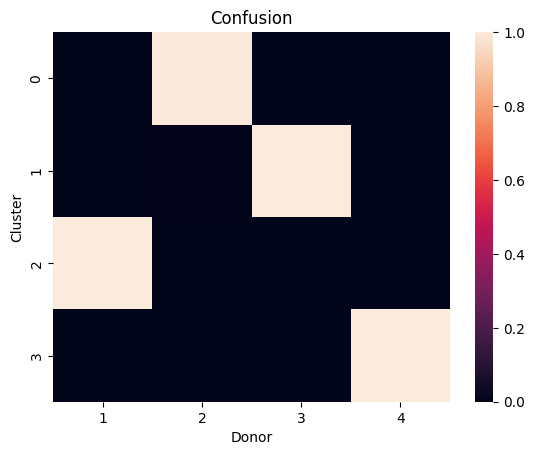

accuracy: 99.86111111111111
silhouette score: 0.8881316484905083


In [37]:
D_30_embedding_2d = D_30.embedding_2d

donor = pd.read_csv('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor4/donor_ids.tsv', sep = '\t').iloc[:, 1].to_numpy()[D_30.cell_filter]
name = ["MantonCB1", "MantonCB2", "MantonCB3", "MantonCB4", "doublet", "unassigned"]

clusters = []

for w in name:
    
    clusters.append(np.where(donor == w)[0])

fig, axs = plt.subplots(1, 1)

axs.scatter(D_30.embedding_2d[clusters[4], 0], D_30.embedding_2d[clusters[4], 1], s = 5, color = "black")

for t in range(4):
    
    axs.scatter(D_30.embedding_2d[clusters[t], 0], D_30.embedding_2d[clusters[t], 1], s = 5, color = D_30.colors[t])
    
axs.set_xticks([])
axs.set_yticks([])
axs.set_xlabel("UMAP1", fontsize = 15)
axs.set_ylabel("UMAP2", fontsize = 15)
axs.set_title("D = SNP / 30", fontsize = 17)

plt.show()

name = ["MantonCB1", "MantonCB2", "MantonCB3", "MantonCB4", "doublet", "unassigned"]
reference = np.empty(D_30.cell_total)

for w in range(6):
    
    reference[np.where(donor == name[w])[0]] = w
    
reference = reference.astype(int)
    
matrix = np.zeros((4, 4))
ref_sum = np.zeros(4)

for q in range(D_30.cell_total):
    
    if reference[q] <= 3:

        matrix[reference[q], D_30.assigned_label[q]] += 1
        ref_sum[reference[q]] += 1

prop = matrix / np.outer(ref_sum, np.ones(4))

fig, ax = plt.subplots(1, 1)
ax = sns.heatmap(prop.T[[0, 1, 2, 3], :], xticklabels = [1, 2, 3, 4], yticklabels = [0, 1, 2, 3])
ax.set_ylabel("Cluster")
ax.set_xlabel("Donor")
ax.set_title("Confusion")
plt.show()

print(f'accuracy: {np.mean(np.max(prop, 1)) * 100}')
print(f'silhouette score: {silhouette_score(D_30.pair_embedding_3d[reference <= 3, :][:, reference <= 3], reference[reference <= 3], metric = "precomputed")}')

Start loading raw data.
Finish loading raw data.
Start filtering low-quality cells and SNPs.


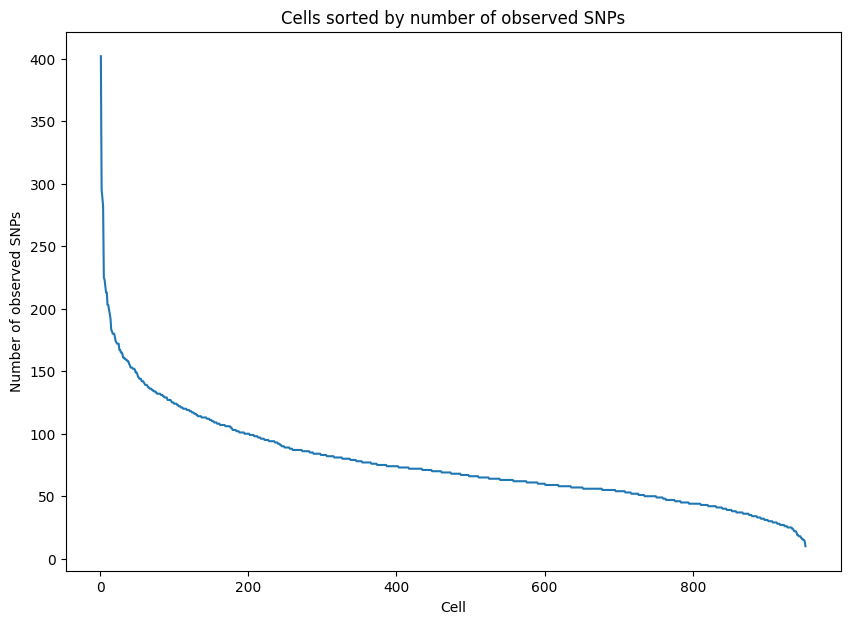

Please determine y-axis threshold in the plot to filter low-quality cells with low number of observed SNPs.   50


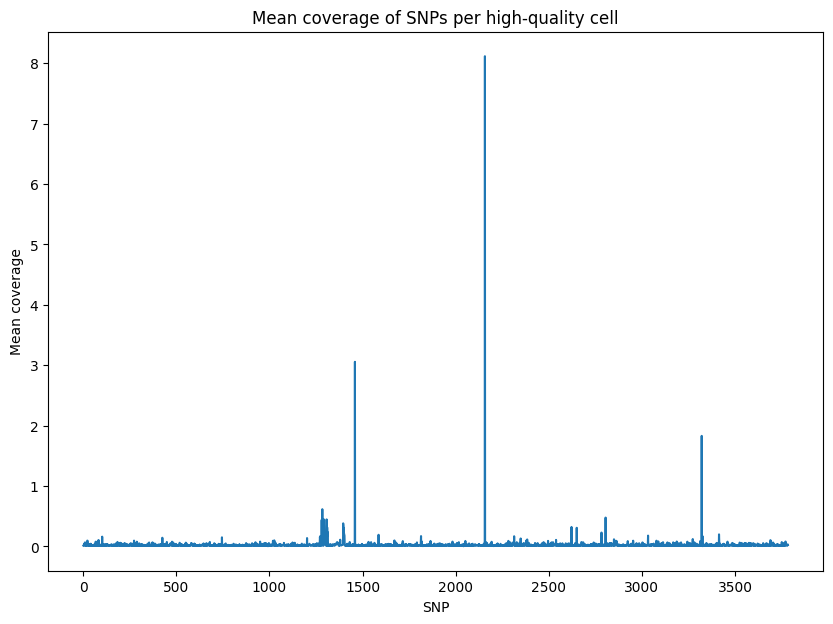

Please determine y-axis threshold in the plot to filter low-quality SNPs with low coverage.   0


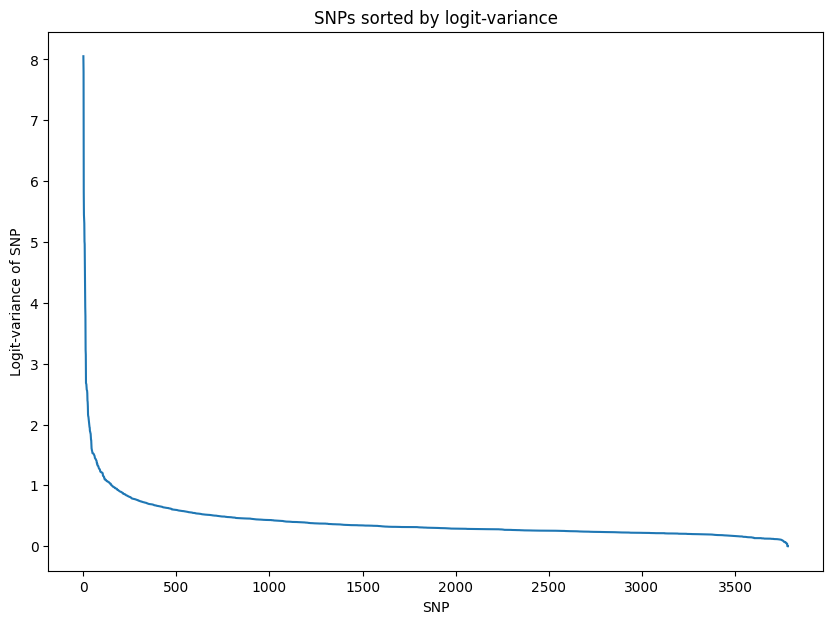

Please determine y-axis threshold in the plot to filter low-quality SNPs with low logit-variance.   0.3
Finish filtering low-quality data, 734 cells and 1905 SNPs will be used for downstream analysis.
Start training VAE.
Epoch[10/2000], Cost: 0.871014
Epoch[20/2000], Cost: 0.819514
Epoch[30/2000], Cost: 0.773757
Epoch[40/2000], Cost: 0.733259
Epoch[50/2000], Cost: 0.689794
Epoch[60/2000], Cost: 0.650046
Epoch[70/2000], Cost: 0.610017
Epoch[80/2000], Cost: 0.571993
Epoch[90/2000], Cost: 0.536366
Epoch[100/2000], Cost: 0.502012
Epoch[200/2000], Cost: 0.277466
Epoch[300/2000], Cost: 0.180797
Epoch[400/2000], Cost: 0.135507
Epoch[500/2000], Cost: 0.113409
Epoch[600/2000], Cost: 0.102478
Epoch[700/2000], Cost: 0.096789
Epoch[800/2000], Cost: 0.093515
Epoch[900/2000], Cost: 0.091557
Epoch[1000/2000], Cost: 0.090324
Epoch[1100/2000], Cost: 0.089551
Epoch[1200/2000], Cost: 0.089010
Epoch[1300/2000], Cost: 0.088621
Epoch[1400/2000], Cost: 0.088341
Epoch[1500/2000], Cost: 0.088128
Epoch[1600/200

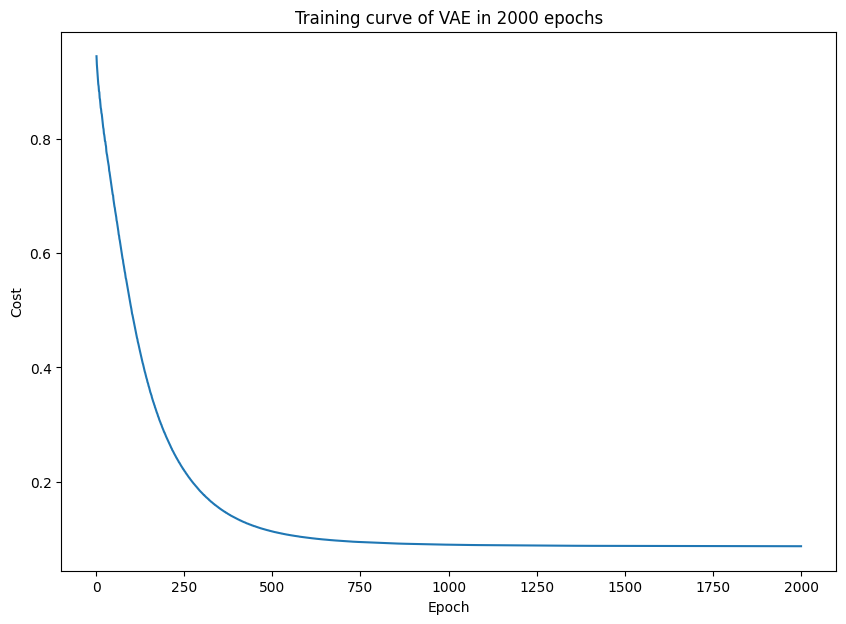

Start learning PCA and UMAP of latent space in VAE.
Finish learning, PCA and UMAP of latent space will be shown below.


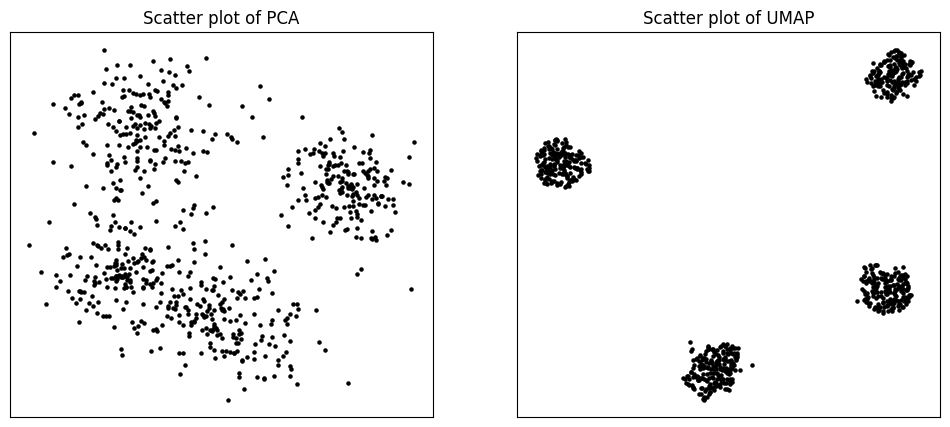

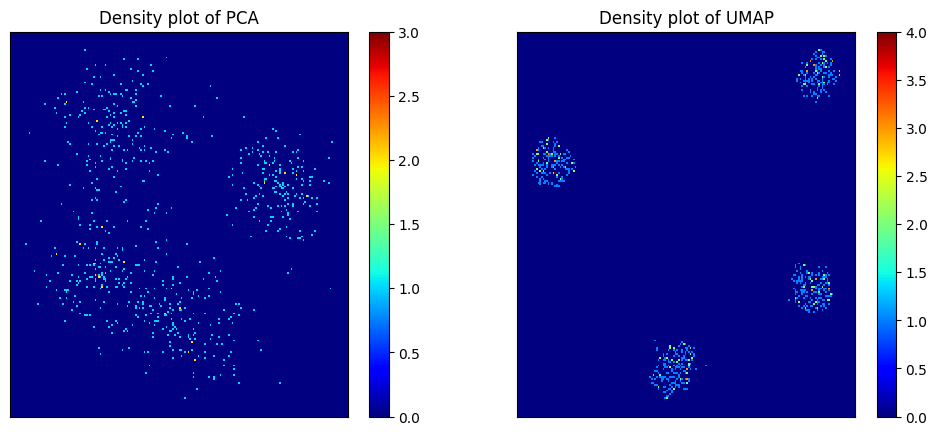

Start clustering.
2 clusters, Distortion: 14884.339844
3 clusters, Distortion: 5605.212891
4 clusters, Distortion: 348.372803
5 clusters, Distortion: 322.648560
6 clusters, Distortion: 308.875122
7 clusters, Distortion: 271.201599
8 clusters, Distortion: 256.758179
9 clusters, Distortion: 240.334991
10 clusters, Distortion: 218.105743
11 clusters, Distortion: 200.970581
12 clusters, Distortion: 192.647202
13 clusters, Distortion: 176.117371
14 clusters, Distortion: 171.791367
15 clusters, Distortion: 151.878952
Finish clustering, PCA, UMAP, distortion, silhouette score of K-means clustering will be shown below.


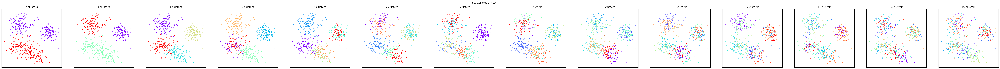

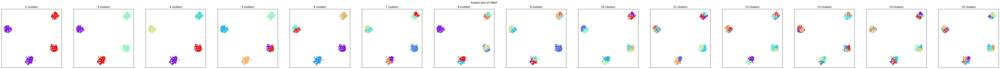

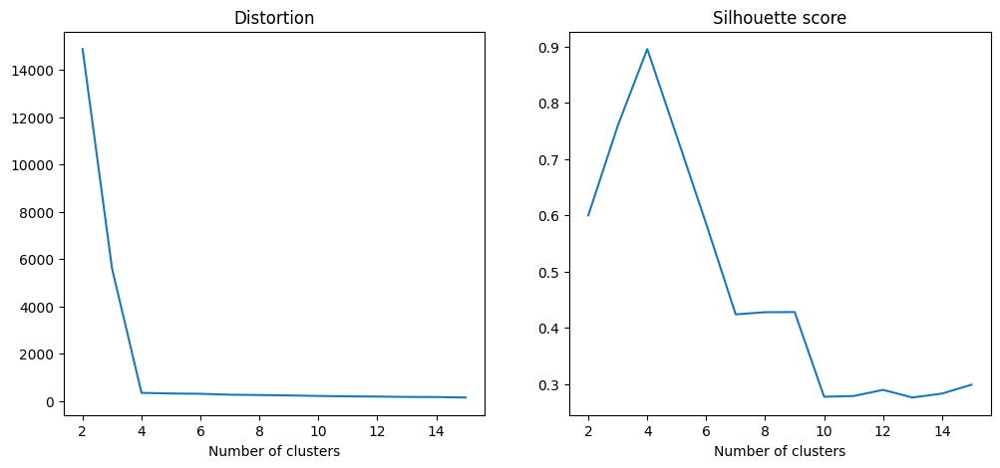

PCA and UMAP of individual clusters will be shown below.


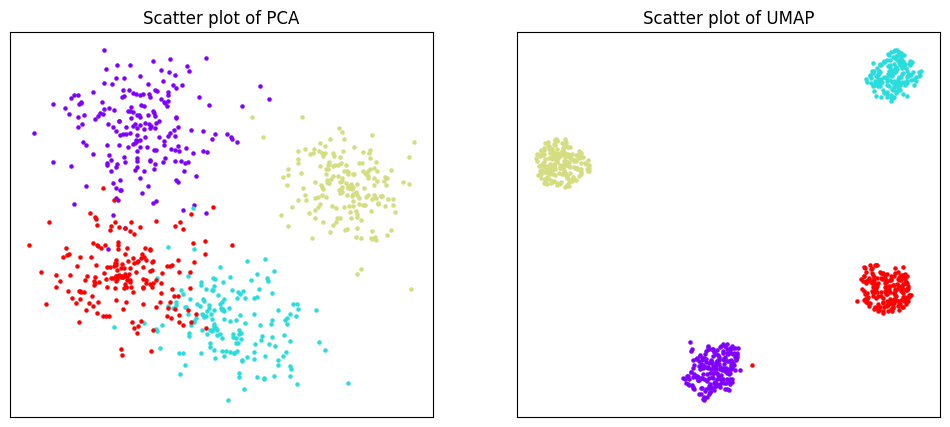

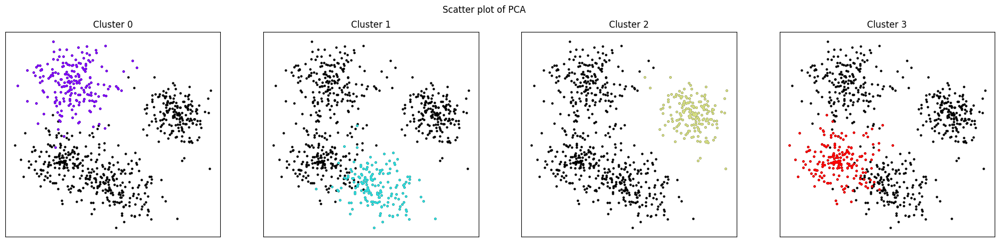

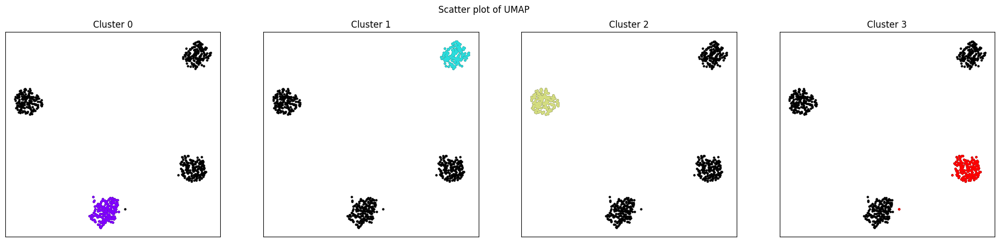

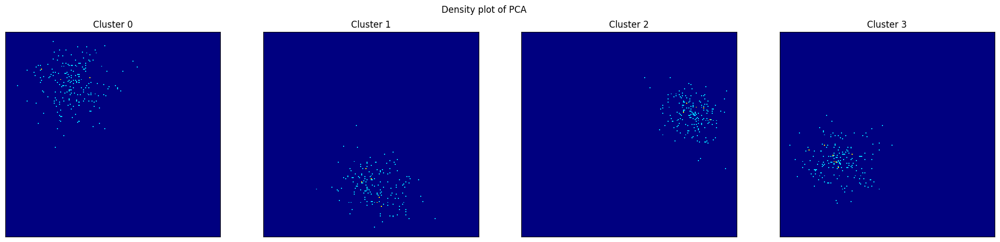

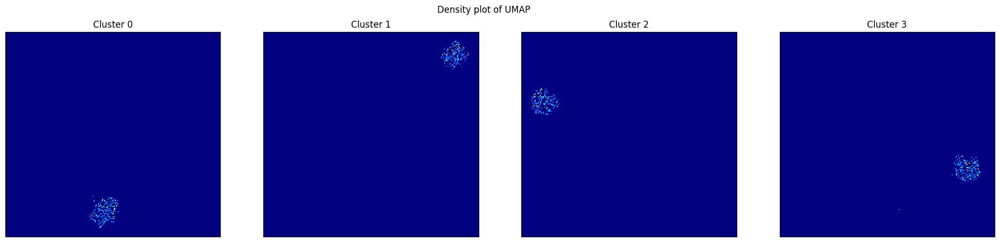

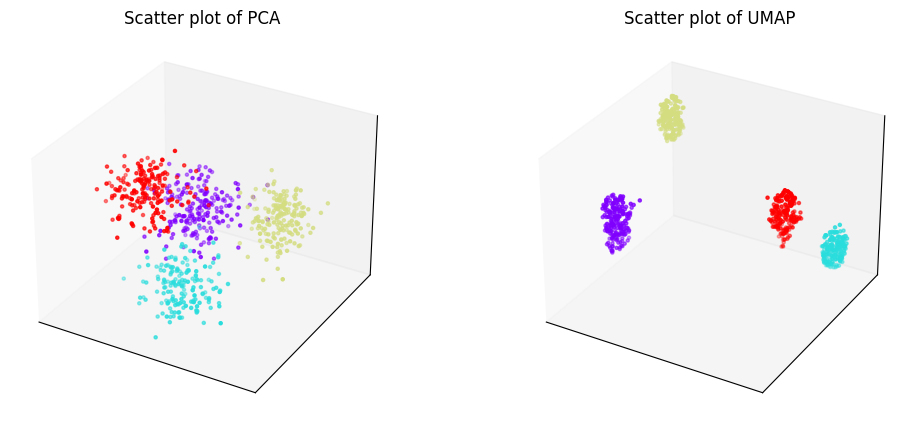

Phylogenetic tree in latent space will be shown below.


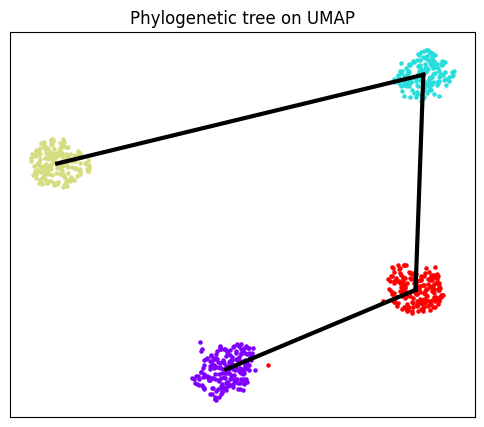

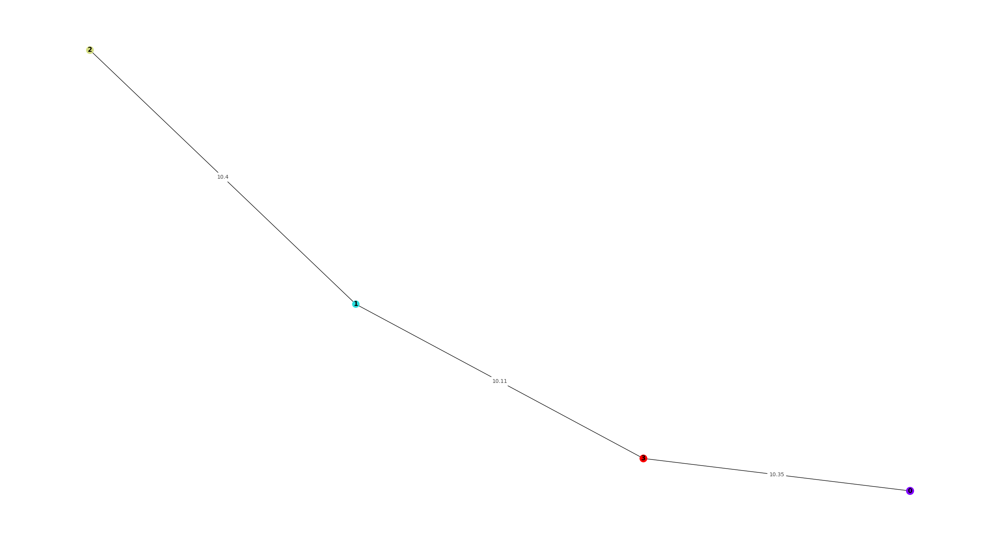

/tmp/ipykernel_1810892/2299804736.py:261: RuntimeWarning: divide by zero encountered in divide
  f_stat = np.clip(1 / ratio_logit_var, 1.001, 20)


SNP-allelic ratios of 734 cells and 50 SNPs will be shown below.


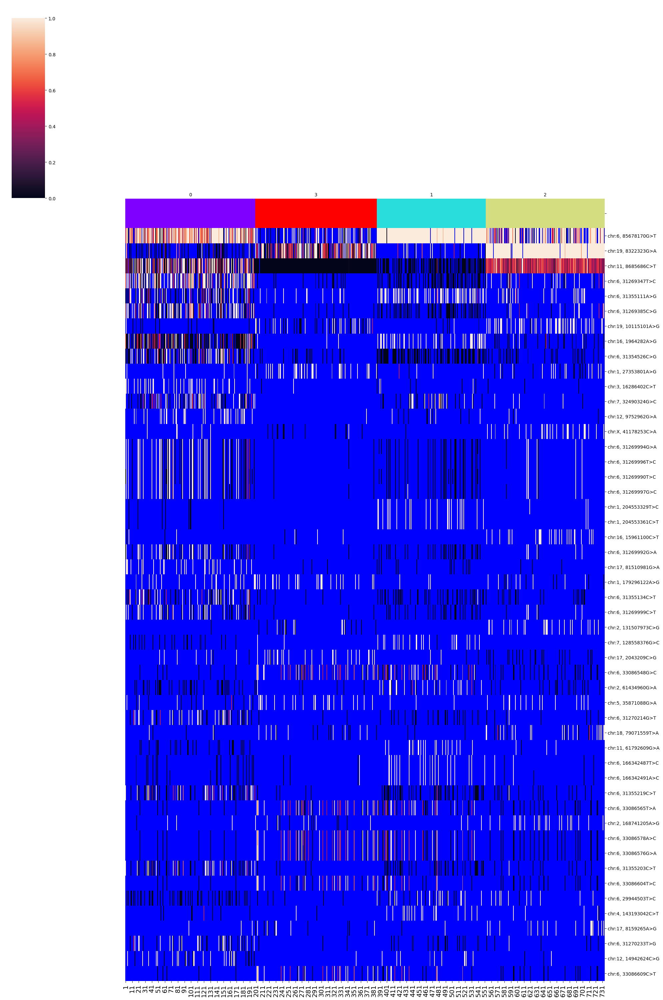

SNPs sorted by lowest p-value will be shown below


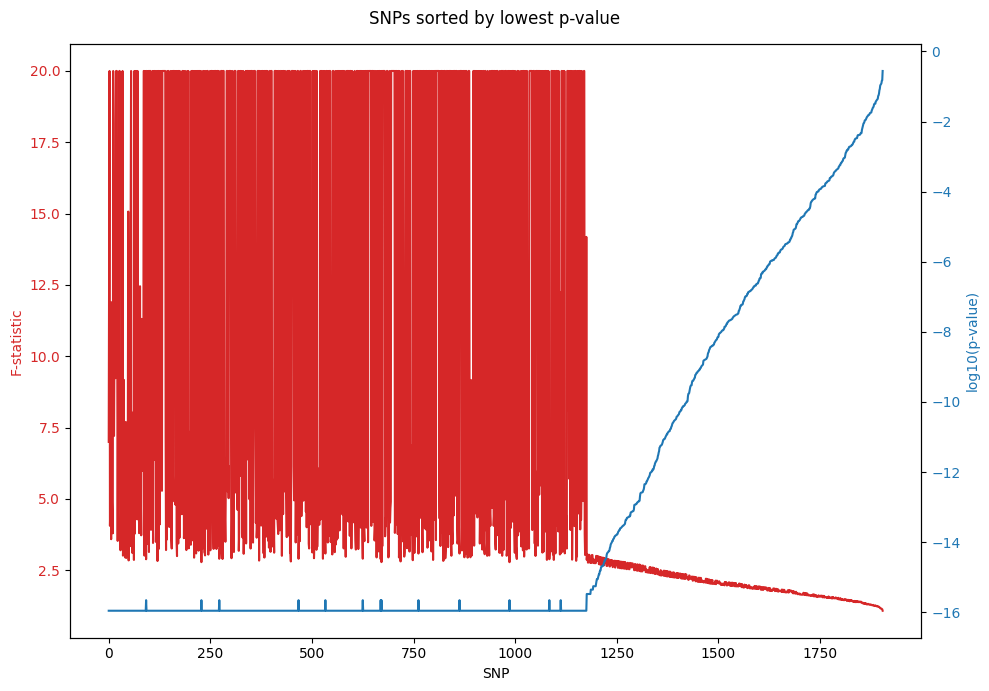

In [38]:
del D_30

%run /home/kevin/storage_kevin/past_figures/figures_final5/notebook/SNPmanifold.ipynb

D_50 = SNP_VAE(AD = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor4/cellSNP.tag.AD.mtx", DP = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor4/cellSNP.tag.DP.mtx", VCF = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor4/cells.cellSNP.vcf.gz")
D_50.filtering()
D_50.training(z_dim = np.ceil(1905 / 50).astype(int))
D_50.clustering(algorithm = "kmeans_umap3d")
D_50.phylogeny(cluster_no = 4)

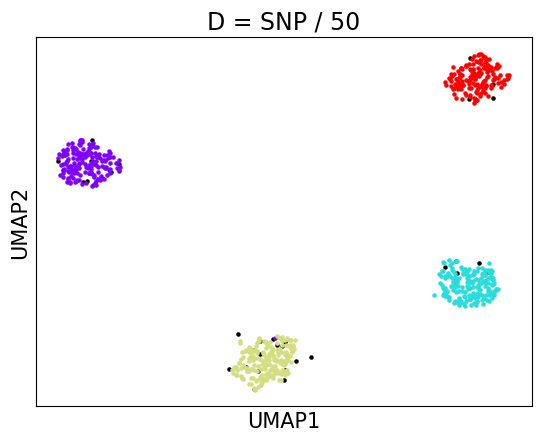

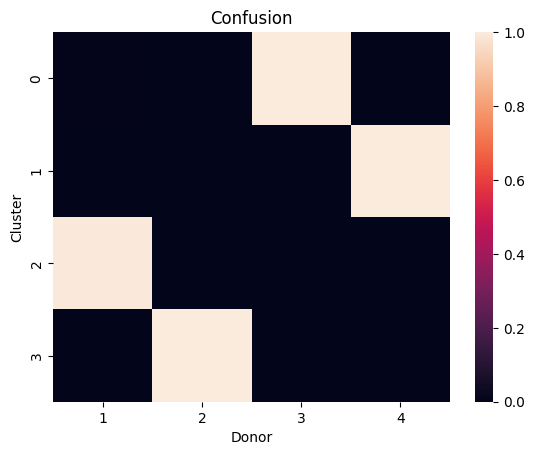

accuracy: 99.85714285714286
silhouette score: 0.8924709957830915


In [39]:
D_50_embedding_2d = D_50.embedding_2d

donor = pd.read_csv('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor4/donor_ids.tsv', sep = '\t').iloc[:, 1].to_numpy()[D_50.cell_filter]
name = ["MantonCB1", "MantonCB2", "MantonCB3", "MantonCB4", "doublet", "unassigned"]

clusters = []

for w in name:
    
    clusters.append(np.where(donor == w)[0])

fig, axs = plt.subplots(1, 1)

axs.scatter(D_50.embedding_2d[clusters[4], 0], D_50.embedding_2d[clusters[4], 1], s = 5, color = "black")

for t in range(4):
    
    axs.scatter(D_50.embedding_2d[clusters[t], 0], D_50.embedding_2d[clusters[t], 1], s = 5, color = D_50.colors[t])
    
axs.set_xticks([])
axs.set_yticks([])
axs.set_xlabel("UMAP1", fontsize = 15)
axs.set_ylabel("UMAP2", fontsize = 15)
axs.set_title("D = SNP / 50", fontsize = 17)

plt.show()

name = ["MantonCB1", "MantonCB2", "MantonCB3", "MantonCB4", "doublet", "unassigned"]
reference = np.empty(D_50.cell_total)

for w in range(6):
    
    reference[np.where(donor == name[w])[0]] = w
    
reference = reference.astype(int)
    
matrix = np.zeros((4, 4))
ref_sum = np.zeros(4)

for q in range(D_50.cell_total):
    
    if reference[q] <= 3:

        matrix[reference[q], D_50.assigned_label[q]] += 1
        ref_sum[reference[q]] += 1

prop = matrix / np.outer(ref_sum, np.ones(4))

fig, ax = plt.subplots(1, 1)
ax = sns.heatmap(prop.T[[0, 1, 2, 3], :], xticklabels = [1, 2, 3, 4], yticklabels = [0, 1, 2, 3])
ax.set_ylabel("Cluster")
ax.set_xlabel("Donor")
ax.set_title("Confusion")
plt.show()

print(f'accuracy: {np.mean(np.max(prop, 1)) * 100}')
print(f'silhouette score: {silhouette_score(D_50.pair_embedding_3d[reference <= 3, :][:, reference <= 3], reference[reference <= 3], metric = "precomputed")}')

Start loading raw data.
Finish loading raw data.
Start filtering low-quality cells and SNPs.


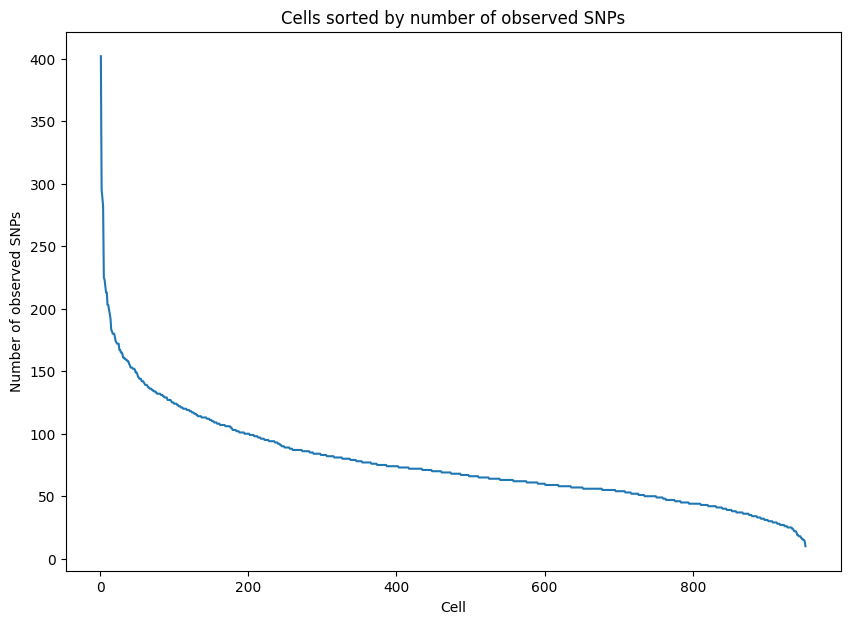

Please determine y-axis threshold in the plot to filter low-quality cells with low number of observed SNPs.   50


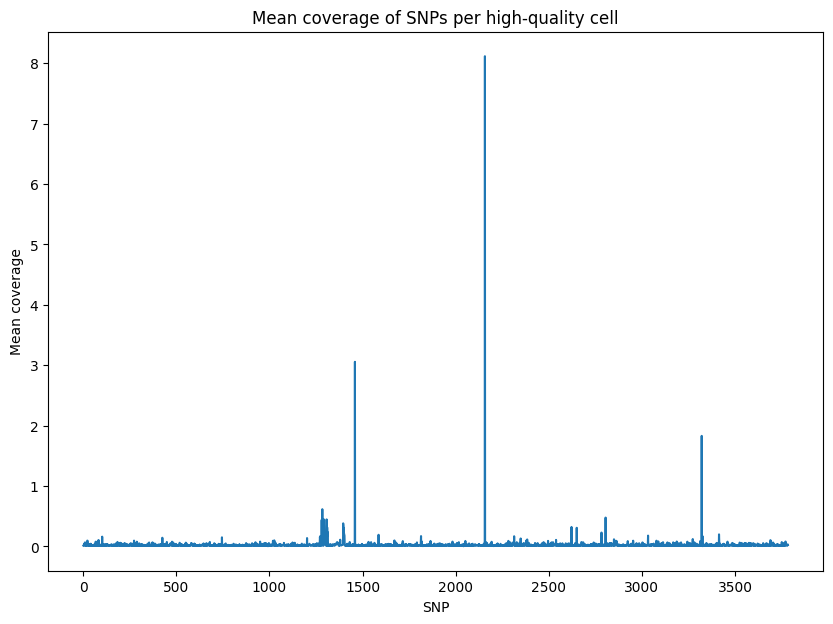

Please determine y-axis threshold in the plot to filter low-quality SNPs with low coverage.   0


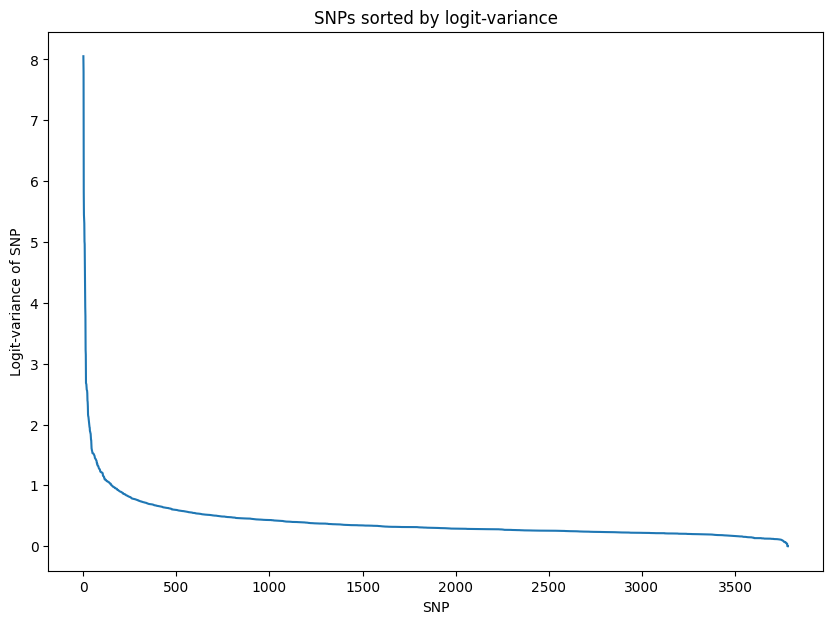

Please determine y-axis threshold in the plot to filter low-quality SNPs with low logit-variance.   0.3
Finish filtering low-quality data, 734 cells and 1905 SNPs will be used for downstream analysis.
Start training VAE.
Epoch[10/2000], Cost: 0.895263
Epoch[20/2000], Cost: 0.853324
Epoch[30/2000], Cost: 0.821020
Epoch[40/2000], Cost: 0.789468
Epoch[50/2000], Cost: 0.762112
Epoch[60/2000], Cost: 0.733690
Epoch[70/2000], Cost: 0.705666
Epoch[80/2000], Cost: 0.680705
Epoch[90/2000], Cost: 0.653834
Epoch[100/2000], Cost: 0.629527
Epoch[200/2000], Cost: 0.430057
Epoch[300/2000], Cost: 0.308871
Epoch[400/2000], Cost: 0.234056
Epoch[500/2000], Cost: 0.185532
Epoch[600/2000], Cost: 0.152798
Epoch[700/2000], Cost: 0.130921
Epoch[800/2000], Cost: 0.116447
Epoch[900/2000], Cost: 0.106861
Epoch[1000/2000], Cost: 0.100582
Epoch[1100/2000], Cost: 0.096456
Epoch[1200/2000], Cost: 0.093714
Epoch[1300/2000], Cost: 0.091893
Epoch[1400/2000], Cost: 0.090650
Epoch[1500/2000], Cost: 0.089798
Epoch[1600/200

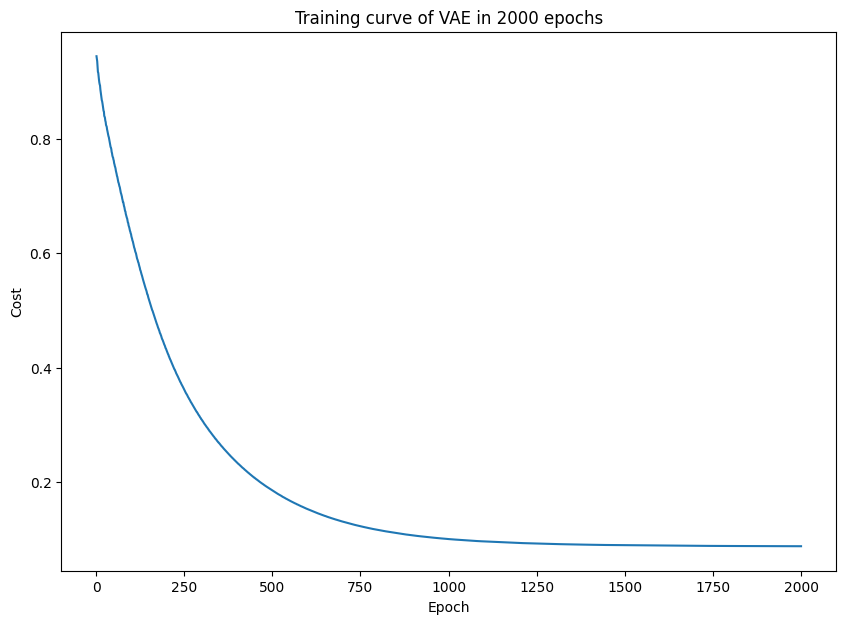

Start learning PCA and UMAP of latent space in VAE.
Finish learning, PCA and UMAP of latent space will be shown below.


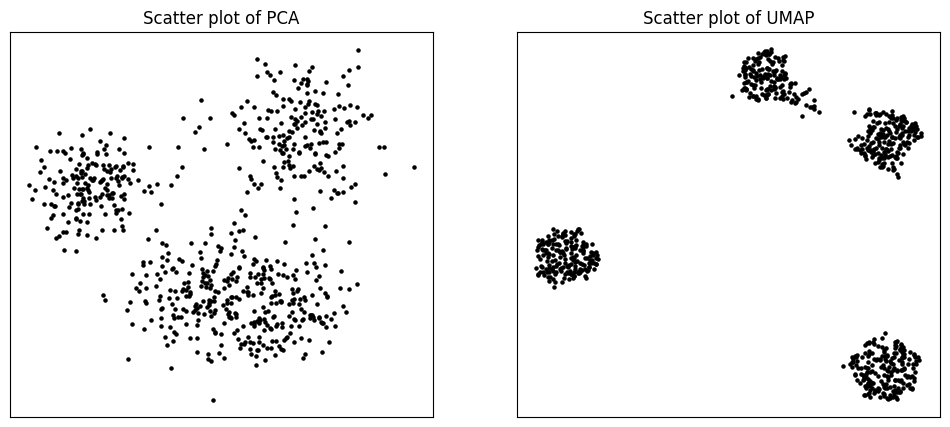

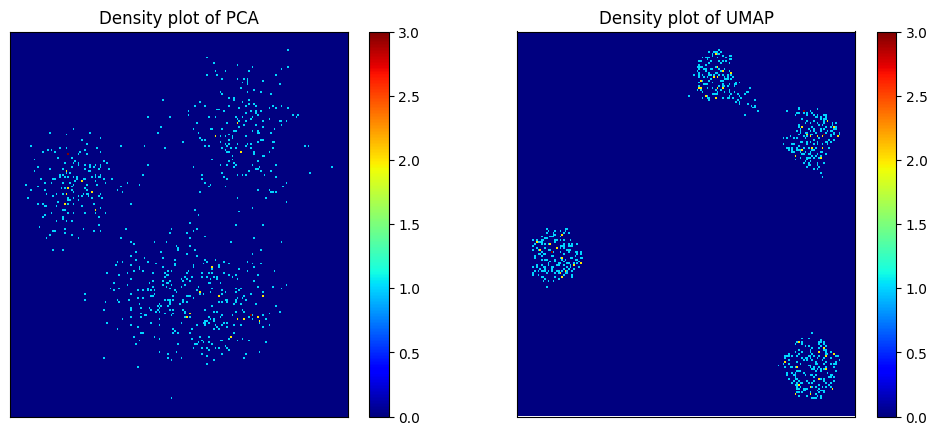

Start clustering.
2 clusters, Distortion: 12085.543945
3 clusters, Distortion: 1930.909424
4 clusters, Distortion: 389.353424
5 clusters, Distortion: 356.668427
6 clusters, Distortion: 329.341095
7 clusters, Distortion: 297.818390
8 clusters, Distortion: 281.882019
9 clusters, Distortion: 258.815735
10 clusters, Distortion: 232.443832
11 clusters, Distortion: 229.722992
12 clusters, Distortion: 206.081116
13 clusters, Distortion: 197.731018
14 clusters, Distortion: 179.910583
15 clusters, Distortion: 165.983673
Finish clustering, PCA, UMAP, distortion, silhouette score of K-means clustering will be shown below.


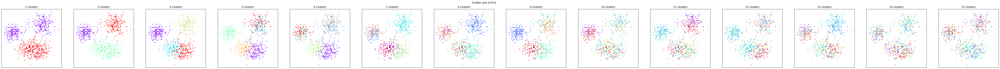

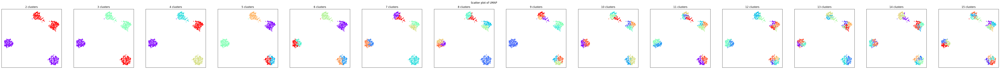

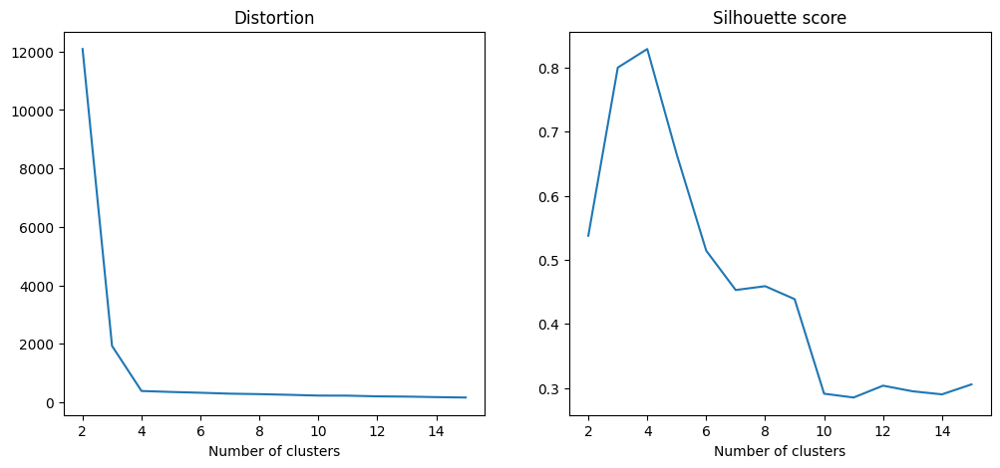

PCA and UMAP of individual clusters will be shown below.


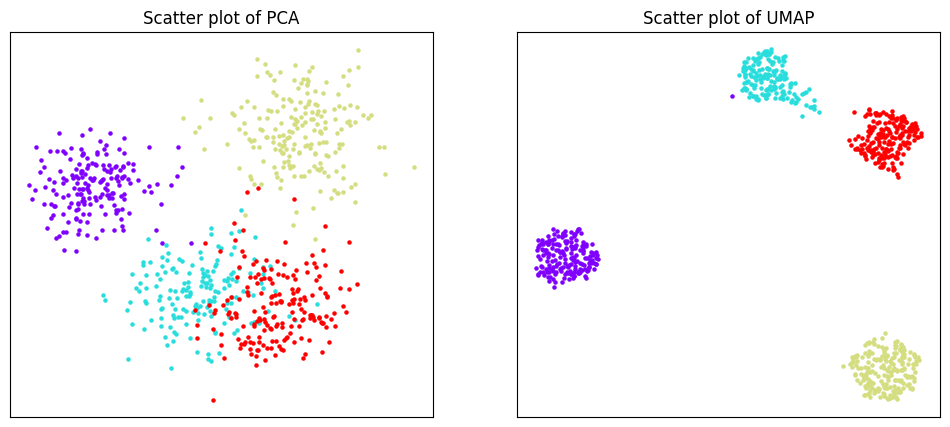

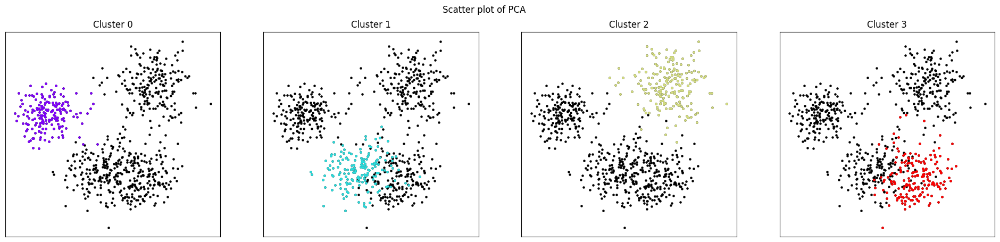

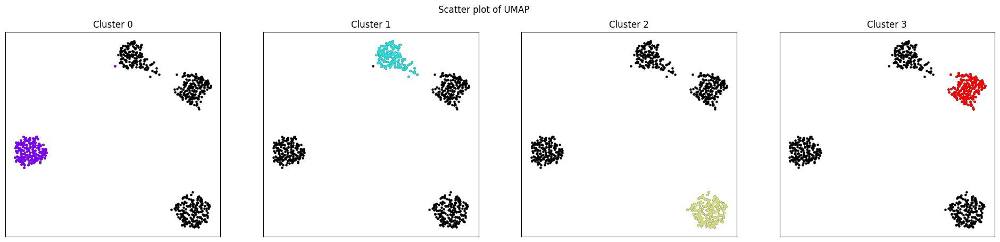

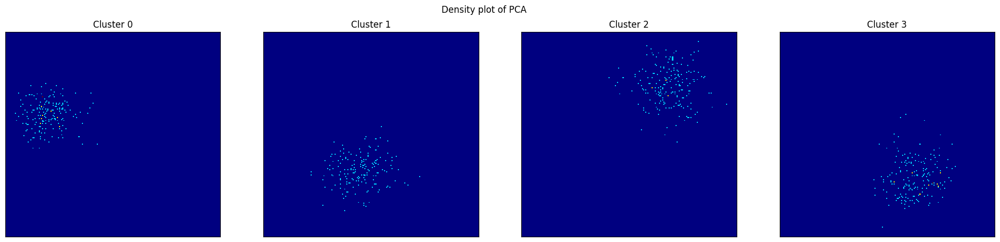

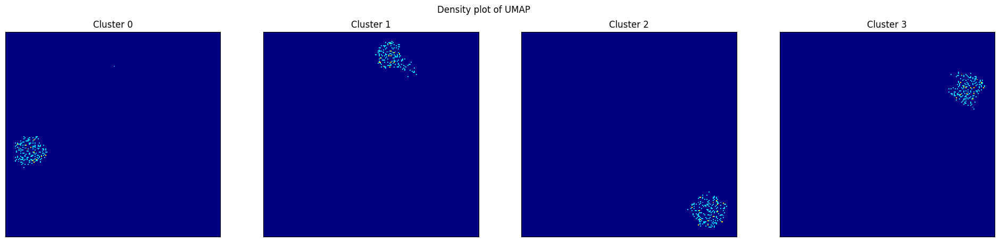

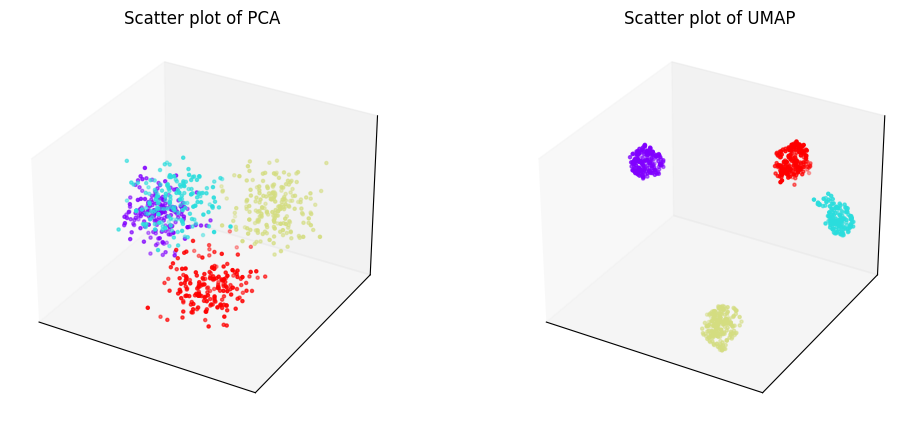

Phylogenetic tree in latent space will be shown below.


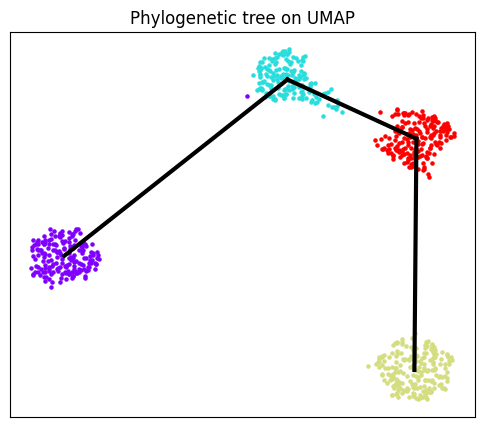

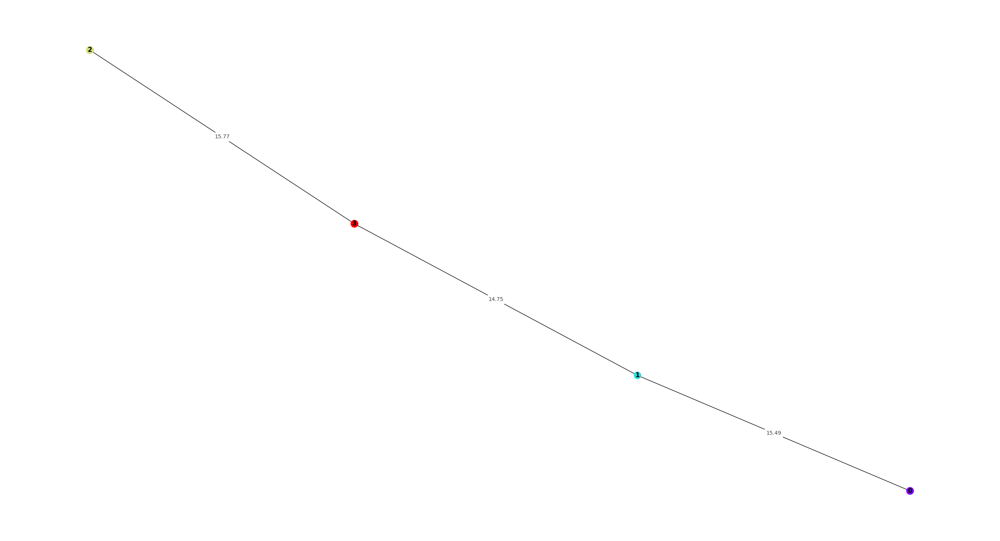

/tmp/ipykernel_1810892/2299804736.py:261: RuntimeWarning: divide by zero encountered in divide
  f_stat = np.clip(1 / ratio_logit_var, 1.001, 20)


SNP-allelic ratios of 734 cells and 50 SNPs will be shown below.


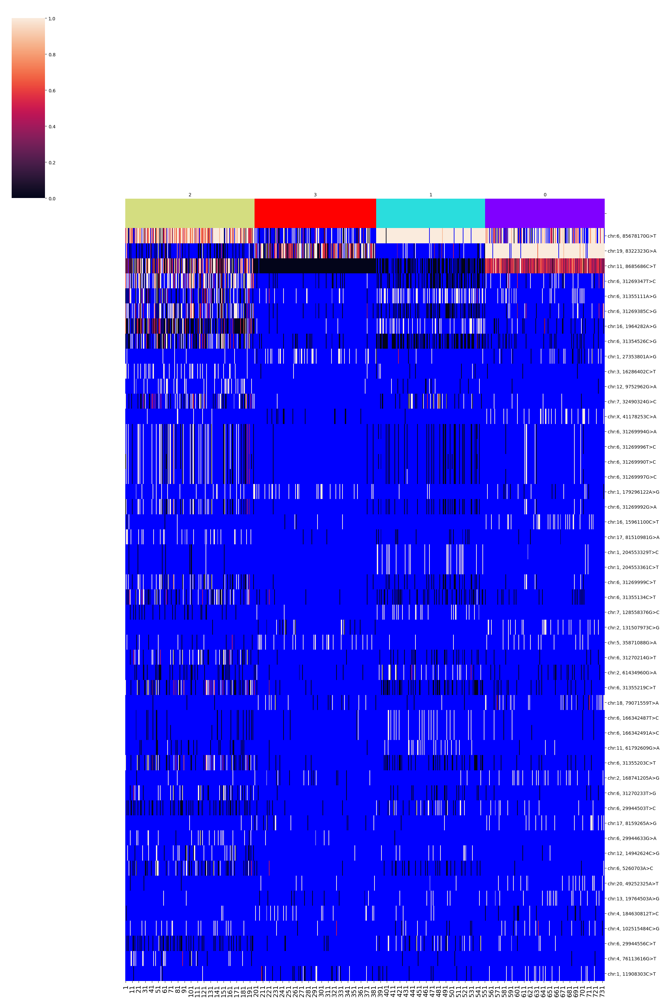

SNPs sorted by lowest p-value will be shown below


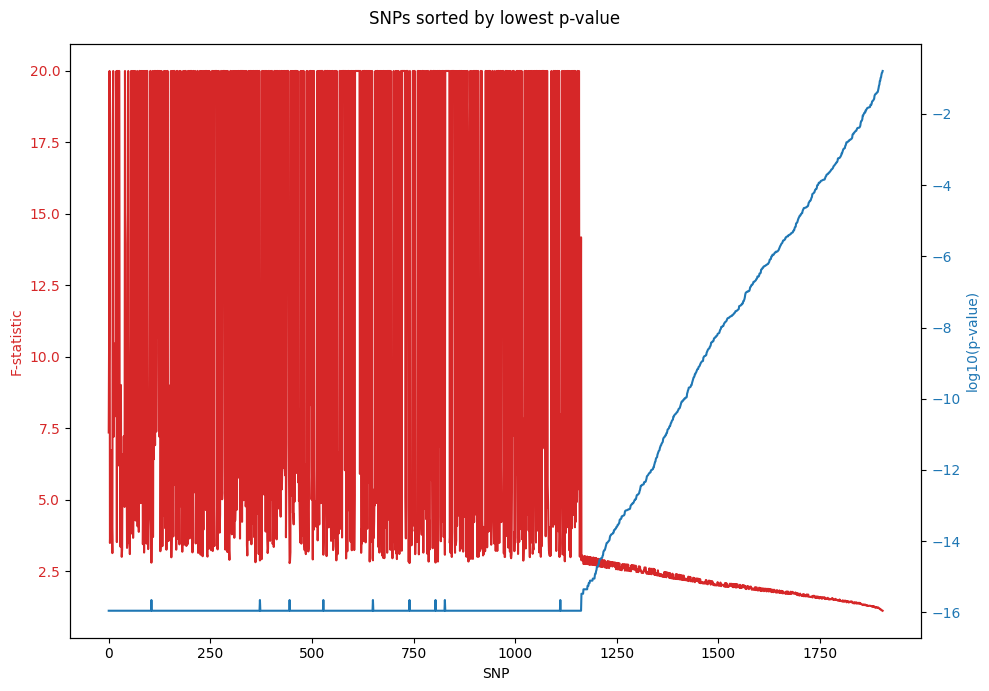

In [40]:
del D_50

%run /home/kevin/storage_kevin/past_figures/figures_final5/notebook/SNPmanifold.ipynb

D_100 = SNP_VAE(AD = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor4/cellSNP.tag.AD.mtx", DP = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor4/cellSNP.tag.DP.mtx", VCF = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor4/cells.cellSNP.vcf.gz")
D_100.filtering()
D_100.training(z_dim = np.ceil(1905 / 100).astype(int))
D_100.clustering(algorithm = "kmeans_umap3d")
D_100.phylogeny(cluster_no = 4)

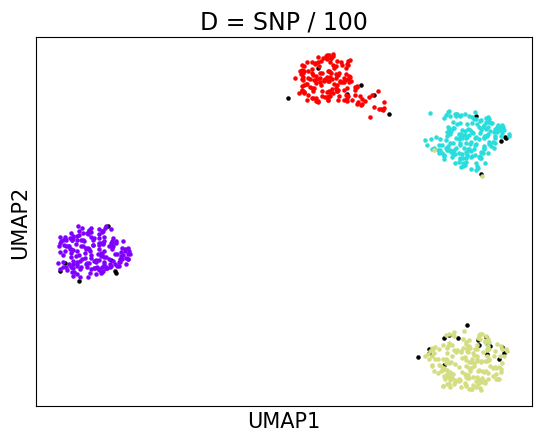

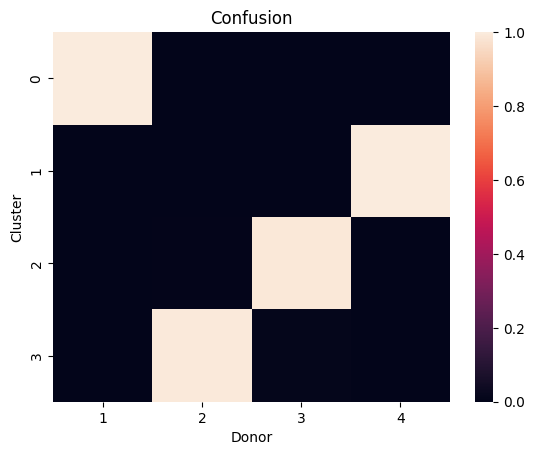

accuracy: 99.58788706739526
silhouette score: 0.8200307177344228


In [41]:
D_100_embedding_2d = D_100.embedding_2d

donor = pd.read_csv('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor4/donor_ids.tsv', sep = '\t').iloc[:, 1].to_numpy()[D_100.cell_filter]
name = ["MantonCB1", "MantonCB2", "MantonCB3", "MantonCB4", "doublet", "unassigned"]

clusters = []

for w in name:
    
    clusters.append(np.where(donor == w)[0])

fig, axs = plt.subplots(1, 1)

axs.scatter(D_100.embedding_2d[clusters[4], 0], D_100.embedding_2d[clusters[4], 1], s = 5, color = "black")

for t in range(4):
    
    axs.scatter(D_100.embedding_2d[clusters[t], 0], D_100.embedding_2d[clusters[t], 1], s = 5, color = D_100.colors[t])
    
axs.set_xticks([])
axs.set_yticks([])
axs.set_xlabel("UMAP1", fontsize = 15)
axs.set_ylabel("UMAP2", fontsize = 15)
axs.set_title("D = SNP / 100", fontsize = 17)

plt.show()

name = ["MantonCB1", "MantonCB2", "MantonCB3", "MantonCB4", "doublet", "unassigned"]
reference = np.empty(D_100.cell_total)

for w in range(6):
    
    reference[np.where(donor == name[w])[0]] = w
    
reference = reference.astype(int)
    
matrix = np.zeros((4, 4))
ref_sum = np.zeros(4)

for q in range(D_100.cell_total):
    
    if reference[q] <= 3:

        matrix[reference[q], D_100.assigned_label[q]] += 1
        ref_sum[reference[q]] += 1

prop = matrix / np.outer(ref_sum, np.ones(4))

fig, ax = plt.subplots(1, 1)
ax = sns.heatmap(prop.T[[0, 1, 2, 3], :], xticklabels = [1, 2, 3, 4], yticklabels = [0, 1, 2, 3])
ax.set_ylabel("Cluster")
ax.set_xlabel("Donor")
ax.set_title("Confusion")
plt.show()

print(f'accuracy: {np.mean(np.max(prop, 1)) * 100}')
print(f'silhouette score: {silhouette_score(D_100.pair_embedding_3d[reference <= 3, :][:, reference <= 3], reference[reference <= 3], metric = "precomputed")}')

Start loading raw data.
Finish loading raw data.
Start filtering low-quality cells and SNPs.


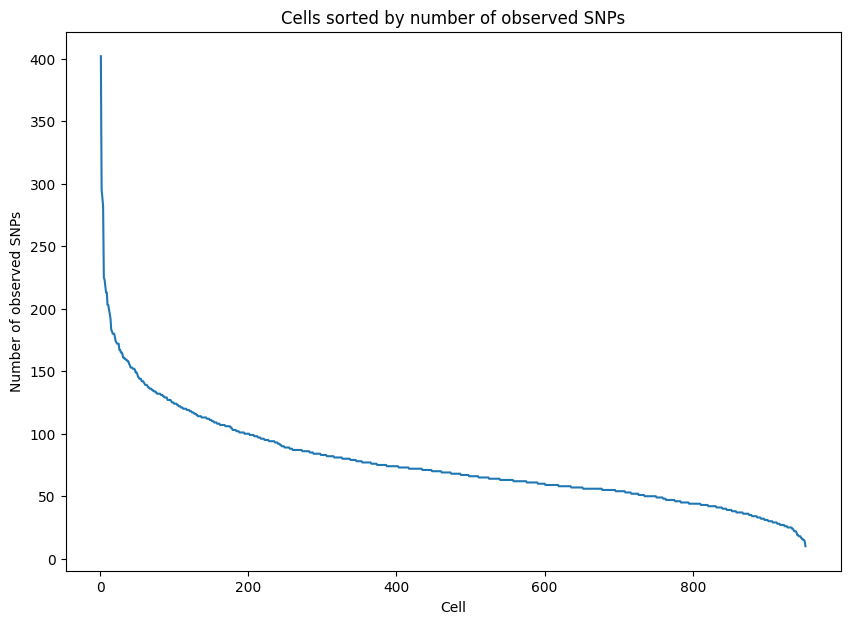

Please determine y-axis threshold in the plot to filter low-quality cells with low number of observed SNPs.   50


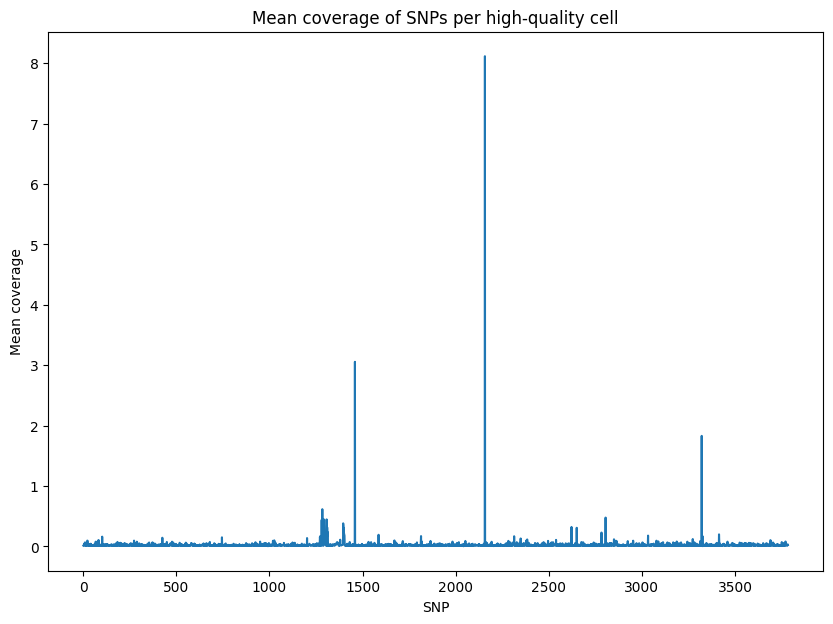

Please determine y-axis threshold in the plot to filter low-quality SNPs with low coverage.   0


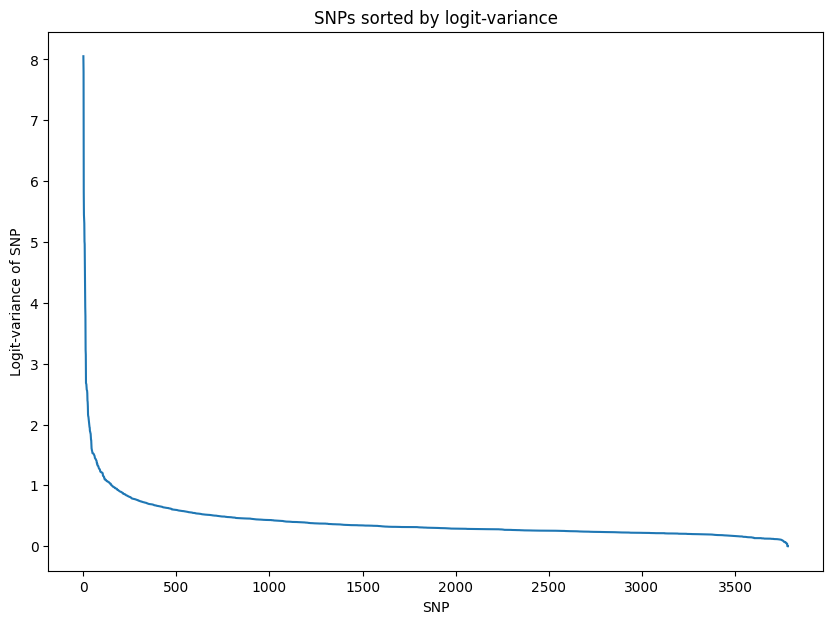

Please determine y-axis threshold in the plot to filter low-quality SNPs with low logit-variance.   0.3
Finish filtering low-quality data, 734 cells and 1905 SNPs will be used for downstream analysis.
Start training VAE.
Epoch[10/2000], Cost: 0.757026
Epoch[20/2000], Cost: 0.620707
Epoch[30/2000], Cost: 0.499978
Epoch[40/2000], Cost: 0.407071
Epoch[50/2000], Cost: 0.336207
Epoch[60/2000], Cost: 0.282325
Epoch[70/2000], Cost: 0.242366
Epoch[80/2000], Cost: 0.212782
Epoch[90/2000], Cost: 0.188757
Epoch[100/2000], Cost: 0.170668
Epoch[200/2000], Cost: 0.107912
Epoch[300/2000], Cost: 0.096451
Epoch[400/2000], Cost: 0.092918
Epoch[500/2000], Cost: 0.091132
Epoch[600/2000], Cost: 0.090202
Epoch[700/2000], Cost: 0.089593
Epoch[800/2000], Cost: 0.089081
Epoch[900/2000], Cost: 0.088815
Epoch[1000/2000], Cost: 0.088615
Epoch[1100/2000], Cost: 0.088351
Epoch[1200/2000], Cost: 0.088211
Epoch[1300/2000], Cost: 0.088058
Epoch[1400/2000], Cost: 0.087971
Epoch[1500/2000], Cost: 0.087963
Epoch[1600/200

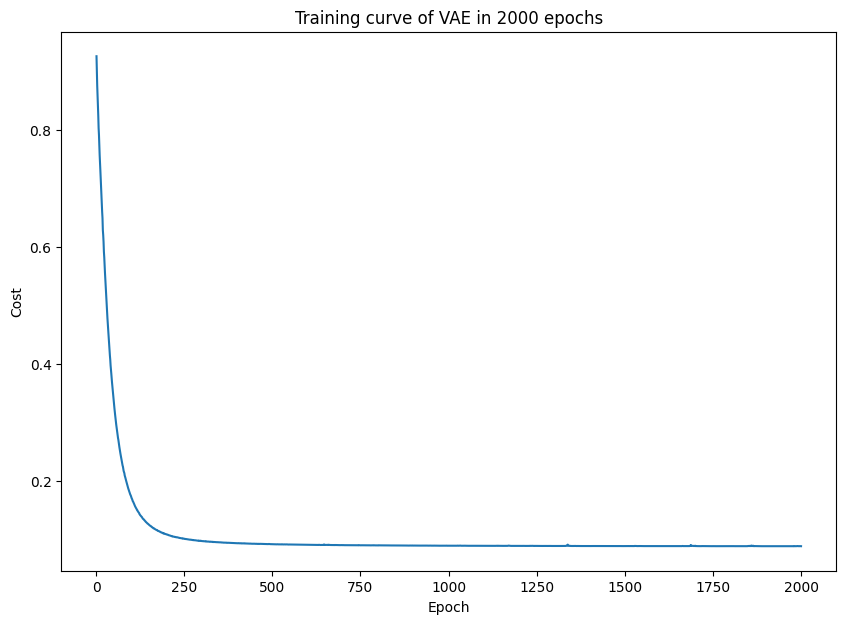

Start learning PCA and UMAP of latent space in VAE.
Finish learning, PCA and UMAP of latent space will be shown below.


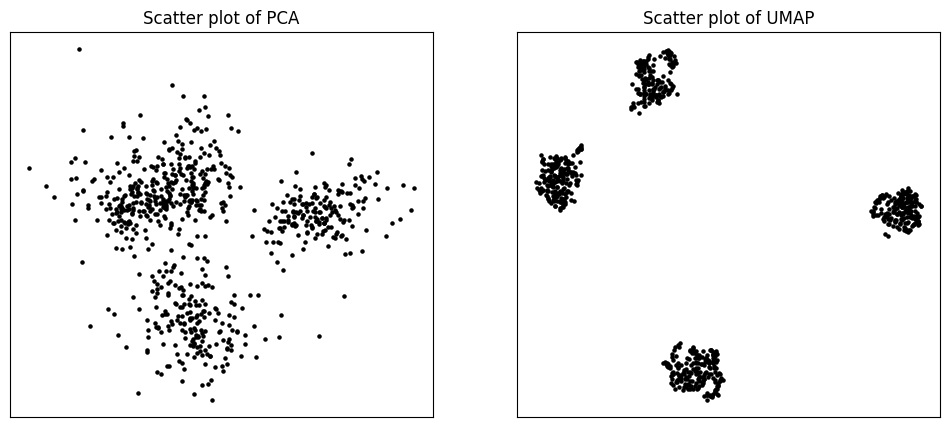

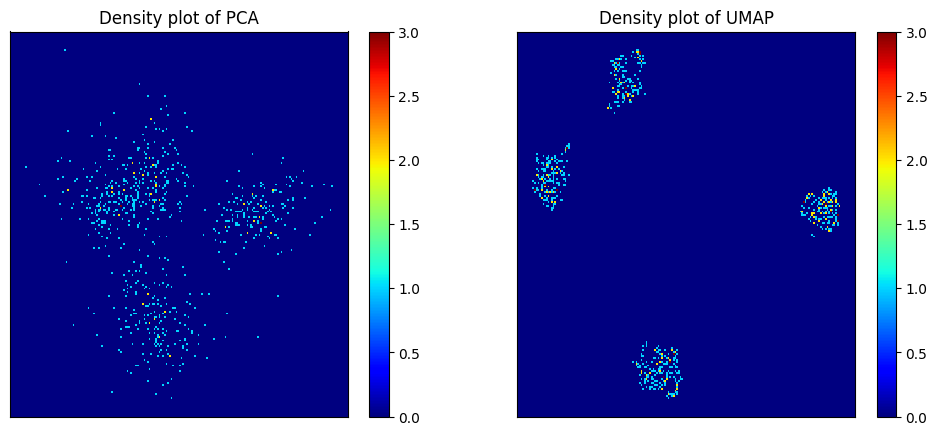

Start clustering.
2 clusters, Distortion: 6625.458984
3 clusters, Distortion: 2021.634399
4 clusters, Distortion: 383.204681
5 clusters, Distortion: 350.823456
6 clusters, Distortion: 314.821320
7 clusters, Distortion: 262.592285
8 clusters, Distortion: 238.385178
9 clusters, Distortion: 220.493118
10 clusters, Distortion: 194.788727
11 clusters, Distortion: 188.134232
12 clusters, Distortion: 172.830231
13 clusters, Distortion: 153.485992
14 clusters, Distortion: 147.628525
15 clusters, Distortion: 142.253159
Finish clustering, PCA, UMAP, distortion, silhouette score of K-means clustering will be shown below.


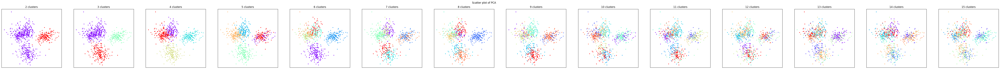

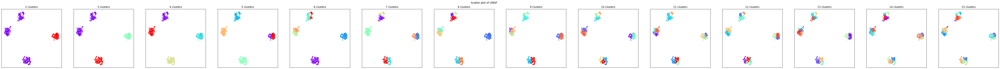

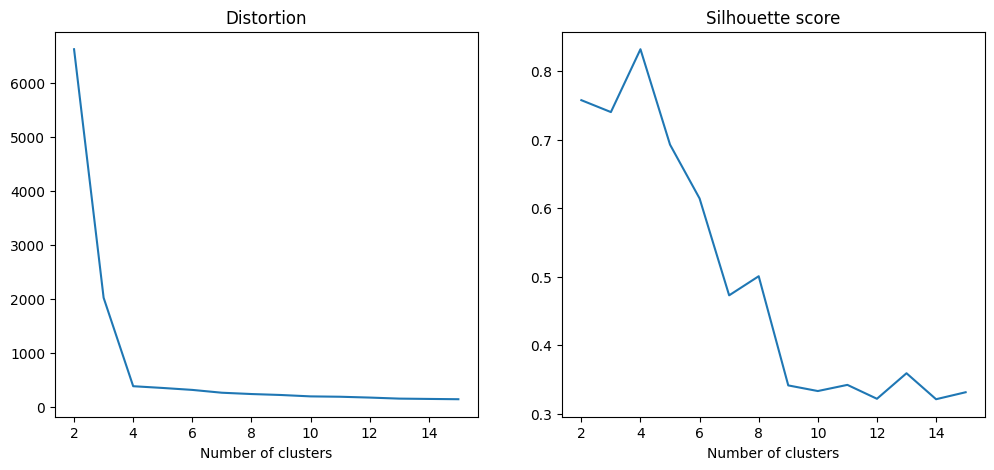

PCA and UMAP of individual clusters will be shown below.


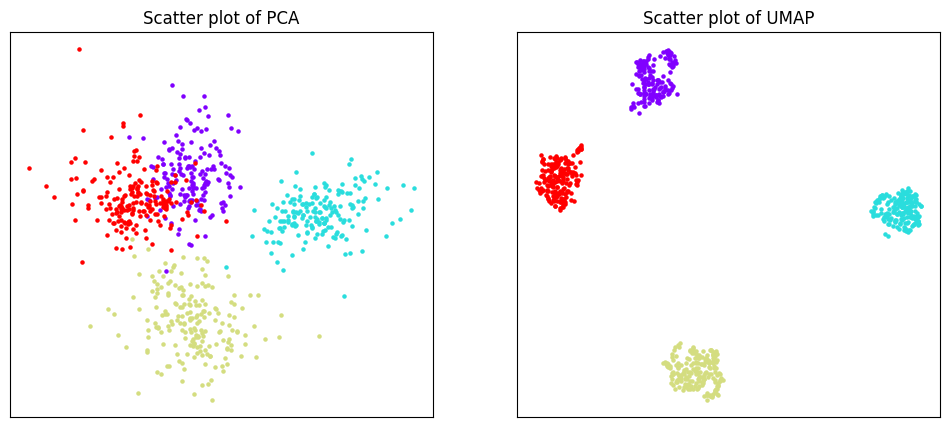

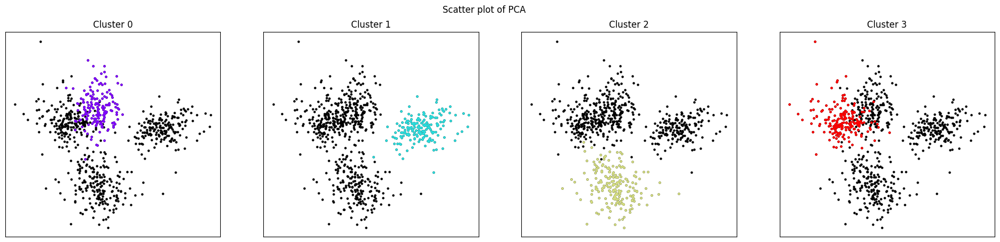

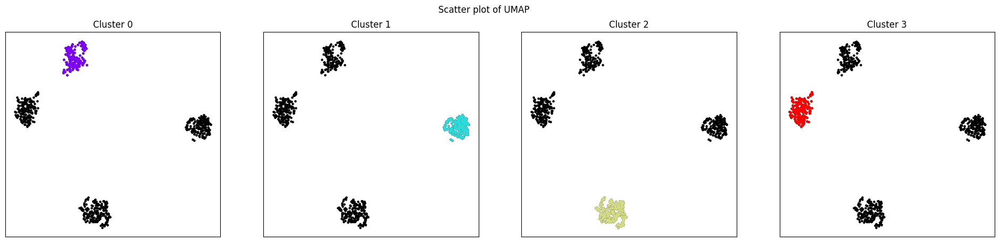

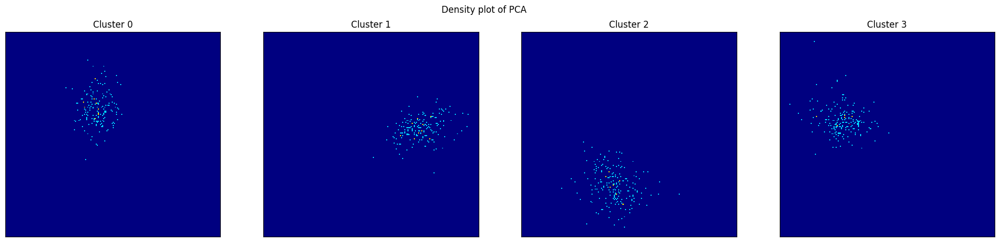

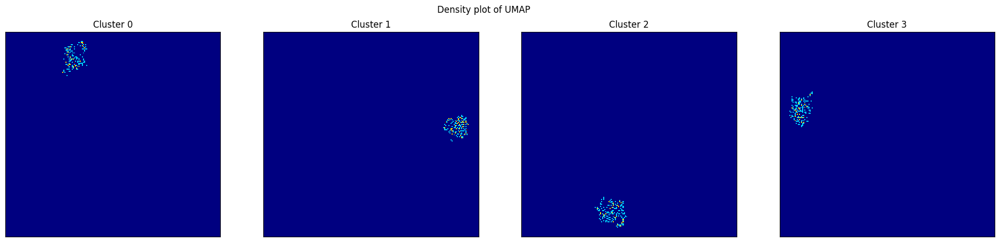

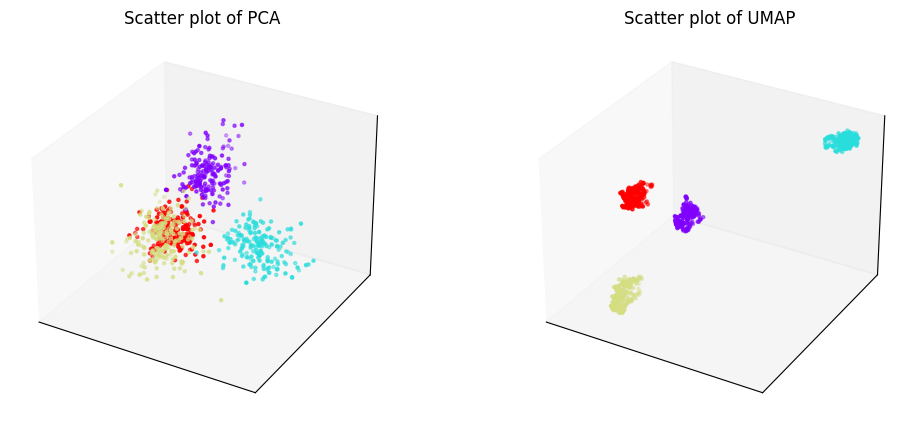

Phylogenetic tree in latent space will be shown below.


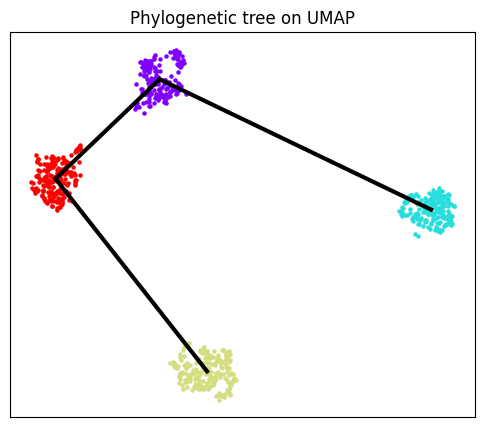

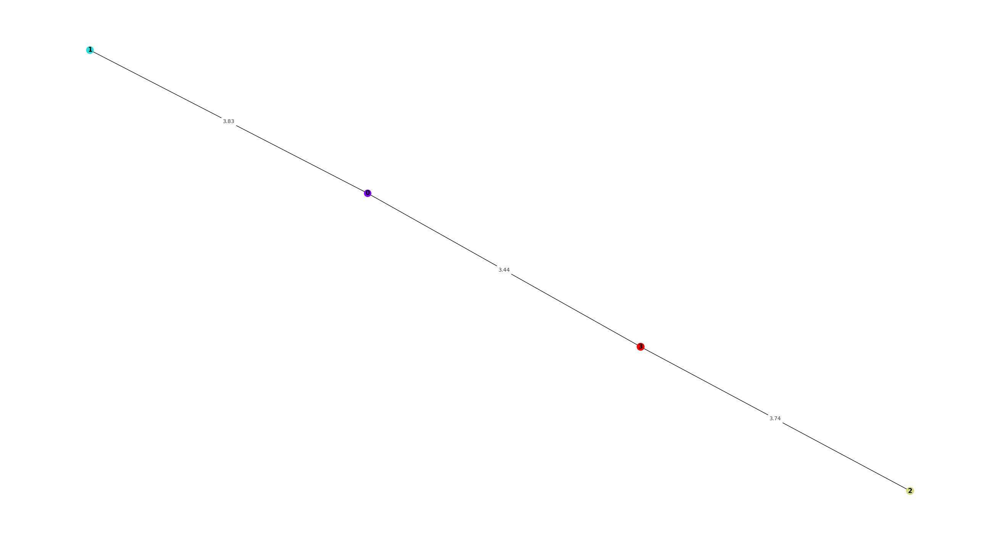

/tmp/ipykernel_1810892/2299804736.py:261: RuntimeWarning: divide by zero encountered in divide
  f_stat = np.clip(1 / ratio_logit_var, 1.001, 20)


SNP-allelic ratios of 734 cells and 50 SNPs will be shown below.


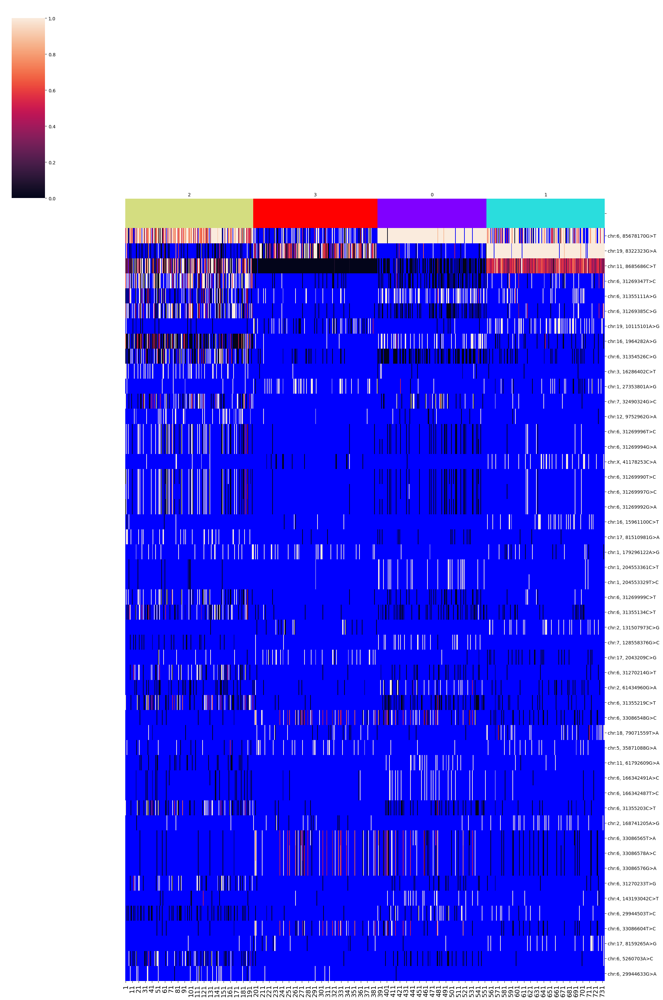

SNPs sorted by lowest p-value will be shown below


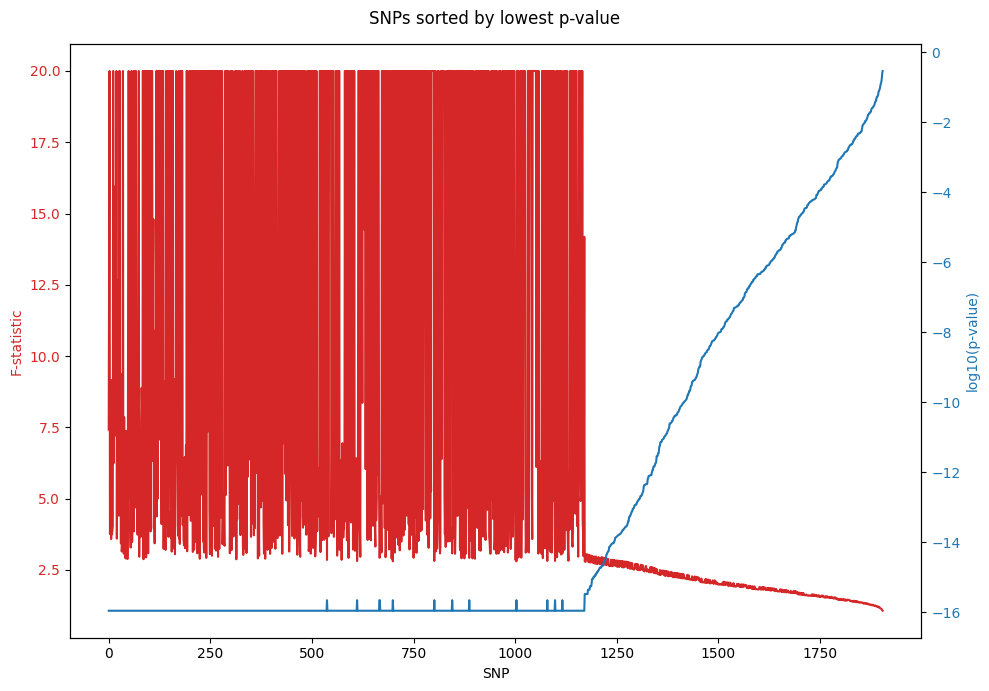

In [43]:
del D_100

%run /home/kevin/storage_kevin/past_figures/figures_final5/notebook/SNPmanifold.ipynb

unnormalized = SNP_VAE(AD = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor4/cellSNP.tag.AD.mtx", DP = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor4/cellSNP.tag.DP.mtx", VCF = "/home/kevin/storage_kevin/past_figures/figures_final5/data/donor4/cells.cellSNP.vcf.gz", SNPread = "unnormalized")
unnormalized.filtering()
unnormalized.training()
unnormalized.clustering(algorithm = "kmeans_umap3d")
unnormalized.phylogeny(cluster_no = 4)

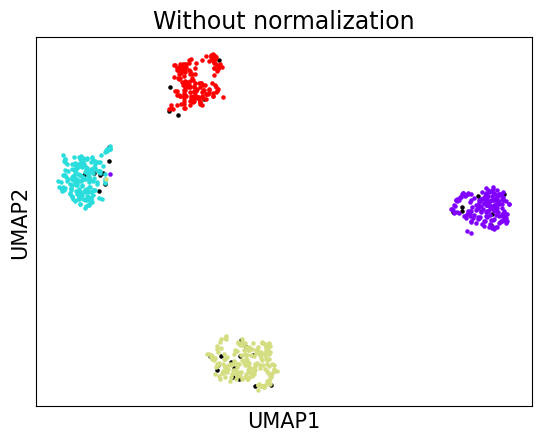

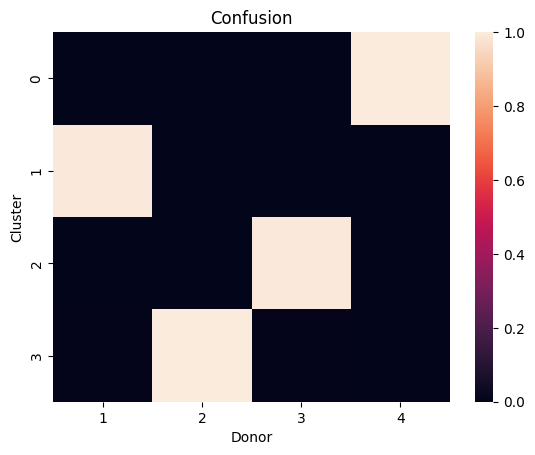

accuracy: 99.72053083528493
silhouette score: 0.8282288318441816


In [44]:
unnormalized_embedding_2d = unnormalized.embedding_2d

donor = pd.read_csv('/home/kevin/storage_kevin/past_figures/figures_final5/data/donor4/donor_ids.tsv', sep = '\t').iloc[:, 1].to_numpy()[unnormalized.cell_filter]
name = ["MantonCB1", "MantonCB2", "MantonCB3", "MantonCB4", "doublet", "unassigned"]

clusters = []

for w in name:
    
    clusters.append(np.where(donor == w)[0])

fig, axs = plt.subplots(1, 1)

axs.scatter(unnormalized.embedding_2d[clusters[4], 0], unnormalized.embedding_2d[clusters[4], 1], s = 5, color = "black")

for t in range(4):
    
    axs.scatter(unnormalized.embedding_2d[clusters[t], 0], unnormalized.embedding_2d[clusters[t], 1], s = 5, color = unnormalized.colors[t])
    
axs.set_xticks([])
axs.set_yticks([])
axs.set_xlabel("UMAP1", fontsize = 15)
axs.set_ylabel("UMAP2", fontsize = 15)
axs.set_title("Without normalization", fontsize = 17)

plt.show()

name = ["MantonCB1", "MantonCB2", "MantonCB3", "MantonCB4", "doublet", "unassigned"]
reference = np.empty(unnormalized.cell_total)

for w in range(6):
    
    reference[np.where(donor == name[w])[0]] = w
    
reference = reference.astype(int)
    
matrix = np.zeros((4, 4))
ref_sum = np.zeros(4)

for q in range(unnormalized.cell_total):
    
    if reference[q] <= 3:

        matrix[reference[q], unnormalized.assigned_label[q]] += 1
        ref_sum[reference[q]] += 1

prop = matrix / np.outer(ref_sum, np.ones(4))

fig, ax = plt.subplots(1, 1)
ax = sns.heatmap(prop.T[[0, 1, 2, 3], :], xticklabels = [1, 2, 3, 4], yticklabels = [0, 1, 2, 3])
ax.set_ylabel("Cluster")
ax.set_xlabel("Donor")
ax.set_title("Confusion")
plt.show()

print(f'accuracy: {np.mean(np.max(prop, 1)) * 100}')
print(f'silhouette score: {silhouette_score(unnormalized.pair_embedding_3d[reference <= 3, :][:, reference <= 3], reference[reference <= 3], metric = "precomputed")}')

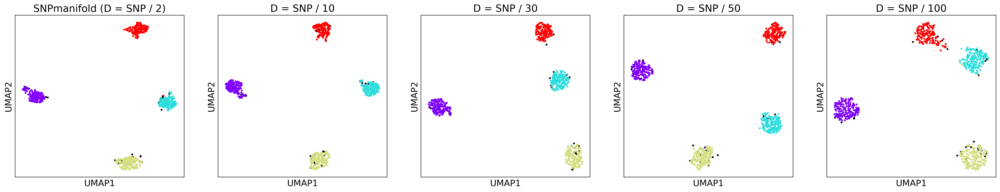

In [45]:
fig, axs = plt.subplots(1, 5, dpi = 300)
fig.set_size_inches(30, 5)

axs[0].scatter(normalized_layer1_embedding_2d[clusters[4], 0], normalized_layer1_embedding_2d[clusters[4], 1], s = 5, color = "black")
    
for t in range(4):
    
    axs[0].scatter(normalized_layer1_embedding_2d[clusters[t], 0], normalized_layer1_embedding_2d[clusters[t], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 4))[t])
    
axs[0].set_xticks([])
axs[0].set_yticks([])
axs[0].set_xlabel("UMAP1", fontsize = 15)
axs[0].set_ylabel("UMAP2", fontsize = 15)
axs[0].set_title("SNPmanifold (D = SNP / 2)", fontsize = 17)

axs[1].scatter(D_10_embedding_2d[clusters[4], 0], D_10_embedding_2d[clusters[4], 1], s = 5, color = "black")

for t in range(4):
    
    axs[1].scatter(D_10_embedding_2d[clusters[t], 0], D_10_embedding_2d[clusters[t], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 4))[t])
    
axs[1].set_xticks([])
axs[1].set_yticks([])
axs[1].set_xlabel("UMAP1", fontsize = 15)
axs[1].set_ylabel("UMAP2", fontsize = 15)
axs[1].set_title("D = SNP / 10", fontsize = 17)

axs[2].scatter(D_30_embedding_2d[clusters[4], 0], D_30_embedding_2d[clusters[4], 1], s = 5, color = "black")

for t in range(4):
    
    axs[2].scatter(D_30_embedding_2d[clusters[t], 0], D_30_embedding_2d[clusters[t], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 4))[t])
    
axs[2].set_xticks([])
axs[2].set_yticks([])
axs[2].set_xlabel("UMAP1", fontsize = 15)
axs[2].set_ylabel("UMAP2", fontsize = 15)
axs[2].set_title("D = SNP / 30", fontsize = 17)

axs[3].scatter(D_50_embedding_2d[clusters[4], 0], D_50_embedding_2d[clusters[4], 1], s = 5, color = "black")

for t in range(4):
    
    axs[3].scatter(D_50_embedding_2d[clusters[t], 0], D_50_embedding_2d[clusters[t], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 4))[t])
    
axs[3].set_xticks([])
axs[3].set_yticks([])
axs[3].set_xlabel("UMAP1", fontsize = 15)
axs[3].set_ylabel("UMAP2", fontsize = 15)
axs[3].set_title("D = SNP / 50", fontsize = 17)

axs[4].scatter(D_100_embedding_2d[clusters[4], 0], D_100_embedding_2d[clusters[4], 1], s = 5, color = "black")

for t in range(4):
    
    axs[4].scatter(D_100_embedding_2d[clusters[t], 0], D_100_embedding_2d[clusters[t], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 4))[t])
    
axs[4].set_xticks([])
axs[4].set_yticks([])
axs[4].set_xlabel("UMAP1", fontsize = 15)
axs[4].set_ylabel("UMAP2", fontsize = 15)
axs[4].set_title("D = SNP / 100", fontsize = 17)
    
plt.show()

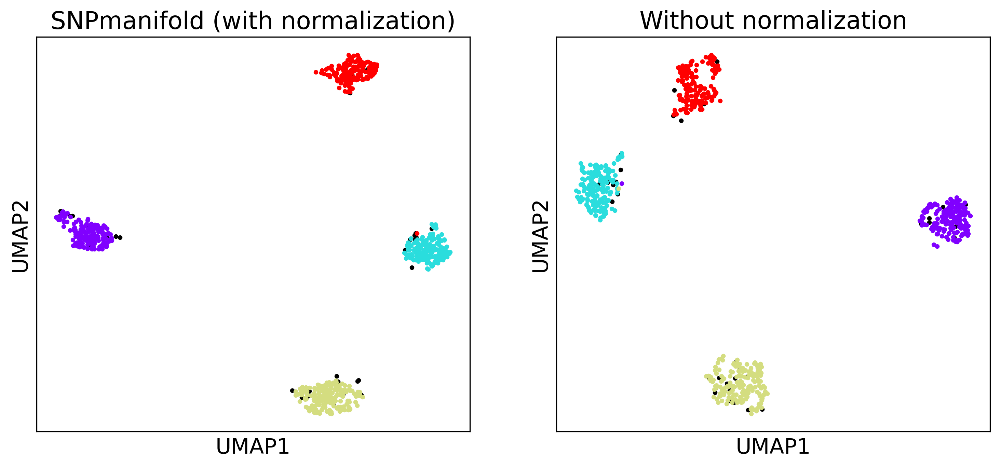

In [48]:
fig, axs = plt.subplots(1, 2, dpi = 300)
fig.set_size_inches(12, 5)

axs[0].scatter(normalized_layer1_embedding_2d[clusters[4], 0], normalized_layer1_embedding_2d[clusters[4], 1], s = 5, color = "black")
    
for t in range(4):
    
    axs[0].scatter(normalized_layer1_embedding_2d[clusters[t], 0], normalized_layer1_embedding_2d[clusters[t], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 4))[t])
    
axs[0].set_xticks([])
axs[0].set_yticks([])
axs[0].set_xlabel("UMAP1", fontsize = 15)
axs[0].set_ylabel("UMAP2", fontsize = 15)
axs[0].set_title("SNPmanifold (with normalization)", fontsize = 17)

axs[1].scatter(unnormalized_embedding_2d[clusters[4], 0], unnormalized_embedding_2d[clusters[4], 1], s = 5, color = "black")

for t in range(4):
    
    axs[1].scatter(unnormalized_embedding_2d[clusters[t], 0], unnormalized_embedding_2d[clusters[t], 1], s = 5, color = cm.rainbow(np.linspace(0, 1, 4))[t])
    
axs[1].set_xticks([])
axs[1].set_yticks([])
axs[1].set_xlabel("UMAP1", fontsize = 15)
axs[1].set_ylabel("UMAP2", fontsize = 15)
axs[1].set_title("Without normalization", fontsize = 17)
    
plt.show()

/ssd/users/kevin/conda/test_SNPmanifold/lib/python3.8/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


Start loading raw data.
Finish loading raw data.
Start filtering low-quality cells and SNPs.


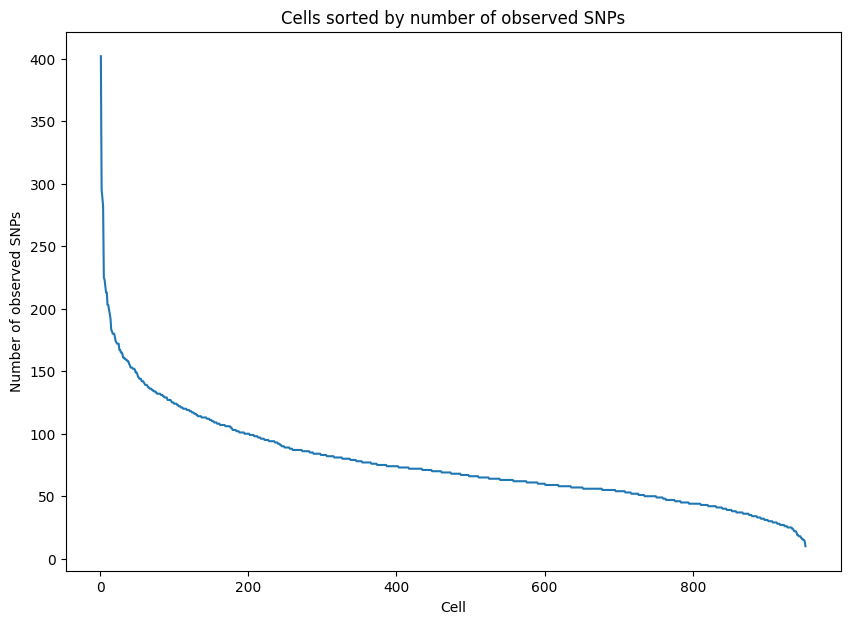

Please determine y-axis threshold in the plot to filter low-quality cells with low number of observed SNPs.   50


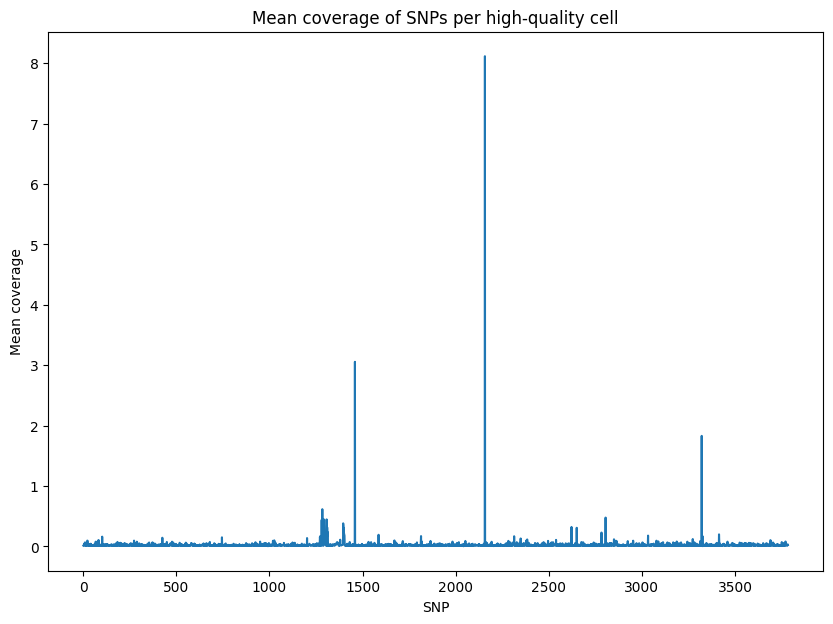

Please determine y-axis threshold in the plot to filter low-quality SNPs with low coverage.   0


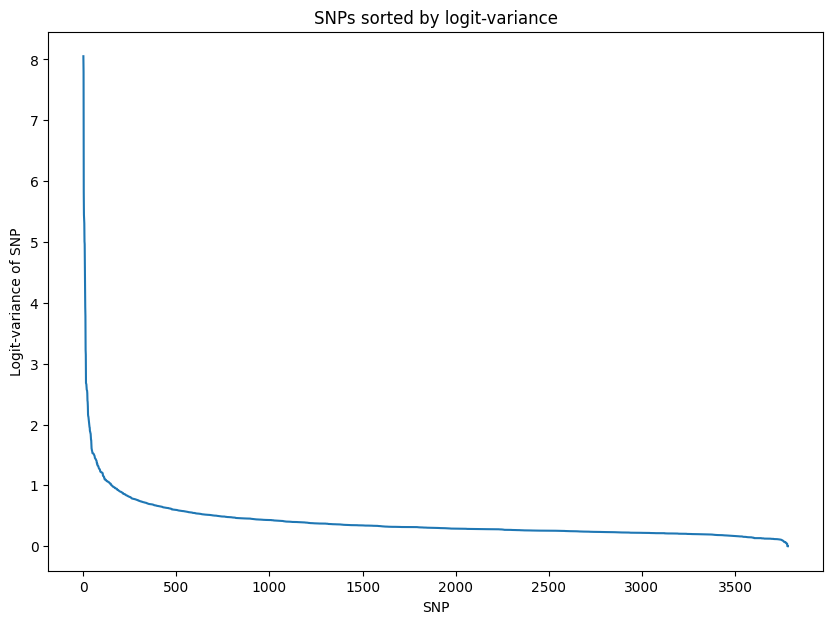

Please determine y-axis threshold in the plot to filter low-quality SNPs with low logit-variance.   0.3
Finish filtering low-quality data, 734 cells and 1905 SNPs will be used for downstream analysis.
Start training VAE.
Epoch[10/2000], Cost: 0.763310
Epoch[20/2000], Cost: 0.629821
Epoch[30/2000], Cost: 0.514369
Epoch[40/2000], Cost: 0.417739
Epoch[50/2000], Cost: 0.343260
Epoch[60/2000], Cost: 0.287112
Epoch[70/2000], Cost: 0.245580
Epoch[80/2000], Cost: 0.214466
Epoch[90/2000], Cost: 0.190098
Epoch[100/2000], Cost: 0.171820
Epoch[200/2000], Cost: 0.107038
Epoch[300/2000], Cost: 0.096102
Epoch[400/2000], Cost: 0.092664
Epoch[500/2000], Cost: 0.091153
Epoch[600/2000], Cost: 0.090063
Epoch[700/2000], Cost: 0.089481
Epoch[800/2000], Cost: 0.089097
Epoch[900/2000], Cost: 0.088739
Epoch[1000/2000], Cost: 0.088527
Epoch[1100/2000], Cost: 0.088306
Epoch[1200/2000], Cost: 0.088154
Epoch[1300/2000], Cost: 0.088052
Epoch[1400/2000], Cost: 0.087973
Epoch[1500/2000], Cost: 0.087890
Epoch[1600/200

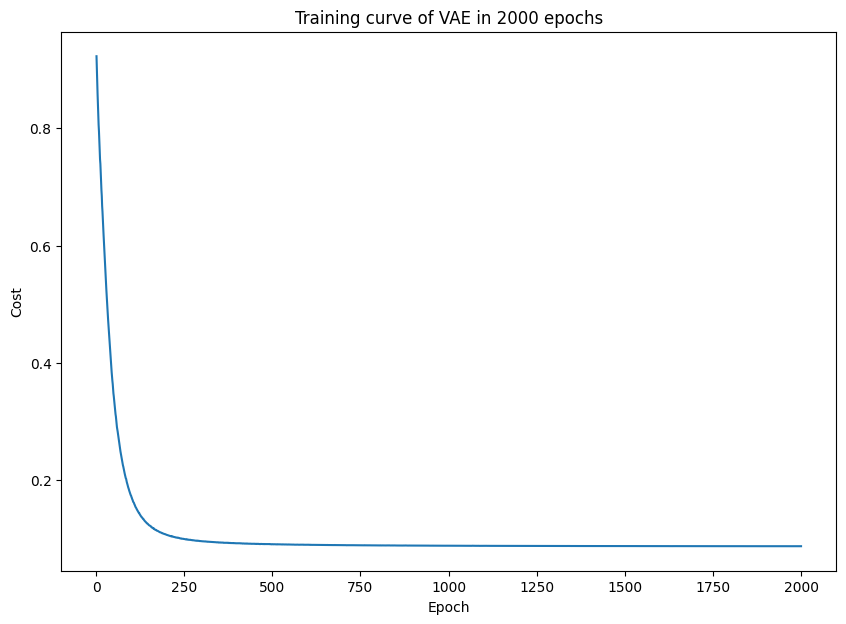

Start learning PCA and UMAP of latent space in VAE.
Finish learning, PCA and UMAP of latent space will be shown below.


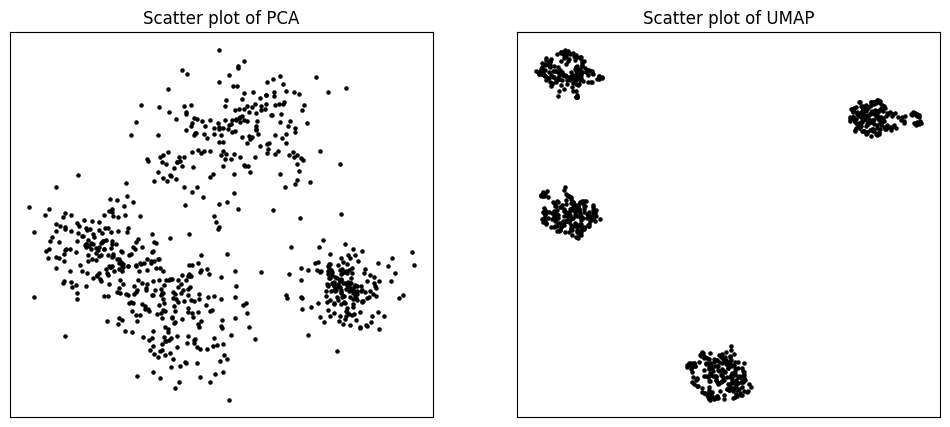

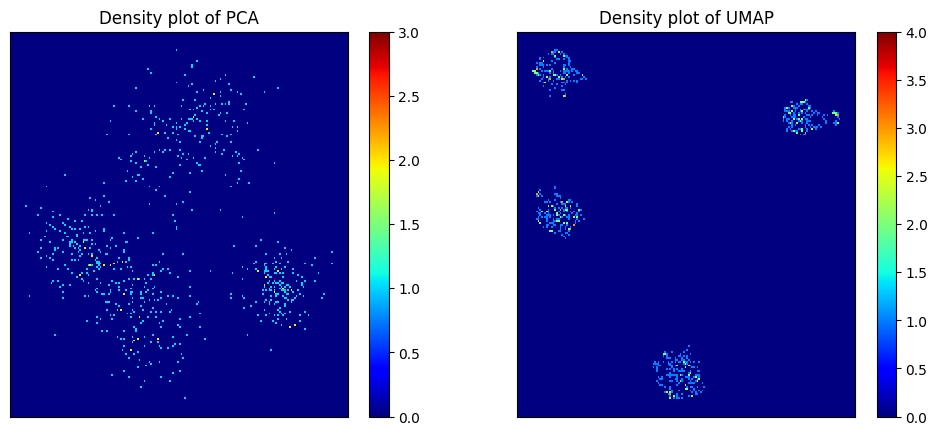

Start clustering.
2 clusters, Distortion: 16518.628906
3 clusters, Distortion: 4441.687012
4 clusters, Distortion: 401.066772
5 clusters, Distortion: 375.444305
6 clusters, Distortion: 334.516510
7 clusters, Distortion: 305.623779
8 clusters, Distortion: 262.395660
9 clusters, Distortion: 240.018051
10 clusters, Distortion: 226.949173
11 clusters, Distortion: 207.114532
12 clusters, Distortion: 192.301376
13 clusters, Distortion: 177.749603
14 clusters, Distortion: 162.169830
15 clusters, Distortion: 151.702560
Finish clustering, PCA, UMAP, distortion, silhouette score of K-means clustering will be shown below.


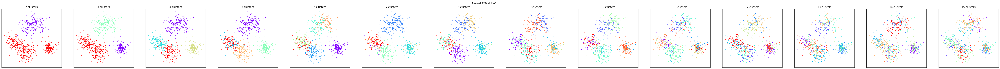

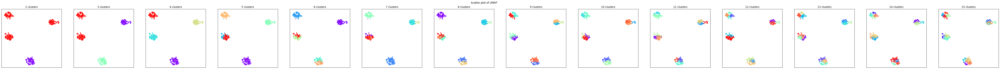

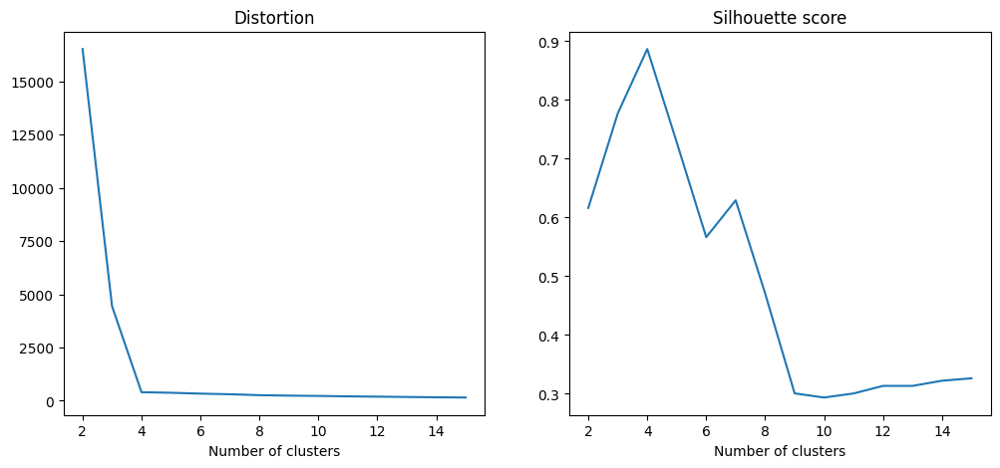

PCA and UMAP of individual clusters will be shown below.


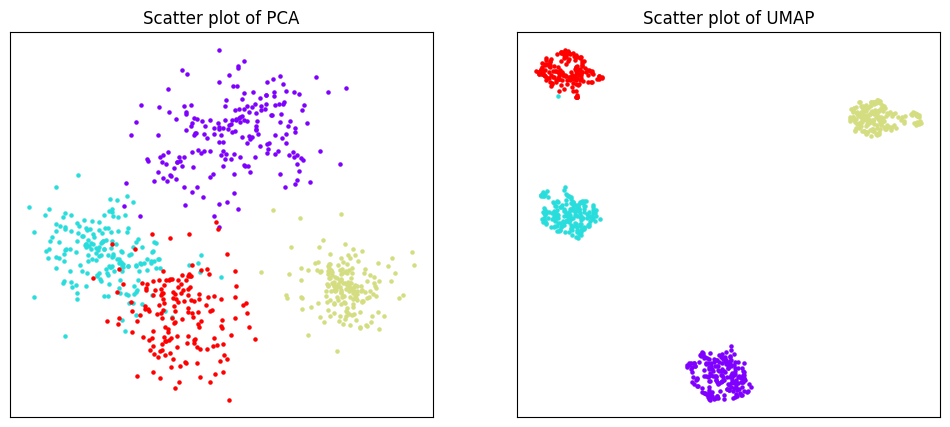

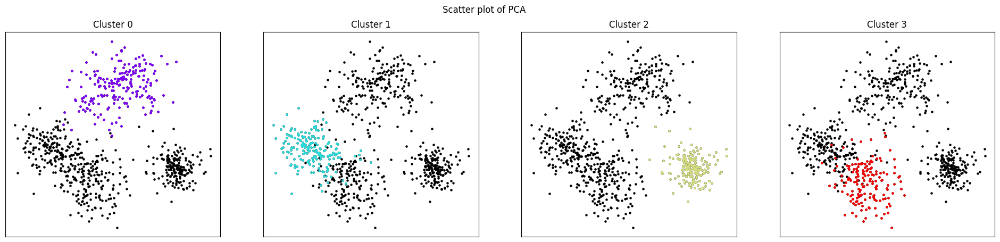

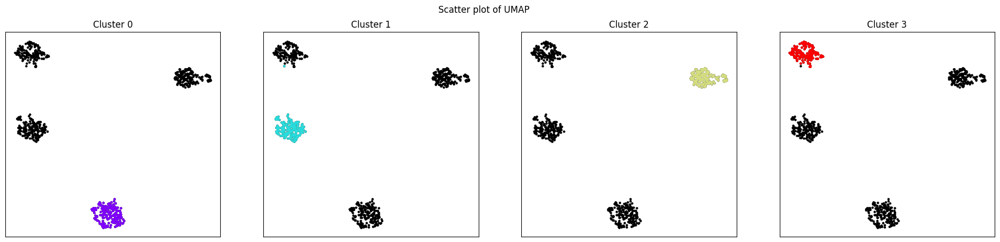

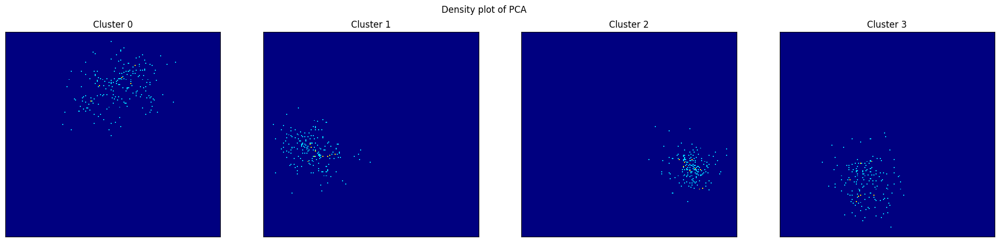

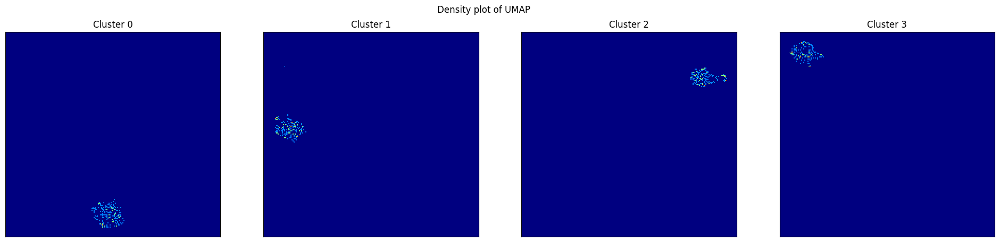

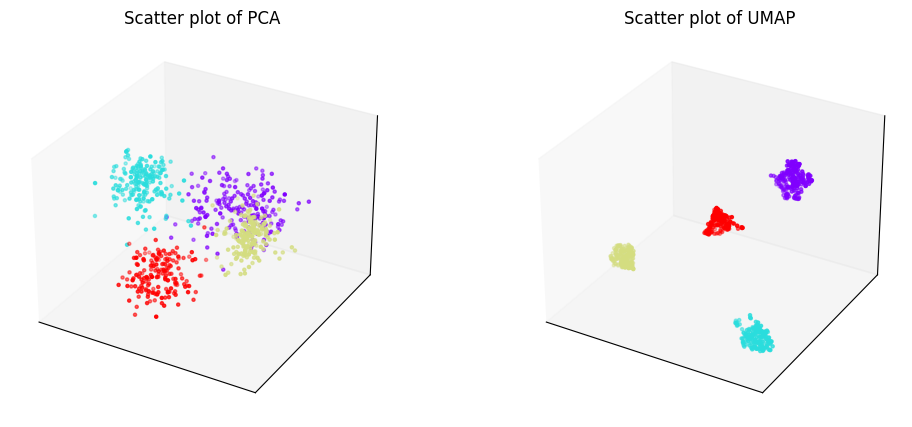

Phylogenetic tree in latent space will be shown below.


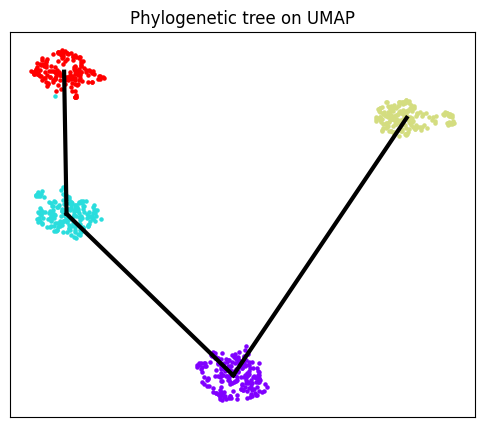

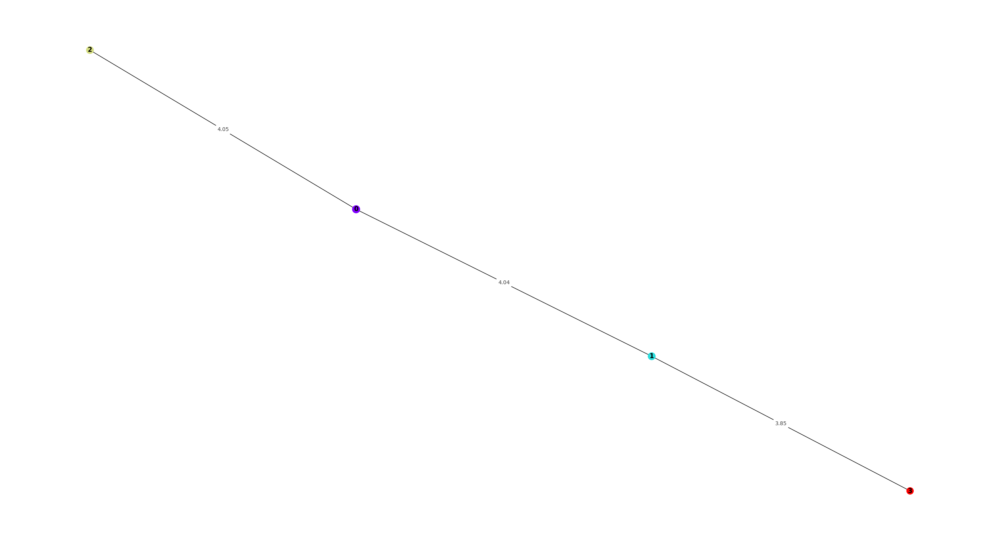

/tmp/ipykernel_942766/2299804736.py:261: RuntimeWarning: divide by zero encountered in true_divide
  f_stat = np.clip(1 / ratio_logit_var, 1.001, 20)


SNP-allelic ratios of 734 cells and 50 SNPs will be shown below.


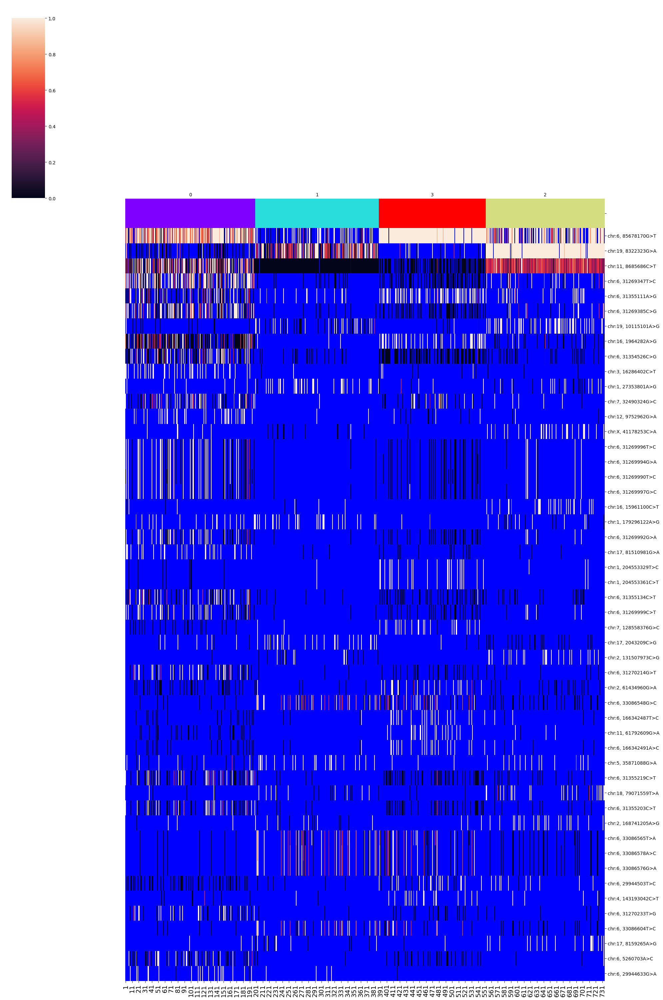

SNPs sorted by lowest p-value will be shown below


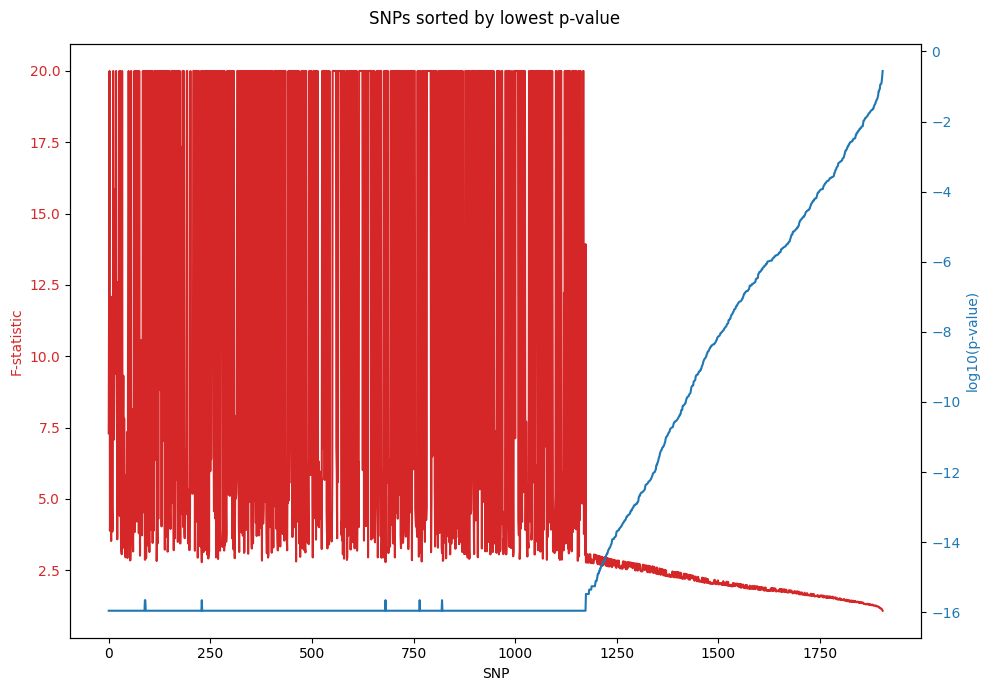

In [1]:
import torch
torch.set_default_device('cuda')
torch.cuda.set_device('cuda:4')

%run /home/kevin/storage_kevin/past_figures/figures_final6/notebook/SNPmanifold.ipynb

normalized_layer1 = SNP_VAE(AD = "/home/kevin/storage_kevin/past_figures/figures_final6/data/donor4/cellSNP.tag.AD.mtx", DP = "/home/kevin/storage_kevin/past_figures/figures_final6/data/donor4/cellSNP.tag.DP.mtx", VCF = "/home/kevin/storage_kevin/past_figures/figures_final6/data/donor4/cells.cellSNP.vcf.gz")
normalized_layer1.filtering()
normalized_layer1.training()
normalized_layer1.clustering(algorithm = "kmeans_umap3d")
normalized_layer1.phylogeny(cluster_no = 4)

In [4]:
np.argmax(normalized_layer1.scores) + 2

4

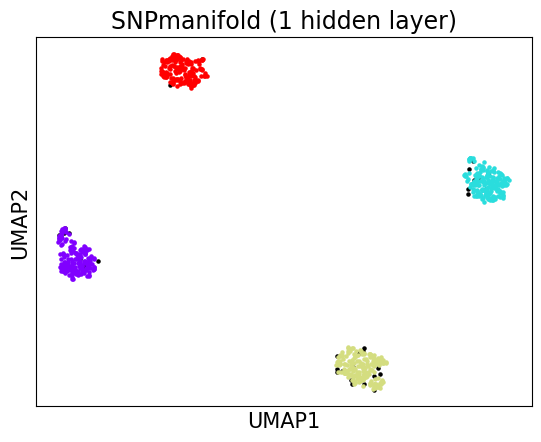

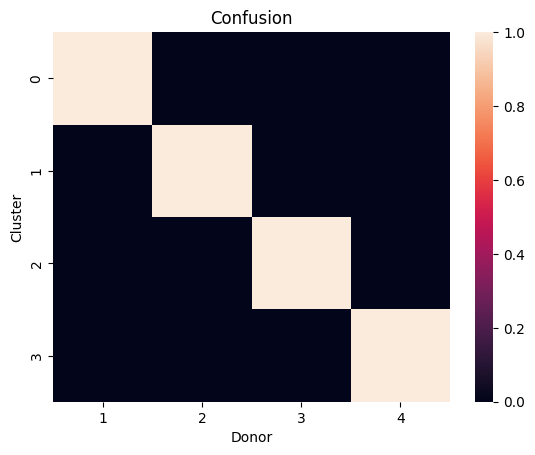

accuracy: 100.0
silhouette score: 0.8979897345723918


In [31]:
normalized_layer1_embedding_2d = normalized_layer1.embedding_2d

donor = pd.read_csv('/home/kevin/storage_kevin/past_figures/figures_final6/data/donor4/donor_ids.tsv', sep = '\t').iloc[:, 1].to_numpy()[normalized_layer1.cell_filter]
name = ["MantonCB1", "MantonCB2", "MantonCB3", "MantonCB4", "doublet", "unassigned"]

clusters = []

for w in name:
    
    clusters.append(np.where(donor == w)[0])

fig, axs = plt.subplots(1, 1)

axs.scatter(normalized_layer1.embedding_2d[clusters[4], 0], normalized_layer1.embedding_2d[clusters[4], 1], s = 5, color = "black")

for t in range(4):
    
    axs.scatter(normalized_layer1.embedding_2d[clusters[t], 0], normalized_layer1.embedding_2d[clusters[t], 1], s = 5, color = normalized_layer1.colors[t])
    
axs.set_xticks([])
axs.set_yticks([])
axs.set_xlabel("UMAP1", fontsize = 15)
axs.set_ylabel("UMAP2", fontsize = 15)
axs.set_title("SNPmanifold (1 hidden layer)", fontsize = 17)

plt.show()

name = ["MantonCB1", "MantonCB2", "MantonCB3", "MantonCB4", "doublet", "unassigned"]
reference = np.empty(normalized_layer1.cell_total)

for w in range(6):
    
    reference[np.where(donor == name[w])[0]] = w
    
reference = reference.astype(int)
    
matrix = np.zeros((4, 4))
ref_sum = np.zeros(4)

for q in range(normalized_layer1.cell_total):
    
    if reference[q] <= 3:

        matrix[reference[q], normalized_layer1.assigned_label[q]] += 1
        ref_sum[reference[q]] += 1

prop = matrix / np.outer(ref_sum, np.ones(4))

fig, ax = plt.subplots(1, 1)
ax = sns.heatmap(prop.T[[0, 1, 2, 3], :], xticklabels = [1, 2, 3, 4], yticklabels = [0, 1, 2, 3])
ax.set_ylabel("Cluster")
ax.set_xlabel("Donor")
ax.set_title("Confusion")
plt.show()

print(f'accuracy: {np.mean(np.max(prop, 1)) * 100}')
print(f'silhouette score: {silhouette_score(normalized_layer1.pair_embedding_3d[reference <= 3, :][:, reference <= 3], reference[reference <= 3], metric = "precomputed")}')

In [16]:
binary_mutation = np.zeros(normalized_layer1.AF_filtered.cpu().numpy().astype(int).shape).astype(int)
binary_mutation[normalized_layer1.AF_filtered.cpu().numpy().astype(int) >= 0.5] = 1
binary_mutation[normalized_layer1.DP_filtered.astype(int) == 0] = 3
binary_mutation

array([[3, 3, 3, ..., 3, 3, 3],
       [3, 3, 3, ..., 3, 3, 3],
       [3, 3, 3, ..., 3, 3, 3],
       ...,
       [3, 3, 3, ..., 3, 3, 3],
       [3, 3, 3, ..., 3, 3, 3],
       [3, 3, 3, ..., 3, 3, 3]])

In [23]:
pd.DataFrame(binary_mutation).to_csv(('bmvae/binary_mutation_donor4.tsv'), sep = '\t', header = False, index = None)

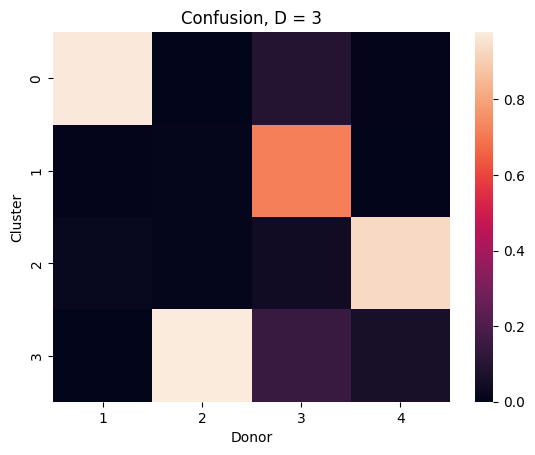

accuracy: 89.91825905938522


In [52]:
donor = pd.read_csv('/home/kevin/storage_kevin/past_figures/figures_final6/data/donor4/donor_ids.tsv', sep = '\t').iloc[:, 1].to_numpy()[normalized_layer1.cell_filter]
name = ["MantonCB1", "MantonCB2", "MantonCB3", "MantonCB4", "doublet", "unassigned"]

name = ["MantonCB1", "MantonCB2", "MantonCB3", "MantonCB4", "doublet", "unassigned"]
reference = np.empty(normalized_layer1.cell_total)

for w in range(6):
    
    reference[np.where(donor == name[w])[0]] = w
    
reference = reference.astype(int)
    
matrix = np.zeros((4, 4))
ref_sum = np.zeros(4)

assigned_label = pd.read_csv('bmvae/D_3/labels.txt', header = None).to_numpy()[0].astype(int)

for q in range(normalized_layer1.cell_total):
    
    if reference[q] <= 3:

        matrix[reference[q], assigned_label[q]] += 1
        ref_sum[reference[q]] += 1

prop = matrix / np.outer(ref_sum, np.ones(4))

fig, ax = plt.subplots(1, 1)
ax = sns.heatmap(prop.T[[0, 1, 2, 3], :], xticklabels = [1, 2, 3, 4], yticklabels = [0, 1, 2, 3])
ax.set_ylabel("Cluster")
ax.set_xlabel("Donor")
ax.set_title("Confusion, D = 3")
plt.show()

print(f'accuracy: {np.mean(np.max(prop, 1)) * 100}')

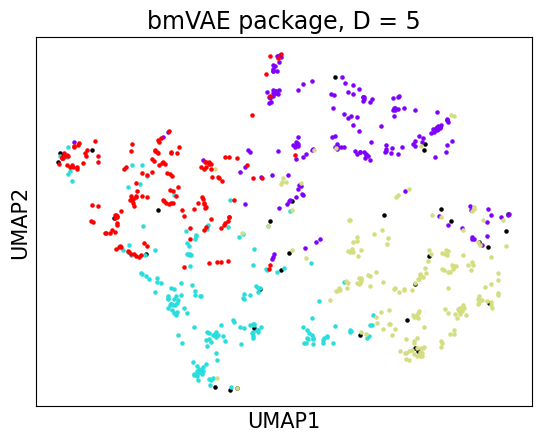

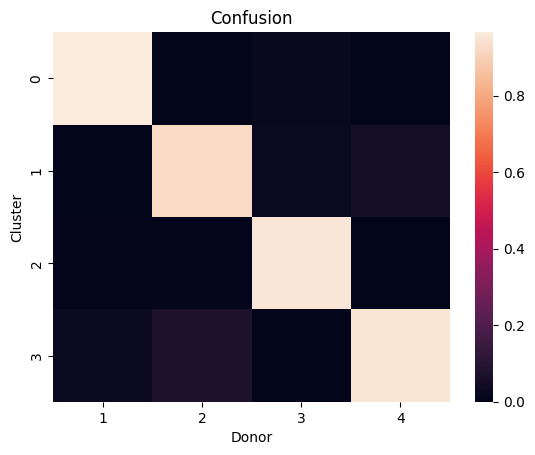

accuracy: 94.72666847684667
silhouette score: 0.15639530313061967


In [60]:
embedding_full = np.genfromtxt('bmvae/D_5/embedding.txt', delimiter = ',')

reducer_2d = umap.UMAP(n_components = 2)
embedding_2d = reducer_2d.fit_transform(embedding_full)
pair_embedding_full = squareform(pdist(embedding_full))

donor = pd.read_csv('/home/kevin/storage_kevin/past_figures/figures_final6/data/donor4/donor_ids.tsv', sep = '\t').iloc[:, 1].to_numpy()[SNPmanifold_umap.cell_filter]
name = ["MantonCB1", "MantonCB2", "MantonCB3", "MantonCB4", "doublet", "unassigned"]

clusters = []

for w in name:
    
    clusters.append(np.where(donor == w)[0])

fig, axs = plt.subplots(1, 1)

axs.scatter(embedding_2d[clusters[4], 0], embedding_2d[clusters[4], 1], s = 5, color = "black")

for t in range(4):
    
    axs.scatter(embedding_2d[clusters[t], 0], embedding_2d[clusters[t], 1], s = 5, color = SNPmanifold_umap.colors[t])
    
axs.set_xticks([])
axs.set_yticks([])
axs.set_xlabel("UMAP1", fontsize = 15)
axs.set_ylabel("UMAP2", fontsize = 15)
axs.set_title("bmVAE package, D = 5", fontsize = 17)

plt.show()

name = ["MantonCB1", "MantonCB2", "MantonCB3", "MantonCB4", "doublet", "unassigned"]
reference = np.empty(SNPmanifold_umap.cell_total)

for w in range(6):
    
    reference[np.where(donor == name[w])[0]] = w
    
reference = reference.astype(int)
    
matrix = np.zeros((4, 4))
ref_sum = np.zeros(4)

assigned_label = pd.read_csv('bmvae/D_5/labels.txt', header = None).to_numpy()[0].astype(int)

for q in range(SNPmanifold_umap.cell_total):
    
    if reference[q] <= 3:

        matrix[reference[q], assigned_label[q]] += 1
        ref_sum[reference[q]] += 1

prop = matrix / np.outer(ref_sum, np.ones(4))

fig, ax = plt.subplots(1, 1)
ax = sns.heatmap(prop.T[[0, 1, 2, 3], :], xticklabels = [1, 2, 3, 4], yticklabels = [0, 1, 2, 3])
ax.set_ylabel("Cluster")
ax.set_xlabel("Donor")
ax.set_title("Confusion")
plt.show()

print(f'accuracy: {np.mean(np.max(prop, 1)) * 100}')
print(f'silhouette score: {silhouette_score(pair_embedding_full[reference <= 3, :][:, reference <= 3], reference[reference <= 3], metric = "precomputed")}')

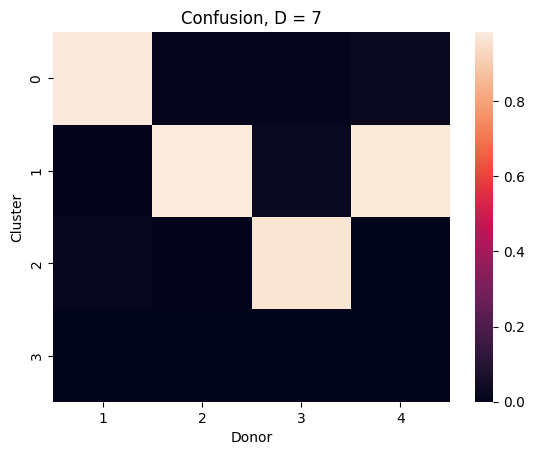

accuracy: 97.57111461833486


In [55]:
donor = pd.read_csv('/home/kevin/storage_kevin/past_figures/figures_final6/data/donor4/donor_ids.tsv', sep = '\t').iloc[:, 1].to_numpy()[normalized_layer1.cell_filter]
name = ["MantonCB1", "MantonCB2", "MantonCB3", "MantonCB4", "doublet", "unassigned"]

name = ["MantonCB1", "MantonCB2", "MantonCB3", "MantonCB4", "doublet", "unassigned"]
reference = np.empty(normalized_layer1.cell_total)

for w in range(6):
    
    reference[np.where(donor == name[w])[0]] = w
    
reference = reference.astype(int)
    
matrix = np.zeros((4, 4))
ref_sum = np.zeros(4)

assigned_label = pd.read_csv('bmvae/D_7/labels.txt', header = None).to_numpy()[0].astype(int)

for q in range(normalized_layer1.cell_total):
    
    if reference[q] <= 3:

        matrix[reference[q], assigned_label[q]] += 1
        ref_sum[reference[q]] += 1

prop = matrix / np.outer(ref_sum, np.ones(4))

fig, ax = plt.subplots(1, 1)
ax = sns.heatmap(prop.T[[0, 1, 2, 3], :], xticklabels = [1, 2, 3, 4], yticklabels = [0, 1, 2, 3])
ax.set_ylabel("Cluster")
ax.set_xlabel("Donor")
ax.set_title("Confusion, D = 7")
plt.show()

print(f'accuracy: {np.mean(np.max(prop, 1)) * 100}')

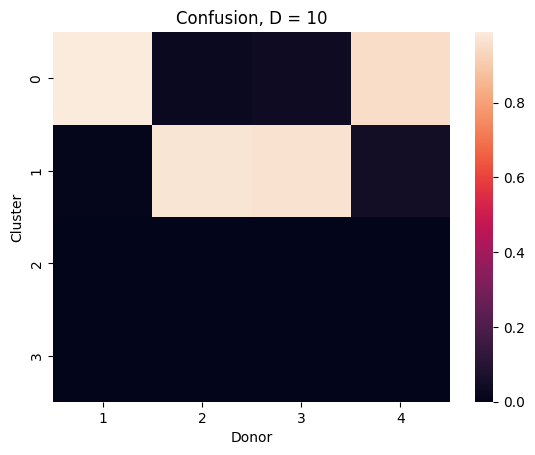

accuracy: 96.82132109199108


In [53]:
donor = pd.read_csv('/home/kevin/storage_kevin/past_figures/figures_final6/data/donor4/donor_ids.tsv', sep = '\t').iloc[:, 1].to_numpy()[normalized_layer1.cell_filter]
name = ["MantonCB1", "MantonCB2", "MantonCB3", "MantonCB4", "doublet", "unassigned"]

name = ["MantonCB1", "MantonCB2", "MantonCB3", "MantonCB4", "doublet", "unassigned"]
reference = np.empty(normalized_layer1.cell_total)

for w in range(6):
    
    reference[np.where(donor == name[w])[0]] = w
    
reference = reference.astype(int)
    
matrix = np.zeros((4, 4))
ref_sum = np.zeros(4)

assigned_label = pd.read_csv('bmvae/D_10/labels.txt', header = None).to_numpy()[0].astype(int)

for q in range(normalized_layer1.cell_total):
    
    if reference[q] <= 3:

        matrix[reference[q], assigned_label[q]] += 1
        ref_sum[reference[q]] += 1

prop = matrix / np.outer(ref_sum, np.ones(4))

fig, ax = plt.subplots(1, 1)
ax = sns.heatmap(prop.T[[0, 1, 2, 3], :], xticklabels = [1, 2, 3, 4], yticklabels = [0, 1, 2, 3])
ax.set_ylabel("Cluster")
ax.set_xlabel("Donor")
ax.set_title("Confusion, D = 10")
plt.show()

print(f'accuracy: {np.mean(np.max(prop, 1)) * 100}')

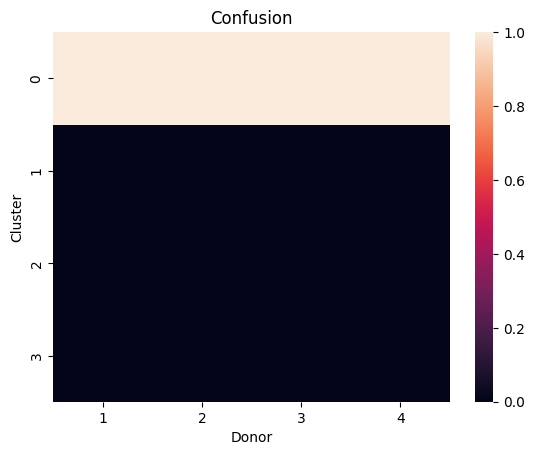

accuracy: 100.0


In [42]:
donor = pd.read_csv('/home/kevin/storage_kevin/past_figures/figures_final6/data/donor4/donor_ids.tsv', sep = '\t').iloc[:, 1].to_numpy()[normalized_layer1.cell_filter]
name = ["MantonCB1", "MantonCB2", "MantonCB3", "MantonCB4", "doublet", "unassigned"]

name = ["MantonCB1", "MantonCB2", "MantonCB3", "MantonCB4", "doublet", "unassigned"]
reference = np.empty(normalized_layer1.cell_total)

for w in range(6):
    
    reference[np.where(donor == name[w])[0]] = w
    
reference = reference.astype(int)
    
matrix = np.zeros((4, 4))
ref_sum = np.zeros(4)

assigned_label = pd.read_csv('bmvae/D_50/labels.txt', header = None).to_numpy()[0].astype(int)

for q in range(normalized_layer1.cell_total):
    
    if reference[q] <= 3:

        matrix[reference[q], assigned_label[q]] += 1
        ref_sum[reference[q]] += 1

prop = matrix / np.outer(ref_sum, np.ones(4))

fig, ax = plt.subplots(1, 1)
ax = sns.heatmap(prop.T[[0, 1, 2, 3], :], xticklabels = [1, 2, 3, 4], yticklabels = [0, 1, 2, 3])
ax.set_ylabel("Cluster")
ax.set_xlabel("Donor")
ax.set_title("Confusion")
plt.show()

print(f'accuracy: {np.mean(np.max(prop, 1)) * 100}')

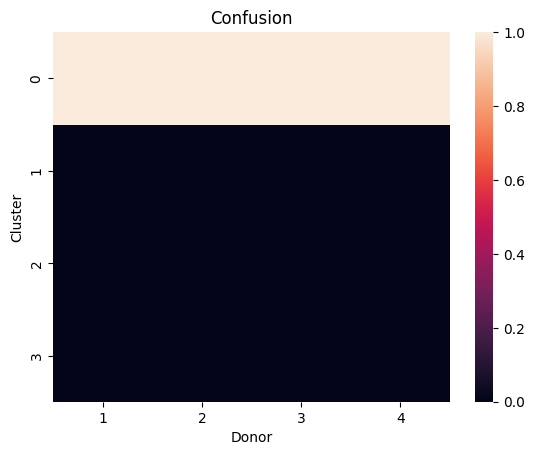

accuracy: 100.0


In [43]:
donor = pd.read_csv('/home/kevin/storage_kevin/past_figures/figures_final6/data/donor4/donor_ids.tsv', sep = '\t').iloc[:, 1].to_numpy()[normalized_layer1.cell_filter]
name = ["MantonCB1", "MantonCB2", "MantonCB3", "MantonCB4", "doublet", "unassigned"]

name = ["MantonCB1", "MantonCB2", "MantonCB3", "MantonCB4", "doublet", "unassigned"]
reference = np.empty(normalized_layer1.cell_total)

for w in range(6):
    
    reference[np.where(donor == name[w])[0]] = w
    
reference = reference.astype(int)
    
matrix = np.zeros((4, 4))
ref_sum = np.zeros(4)

assigned_label = pd.read_csv('bmvae/D_191/labels.txt', header = None).to_numpy()[0].astype(int)

for q in range(normalized_layer1.cell_total):
    
    if reference[q] <= 3:

        matrix[reference[q], assigned_label[q]] += 1
        ref_sum[reference[q]] += 1

prop = matrix / np.outer(ref_sum, np.ones(4))

fig, ax = plt.subplots(1, 1)
ax = sns.heatmap(prop.T[[0, 1, 2, 3], :], xticklabels = [1, 2, 3, 4], yticklabels = [0, 1, 2, 3])
ax.set_ylabel("Cluster")
ax.set_xlabel("Donor")
ax.set_title("Confusion")
plt.show()

print(f'accuracy: {np.mean(np.max(prop, 1)) * 100}')

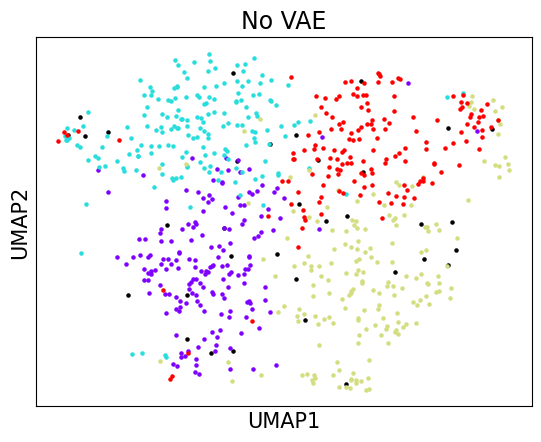

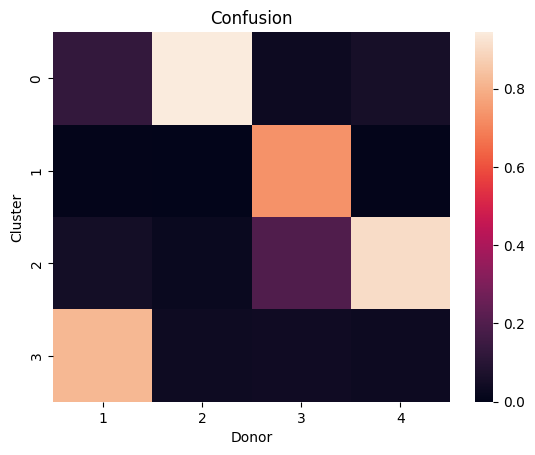

accuracy: 85.01650092206044
silhouette score: 0.27211590130190666


In [51]:
import copy

SNPmanifold_umap = copy.deepcopy(normalized_layer1)

reducer_2d = umap.UMAP(n_components = 2)
embedding_2d = reducer_2d.fit_transform(SNPmanifold_umap.AF_filtered.cpu().numpy())
pair_embedding_2d = squareform(pdist(embedding_2d))

reducer_3d = umap.UMAP(n_components = 3)
embedding_3d = reducer_3d.fit_transform(SNPmanifold_umap.AF_filtered.cpu().numpy())
pair_embedding_3d = squareform(pdist(embedding_3d))

kmeans = KMeans(n_clusters = 4, n_init = 1).fit(embedding_3d)


donor = pd.read_csv('/home/kevin/storage_kevin/past_figures/figures_final6/data/donor4/donor_ids.tsv', sep = '\t').iloc[:, 1].to_numpy()[SNPmanifold_umap.cell_filter]
name = ["MantonCB1", "MantonCB2", "MantonCB3", "MantonCB4", "doublet", "unassigned"]

clusters = []

for w in name:
    
    clusters.append(np.where(donor == w)[0])

fig, axs = plt.subplots(1, 1)

axs.scatter(embedding_2d[clusters[4], 0], embedding_2d[clusters[4], 1], s = 5, color = "black")

for t in range(4):
    
    axs.scatter(embedding_2d[clusters[t], 0], embedding_2d[clusters[t], 1], s = 5, color = SNPmanifold_umap.colors[t])
    
axs.set_xticks([])
axs.set_yticks([])
axs.set_xlabel("UMAP1", fontsize = 15)
axs.set_ylabel("UMAP2", fontsize = 15)
axs.set_title("No VAE", fontsize = 17)

plt.show()

name = ["MantonCB1", "MantonCB2", "MantonCB3", "MantonCB4", "doublet", "unassigned"]
reference = np.empty(SNPmanifold_umap.cell_total)

for w in range(6):
    
    reference[np.where(donor == name[w])[0]] = w
    
reference = reference.astype(int)
    
matrix = np.zeros((4, 4))
ref_sum = np.zeros(4)

for q in range(SNPmanifold_umap.cell_total):
    
    if reference[q] <= 3:

        matrix[reference[q], kmeans.labels_[q]] += 1
        ref_sum[reference[q]] += 1

prop = matrix / np.outer(ref_sum, np.ones(4))

fig, ax = plt.subplots(1, 1)
ax = sns.heatmap(prop.T[[0, 1, 2, 3], :], xticklabels = [1, 2, 3, 4], yticklabels = [0, 1, 2, 3])
ax.set_ylabel("Cluster")
ax.set_xlabel("Donor")
ax.set_title("Confusion")
plt.show()

print(f'accuracy: {np.mean(np.max(prop, 1)) * 100}')
print(f'silhouette score: {silhouette_score(pair_embedding_3d[reference <= 3, :][:, reference <= 3], reference[reference <= 3], metric = "precomputed")}')